In [2]:
import argparse
import glob
import json
import os
import time
from collections import OrderedDict

import imageio
import numpy as np
import pandas as pd
import torch
from torchvision import transforms

from data.vg import VgSceneGraphDataset

from utils.util_v2 import truncted_random

from model.resnet_generator import ResnetGenerator128 as ResnetGenerator128v1
from model.resnet_generator_v2 import ResnetGenerator128 as ResnetGenerator128v2
from model.resnet_generator_v2 import ResnetGenerator256 as ResnetGenerator256v2

In [2]:
with open("./datasets/vg/vocab.json", "r") as read_file:
    vocab = json.load(read_file)
dataset = VgSceneGraphDataset(vocab=vocab, h5_path='./datasets/vg/' + 'val' + '.h5',
                                  image_dir='./datasets/vg/images/',
                                  image_size=(128, 128), max_objects=30, left_right_flip=False)

In [4]:
num_classes = 179
num_o = 31
num_attrs = 80
netG = ResnetGenerator256v2(num_classes=num_classes, output_dim=3, num_attrs=num_attrs).cuda()

In [5]:
snapshots=['pretrained/AttrLostGANv2_256x256.pth']
for snapshot in snapshots:
        state_dict = torch.load(snapshot)

        new_state_dict = OrderedDict()
        for k, v in state_dict.items():
            name = k[7:]    # remove `module.`nvidia
            new_state_dict[name] = v

        model_dict = netG.state_dict()
        pretrained_dict = {k: v for k, v in new_state_dict.items() if k in model_dict}
        model_dict.update(pretrained_dict)
        netG.load_state_dict(model_dict)

        netG.cuda()
        netG.eval()

In [7]:
thres = 2.0
real_images, label, bbox, attrs = dataset[0]
real_images, label, bbox, attrs = real_images.cuda(), label.long().unsqueeze(-1).cuda(), bbox.cuda(), attrs.float().cuda()
real_images = torch.unsqueeze(real_images,0)
label = torch.unsqueeze(label,0)
attrs = torch.unsqueeze(attrs,0)
bbox = torch.unsqueeze(bbox,0)

attrs = attrs*0

z_obj = torch.from_numpy(truncted_random(num_o=num_o, thres=thres)).float().cuda()
z_im = torch.from_numpy(truncted_random(num_o=1, thres=thres)).view(1, -1).float().cuda()

fake_images = netG.forward(z_obj, bbox, z_im, label.squeeze(dim=-1), attrs)

imgs = fake_images[0].cpu().detach().numpy()
imgs = imgs.transpose(1, 2, 0) * 0.5 + 0.5
imgs = imgs * 255

imageio.imwrite("test.jpg",imgs.astype('uint8'))

In [10]:
import json
from os import listdir
from os.path import isfile, join
layout_files = ['layout_missing/'+ f for f in listdir('layout_missing') if isfile(join('layout_missing', f))]
# layout_files = ['layout_output/layout/'+ f for f in listdir('layout_output/layout/') if isfile(join('layout_output/layout/', f))]

In [144]:
len(layout_files)

2966

In [145]:
img_path={}
mappings = json.load(open('finaldata_missing.json'))
for i in mappings:
    img_path[i['id']]=i['path']

2372189.jpg


In [33]:
img_path.values()
image_files = [f for f in listdir('datasets/vg/images/VG_100K_2/') if isfile(join('datasets/vg/images/VG_100K_2/', f))]

In [34]:
len(image_files)

43903

In [54]:
c=0
for i in img_path.values():
    # print(i+'..............')
    if i not in img_ids:
        # print(i)
        c+=1
c

0

In [37]:
split_json = json.load(open('data/vg_splits.json'))

In [43]:
test_img_ids = [str(i)+'.jpg' for i in split_json['test']]
train_img_ids = [str(i)+'.jpg' for i in split_json['train']]
val_img_ids = [str(i)+'.jpg' for i in split_json['val']]

In [41]:
len(test_img_ids)

10807

In [49]:
img_ids = train_img_ids + val_img_ids + test_img_ids
img_ids = list(set(img_ids))

In [50]:
len(img_ids)

108077

In [9]:
import os
import random
from collections import defaultdict

import torch
from torch.utils.data import Dataset
import torchvision.transforms as T
from skimage.transform import resize as imresize

import numpy as np
import h5py
import PIL
from collections import defaultdict
from tqdm import tqdm

In [58]:
data = {}
with h5py.File('./datasets/vg/' + 'val' + '.h5', 'r') as f:
    for k, v in f.items():
        if k == 'image_paths':
            image_paths = list(v)
        else:
            data[k] = torch.IntTensor(np.asarray(v))

In [65]:
len(data['object_attributes'])

51090

In [63]:
data.keys()

dict_keys(['attributes_per_object', 'image_ids', 'object_attributes', 'object_boxes', 'object_ids', 'object_names', 'objects_per_image', 'relationship_ids', 'relationship_objects', 'relationship_predicates', 'relationship_subjects', 'relationships_per_image'])

In [66]:
vocab.keys()

dict_keys(['object_name_to_idx', 'object_idx_to_name', 'attribute_name_to_idx', 'attribute_idx_to_name', 'pred_name_to_idx', 'pred_idx_to_name'])

In [86]:
def load_aliases(alias_path):
  aliases = {}
  print('Loading aliases from "%s"' % alias_path)
  with open(alias_path, 'r') as f:
    for line in f:
      line = [s.strip() for s in line.split(',')]
      for s in line:
        aliases[s] = line[0]
  return aliases

obj_aliases = load_aliases('datasets/vg/object_alias.txt')

Loading aliases from "datasets/vg/object_alias.txt"


In [87]:
with open('datasets/vg/attributes.json', 'r') as f:
    attributes = json.load(f)

In [91]:
attributes_dict = {}
for img in attributes:
    object_map={}
    for a in img['attributes']:
        object_key = obj_aliases.get(a['names'][0],a['names'][0])
        if object_key not in object_map.keys():
            object_map[object_key] = []
        if 'attributes' in a.keys():
            object_map[object_key].append(a['attributes'])
    attributes_dict[str(img['image_id'])+'.jpg'] = object_map

In [92]:
for i in img_path.values():
    # print(i)
    if i in attributes_dict.keys():
        # print(i)
        print(attributes_dict[i])
        break

{'tower': [['in darkness', 'tall', 'massive', 'stone']], 'light': [['yellowish'], ['yellowish'], ['small', 'white', 'bright']], 'triangle': [], 'clock': [], 'side': [], 'arch': [['window'], ['window'], ['window'], ['window'], ['window']], 'row': [['vertical'], ['vertical']], 'slit': [], 'ornamentation': [['on corner', 'spire'], ['on corner', 'spire'], ['on corner', 'spire']], 'tree': [['at bottom', 'leafy']], 'top': [['lit']], 'sky': [['black', 'night time', 'dark', 'clear', 'cloudless']], 'hand': [['black'], ['black'], ['black'], ['black']]}


In [148]:
skip = ['2410555.jpg']
for layout_file in tqdm(layout_files):
    # print(layout_file.split('/')[-1])
    layout = json.load(open(layout_file))
    # print(layout)
    
    image_path = img_path[layout['image_id']]
    # print(image_path)
    if image_path in skip:
        continue
    new_label = []
    objs = torch.LongTensor(30+1).fill_(-1)
    boxes = torch.FloatTensor([[0, 0, 1, 1]]).repeat(30+1, 1)
    attrs = torch.FloatTensor(30 + 1, 80).fill_(0)
    for i,l in enumerate(layout['classes']):
        # print(vocab['object_name_to_idx'].get(l,0))
        new_label.append(vocab['object_name_to_idx'].get(l,0))
        objs[i] = vocab['object_name_to_idx'].get(obj_aliases.get(l,l),0)
        # if vocab['object_name_to_idx'].get(l,0)==0:
            # print(l)
        x0,y0,x1,y1=layout['boxes'][i]
        w = x1-x0
        h = y1-y0
        boxes[i] = torch.FloatTensor([x0, y0, w, h])
        
        count_objects = defaultdict(int)
        count_objects[obj_aliases.get(l,l)]+=1
        
        cur_attributes = attributes_dict[image_path].get(obj_aliases.get(l,l),0)
        if cur_attributes!=0 and len(cur_attributes)!=0:
            attr_list=cur_attributes[0]
            for attr in attr_list:
                atr_idx = vocab['attribute_name_to_idx'].get(attr,-1)
                # print(atr_idx, attr)
                if atr_idx!=-1:
                   attrs[i][atr_idx]=1 
    num_objects = len(layout['classes'])
    objs[num_objects] = vocab['object_name_to_idx']['__image__']
    for i in range(num_objects+1,31):
        objs[i] = vocab['object_name_to_idx']['__image__']
        boxes[i] = torch.FloatTensor([-0.6, -0.6, 0.5, 0.5])
        attrs[i] = torch.FloatTensor(80).fill_(-1)
    # label, bbox =  objs.long().unsqueeze(-1), boxes
    # label = torch.unsqueeze(label,dim=0)
    # bbox = torch.unsqueeze(bbox,dim=0)
    # break
    
    label, bbox, attrs = objs.long().unsqueeze(-1).cuda(), boxes.cuda(), attrs.float().cuda()
    label = torch.unsqueeze(label,0)
    attrs = torch.unsqueeze(attrs,0)
    bbox = torch.unsqueeze(bbox,0)

    # attrs = attrs*0
    # print(label.shape,attrs.shape,bbox.shape)
    z_obj = torch.from_numpy(truncted_random(num_o=num_o, thres=thres)).float().cuda()
    z_im = torch.from_numpy(truncted_random(num_o=1, thres=thres)).view(1, -1).float().cuda()

    fake_images = netG.forward(z_obj, bbox, z_im, label.squeeze(dim=-1), attrs)

    imgs = fake_images[0].cpu().detach().numpy()
    imgs = imgs.transpose(1, 2, 0) * 0.5 + 0.5
    imgs = imgs * 255

    imageio.imwrite('outputs_missing/'+(layout_file.split('/')[-1]).split('.')[0]+'.jpg',imgs.astype('uint8'))

  0%|          | 0/2966 [00:00<?, ?it/s]/home/ubuntu/anaconda3/envs/pytorch_p38/lib/python3.8/site-packages/torch/nn/functional.py:3631: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn(
/home/ubuntu/anaconda3/envs/pytorch_p38/lib/python3.8/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(
100%|██████████| 2966/2966 [03:53<00:00, 12.71it/s]


In [28]:
from fid_score.fid_score import FidScore

path_source = 'overlap_resize'
path_gt = 'overlap_gt'
path_missing = 'overlap_missing'
path_completed = 'overlap_completed'
# path_gt = 'outputs_gt/'
# path_missing = 'outputs_missing/'
# path_completed = 'outputs_completed/'

paths = ['outputs','outputs1']
batch_size=32
device = torch.device('cuda:0')
fid_gt = FidScore([path_source,path_gt], device,batch_size)
fid_missing = FidScore([path_source,path_missing], device,batch_size)
fid_completed = FidScore([path_source,path_completed], device,batch_size)

score_gt = fid_gt.calculate_fid_score()
score_missing = fid_missing.calculate_fid_score()
score_completed = fid_completed.calculate_fid_score()

  0%|          | 0/29 [00:00<?, ?it/s]

Present batch 1/32(32, 256, 256, 3)


  3%|▎         | 1/29 [00:00<00:06,  4.32it/s]

done
Present batch 33/32

  7%|▋         | 2/29 [00:00<00:05,  5.15it/s]

(32, 256, 256, 3)
done
Present batch 65/32(32, 256, 256, 3)


 10%|█         | 3/29 [00:00<00:04,  5.69it/s]

done
Present batch 97/32(32, 256, 256, 3)


 14%|█▍        | 4/29 [00:00<00:04,  6.02it/s]

done
Present batch 129/32(32, 256, 256, 3)


 17%|█▋        | 5/29 [00:00<00:03,  6.22it/s]

done
Present batch 161/32(32, 256, 256, 3)


 21%|██        | 6/29 [00:01<00:03,  6.34it/s]

done
Present batch 193/32(32, 256, 256, 3)


 24%|██▍       | 7/29 [00:01<00:03,  6.42it/s]

done
Present batch 225/32(32, 256, 256, 3)


 28%|██▊       | 8/29 [00:01<00:03,  6.47it/s]

done
Present batch 257/32(32, 256, 256, 3)


 31%|███       | 9/29 [00:01<00:03,  6.50it/s]

done
Present batch 289/32(32, 256, 256, 3)


 34%|███▍      | 10/29 [00:01<00:02,  6.53it/s]

done
Present batch 321/32(32, 256, 256, 3)


 38%|███▊      | 11/29 [00:01<00:02,  6.54it/s]

done
Present batch 353/32(32, 256, 256, 3)


 41%|████▏     | 12/29 [00:01<00:02,  6.56it/s]

done
Present batch 385/32(32, 256, 256, 3)


 45%|████▍     | 13/29 [00:02<00:02,  6.57it/s]

done
Present batch 417/32(32, 256, 256, 3)


 48%|████▊     | 14/29 [00:02<00:02,  6.57it/s]

done
Present batch 449/32(32, 256, 256, 3)


 52%|█████▏    | 15/29 [00:02<00:02,  6.58it/s]

done
Present batch 481/32(32, 256, 256, 3)


 55%|█████▌    | 16/29 [00:02<00:01,  6.58it/s]

done
Present batch 513/32(32, 256, 256, 3)


 59%|█████▊    | 17/29 [00:02<00:01,  6.58it/s]

done
Present batch 545/32(32, 256, 256, 3)


 62%|██████▏   | 18/29 [00:02<00:01,  6.58it/s]

done
Present batch 577/32(32, 256, 256, 3)


 66%|██████▌   | 19/29 [00:02<00:01,  6.59it/s]

done
Present batch 609/32(32, 256, 256, 3)


 69%|██████▉   | 20/29 [00:03<00:01,  6.59it/s]

done
Present batch 641/32(32, 256, 256, 3)


 72%|███████▏  | 21/29 [00:03<00:01,  6.58it/s]

done
Present batch 673/32(32, 256, 256, 3)


 76%|███████▌  | 22/29 [00:03<00:01,  6.58it/s]

done
Present batch 705/32(32, 256, 256, 3)


 79%|███████▉  | 23/29 [00:03<00:00,  6.59it/s]

done
Present batch 737/32(32, 256, 256, 3)


 83%|████████▎ | 24/29 [00:03<00:00,  6.60it/s]

done
Present batch 769/32(32, 256, 256, 3)


 86%|████████▌ | 25/29 [00:03<00:00,  6.60it/s]

done
Present batch 801/32(32, 256, 256, 3)


 90%|████████▉ | 26/29 [00:04<00:00,  6.60it/s]

done
Present batch 833/32(32, 256, 256, 3)


 93%|█████████▎| 27/29 [00:04<00:00,  6.60it/s]

done
Present batch 865/32(32, 256, 256, 3)


 97%|█████████▋| 28/29 [00:04<00:00,  6.60it/s]

done
Present batch 897/32

100%|██████████| 29/29 [00:04<00:00,  6.62it/s]

(6, 256, 256, 3)
done



  0%|          | 0/29 [00:00<?, ?it/s]

Present batch 1/32(32, 256, 256, 3)


  3%|▎         | 1/29 [00:00<00:04,  6.68it/s]

done
Present batch 33/32(32, 256, 256, 3)


  7%|▋         | 2/29 [00:00<00:04,  6.60it/s]

done
Present batch 65/32(32, 256, 256, 3)


 10%|█         | 3/29 [00:00<00:03,  6.61it/s]

done
Present batch 97/32(32, 256, 256, 3)


 14%|█▍        | 4/29 [00:00<00:03,  6.61it/s]

done
Present batch 129/32(32, 256, 256, 3)


 17%|█▋        | 5/29 [00:00<00:03,  6.61it/s]

done
Present batch 161/32(32, 256, 256, 3)


 21%|██        | 6/29 [00:00<00:03,  6.62it/s]

done
Present batch 193/32(32, 256, 256, 3)


 24%|██▍       | 7/29 [00:01<00:03,  6.60it/s]

done
Present batch 225/32(32, 256, 256, 3)


 28%|██▊       | 8/29 [00:01<00:03,  6.59it/s]

done
Present batch 257/32(32, 256, 256, 3)


 31%|███       | 9/29 [00:01<00:03,  6.59it/s]

done
Present batch 289/32(32, 256, 256, 3)


 34%|███▍      | 10/29 [00:01<00:02,  6.59it/s]

done
Present batch 321/32(32, 256, 256, 3)


 38%|███▊      | 11/29 [00:01<00:02,  6.59it/s]

done
Present batch 353/32(32, 256, 256, 3)


 41%|████▏     | 12/29 [00:01<00:02,  6.58it/s]

done
Present batch 385/32(32, 256, 256, 3)


 45%|████▍     | 13/29 [00:01<00:02,  6.58it/s]

done
Present batch 417/32(32, 256, 256, 3)


 48%|████▊     | 14/29 [00:02<00:02,  6.58it/s]

done
Present batch 449/32(32, 256, 256, 3)


 52%|█████▏    | 15/29 [00:02<00:02,  6.55it/s]

done
Present batch 481/32(32, 256, 256, 3)


 55%|█████▌    | 16/29 [00:02<00:01,  6.57it/s]

done
Present batch 513/32(32, 256, 256, 3)


 59%|█████▊    | 17/29 [00:02<00:01,  6.57it/s]

done
Present batch 545/32(32, 256, 256, 3)


 62%|██████▏   | 18/29 [00:02<00:01,  6.58it/s]

done
Present batch 577/32(32, 256, 256, 3)


 66%|██████▌   | 19/29 [00:02<00:01,  6.58it/s]

done
Present batch 609/32(32, 256, 256, 3)


 69%|██████▉   | 20/29 [00:03<00:01,  6.59it/s]

done
Present batch 641/32(32, 256, 256, 3)


 72%|███████▏  | 21/29 [00:03<00:01,  6.58it/s]

done
Present batch 673/32(32, 256, 256, 3)


 76%|███████▌  | 22/29 [00:03<00:01,  6.59it/s]

done
Present batch 705/32(32, 256, 256, 3)


 79%|███████▉  | 23/29 [00:03<00:00,  6.60it/s]

done
Present batch 737/32(32, 256, 256, 3)


 83%|████████▎ | 24/29 [00:03<00:00,  6.60it/s]

done
Present batch 769/32(32, 256, 256, 3)


 86%|████████▌ | 25/29 [00:03<00:00,  6.59it/s]

done
Present batch 801/32(32, 256, 256, 3)


 90%|████████▉ | 26/29 [00:03<00:00,  6.59it/s]

done
Present batch 833/32(32, 256, 256, 3)


 93%|█████████▎| 27/29 [00:04<00:00,  6.59it/s]

done
Present batch 865/32(32, 256, 256, 3)


 97%|█████████▋| 28/29 [00:04<00:00,  6.57it/s]

done
Present batch 897/32

100%|██████████| 29/29 [00:04<00:00,  6.77it/s]

(6, 256, 256, 3)
done



  0%|          | 0/29 [00:00<?, ?it/s]

Present batch 1/32(32, 256, 256, 3)


  3%|▎         | 1/29 [00:00<00:06,  4.22it/s]

done
Present batch 33/32

  7%|▋         | 2/29 [00:00<00:05,  5.33it/s]

(32, 256, 256, 3)
done
Present batch 65/32(32, 256, 256, 3)


 10%|█         | 3/29 [00:00<00:04,  5.84it/s]

done
Present batch 97/32(32, 256, 256, 3)


 14%|█▍        | 4/29 [00:00<00:04,  6.15it/s]

done
Present batch 129/32(32, 256, 256, 3)


 17%|█▋        | 5/29 [00:00<00:03,  6.32it/s]

done
Present batch 161/32(32, 256, 256, 3)


 21%|██        | 6/29 [00:00<00:03,  6.44it/s]

done
Present batch 193/32(32, 256, 256, 3)


 24%|██▍       | 7/29 [00:01<00:03,  6.51it/s]

done
Present batch 225/32(32, 256, 256, 3)


 28%|██▊       | 8/29 [00:01<00:03,  6.55it/s]

done
Present batch 257/32(32, 256, 256, 3)


 31%|███       | 9/29 [00:01<00:03,  6.58it/s]

done
Present batch 289/32(32, 256, 256, 3)


 34%|███▍      | 10/29 [00:01<00:02,  6.61it/s]

done
Present batch 321/32(32, 256, 256, 3)


 38%|███▊      | 11/29 [00:01<00:02,  6.62it/s]

done
Present batch 353/32(32, 256, 256, 3)


 41%|████▏     | 12/29 [00:01<00:02,  6.64it/s]

done
Present batch 385/32(32, 256, 256, 3)


 45%|████▍     | 13/29 [00:02<00:02,  6.64it/s]

done
Present batch 417/32(32, 256, 256, 3)


 48%|████▊     | 14/29 [00:02<00:02,  6.65it/s]

done
Present batch 449/32(32, 256, 256, 3)


 52%|█████▏    | 15/29 [00:02<00:02,  6.64it/s]

done
Present batch 481/32(32, 256, 256, 3)


 55%|█████▌    | 16/29 [00:02<00:01,  6.65it/s]

done
Present batch 513/32(32, 256, 256, 3)


 59%|█████▊    | 17/29 [00:02<00:01,  6.66it/s]

done
Present batch 545/32(32, 256, 256, 3)


 62%|██████▏   | 18/29 [00:02<00:01,  6.66it/s]

done
Present batch 577/32(32, 256, 256, 3)


 66%|██████▌   | 19/29 [00:02<00:01,  6.66it/s]

done
Present batch 609/32(32, 256, 256, 3)


 69%|██████▉   | 20/29 [00:03<00:01,  6.65it/s]

done
Present batch 641/32(32, 256, 256, 3)


 72%|███████▏  | 21/29 [00:03<00:01,  6.65it/s]

done
Present batch 673/32(32, 256, 256, 3)


 76%|███████▌  | 22/29 [00:03<00:01,  6.65it/s]

done
Present batch 705/32(32, 256, 256, 3)


 79%|███████▉  | 23/29 [00:03<00:00,  6.65it/s]

done
Present batch 737/32(32, 256, 256, 3)


 83%|████████▎ | 24/29 [00:03<00:00,  6.66it/s]

done
Present batch 769/32(32, 256, 256, 3)


 86%|████████▌ | 25/29 [00:03<00:00,  6.66it/s]

done
Present batch 801/32(32, 256, 256, 3)


 90%|████████▉ | 26/29 [00:03<00:00,  6.66it/s]

done
Present batch 833/32(32, 256, 256, 3)


 93%|█████████▎| 27/29 [00:04<00:00,  6.65it/s]

done
Present batch 865/32(32, 256, 256, 3)


 97%|█████████▋| 28/29 [00:04<00:00,  6.66it/s]

done
Present batch 897/32

100%|██████████| 29/29 [00:04<00:00,  6.69it/s]

(6, 256, 256, 3)
done



  0%|          | 0/29 [00:00<?, ?it/s]

Present batch 1/32(32, 256, 256, 3)


  3%|▎         | 1/29 [00:00<00:04,  6.74it/s]

done
Present batch 33/32(32, 256, 256, 3)


  7%|▋         | 2/29 [00:00<00:04,  6.70it/s]

done
Present batch 65/32(32, 256, 256, 3)


 10%|█         | 3/29 [00:00<00:03,  6.68it/s]

done
Present batch 97/32(32, 256, 256, 3)


 14%|█▍        | 4/29 [00:00<00:03,  6.69it/s]

done
Present batch 129/32(32, 256, 256, 3)


 17%|█▋        | 5/29 [00:00<00:03,  6.66it/s]

done
Present batch 161/32(32, 256, 256, 3)


 21%|██        | 6/29 [00:00<00:03,  6.67it/s]

done
Present batch 193/32(32, 256, 256, 3)


 24%|██▍       | 7/29 [00:01<00:03,  6.67it/s]

done
Present batch 225/32(32, 256, 256, 3)


 28%|██▊       | 8/29 [00:01<00:03,  6.67it/s]

done
Present batch 257/32(32, 256, 256, 3)


 31%|███       | 9/29 [00:01<00:03,  6.66it/s]

done
Present batch 289/32(32, 256, 256, 3)


 34%|███▍      | 10/29 [00:01<00:02,  6.67it/s]

done
Present batch 321/32(32, 256, 256, 3)


 38%|███▊      | 11/29 [00:01<00:02,  6.66it/s]

done
Present batch 353/32(32, 256, 256, 3)


 41%|████▏     | 12/29 [00:01<00:02,  6.67it/s]

done
Present batch 385/32(32, 256, 256, 3)


 45%|████▍     | 13/29 [00:01<00:02,  6.66it/s]

done
Present batch 417/32(32, 256, 256, 3)


 48%|████▊     | 14/29 [00:02<00:02,  6.65it/s]

done
Present batch 449/32(32, 256, 256, 3)


 52%|█████▏    | 15/29 [00:02<00:02,  6.65it/s]

done
Present batch 481/32(32, 256, 256, 3)


 55%|█████▌    | 16/29 [00:02<00:01,  6.66it/s]

done
Present batch 513/32(32, 256, 256, 3)


 59%|█████▊    | 17/29 [00:02<00:01,  6.68it/s]

done
Present batch 545/32(32, 256, 256, 3)


 62%|██████▏   | 18/29 [00:02<00:01,  6.67it/s]

done
Present batch 577/32(32, 256, 256, 3)


 66%|██████▌   | 19/29 [00:02<00:01,  6.67it/s]

done
Present batch 609/32(32, 256, 256, 3)


 69%|██████▉   | 20/29 [00:02<00:01,  6.66it/s]

done
Present batch 641/32(32, 256, 256, 3)


 72%|███████▏  | 21/29 [00:03<00:01,  6.67it/s]

done
Present batch 673/32(32, 256, 256, 3)


 76%|███████▌  | 22/29 [00:03<00:01,  6.67it/s]

done
Present batch 705/32(32, 256, 256, 3)


 79%|███████▉  | 23/29 [00:03<00:00,  6.66it/s]

done
Present batch 737/32(32, 256, 256, 3)


 83%|████████▎ | 24/29 [00:03<00:00,  6.66it/s]

done
Present batch 769/32(32, 256, 256, 3)


 86%|████████▌ | 25/29 [00:03<00:00,  6.65it/s]

done
Present batch 801/32(32, 256, 256, 3)


 90%|████████▉ | 26/29 [00:03<00:00,  6.65it/s]

done
Present batch 833/32(32, 256, 256, 3)


 93%|█████████▎| 27/29 [00:04<00:00,  6.65it/s]

done
Present batch 865/32(32, 256, 256, 3)


 97%|█████████▋| 28/29 [00:04<00:00,  6.66it/s]

done
Present batch 897/32

100%|██████████| 29/29 [00:04<00:00,  6.85it/s]

(6, 256, 256, 3)
done



  0%|          | 0/29 [00:00<?, ?it/s]

Present batch 1/32(32, 256, 256, 3)


  3%|▎         | 1/29 [00:00<00:06,  4.23it/s]

done
Present batch 33/32

  7%|▋         | 2/29 [00:00<00:05,  5.32it/s]

(32, 256, 256, 3)
done
Present batch 65/32(32, 256, 256, 3)


 10%|█         | 3/29 [00:00<00:04,  5.80it/s]

done
Present batch 97/32(32, 256, 256, 3)


 14%|█▍        | 4/29 [00:00<00:04,  6.08it/s]

done
Present batch 129/32(32, 256, 256, 3)


 17%|█▋        | 5/29 [00:00<00:03,  6.27it/s]

done
Present batch 161/32(32, 256, 256, 3)


 21%|██        | 6/29 [00:00<00:03,  6.36it/s]

done
Present batch 193/32(32, 256, 256, 3)


 24%|██▍       | 7/29 [00:01<00:03,  6.43it/s]

done
Present batch 225/32(32, 256, 256, 3)


 28%|██▊       | 8/29 [00:01<00:03,  6.48it/s]

done
Present batch 257/32(32, 256, 256, 3)


 31%|███       | 9/29 [00:01<00:03,  6.52it/s]

done
Present batch 289/32(32, 256, 256, 3)


 34%|███▍      | 10/29 [00:01<00:02,  6.53it/s]

done
Present batch 321/32(32, 256, 256, 3)


 38%|███▊      | 11/29 [00:01<00:02,  6.54it/s]

done
Present batch 353/32(32, 256, 256, 3)


 41%|████▏     | 12/29 [00:01<00:02,  6.55it/s]

done
Present batch 385/32(32, 256, 256, 3)


 45%|████▍     | 13/29 [00:02<00:02,  6.57it/s]

done
Present batch 417/32(32, 256, 256, 3)


 48%|████▊     | 14/29 [00:02<00:02,  6.58it/s]

done
Present batch 449/32(32, 256, 256, 3)


 52%|█████▏    | 15/29 [00:02<00:02,  6.58it/s]

done
Present batch 481/32(32, 256, 256, 3)


 55%|█████▌    | 16/29 [00:02<00:01,  6.59it/s]

done
Present batch 513/32(32, 256, 256, 3)


 59%|█████▊    | 17/29 [00:02<00:01,  6.59it/s]

done
Present batch 545/32(32, 256, 256, 3)


 62%|██████▏   | 18/29 [00:02<00:01,  6.59it/s]

done
Present batch 577/32(32, 256, 256, 3)


 66%|██████▌   | 19/29 [00:02<00:01,  6.59it/s]

done
Present batch 609/32(32, 256, 256, 3)


 69%|██████▉   | 20/29 [00:03<00:01,  6.58it/s]

done
Present batch 641/32(32, 256, 256, 3)


 72%|███████▏  | 21/29 [00:03<00:01,  6.59it/s]

done
Present batch 673/32(32, 256, 256, 3)


 76%|███████▌  | 22/29 [00:03<00:01,  6.57it/s]

done
Present batch 705/32(32, 256, 256, 3)


 79%|███████▉  | 23/29 [00:03<00:00,  6.59it/s]

done
Present batch 737/32(32, 256, 256, 3)


 83%|████████▎ | 24/29 [00:03<00:00,  6.47it/s]

done
Present batch 769/32(32, 256, 256, 3)


 86%|████████▌ | 25/29 [00:03<00:00,  6.51it/s]

done
Present batch 801/32(32, 256, 256, 3)


 90%|████████▉ | 26/29 [00:04<00:00,  6.53it/s]

done
Present batch 833/32(32, 256, 256, 3)


 93%|█████████▎| 27/29 [00:04<00:00,  6.53it/s]

done
Present batch 865/32(32, 256, 256, 3)


 97%|█████████▋| 28/29 [00:04<00:00,  6.55it/s]

done
Present batch 897/32

100%|██████████| 29/29 [00:04<00:00,  6.61it/s]

(6, 256, 256, 3)
done



  0%|          | 0/29 [00:00<?, ?it/s]

Present batch 1/32(32, 256, 256, 3)


  3%|▎         | 1/29 [00:00<00:04,  6.32it/s]

done
Present batch 33/32(32, 256, 256, 3)


  7%|▋         | 2/29 [00:00<00:04,  6.38it/s]

done
Present batch 65/32(32, 256, 256, 3)


 10%|█         | 3/29 [00:00<00:04,  6.46it/s]

done
Present batch 97/32(32, 256, 256, 3)


 14%|█▍        | 4/29 [00:00<00:03,  6.50it/s]

done
Present batch 129/32(32, 256, 256, 3)


 17%|█▋        | 5/29 [00:00<00:03,  6.52it/s]

done
Present batch 161/32(32, 256, 256, 3)


 21%|██        | 6/29 [00:00<00:03,  6.43it/s]

done
Present batch 193/32(32, 256, 256, 3)


 24%|██▍       | 7/29 [00:01<00:03,  6.48it/s]

done
Present batch 225/32(32, 256, 256, 3)


 28%|██▊       | 8/29 [00:01<00:03,  6.52it/s]

done
Present batch 257/32(32, 256, 256, 3)


 31%|███       | 9/29 [00:01<00:03,  6.53it/s]

done
Present batch 289/32(32, 256, 256, 3)


 34%|███▍      | 10/29 [00:01<00:02,  6.55it/s]

done
Present batch 321/32(32, 256, 256, 3)


 38%|███▊      | 11/29 [00:01<00:02,  6.55it/s]

done
Present batch 353/32(32, 256, 256, 3)


 41%|████▏     | 12/29 [00:01<00:02,  6.57it/s]

done
Present batch 385/32(32, 256, 256, 3)


 45%|████▍     | 13/29 [00:01<00:02,  6.57it/s]

done
Present batch 417/32(32, 256, 256, 3)


 48%|████▊     | 14/29 [00:02<00:02,  6.57it/s]

done
Present batch 449/32(32, 256, 256, 3)


 52%|█████▏    | 15/29 [00:02<00:02,  6.57it/s]

done
Present batch 481/32(32, 256, 256, 3)


 55%|█████▌    | 16/29 [00:02<00:01,  6.58it/s]

done
Present batch 513/32(32, 256, 256, 3)


 59%|█████▊    | 17/29 [00:02<00:01,  6.58it/s]

done
Present batch 545/32(32, 256, 256, 3)


 62%|██████▏   | 18/29 [00:02<00:01,  6.59it/s]

done
Present batch 577/32(32, 256, 256, 3)


 66%|██████▌   | 19/29 [00:02<00:01,  6.65it/s]

done
Present batch 609/32(32, 256, 256, 3)


 69%|██████▉   | 20/29 [00:03<00:01,  6.65it/s]

done
Present batch 641/32(32, 256, 256, 3)


 72%|███████▏  | 21/29 [00:03<00:01,  6.63it/s]

done
Present batch 673/32(32, 256, 256, 3)


 76%|███████▌  | 22/29 [00:03<00:01,  6.61it/s]

done
Present batch 705/32(32, 256, 256, 3)


 79%|███████▉  | 23/29 [00:03<00:00,  6.60it/s]

done
Present batch 737/32(32, 256, 256, 3)


 83%|████████▎ | 24/29 [00:03<00:00,  6.59it/s]

done
Present batch 769/32(32, 256, 256, 3)


 86%|████████▌ | 25/29 [00:03<00:00,  6.57it/s]

done
Present batch 801/32(32, 256, 256, 3)


 90%|████████▉ | 26/29 [00:03<00:00,  6.58it/s]

done
Present batch 833/32(32, 256, 256, 3)


 93%|█████████▎| 27/29 [00:04<00:00,  6.58it/s]

done
Present batch 865/32(32, 256, 256, 3)


 97%|█████████▋| 28/29 [00:04<00:00,  6.58it/s]

done
Present batch 897/32

100%|██████████| 29/29 [00:04<00:00,  6.73it/s]

(6, 256, 256, 3)
done


In [29]:
print(score_gt, score_completed, score_missing)

138.64600963307566 138.6966408752142 139.51691484553663


In [11]:
gt_images_ids = [f for f in listdir('outputs_gt') if isfile(join('outputs_gt', f))]
missing_image_ids = [f for f in listdir('outputs_missing') if isfile(join('outputs_missing', f))]
completed_image_ids = [f for f in listdir('outputs_completed') if isfile(join('outputs_completed', f))]

In [12]:
overlap_ids = []
for i in gt_images_ids:
    if i in missing_image_ids and i in completed_image_ids:
        overlap_ids.append(i)

In [168]:
import shutil
# for f in overlap_ids:
#     shutil.copy('datasets/vg/images/'+f, 'overlap_images')
images_ids_1 = [f for f in listdir('datasets/vg/images/VG_100K') if isfile(join('datasets/vg/images/VG_100K', f))]
images_ids_2 = [f for f in listdir('datasets/vg/images/VG_100K_2') if isfile(join('datasets/vg/images/VG_100K_2', f))]

for f in overlap_ids:
    if f in images_ids_1:
        shutil.copy('datasets/vg/images/VG_100K/'+f, 'overlap_images')
    else:
        shutil.copy('datasets/vg/images/VG_100K_2/'+f, 'overlap_images')

In [5]:
import numpy as np
import torch
from scipy import linalg
from torch.nn.functional import adaptive_avg_pool2d
from PIL import Image

In [15]:
def _imread( filename):
        """
        Loads an image file into a (height, width, 3) uint8 ndarray.
        """
        return np.asarray(Image.open(filename), dtype=np.uint8)[..., :3]

In [18]:
images_ids = ['overlap_images/'+f for f in listdir('overlap_images') if isfile(join('overlap_images', f))]
gt_ids = ['outputs_gt/'+f for f in listdir('outputs_gt') if isfile(join('outputs_gt', f))]
images = np.array([_imread(str(f)).astype(np.float32) for f in gt_ids])

In [21]:
from PIL import Image

images_ids = [f for f in listdir('overlap_images') if isfile(join('overlap_images', f))]
for img in images_ids:
    image = Image.open('overlap_images/' + img)
    new_image = image.resize((256, 256))
    new_image.save('overlap_resize/' + img)

1409.jpg


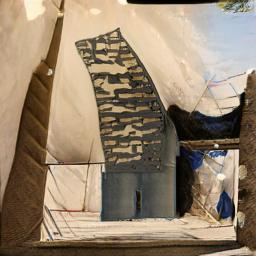

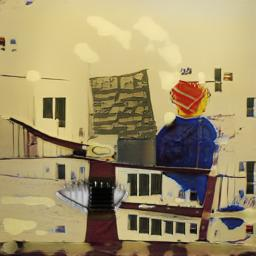

......................................................................
638.jpg


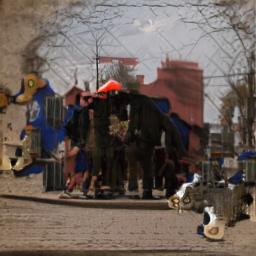

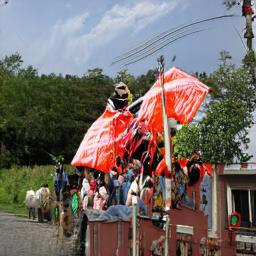

......................................................................
2200.jpg


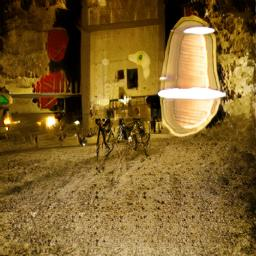

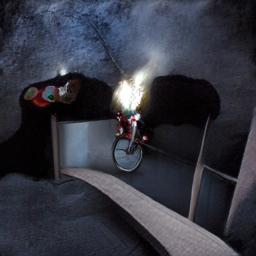

......................................................................
2651.jpg


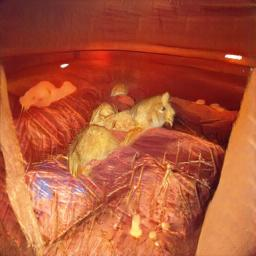

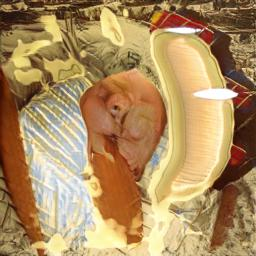

......................................................................
3108.jpg


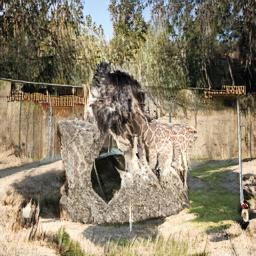

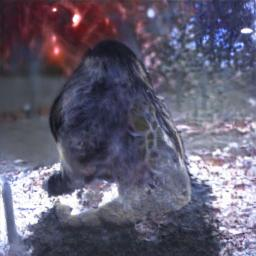

......................................................................
1645.jpg


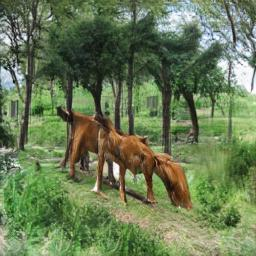

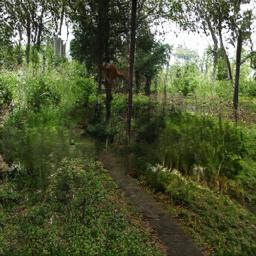

......................................................................
443.jpg


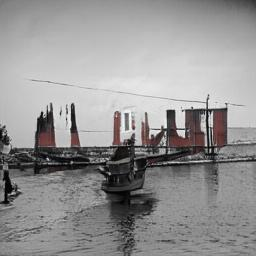

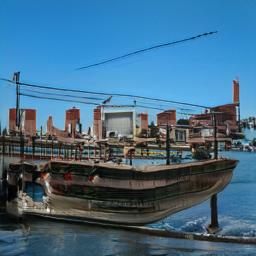

......................................................................
2711.jpg


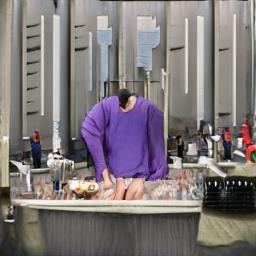

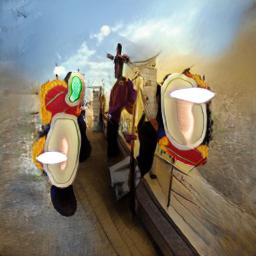

......................................................................
969.jpg


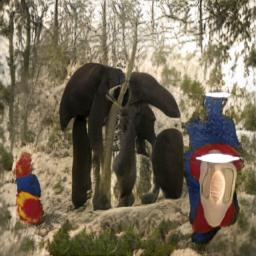

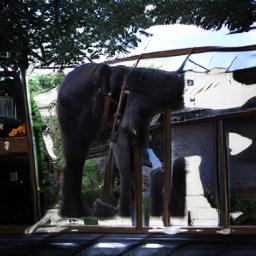

......................................................................
2549.jpg


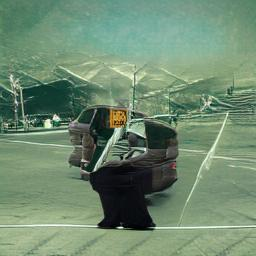

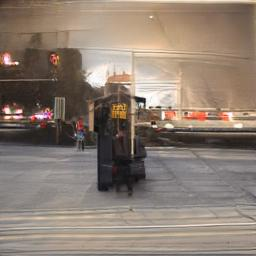

......................................................................
682.jpg


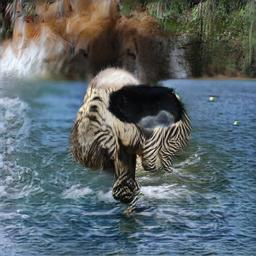

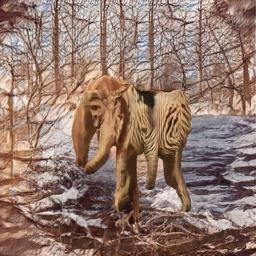

......................................................................
958.jpg


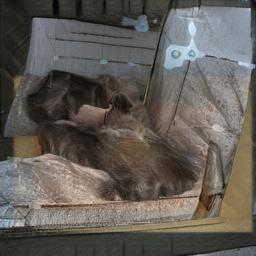

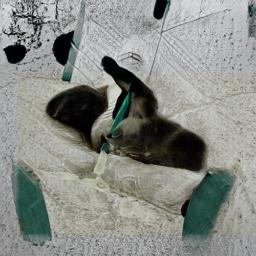

......................................................................
1968.jpg


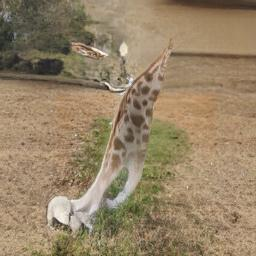

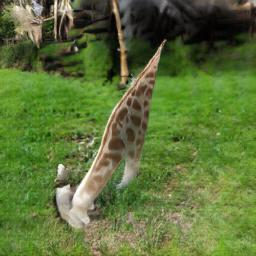

......................................................................
1781.jpg


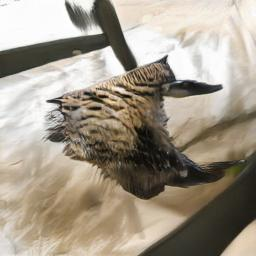

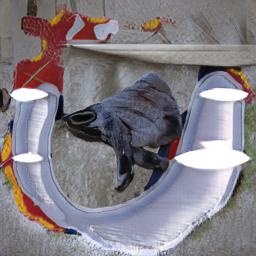

......................................................................
687.jpg


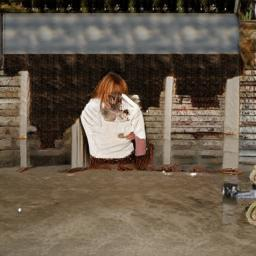

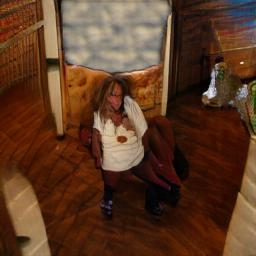

......................................................................
2423.jpg


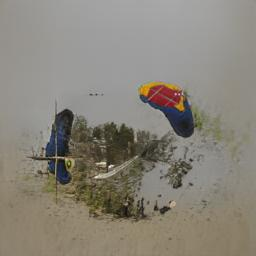

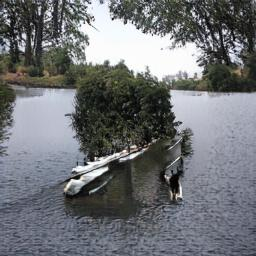

......................................................................
2878.jpg


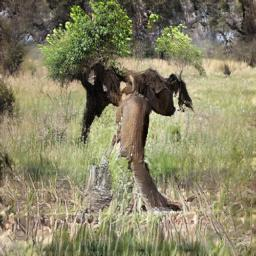

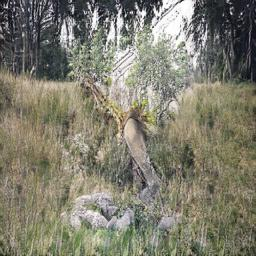

......................................................................
2950.jpg


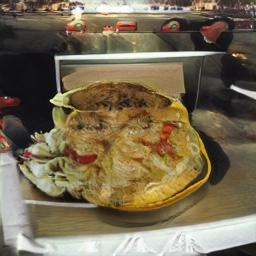

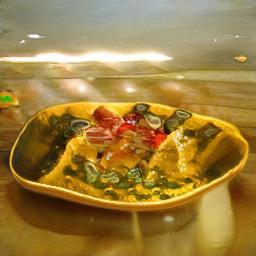

......................................................................
575.jpg


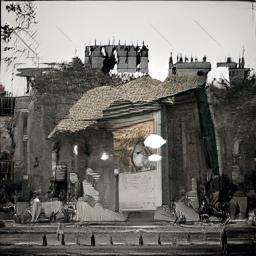

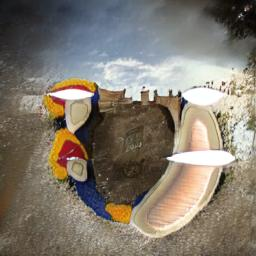

......................................................................
1855.jpg


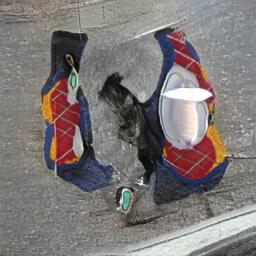

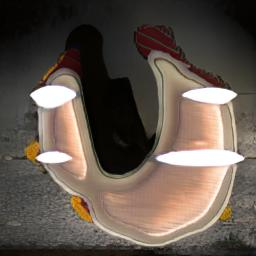

......................................................................
2453.jpg


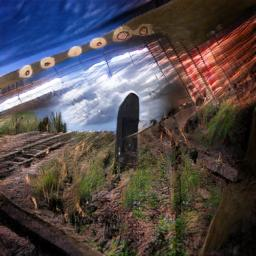

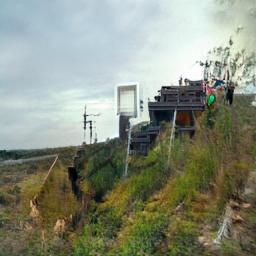

......................................................................
1492.jpg


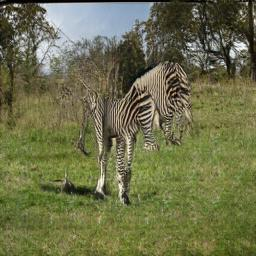

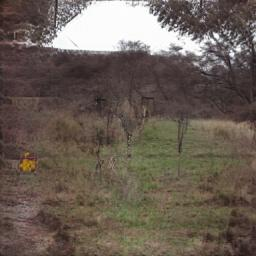

......................................................................
3403.jpg


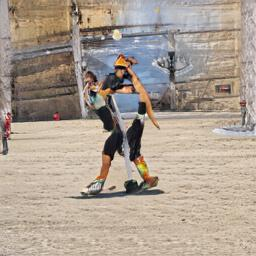

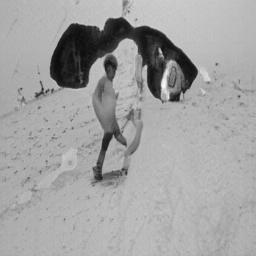

......................................................................
3460.jpg


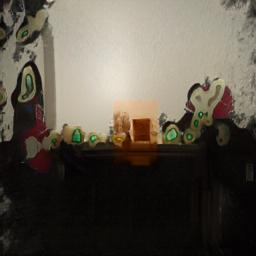

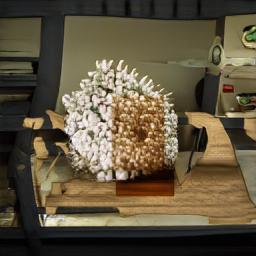

......................................................................
3451.jpg


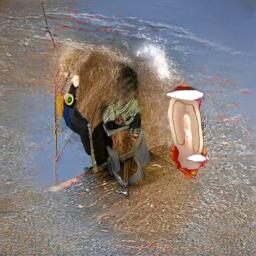

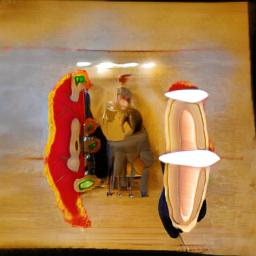

......................................................................
1897.jpg


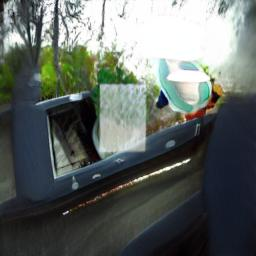

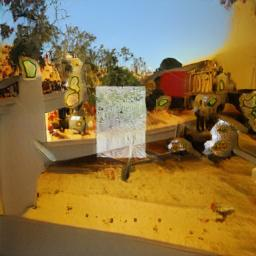

......................................................................
3130.jpg


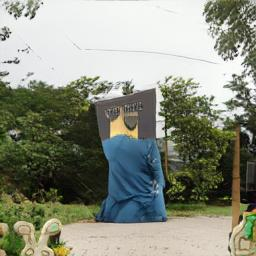

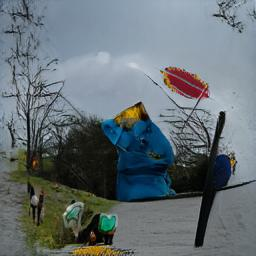

......................................................................
3261.jpg


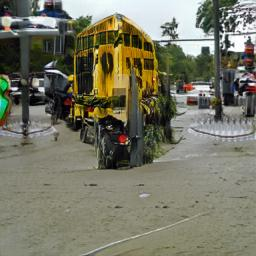

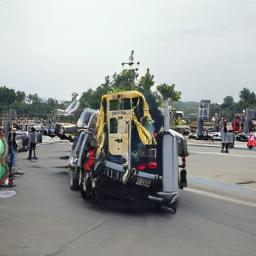

......................................................................
112.jpg


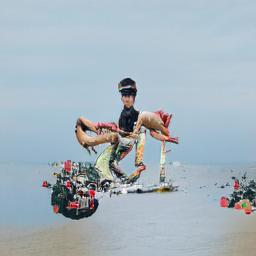

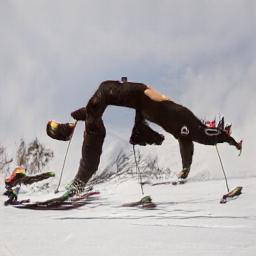

......................................................................
2645.jpg


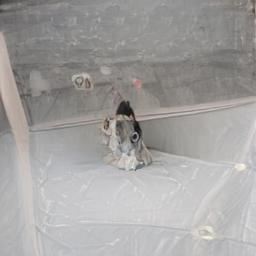

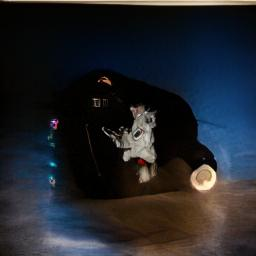

......................................................................
336.jpg


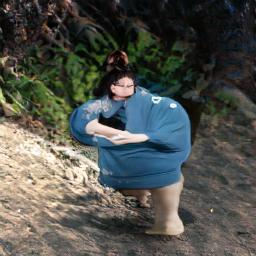

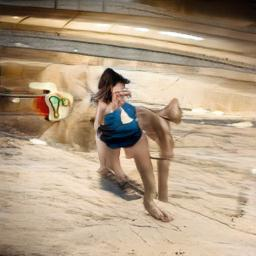

......................................................................
2488.jpg


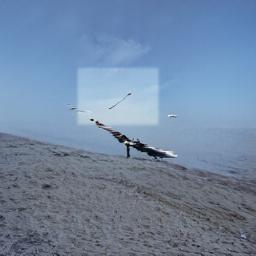

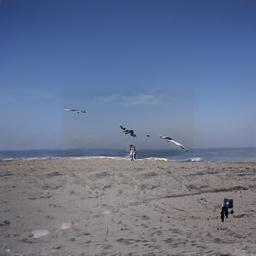

......................................................................
2747.jpg


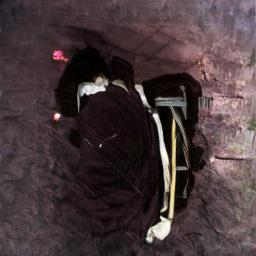

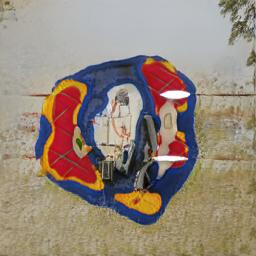

......................................................................
1775.jpg


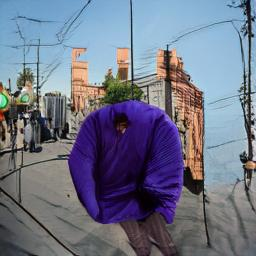

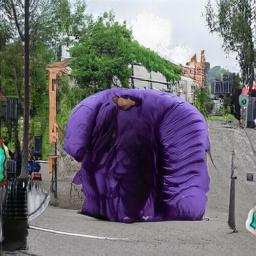

......................................................................
1088.jpg


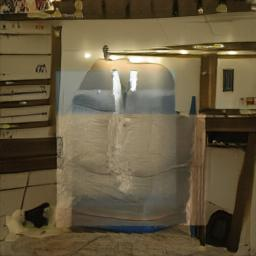

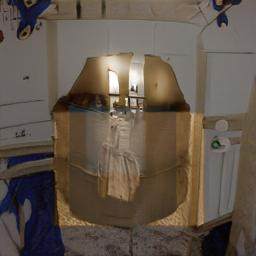

......................................................................
3300.jpg


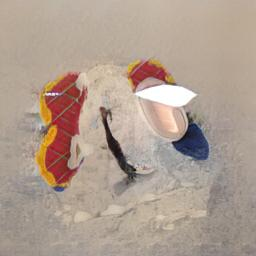

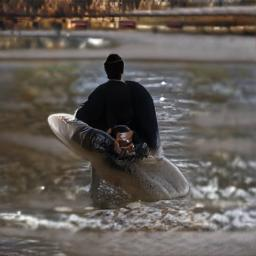

......................................................................
1277.jpg


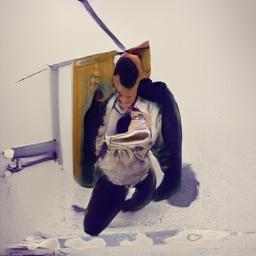

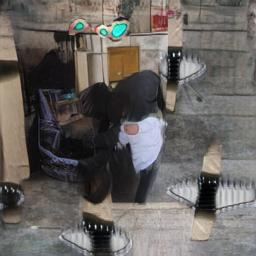

......................................................................
2171.jpg


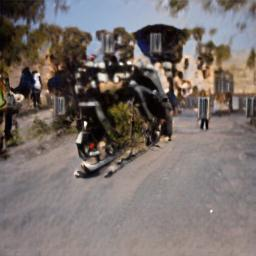

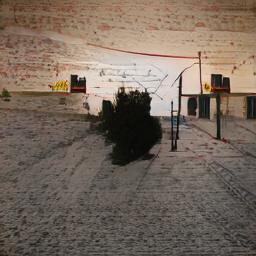

......................................................................
2190.jpg


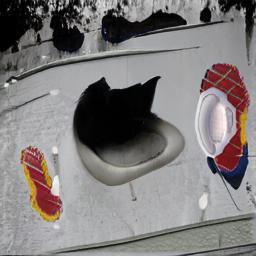

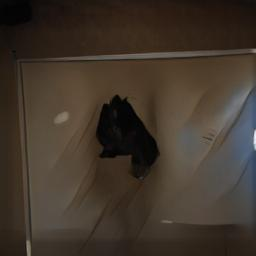

......................................................................
1261.jpg


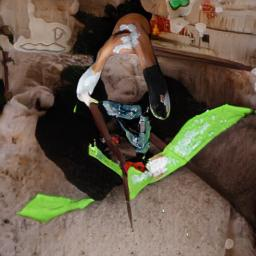

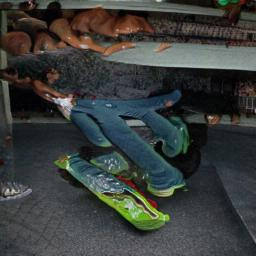

......................................................................
2884.jpg


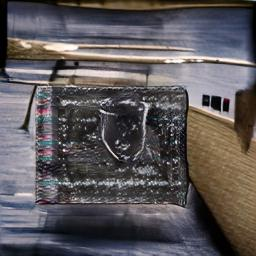

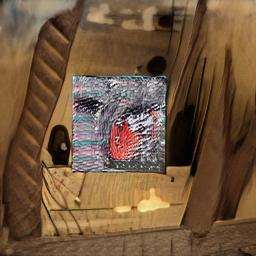

......................................................................
356.jpg


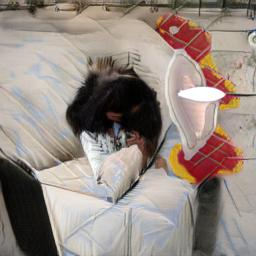

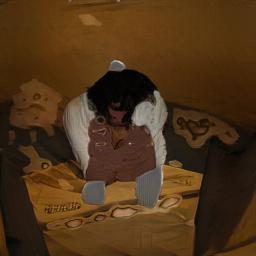

......................................................................
2167.jpg


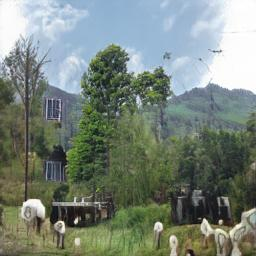

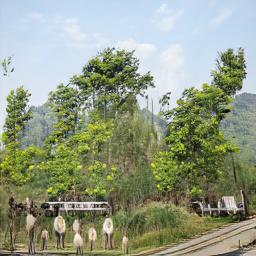

......................................................................
198.jpg


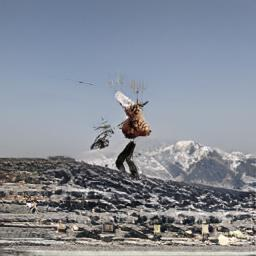

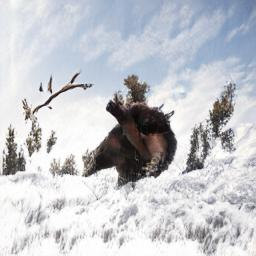

......................................................................
279.jpg


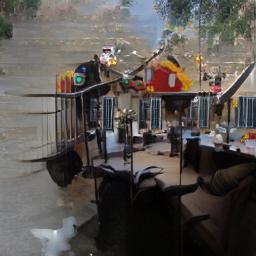

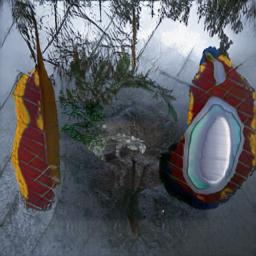

......................................................................
1926.jpg


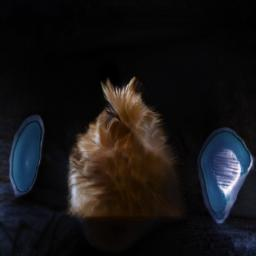

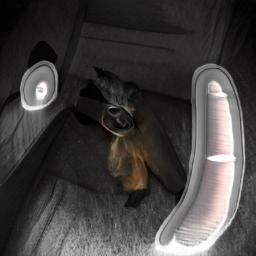

......................................................................
2309.jpg


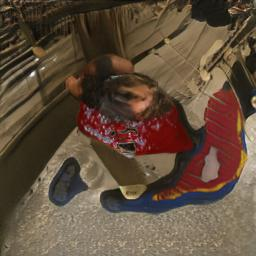

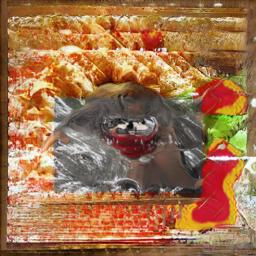

......................................................................
2700.jpg


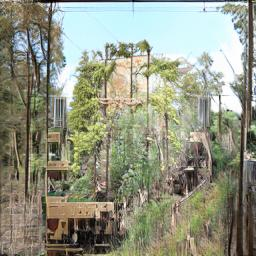

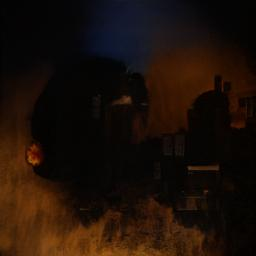

......................................................................
1163.jpg


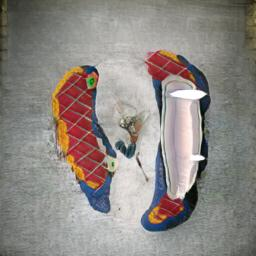

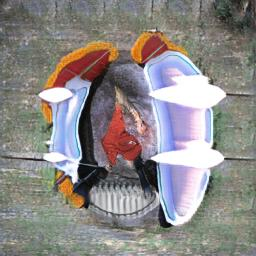

......................................................................
88.jpg


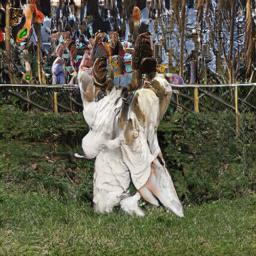

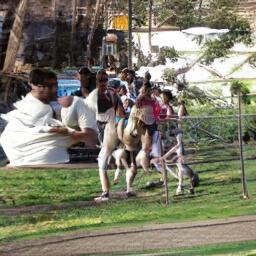

......................................................................
445.jpg


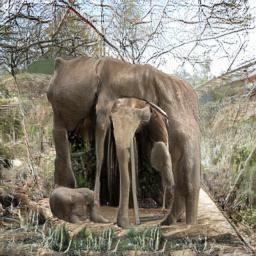

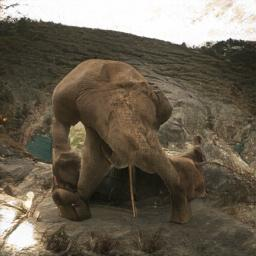

......................................................................
3474.jpg


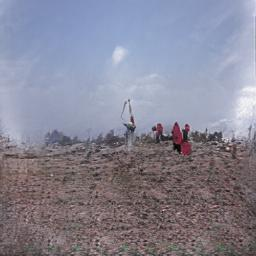

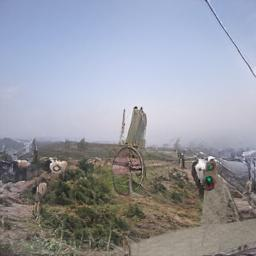

......................................................................
232.jpg


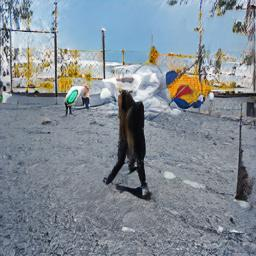

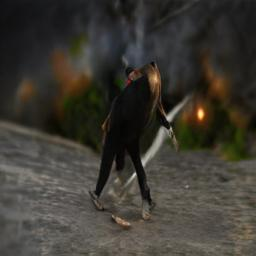

......................................................................
1727.jpg


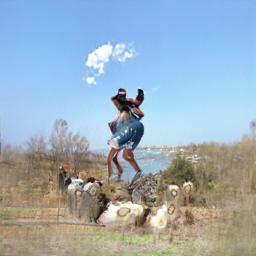

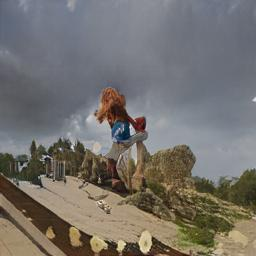

......................................................................
1150.jpg


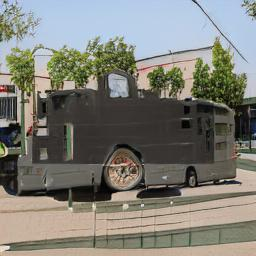

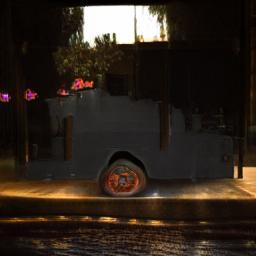

......................................................................
1881.jpg


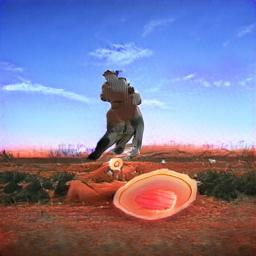

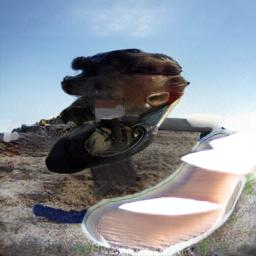

......................................................................
1821.jpg


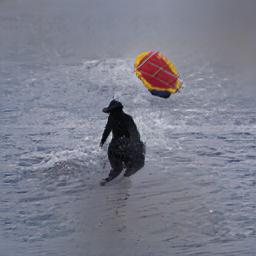

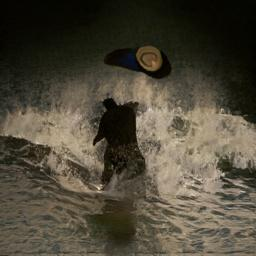

......................................................................
3082.jpg


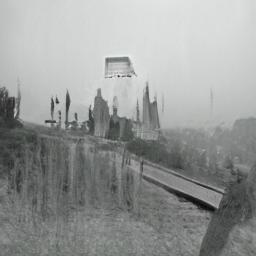

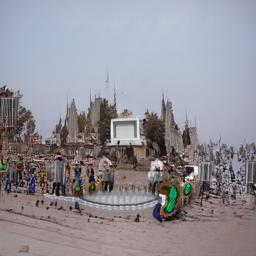

......................................................................
2343.jpg


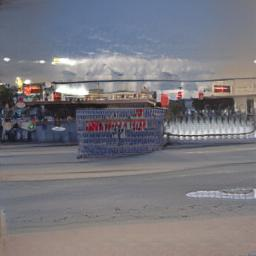

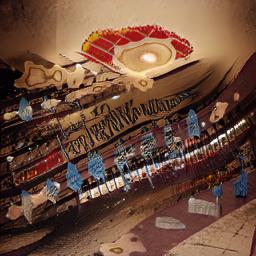

......................................................................
358.jpg


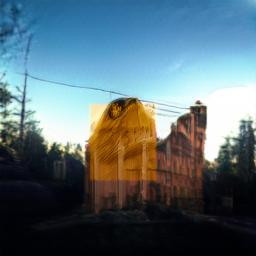

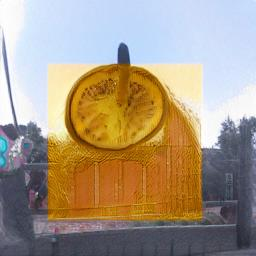

......................................................................
2508.jpg


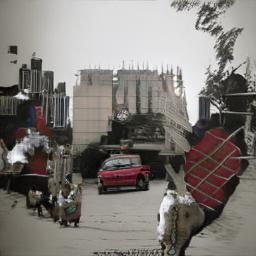

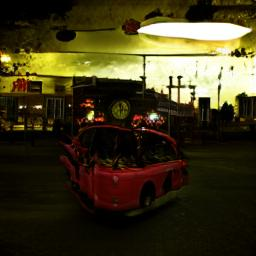

......................................................................
298.jpg


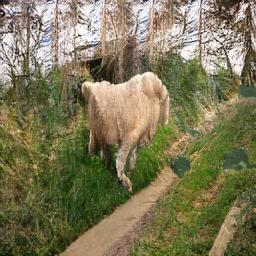

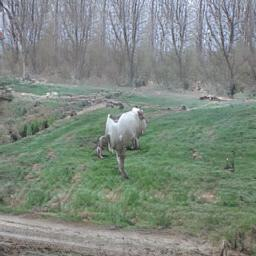

......................................................................
1605.jpg


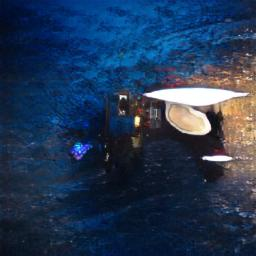

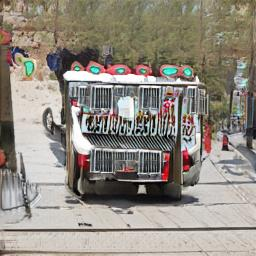

......................................................................
2974.jpg


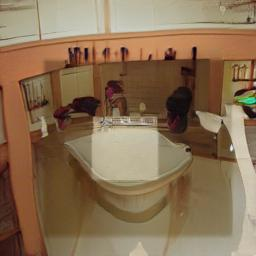

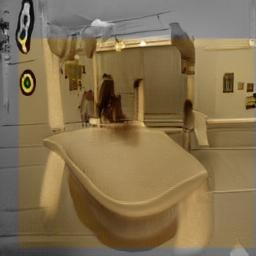

......................................................................
1827.jpg


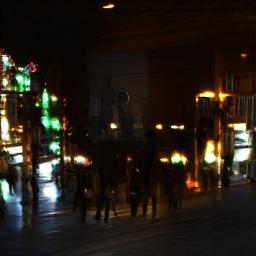

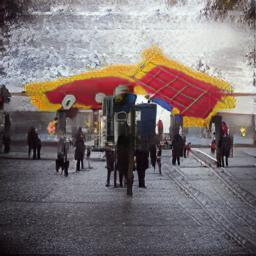

......................................................................
776.jpg


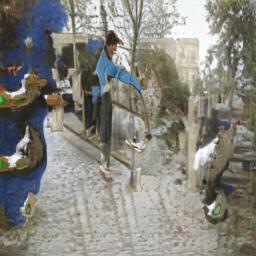

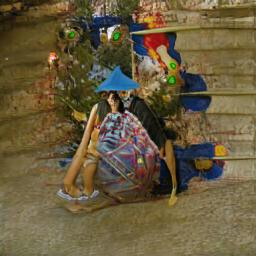

......................................................................
766.jpg


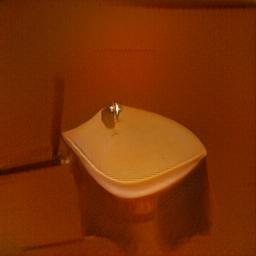

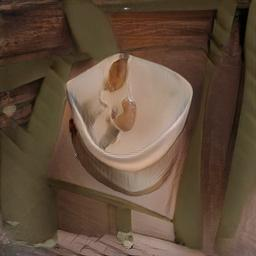

......................................................................
2929.jpg


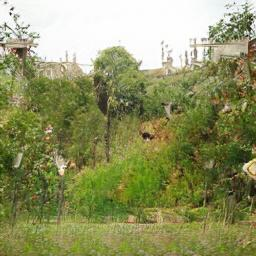

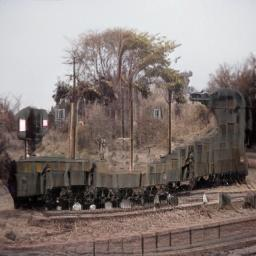

......................................................................
546.jpg


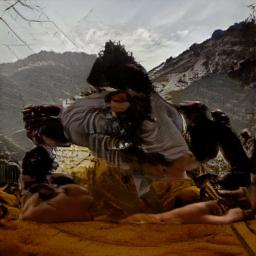

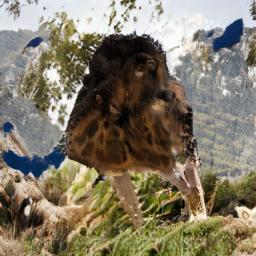

......................................................................
3536.jpg


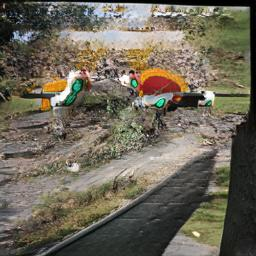

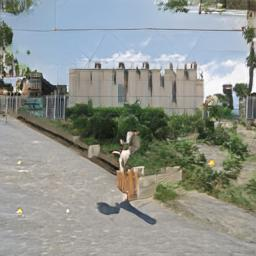

......................................................................
2028.jpg


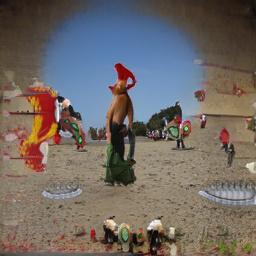

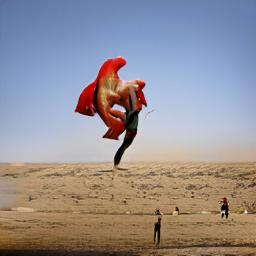

......................................................................
1421.jpg


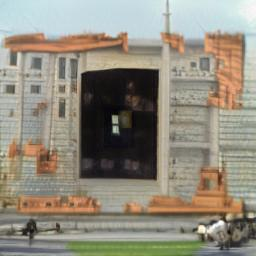

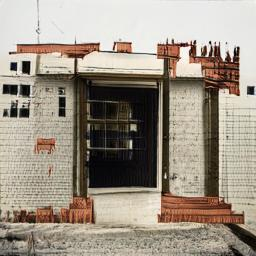

......................................................................
1198.jpg


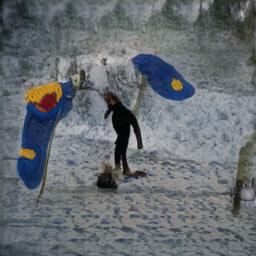

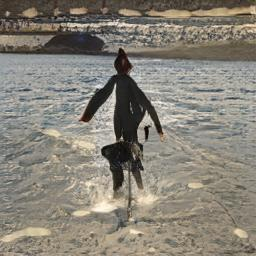

......................................................................
161.jpg


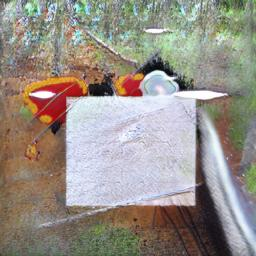

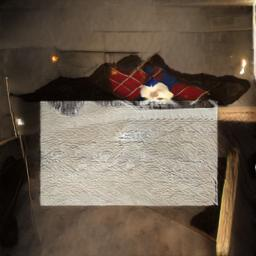

......................................................................
419.jpg


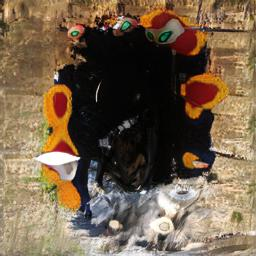

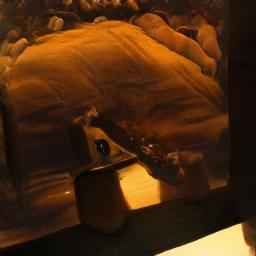

......................................................................
640.jpg


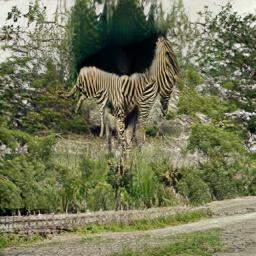

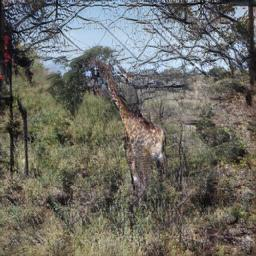

......................................................................
914.jpg


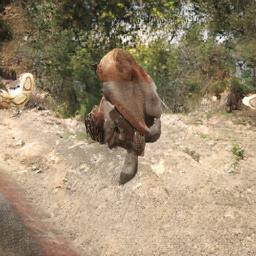

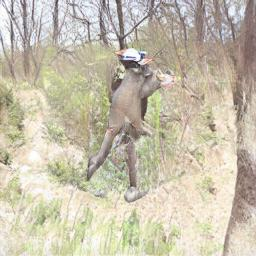

......................................................................
3362.jpg


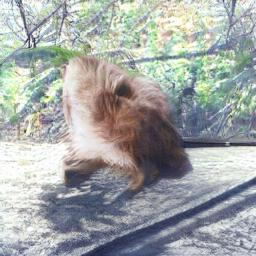

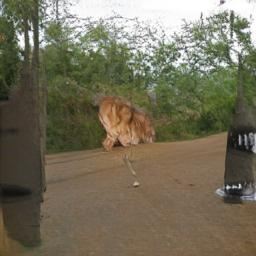

......................................................................
3376.jpg


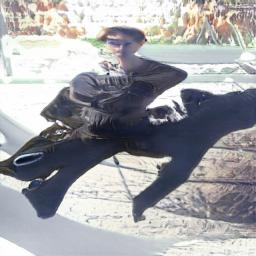

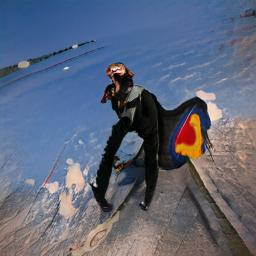

......................................................................
149.jpg


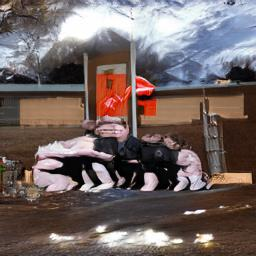

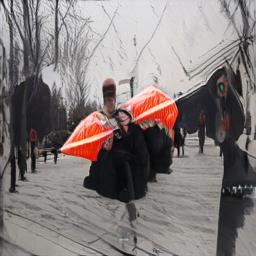

......................................................................
3359.jpg


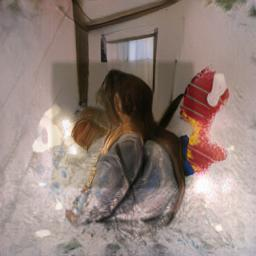

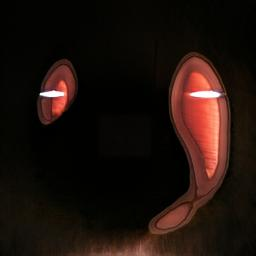

......................................................................
2296.jpg


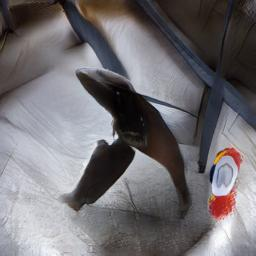

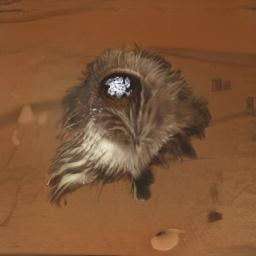

......................................................................
2192.jpg


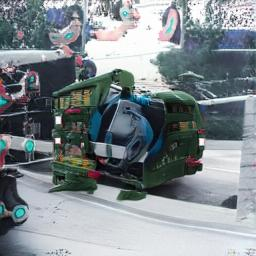

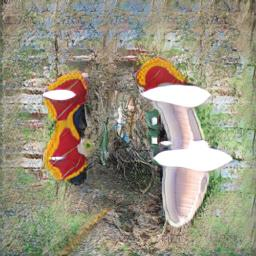

......................................................................
3443.jpg


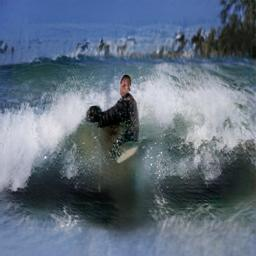

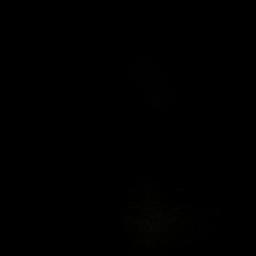

......................................................................
3401.jpg


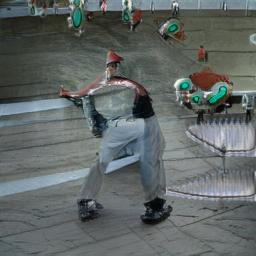

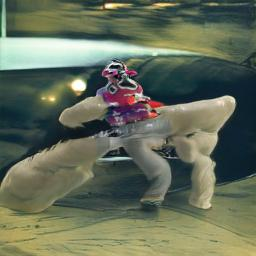

......................................................................
792.jpg


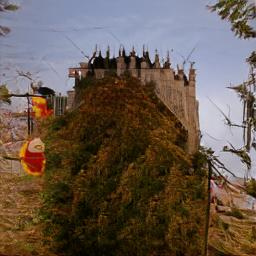

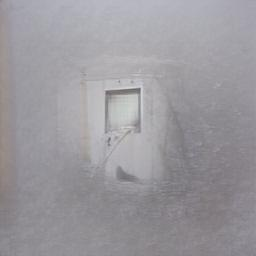

......................................................................
1681.jpg


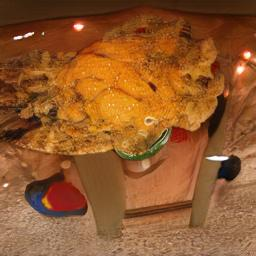

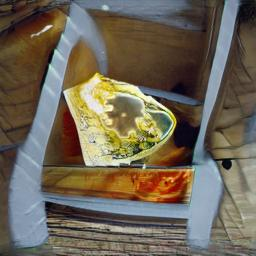

......................................................................
1439.jpg


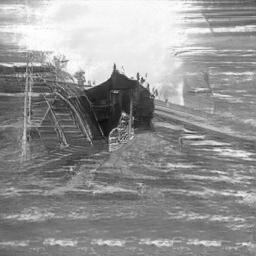

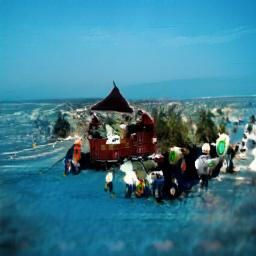

......................................................................
2754.jpg


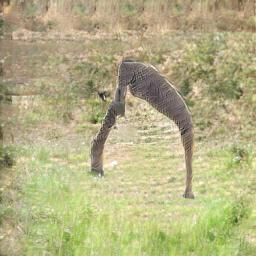

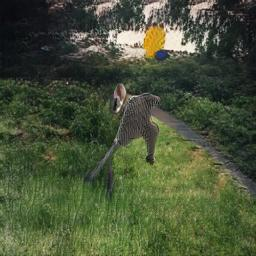

......................................................................
1152.jpg


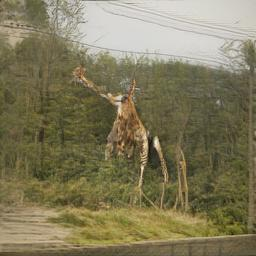

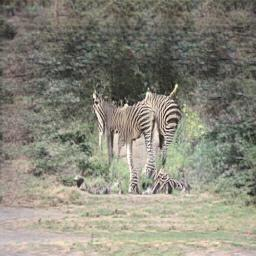

......................................................................
1700.jpg


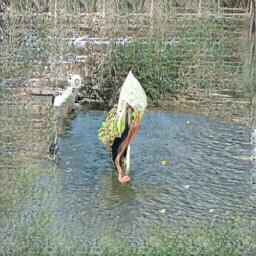

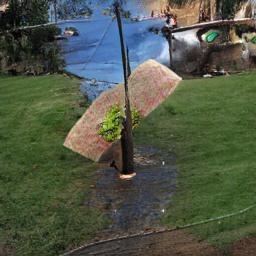

......................................................................
1759.jpg


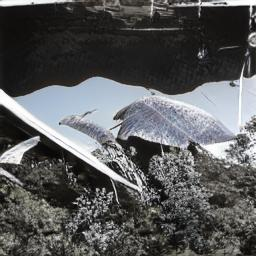

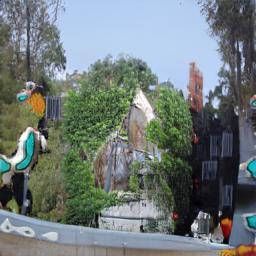

......................................................................
1377.jpg


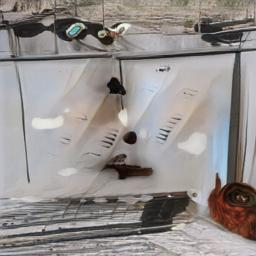

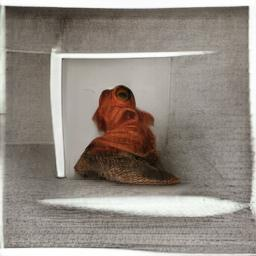

......................................................................
3559.jpg


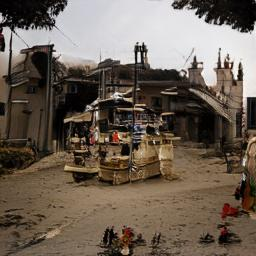

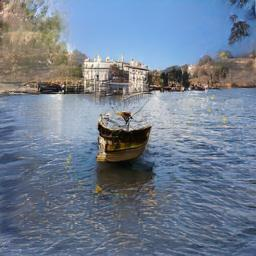

......................................................................
2520.jpg


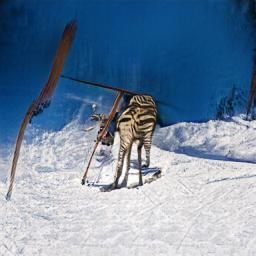

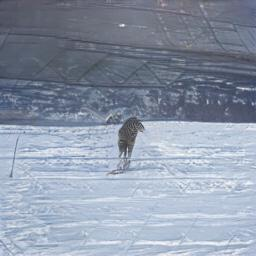

......................................................................
1453.jpg


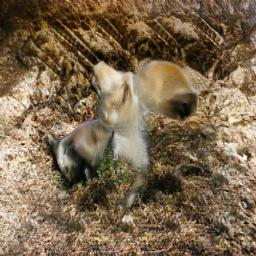

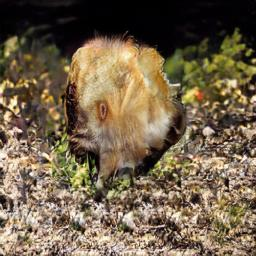

......................................................................
1248.jpg


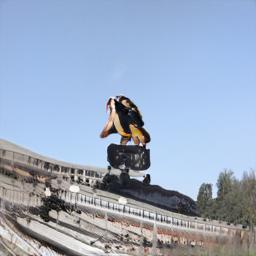

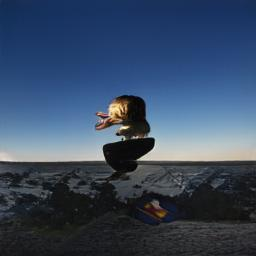

......................................................................
742.jpg


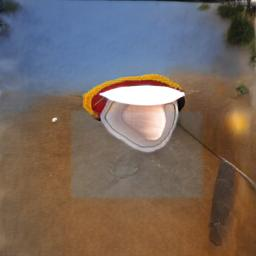

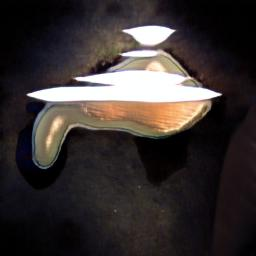

......................................................................
3512.jpg


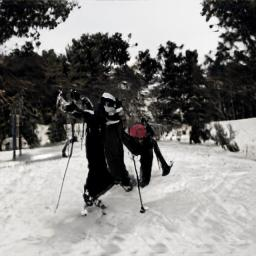

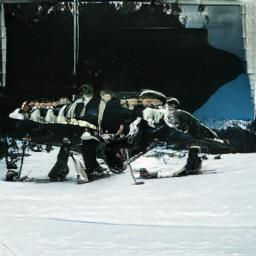

......................................................................
1887.jpg


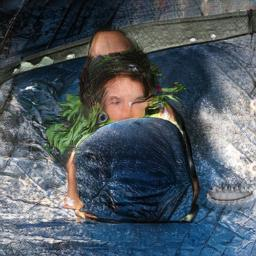

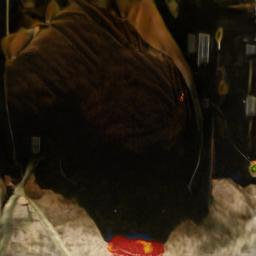

......................................................................
3481.jpg


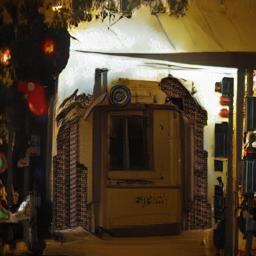

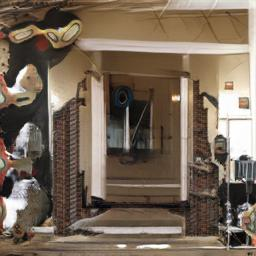

......................................................................
1302.jpg


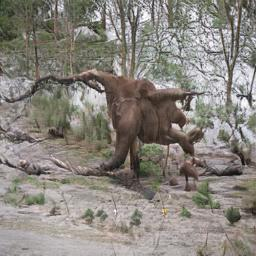

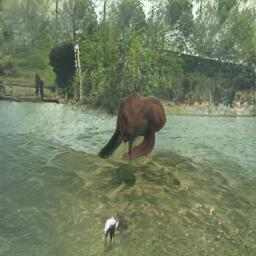

......................................................................
3383.jpg


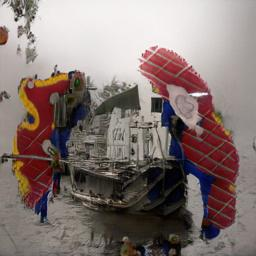

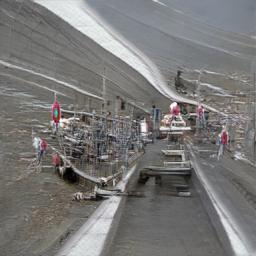

......................................................................
2334.jpg


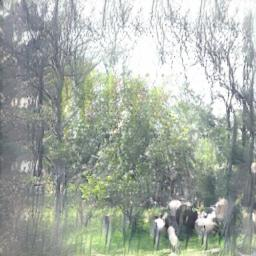

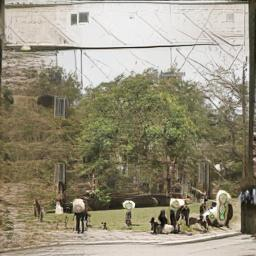

......................................................................
3469.jpg


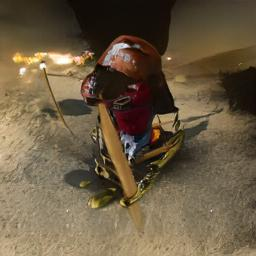

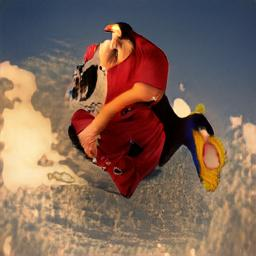

......................................................................
542.jpg


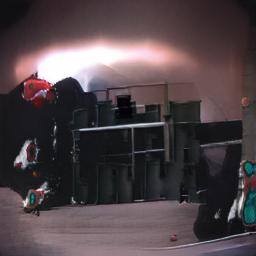

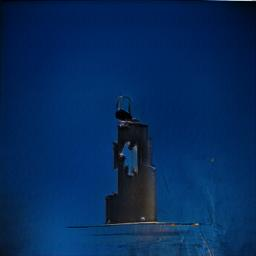

......................................................................
510.jpg


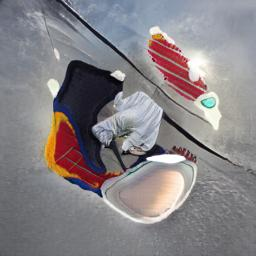

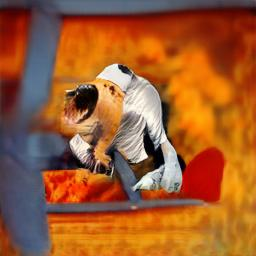

......................................................................
80.jpg


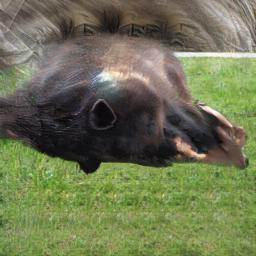

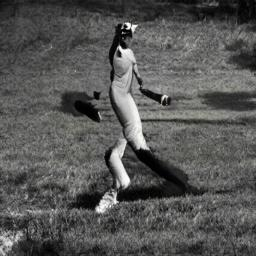

......................................................................
777.jpg


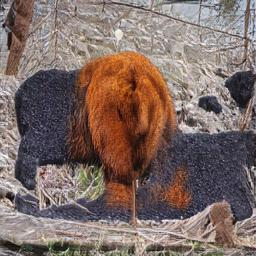

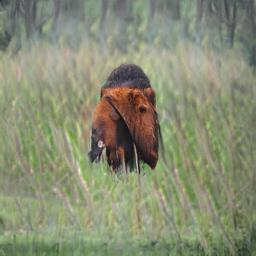

......................................................................
593.jpg


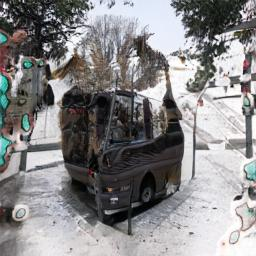

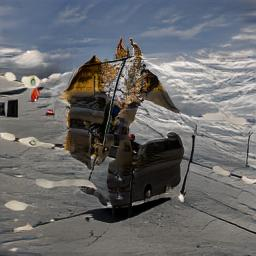

......................................................................
3052.jpg


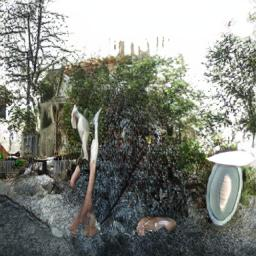

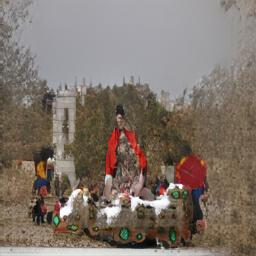

......................................................................
2137.jpg


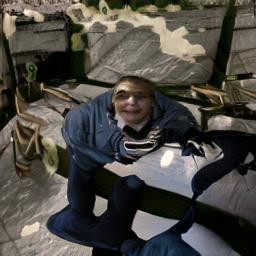

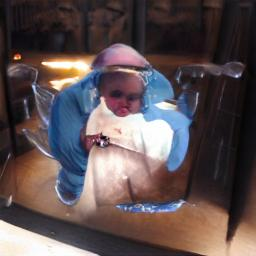

......................................................................
2012.jpg


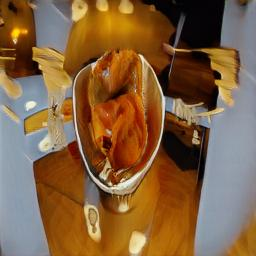

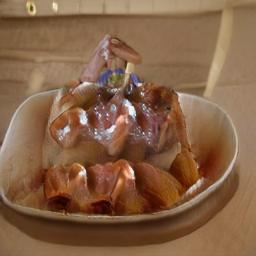

......................................................................
1309.jpg


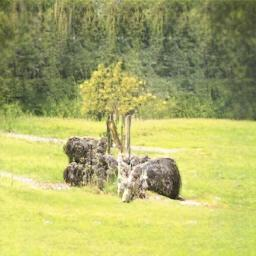

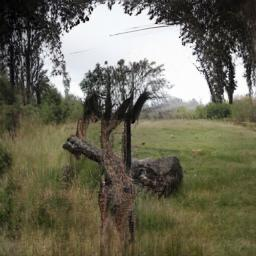

......................................................................
1964.jpg


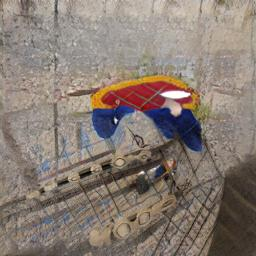

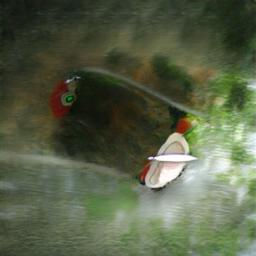

......................................................................
235.jpg


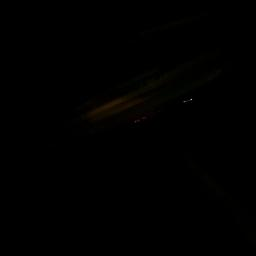

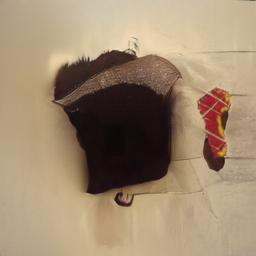

......................................................................
1877.jpg


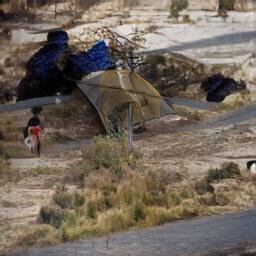

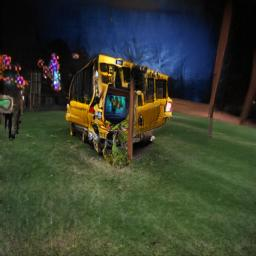

......................................................................
3192.jpg


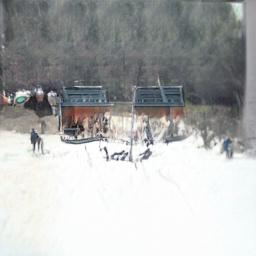

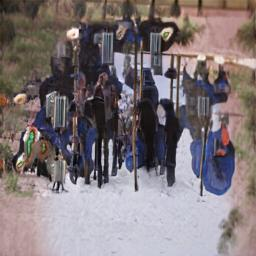

......................................................................
3000.jpg


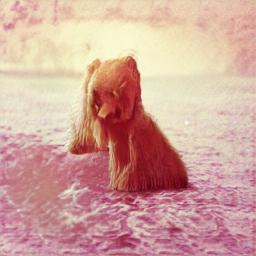

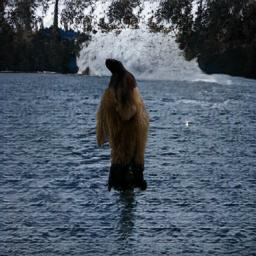

......................................................................
1209.jpg


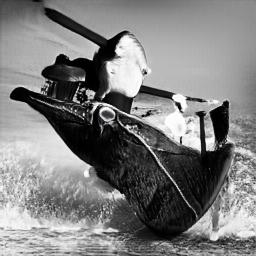

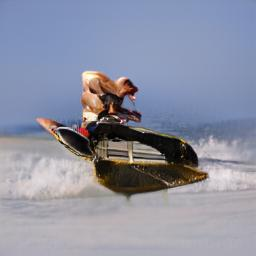

......................................................................
2033.jpg


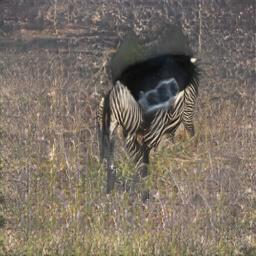

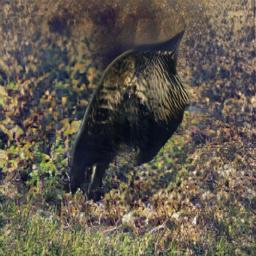

......................................................................
1202.jpg


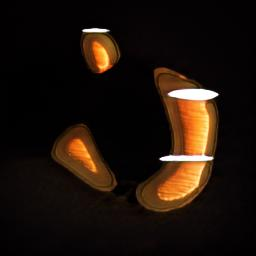

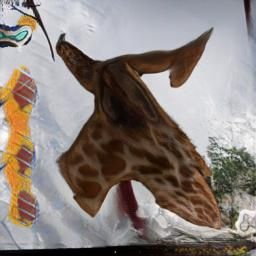

......................................................................
709.jpg


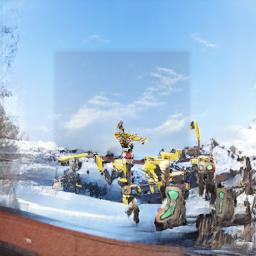

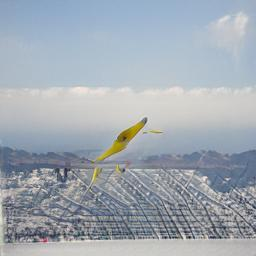

......................................................................
3498.jpg


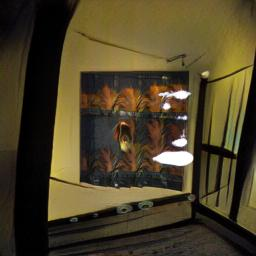

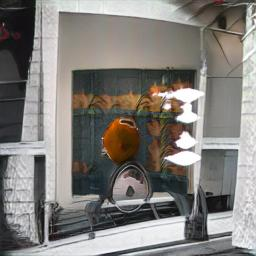

......................................................................
1257.jpg


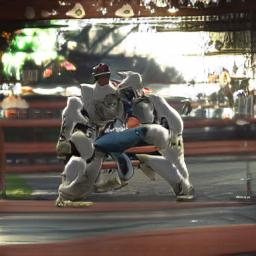

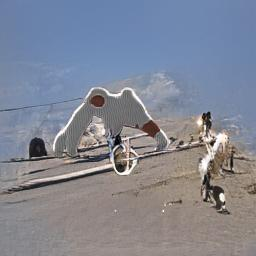

......................................................................
813.jpg


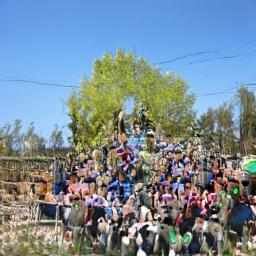

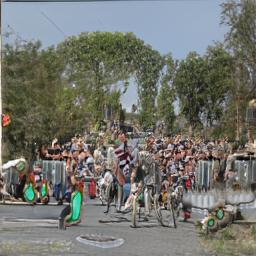

......................................................................
1127.jpg


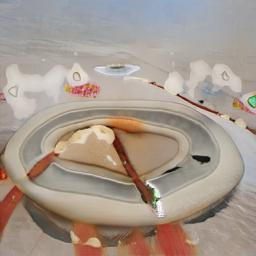

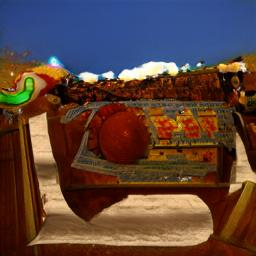

......................................................................
534.jpg


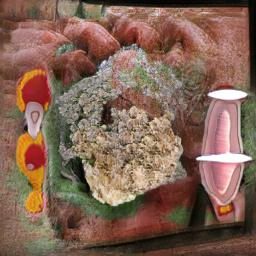

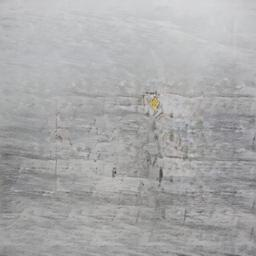

......................................................................
2757.jpg


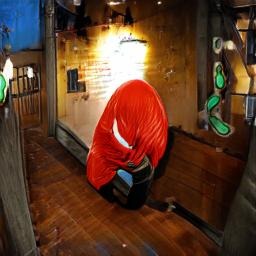

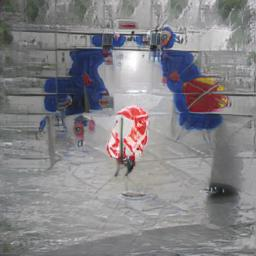

......................................................................
728.jpg


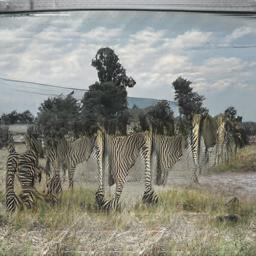

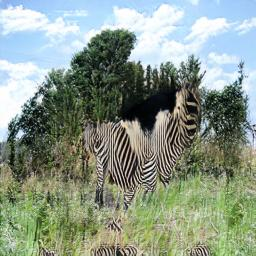

......................................................................
2216.jpg


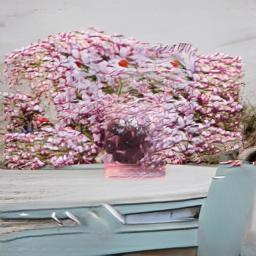

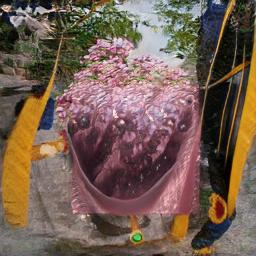

......................................................................
3494.jpg


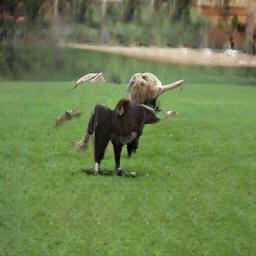

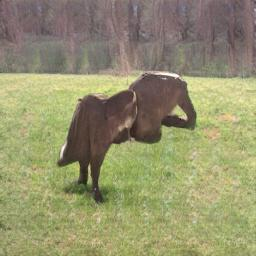

......................................................................
889.jpg


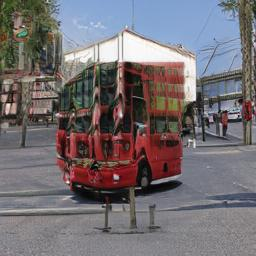

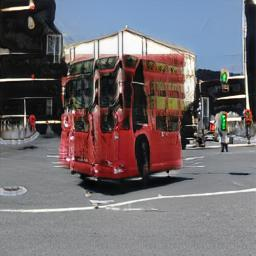

......................................................................
1351.jpg


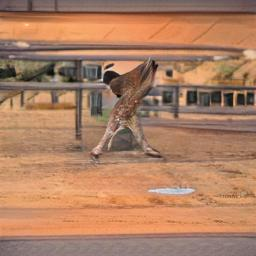

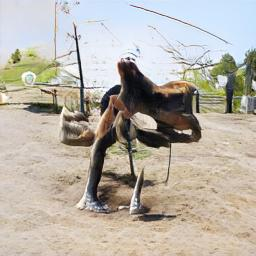

......................................................................
535.jpg


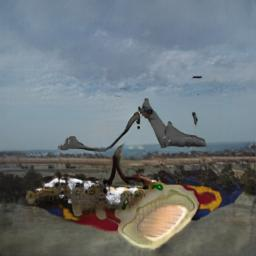

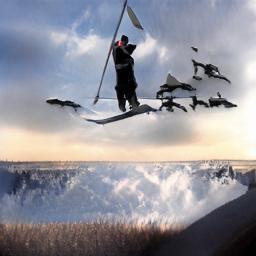

......................................................................
1436.jpg


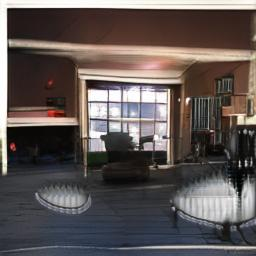

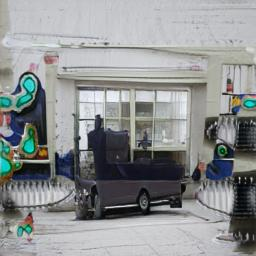

......................................................................
312.jpg


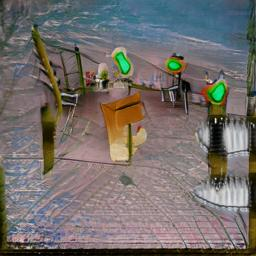

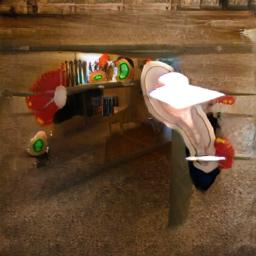

......................................................................
2076.jpg


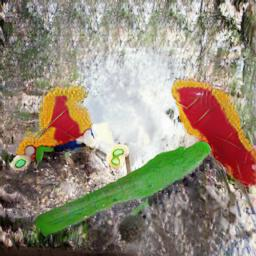

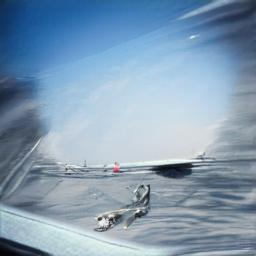

......................................................................
3164.jpg


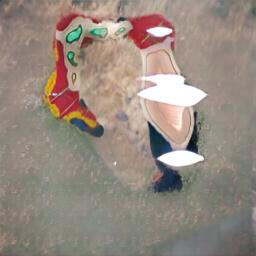

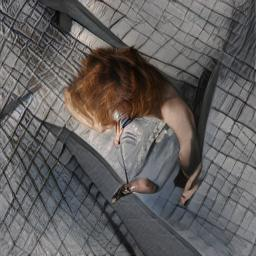

......................................................................
406.jpg


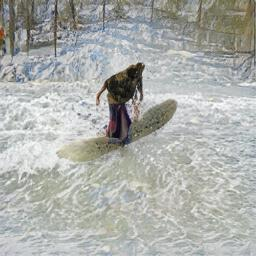

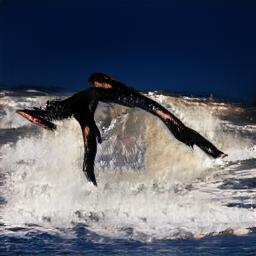

......................................................................
619.jpg


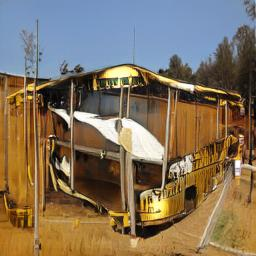

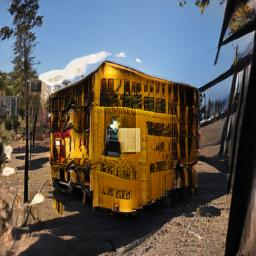

......................................................................
2270.jpg


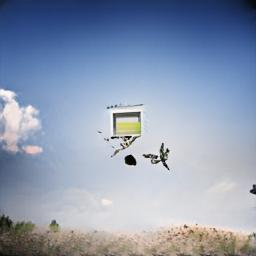

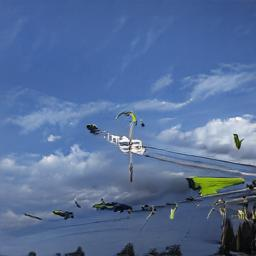

......................................................................
3308.jpg


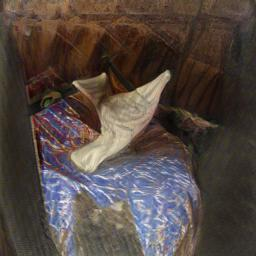

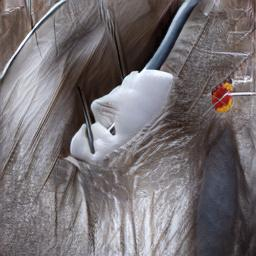

......................................................................
216.jpg


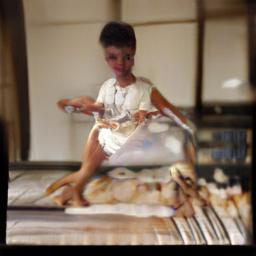

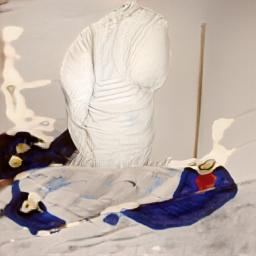

......................................................................
2084.jpg


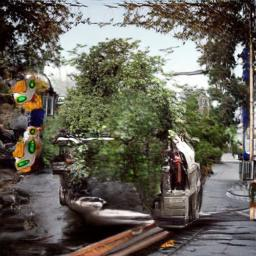

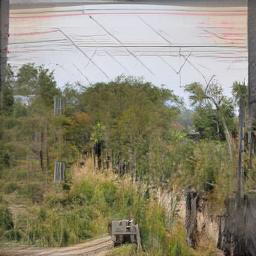

......................................................................
2531.jpg


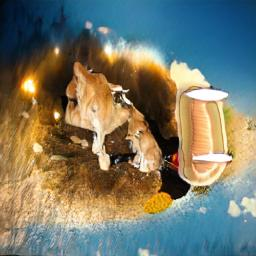

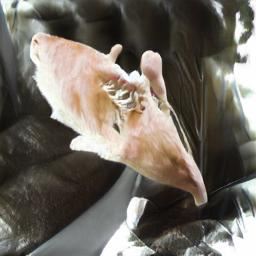

......................................................................
2927.jpg


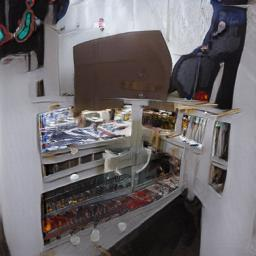

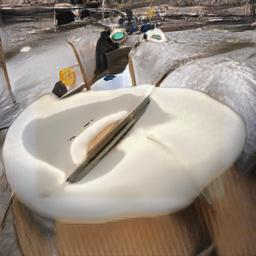

......................................................................
489.jpg


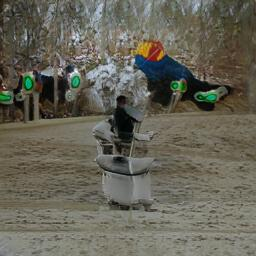

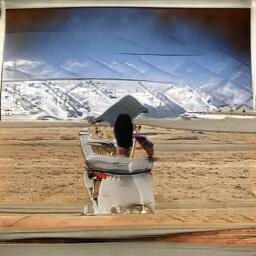

......................................................................
165.jpg


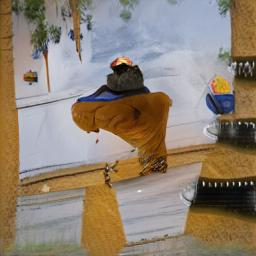

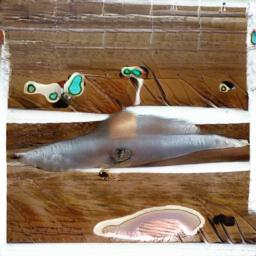

......................................................................
231.jpg


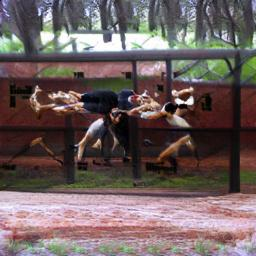

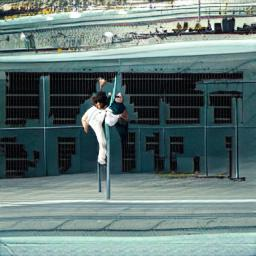

......................................................................
2726.jpg


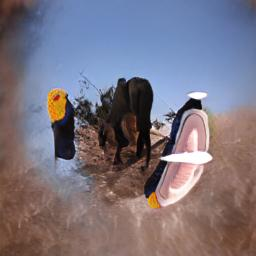

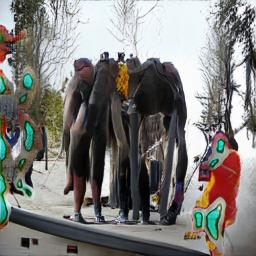

......................................................................
637.jpg


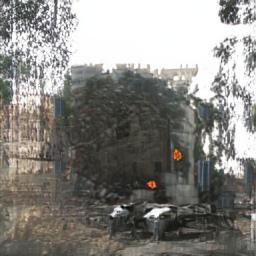

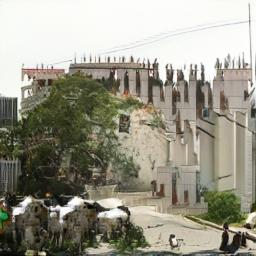

......................................................................
1572.jpg


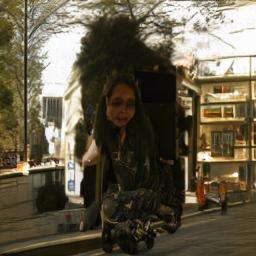

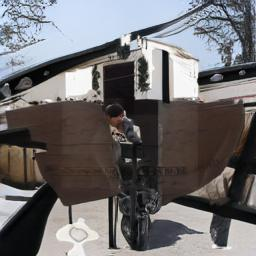

......................................................................
1203.jpg


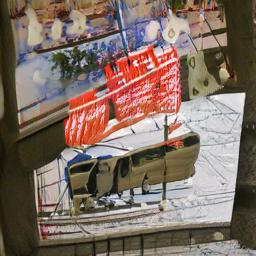

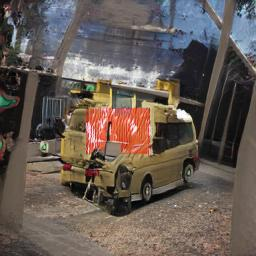

......................................................................
1452.jpg


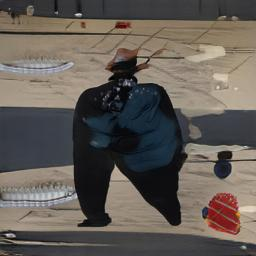

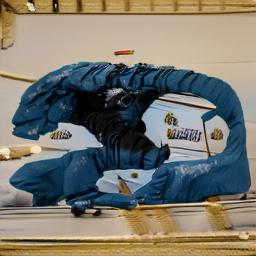

......................................................................
1531.jpg


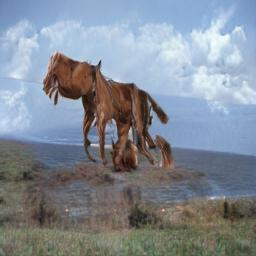

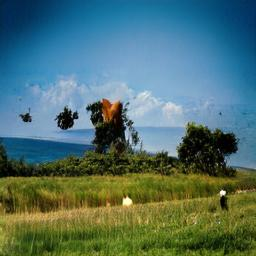

......................................................................
2254.jpg


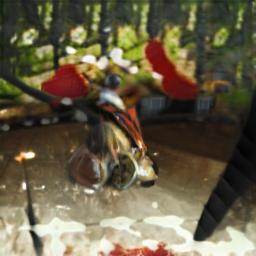

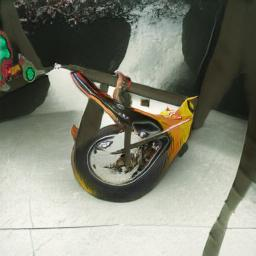

......................................................................
929.jpg


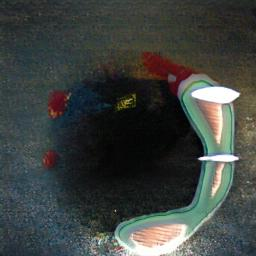

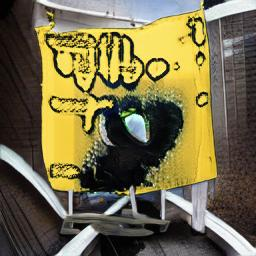

......................................................................
668.jpg


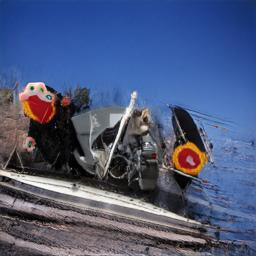

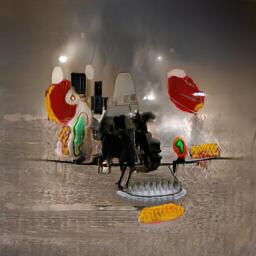

......................................................................
2017.jpg


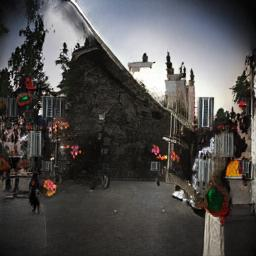

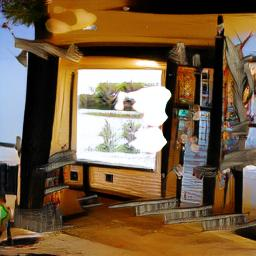

......................................................................
2398.jpg


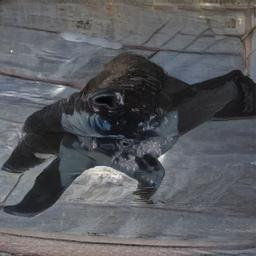

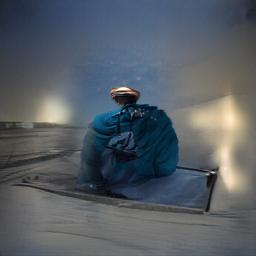

......................................................................
324.jpg


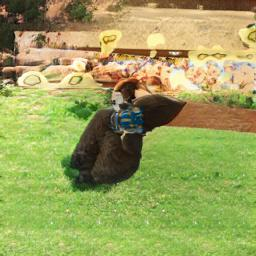

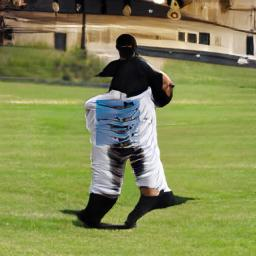

......................................................................
3149.jpg


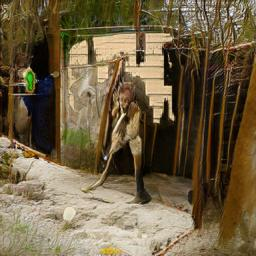

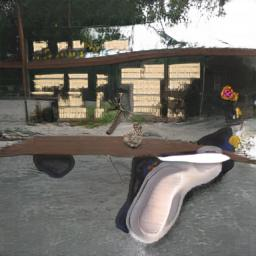

......................................................................
3590.jpg


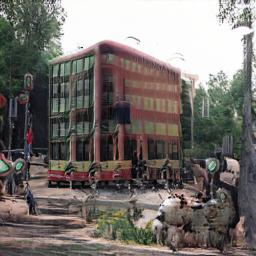

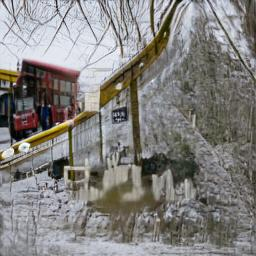

......................................................................
1884.jpg


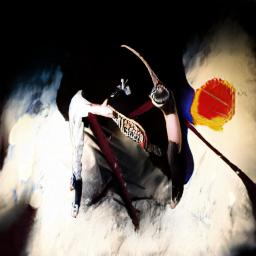

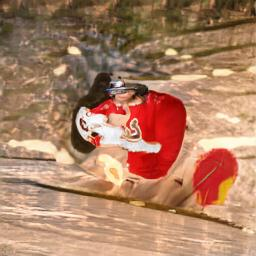

......................................................................
3271.jpg


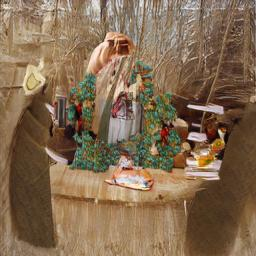

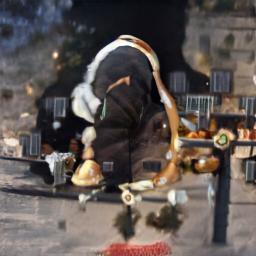

......................................................................
345.jpg


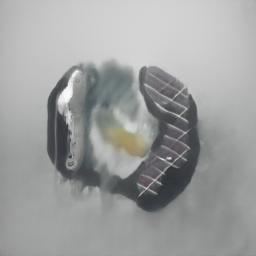

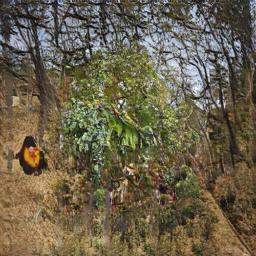

......................................................................
2701.jpg


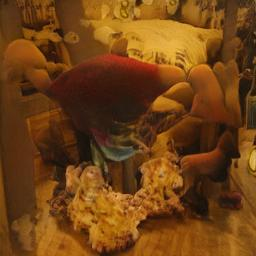

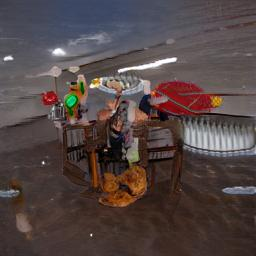

......................................................................
2728.jpg


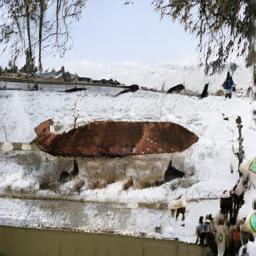

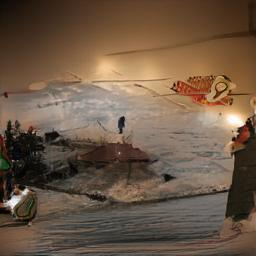

......................................................................
1595.jpg


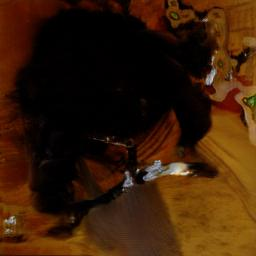

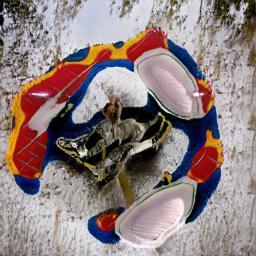

......................................................................
1472.jpg


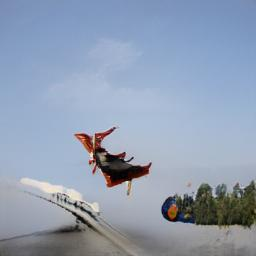

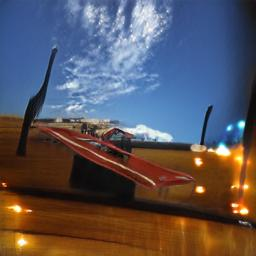

......................................................................
1015.jpg


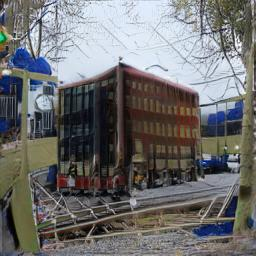

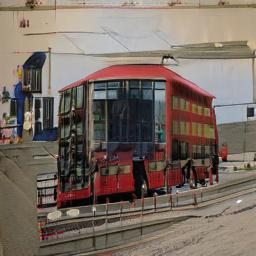

......................................................................
817.jpg


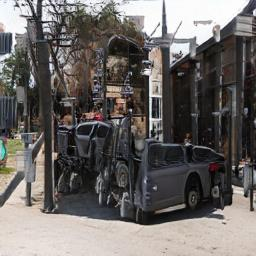

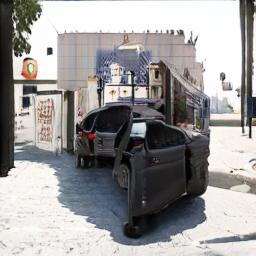

......................................................................
615.jpg


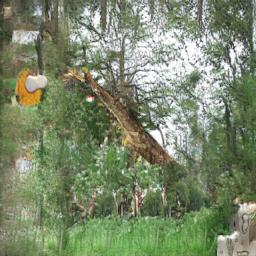

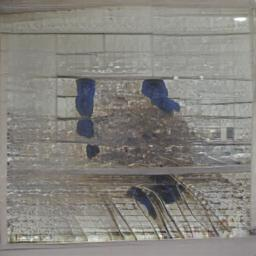

......................................................................
2074.jpg


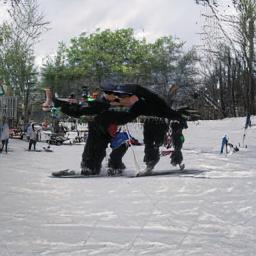

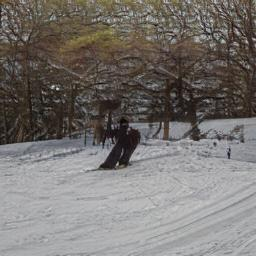

......................................................................
2496.jpg


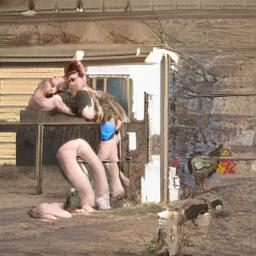

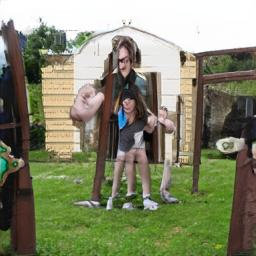

......................................................................
820.jpg


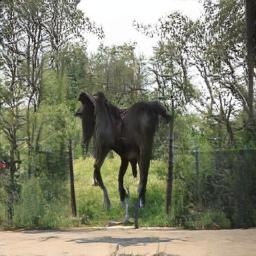

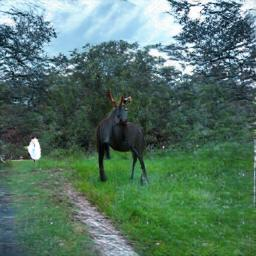

......................................................................
1758.jpg


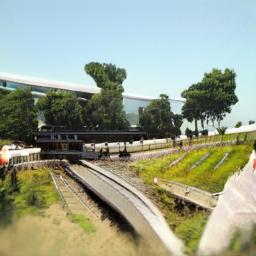

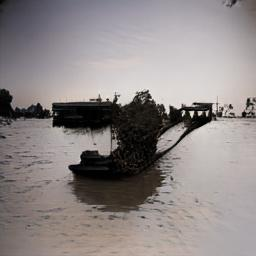

......................................................................
2983.jpg


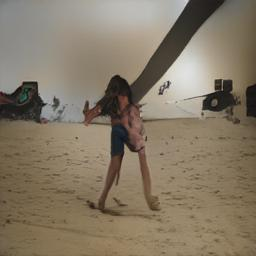

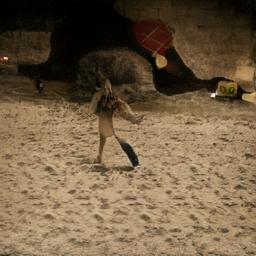

......................................................................
1709.jpg


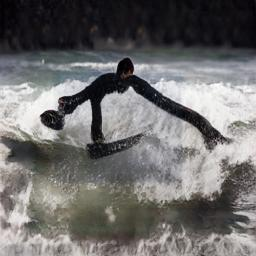

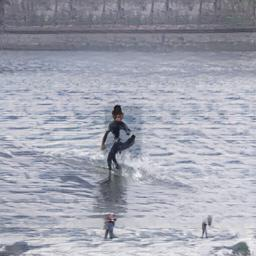

......................................................................
1129.jpg


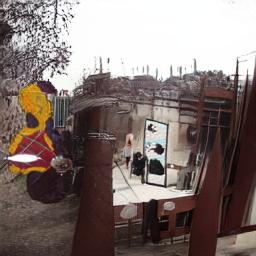

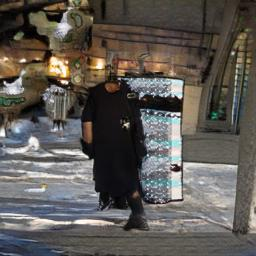

......................................................................
100.jpg


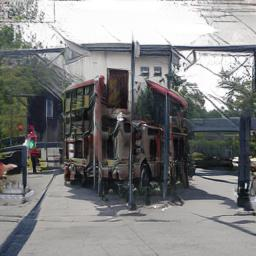

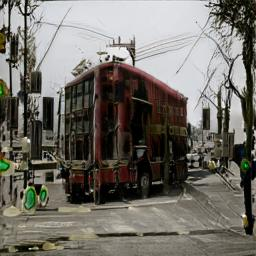

......................................................................
3573.jpg


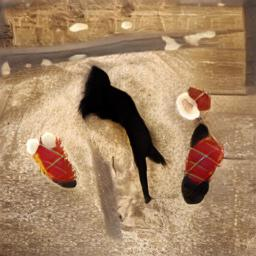

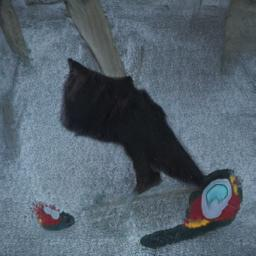

......................................................................
2457.jpg


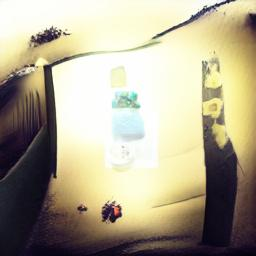

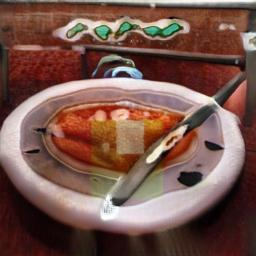

......................................................................
2548.jpg


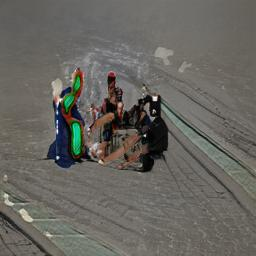

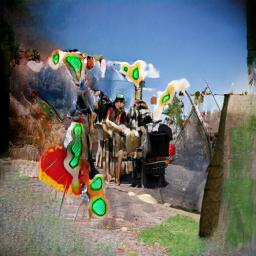

......................................................................
3413.jpg


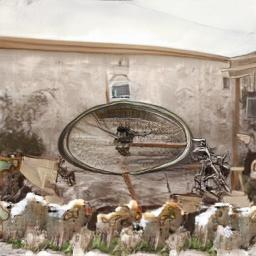

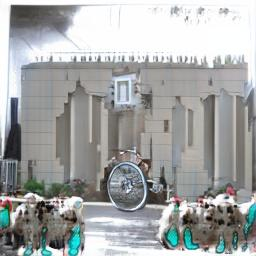

......................................................................
518.jpg


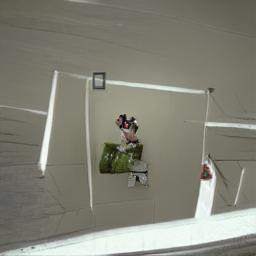

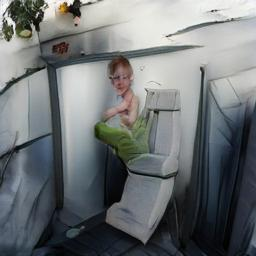

......................................................................
654.jpg


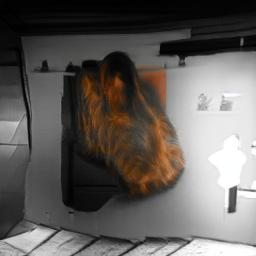

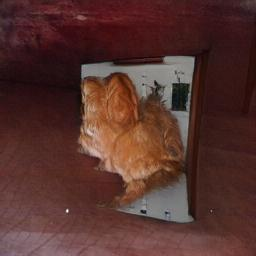

......................................................................
953.jpg


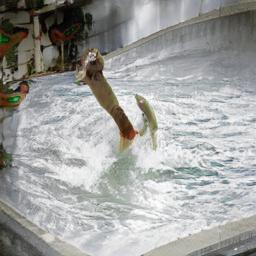

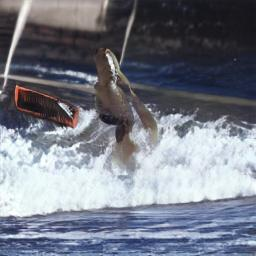

......................................................................
1615.jpg


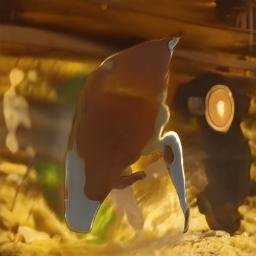

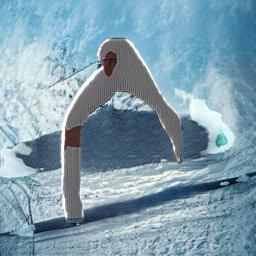

......................................................................
2888.jpg


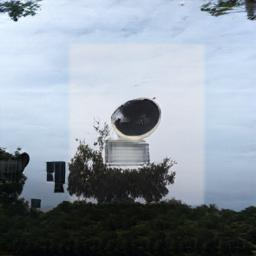

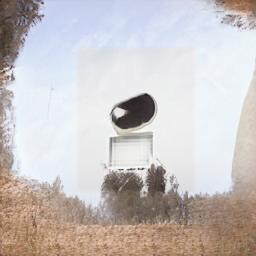

......................................................................
471.jpg


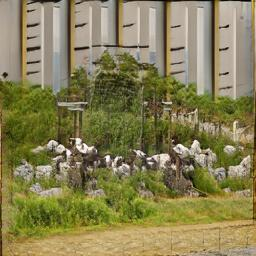

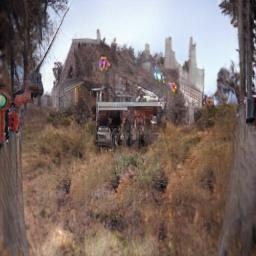

......................................................................
2355.jpg


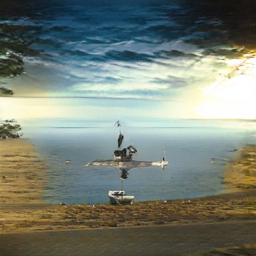

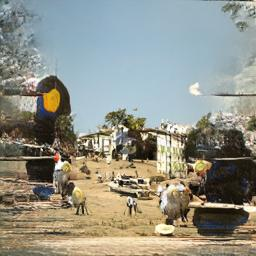

......................................................................
2792.jpg


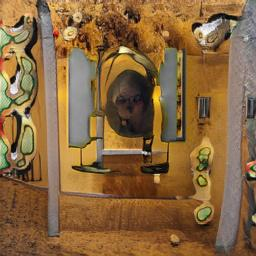

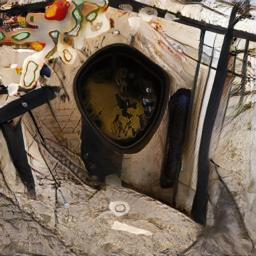

......................................................................
1978.jpg


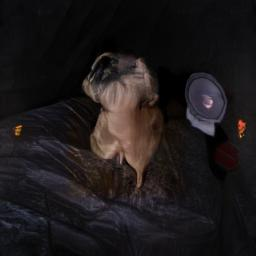

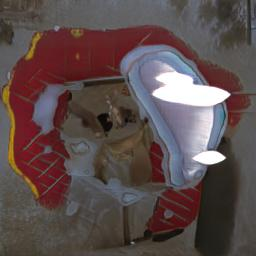

......................................................................
711.jpg


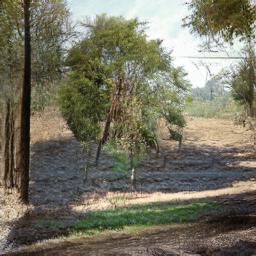

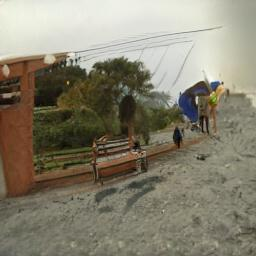

......................................................................
2195.jpg


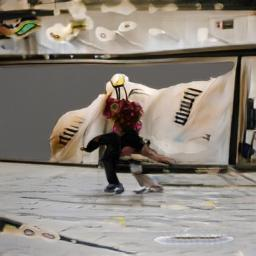

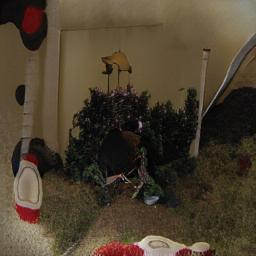

......................................................................
1350.jpg


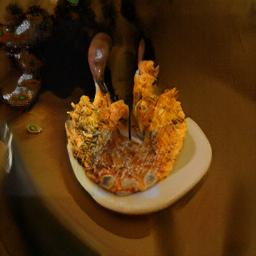

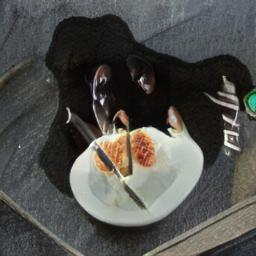

......................................................................
1437.jpg


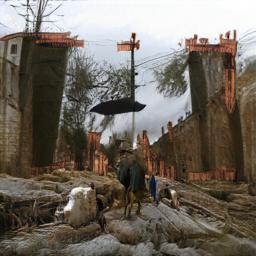

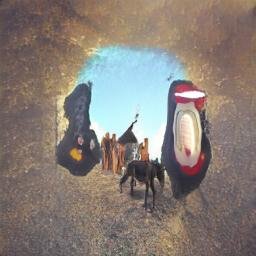

......................................................................
2637.jpg


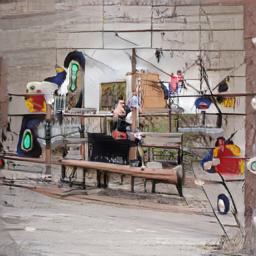

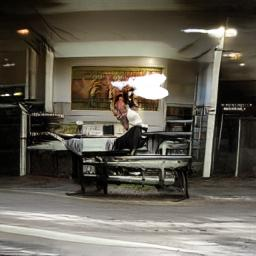

......................................................................
2183.jpg


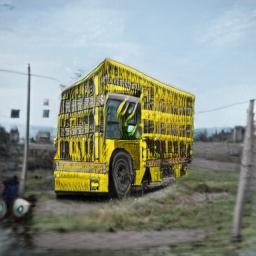

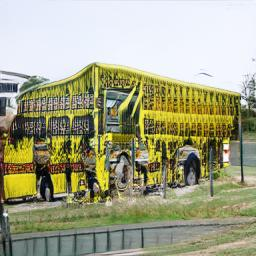

......................................................................
717.jpg


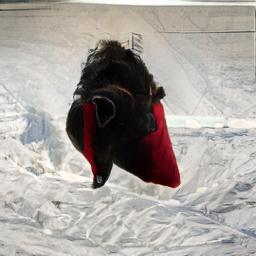

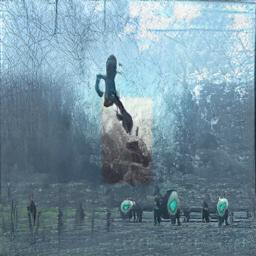

......................................................................
1462.jpg


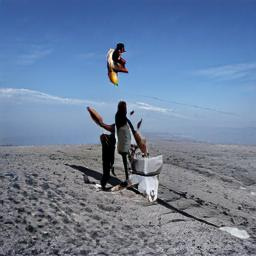

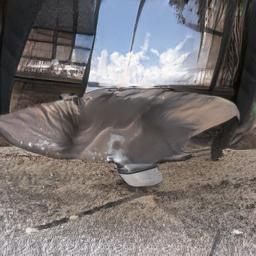

......................................................................
993.jpg


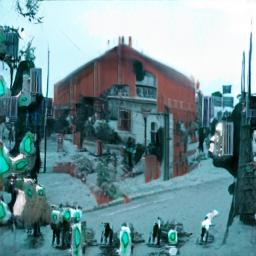

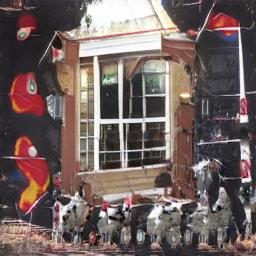

......................................................................
2060.jpg


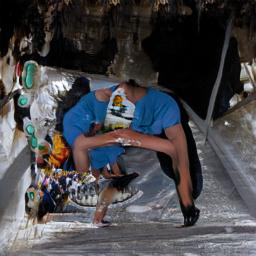

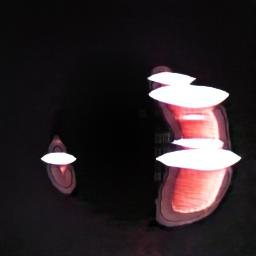

......................................................................
2272.jpg


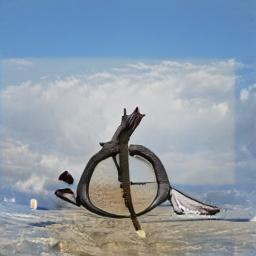

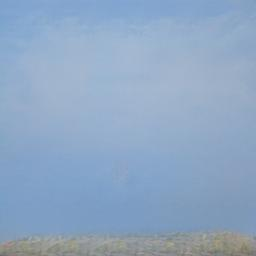

......................................................................
1177.jpg


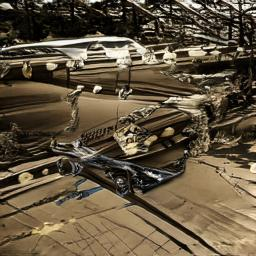

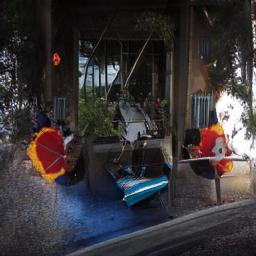

......................................................................
2320.jpg


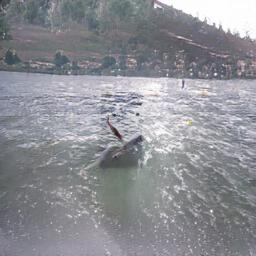

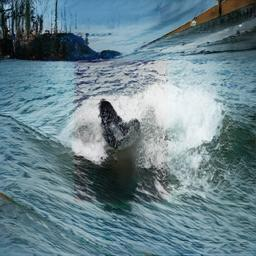

......................................................................
2138.jpg


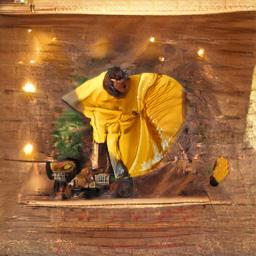

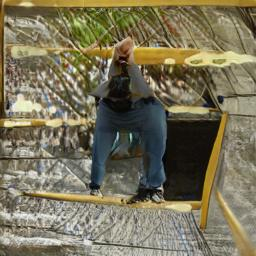

......................................................................
2996.jpg


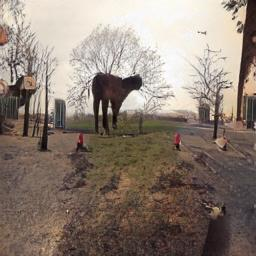

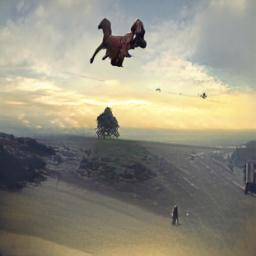

......................................................................
136.jpg


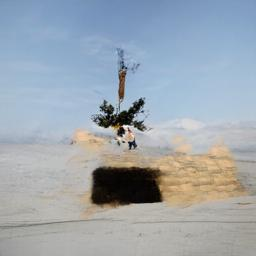

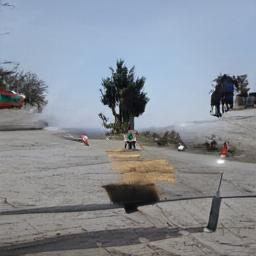

......................................................................
1423.jpg


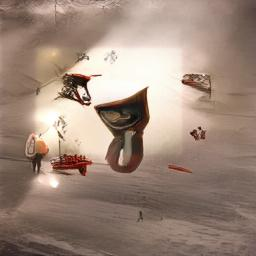

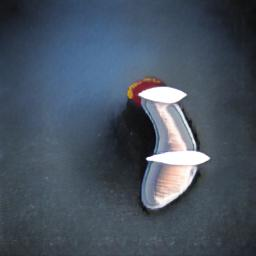

......................................................................
491.jpg


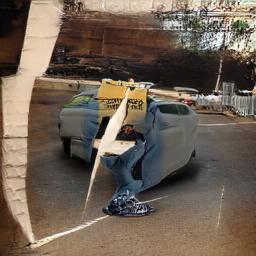

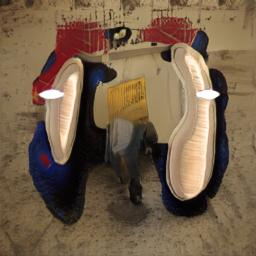

......................................................................
1476.jpg


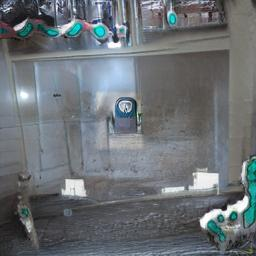

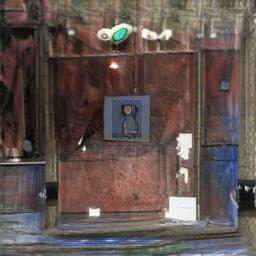

......................................................................
2826.jpg


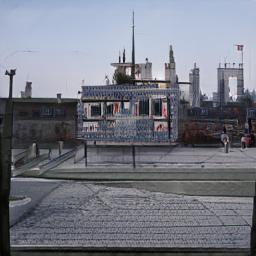

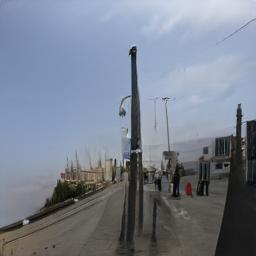

......................................................................
601.jpg


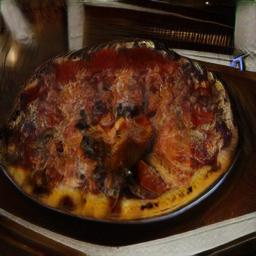

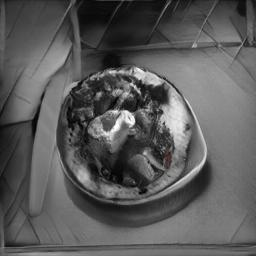

......................................................................
3355.jpg


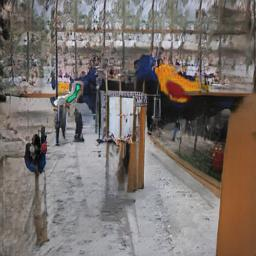

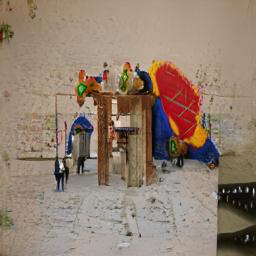

......................................................................
1942.jpg


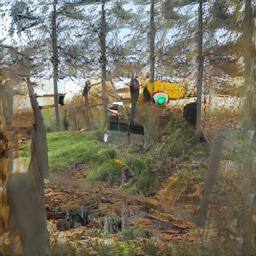

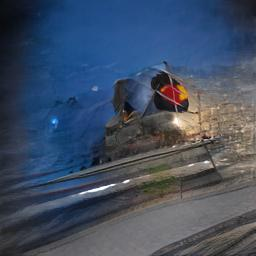

......................................................................
2461.jpg


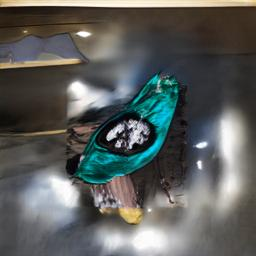

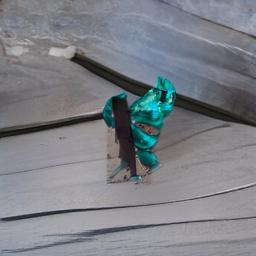

......................................................................
3109.jpg


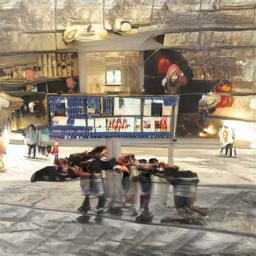

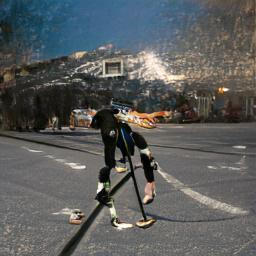

......................................................................
2315.jpg


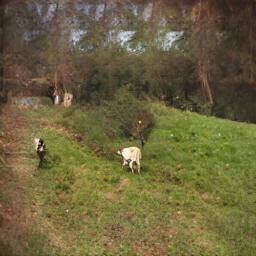

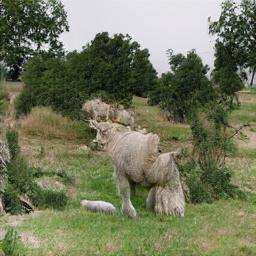

......................................................................
2803.jpg


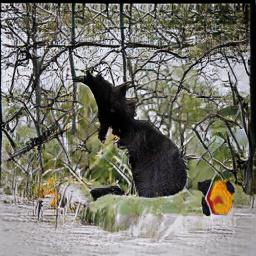

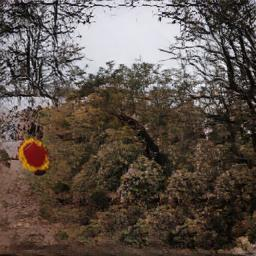

......................................................................
1033.jpg


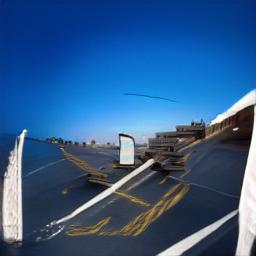

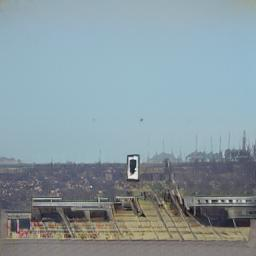

......................................................................
1763.jpg


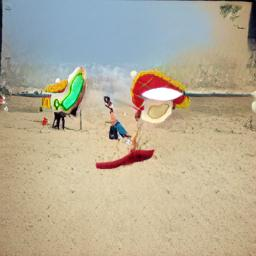

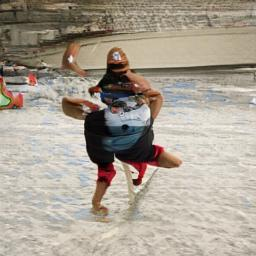

......................................................................
2673.jpg


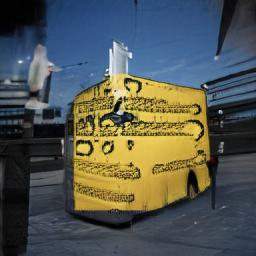

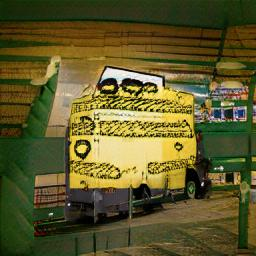

......................................................................
1633.jpg


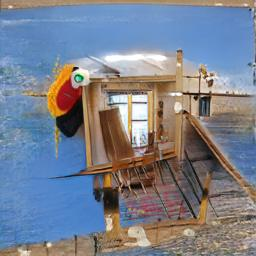

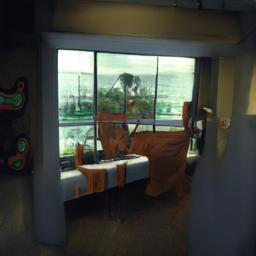

......................................................................
1769.jpg


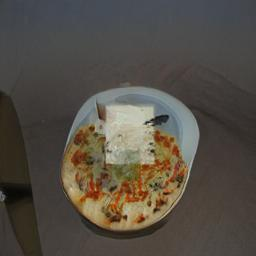

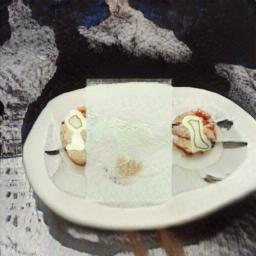

......................................................................
3285.jpg


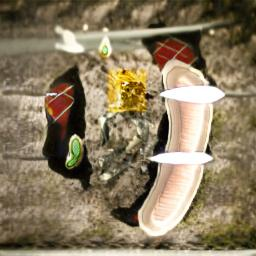

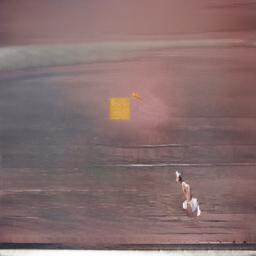

......................................................................
2016.jpg


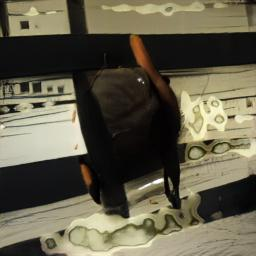

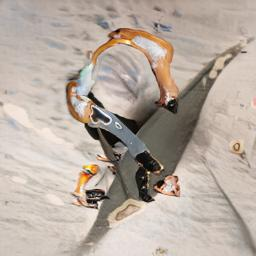

......................................................................
2835.jpg


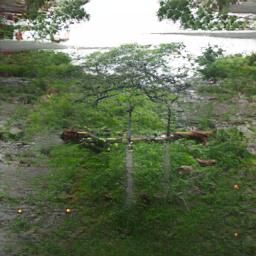

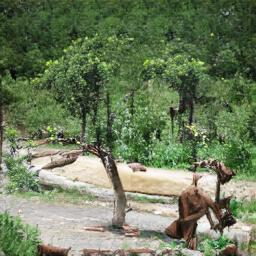

......................................................................
1750.jpg


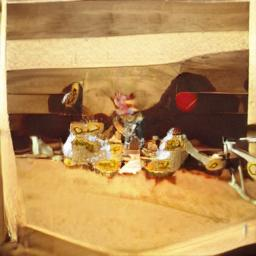

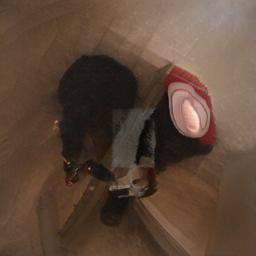

......................................................................
2071.jpg


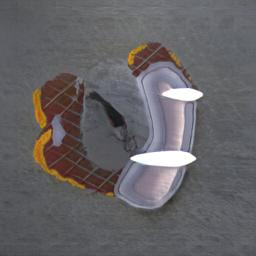

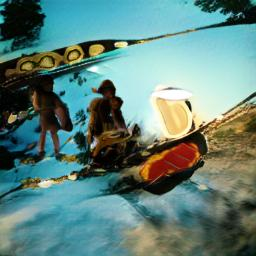

......................................................................
1638.jpg


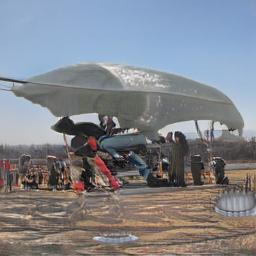

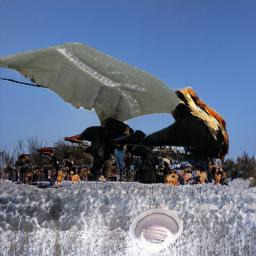

......................................................................
3577.jpg


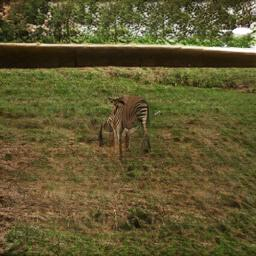

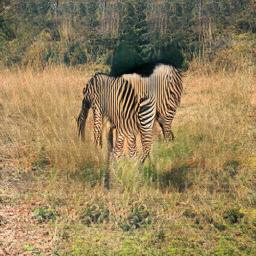

......................................................................
780.jpg


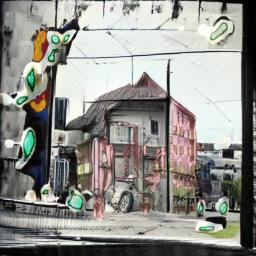

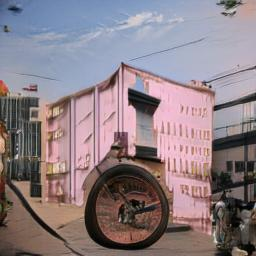

......................................................................
2997.jpg


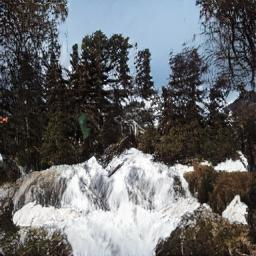

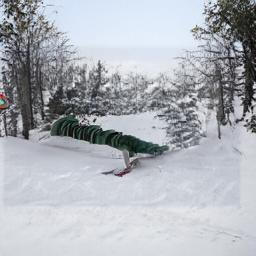

......................................................................
97.jpg


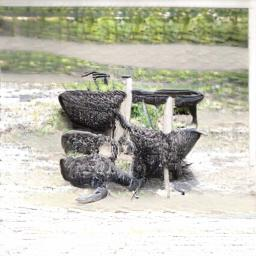

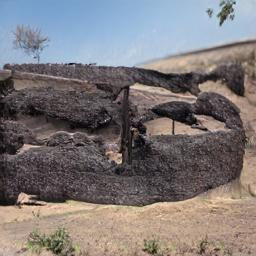

......................................................................
3266.jpg


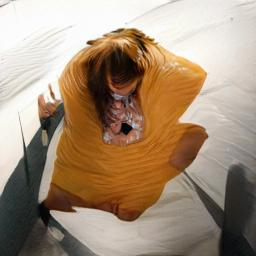

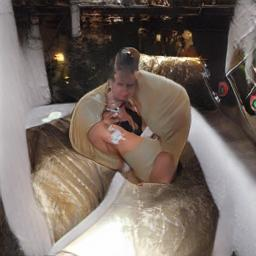

......................................................................
1921.jpg


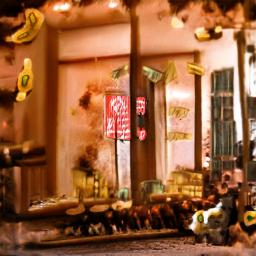

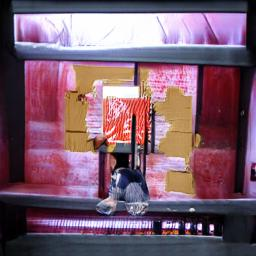

......................................................................
241.jpg


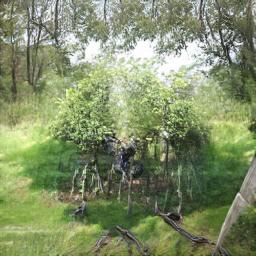

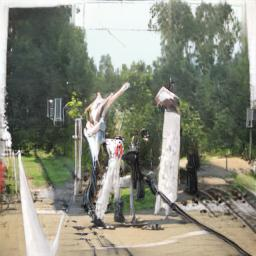

......................................................................
685.jpg


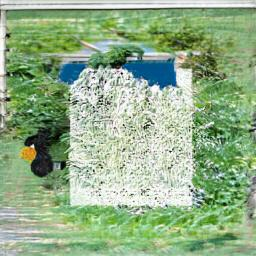

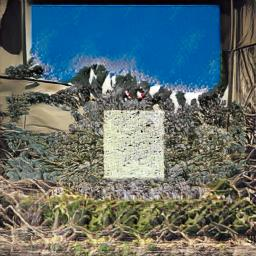

......................................................................
3273.jpg


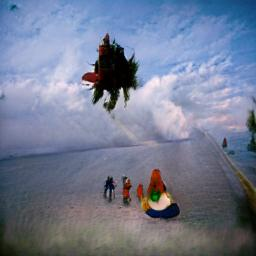

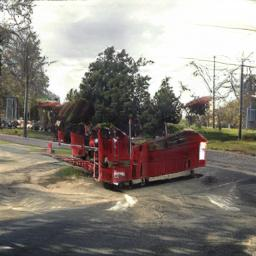

......................................................................
810.jpg


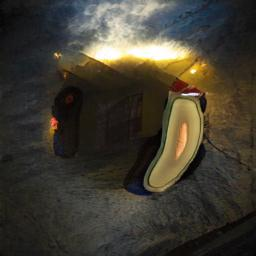

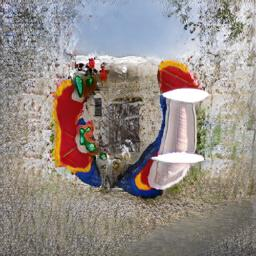

......................................................................
904.jpg


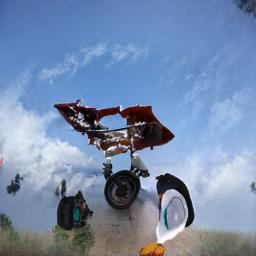

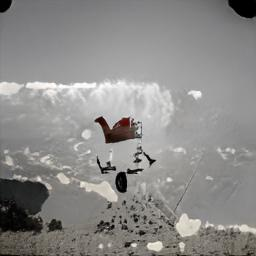

......................................................................
1507.jpg


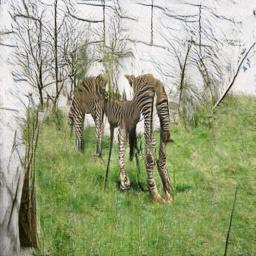

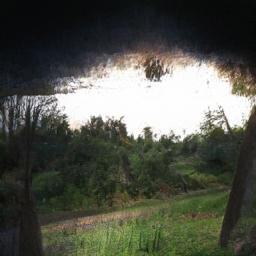

......................................................................
2450.jpg


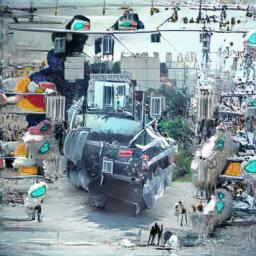

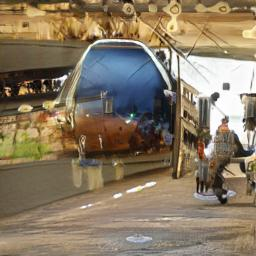

......................................................................
1909.jpg


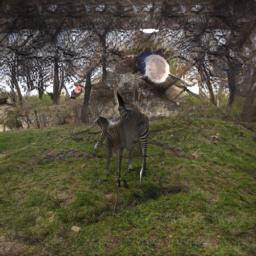

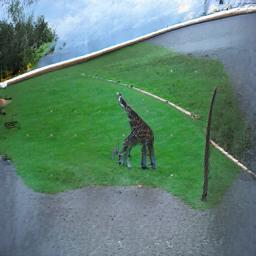

......................................................................
3375.jpg


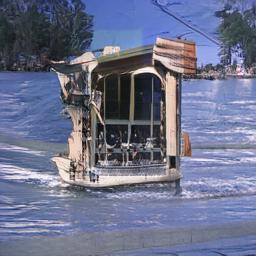

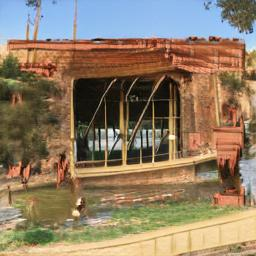

......................................................................
578.jpg


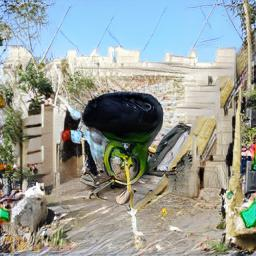

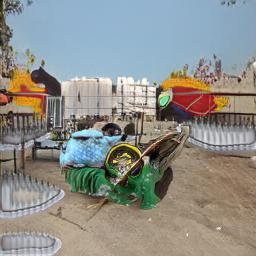

......................................................................
315.jpg


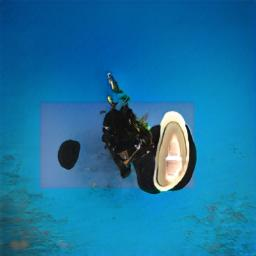

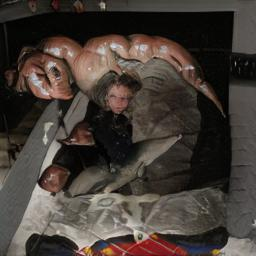

......................................................................
2329.jpg


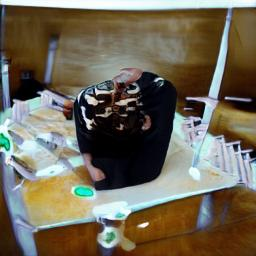

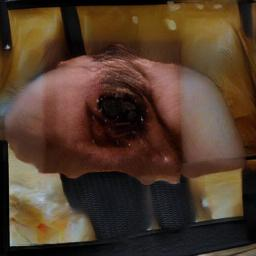

......................................................................
2674.jpg


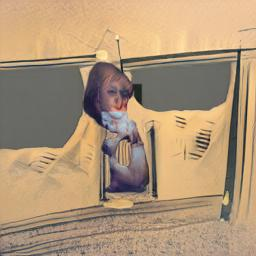

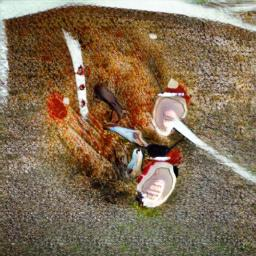

......................................................................
945.jpg


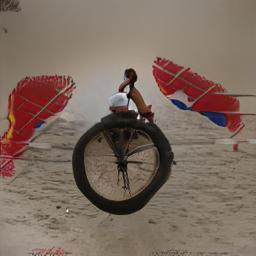

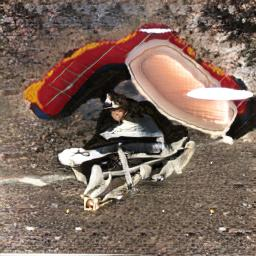

......................................................................
3234.jpg


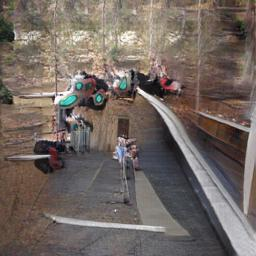

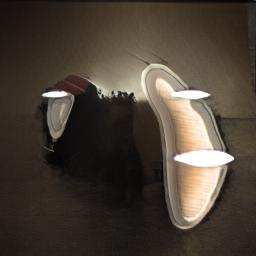

......................................................................
3275.jpg


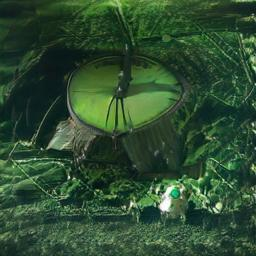

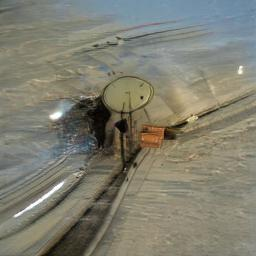

......................................................................
2176.jpg


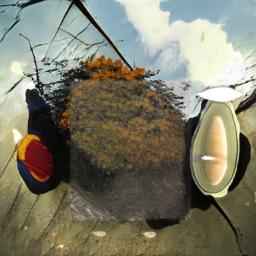

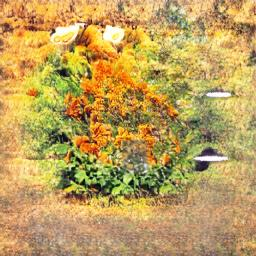

......................................................................
507.jpg


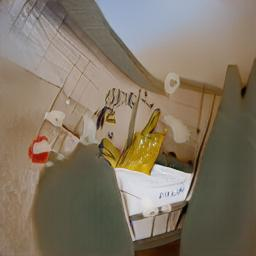

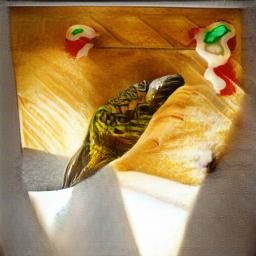

......................................................................
1617.jpg


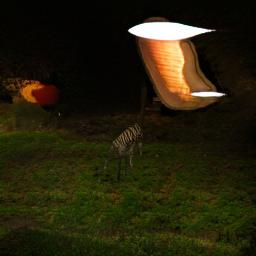

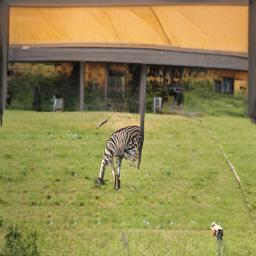

......................................................................
263.jpg


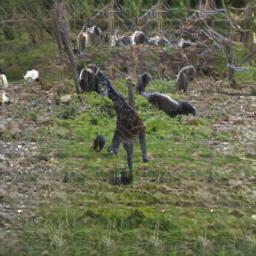

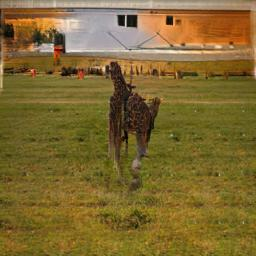

......................................................................
1433.jpg


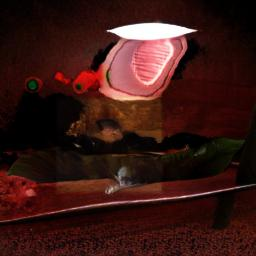

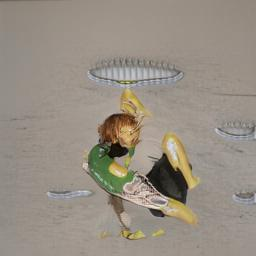

......................................................................
266.jpg


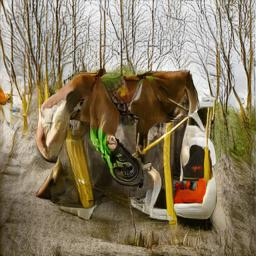

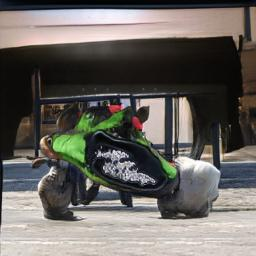

......................................................................
301.jpg


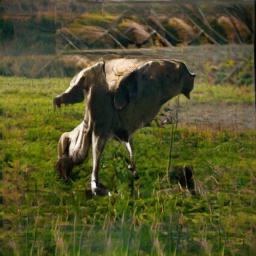

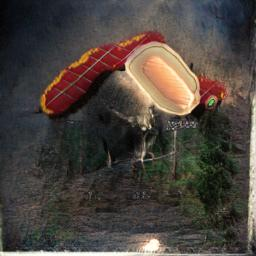

......................................................................
1140.jpg


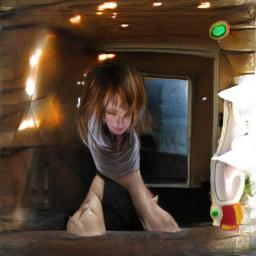

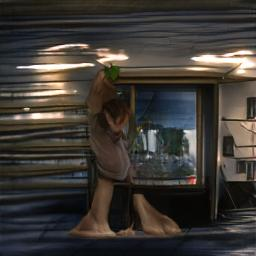

......................................................................
2295.jpg


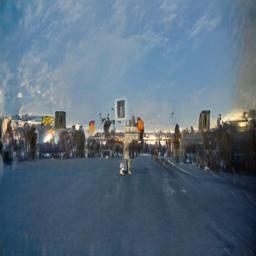

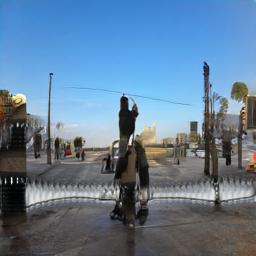

......................................................................
437.jpg


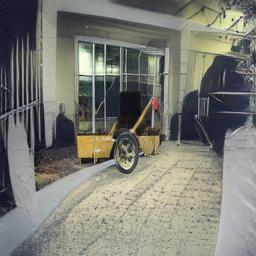

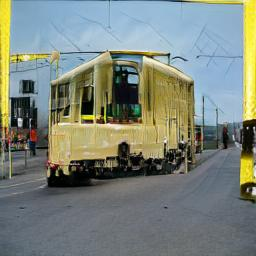

......................................................................
1712.jpg


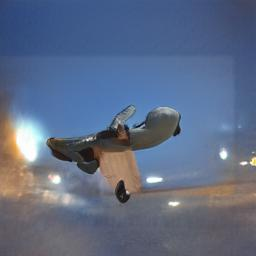

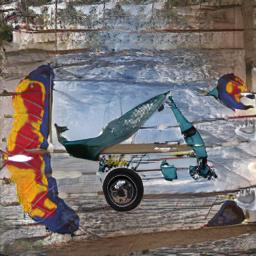

......................................................................
2498.jpg


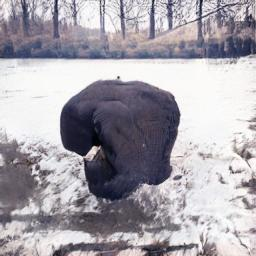

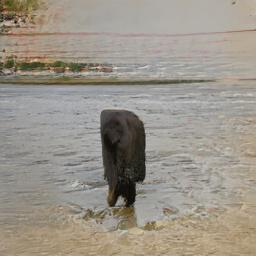

......................................................................
1965.jpg


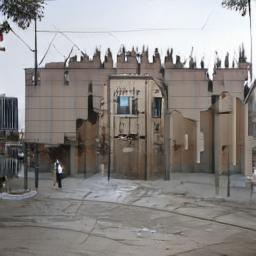

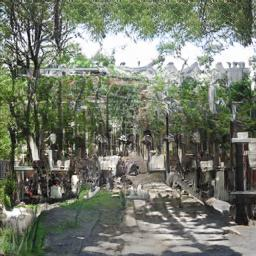

......................................................................
1176.jpg


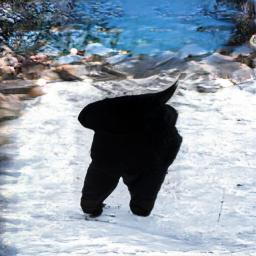

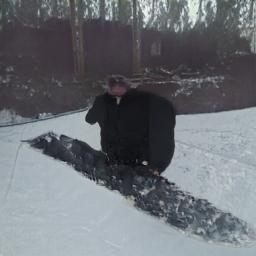

......................................................................
155.jpg


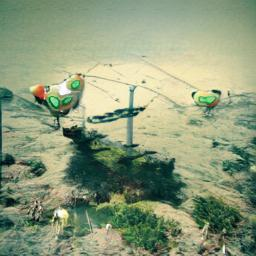

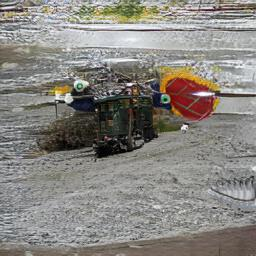

......................................................................
2051.jpg


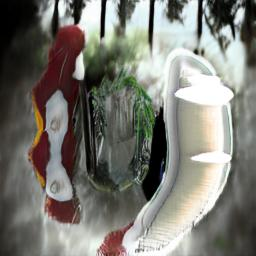

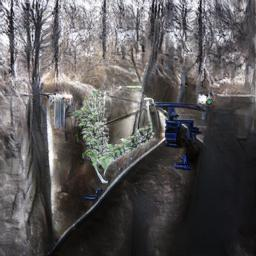

......................................................................
462.jpg


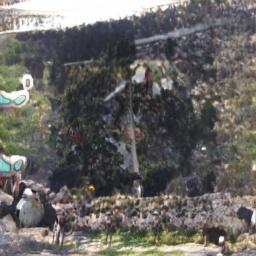

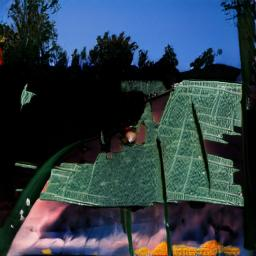

......................................................................
3564.jpg


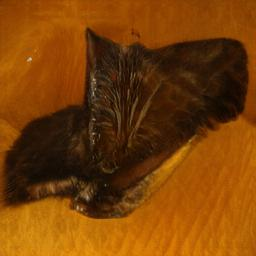

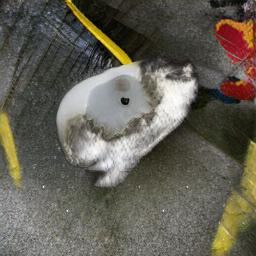

......................................................................
2395.jpg


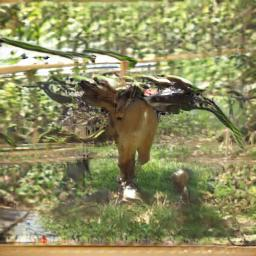

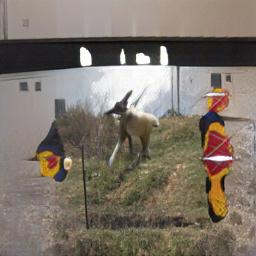

......................................................................
153.jpg


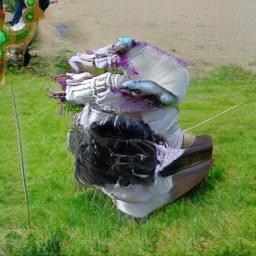

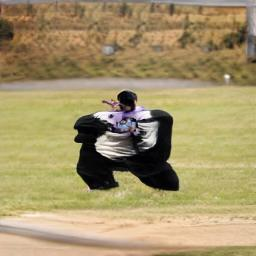

......................................................................
147.jpg


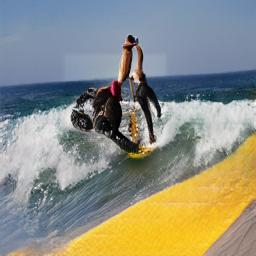

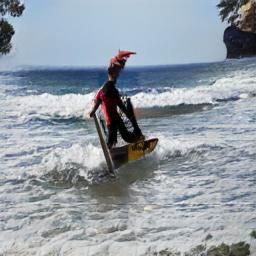

......................................................................
1757.jpg


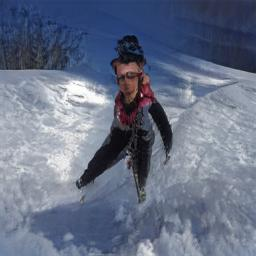

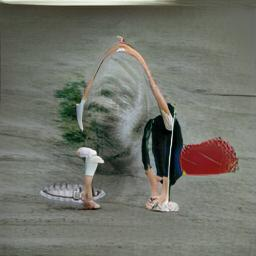

......................................................................
106.jpg


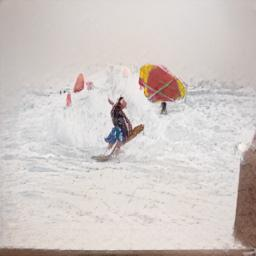

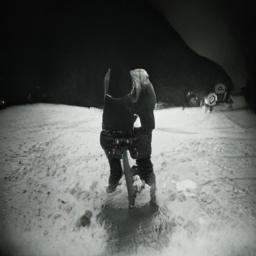

......................................................................
94.jpg


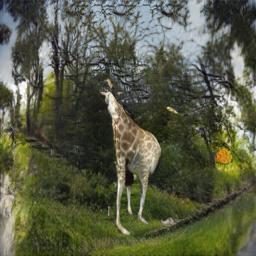

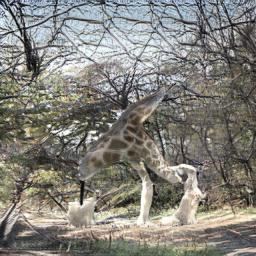

......................................................................
172.jpg


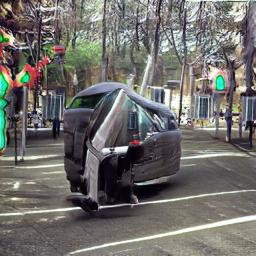

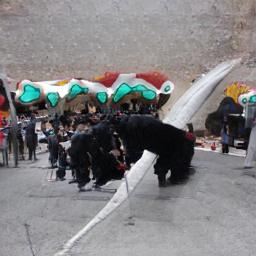

......................................................................
1718.jpg


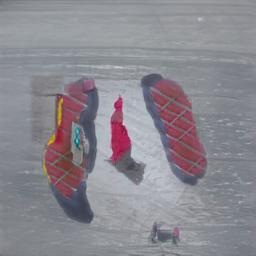

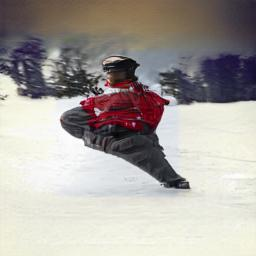

......................................................................
3071.jpg


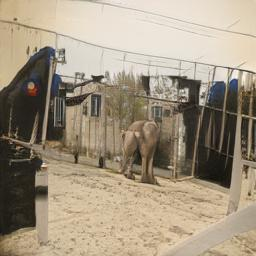

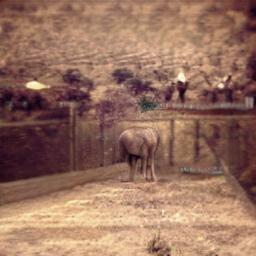

......................................................................
2030.jpg


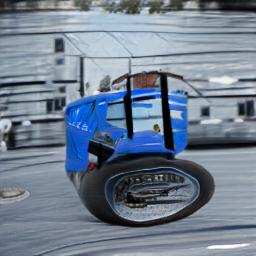

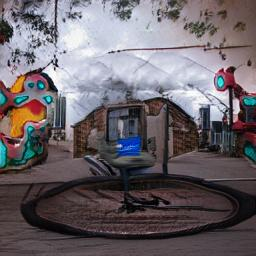

......................................................................
1911.jpg


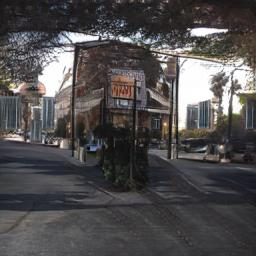

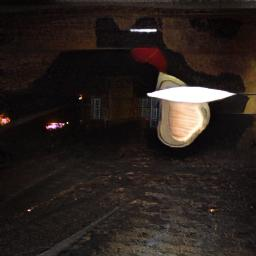

......................................................................
852.jpg


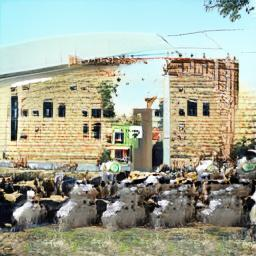

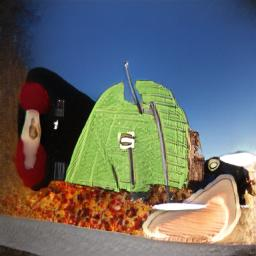

......................................................................
642.jpg


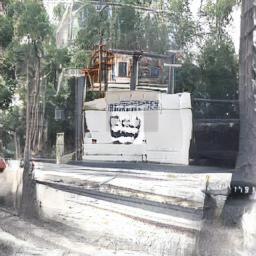

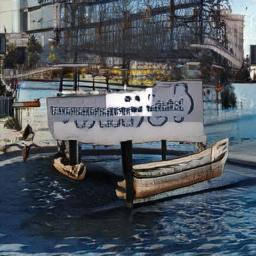

......................................................................
2869.jpg


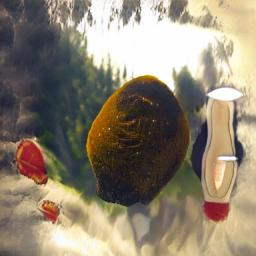

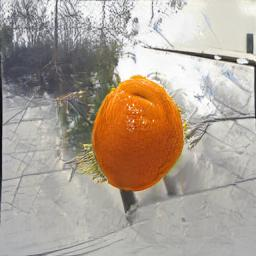

......................................................................
1939.jpg


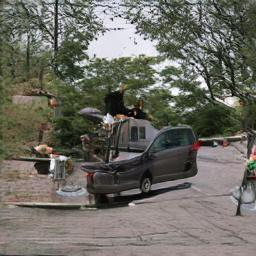

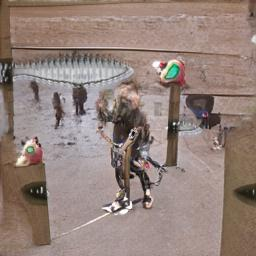

......................................................................
2145.jpg


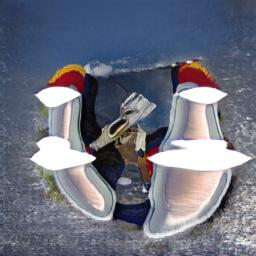

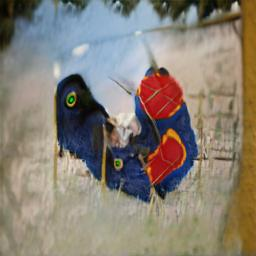

......................................................................
2551.jpg


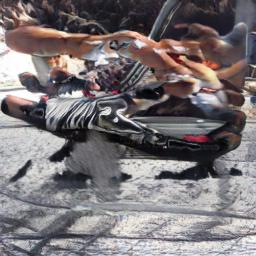

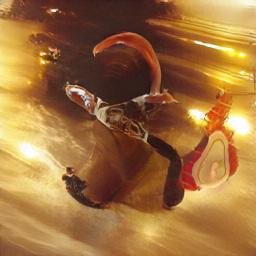

......................................................................
66.jpg


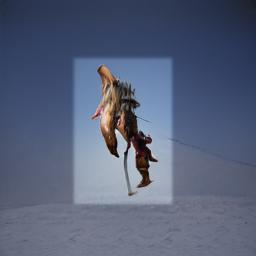

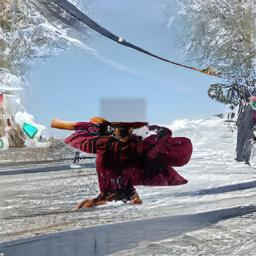

......................................................................
1392.jpg


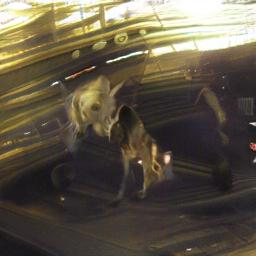

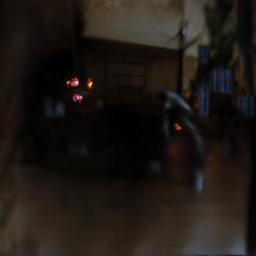

......................................................................
952.jpg


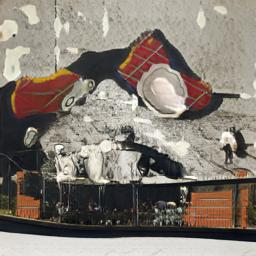

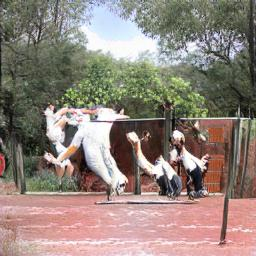

......................................................................
2132.jpg


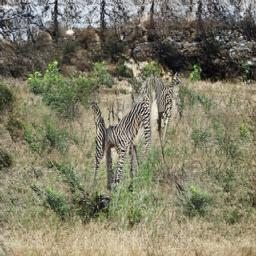

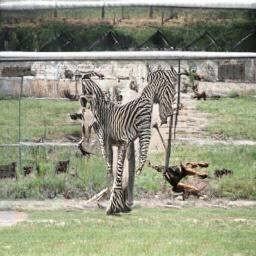

......................................................................
2101.jpg


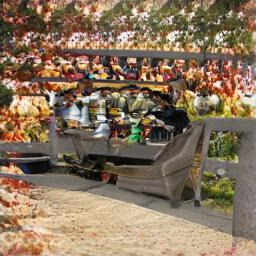

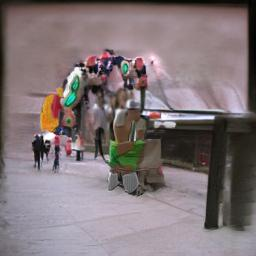

......................................................................
3263.jpg


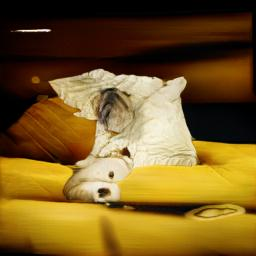

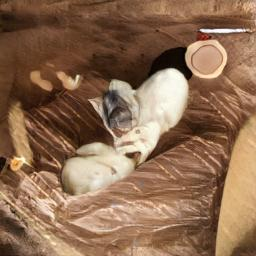

......................................................................
873.jpg


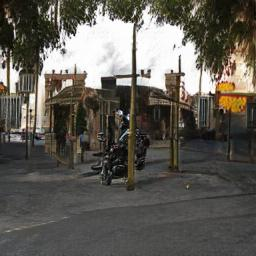

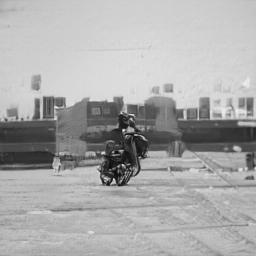

......................................................................
1765.jpg


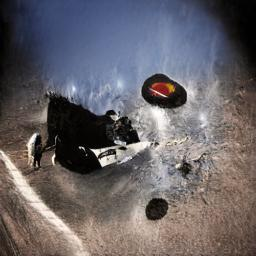

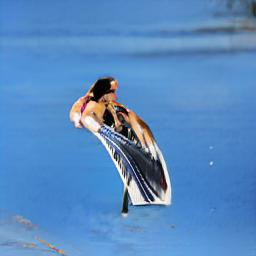

......................................................................
1691.jpg


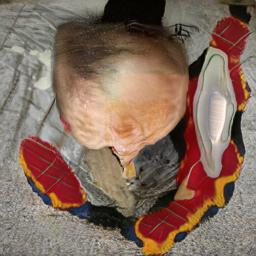

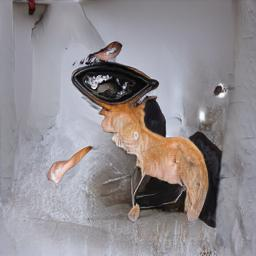

......................................................................
3174.jpg


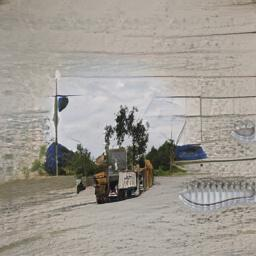

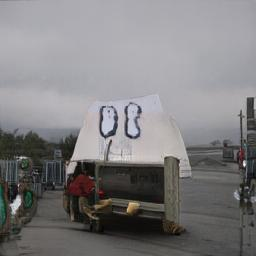

......................................................................
3264.jpg


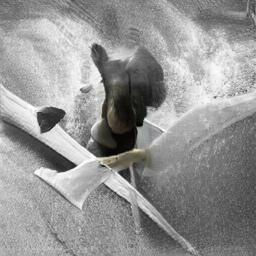

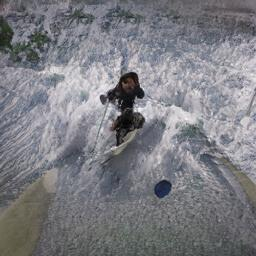

......................................................................
611.jpg


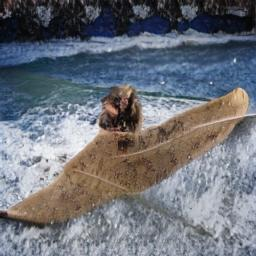

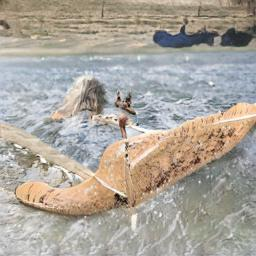

......................................................................
3134.jpg


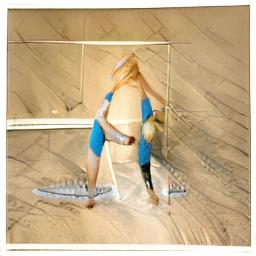

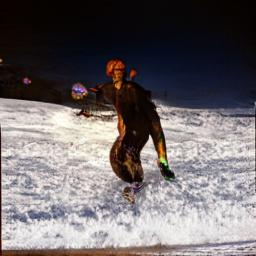

......................................................................
2231.jpg


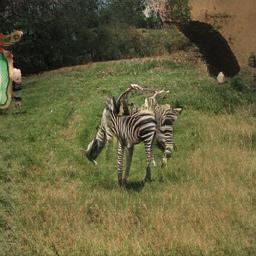

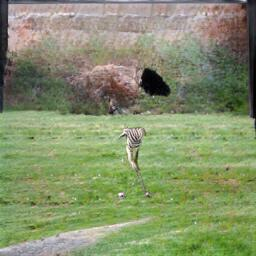

......................................................................
3449.jpg


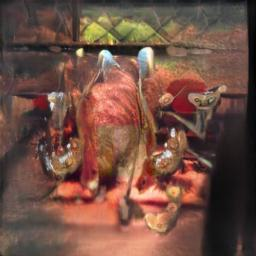

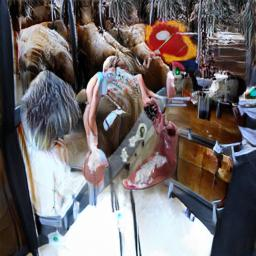

......................................................................
2593.jpg


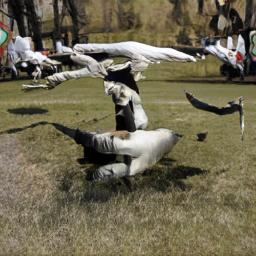

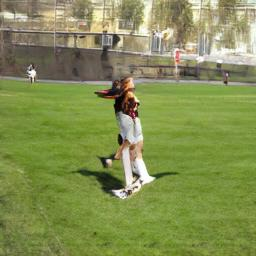

......................................................................
2572.jpg


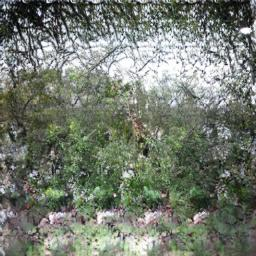

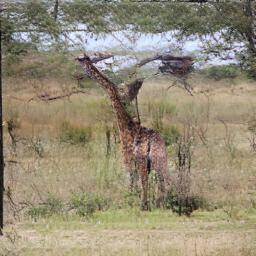

......................................................................
1982.jpg


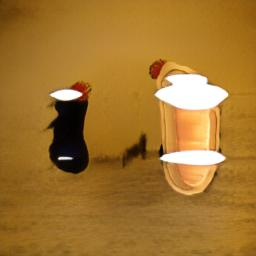

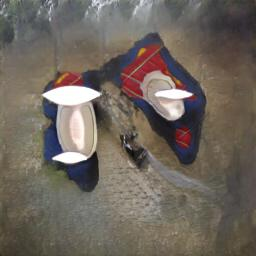

......................................................................
194.jpg


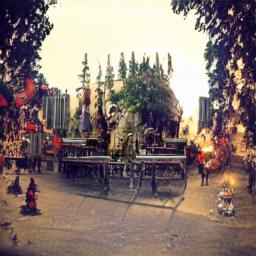

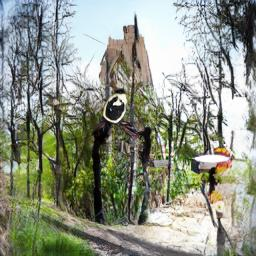

......................................................................
2883.jpg


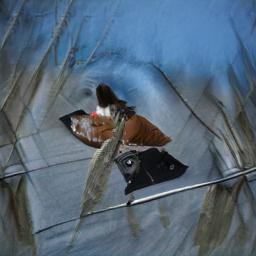

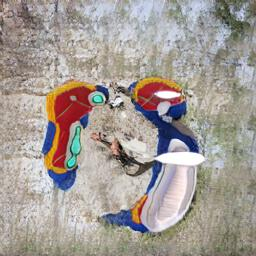

......................................................................
163.jpg


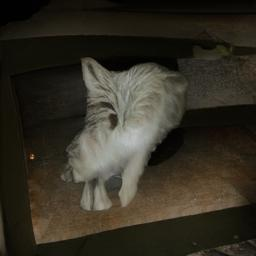

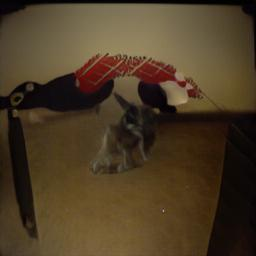

......................................................................
3060.jpg


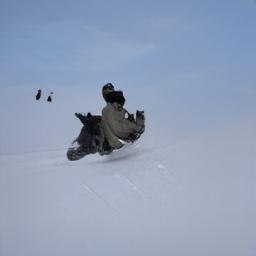

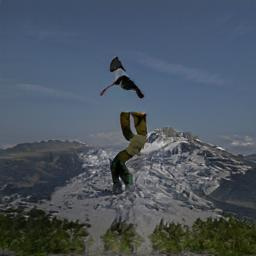

......................................................................
1495.jpg


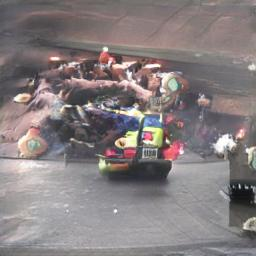

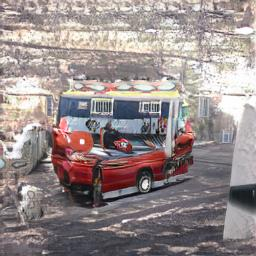

......................................................................
2907.jpg


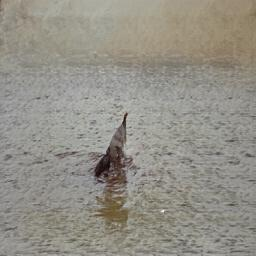

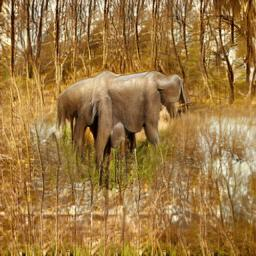

......................................................................
329.jpg


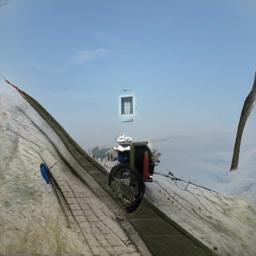

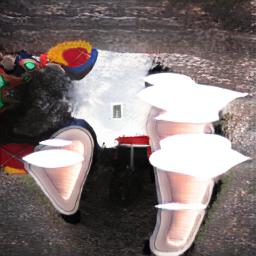

......................................................................
1188.jpg


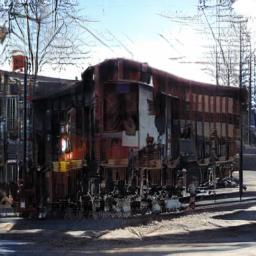

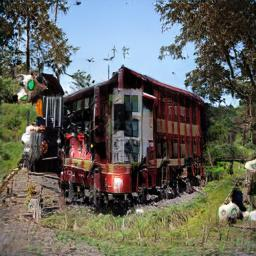

......................................................................
3350.jpg


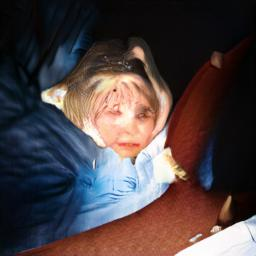

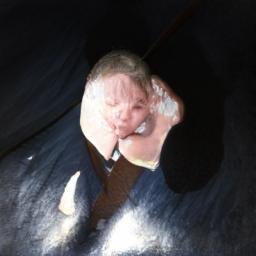

......................................................................
1451.jpg


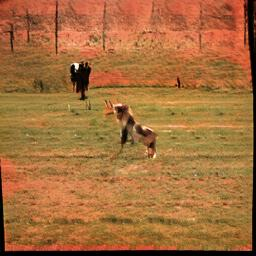

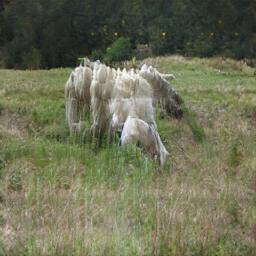

......................................................................
2559.jpg


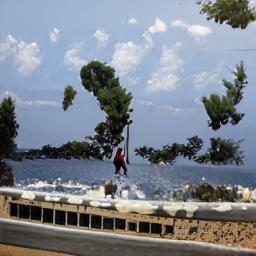

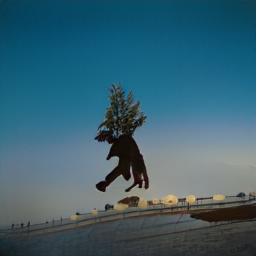

......................................................................
3326.jpg


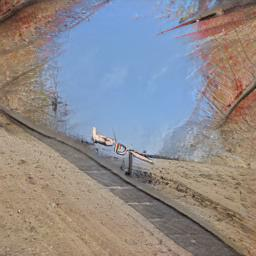

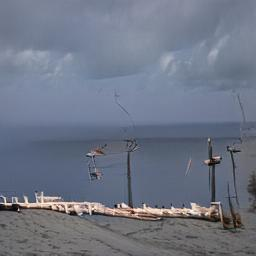

......................................................................
2693.jpg


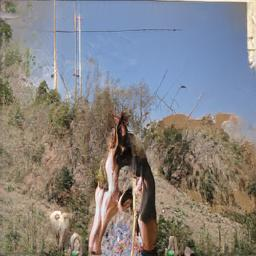

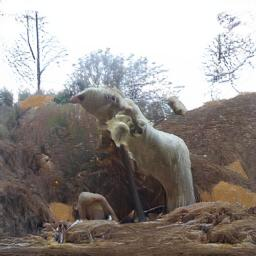

......................................................................
158.jpg


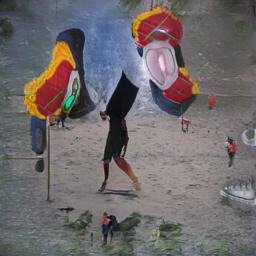

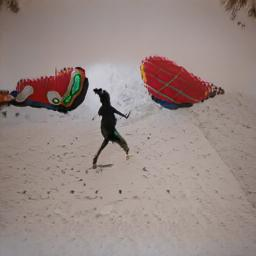

......................................................................
1811.jpg


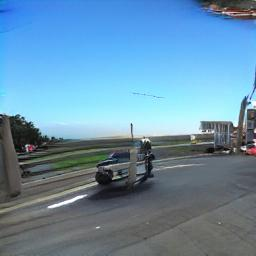

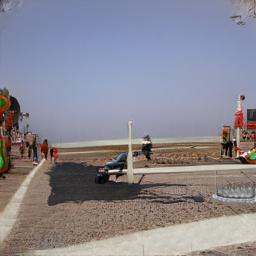

......................................................................
2041.jpg


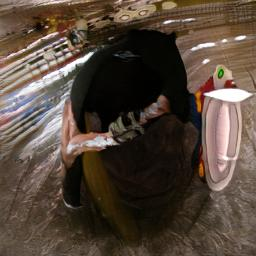

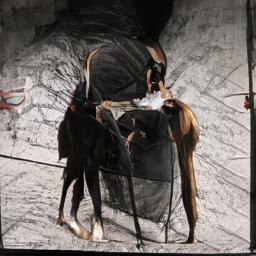

......................................................................
2289.jpg


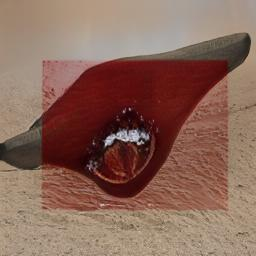

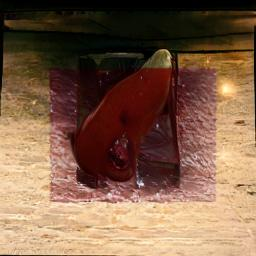

......................................................................
3188.jpg


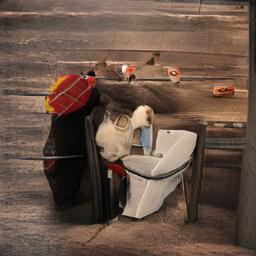

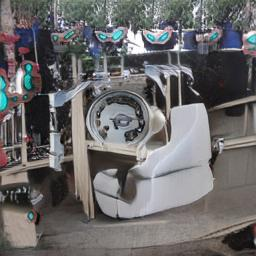

......................................................................
1635.jpg


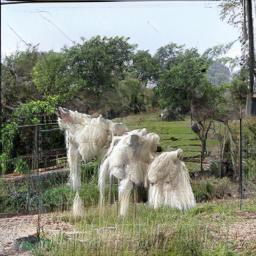

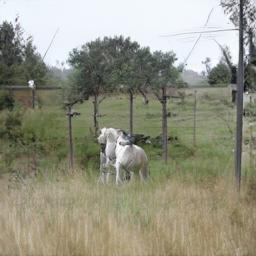

......................................................................
440.jpg


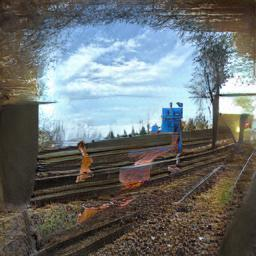

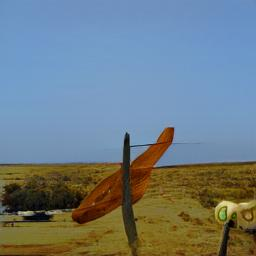

......................................................................
1253.jpg


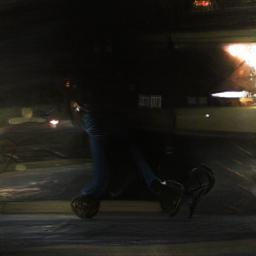

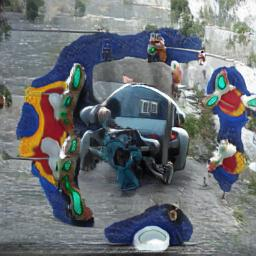

......................................................................
3168.jpg


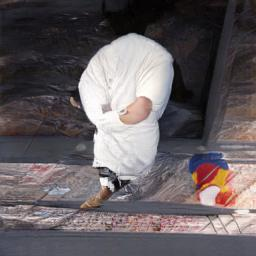

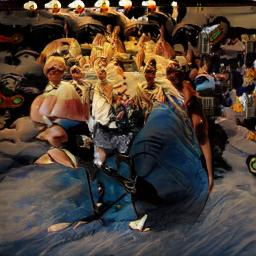

......................................................................
1711.jpg


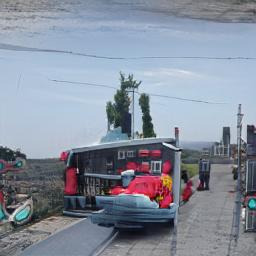

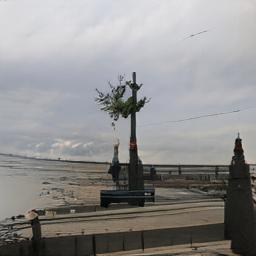

......................................................................
2416.jpg


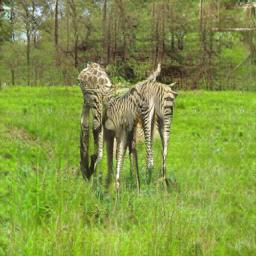

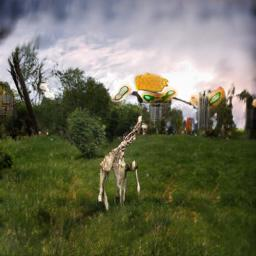

......................................................................
118.jpg


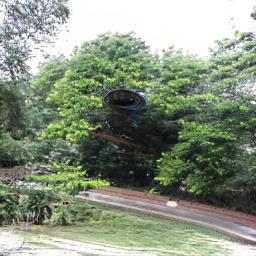

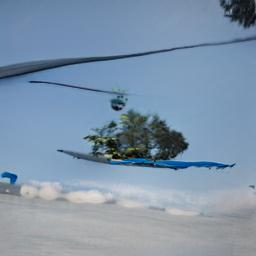

......................................................................
3087.jpg


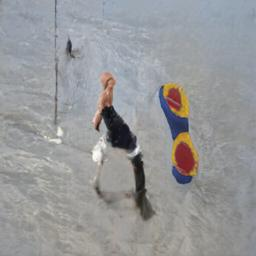

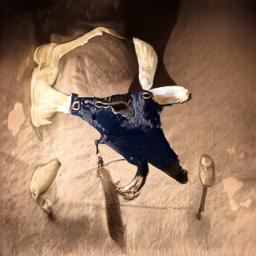

......................................................................
946.jpg


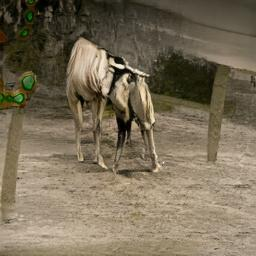

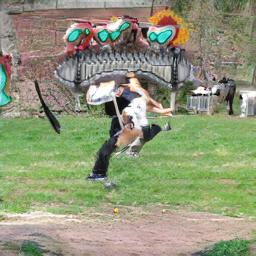

......................................................................
63.jpg


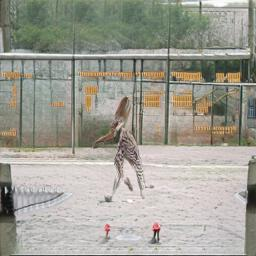

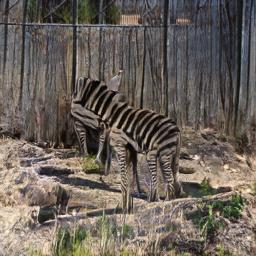

......................................................................
2516.jpg


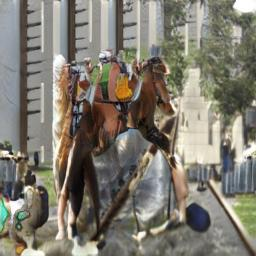

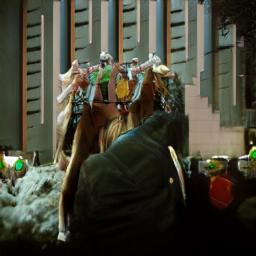

......................................................................
1035.jpg


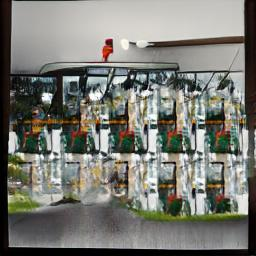

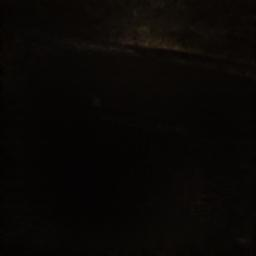

......................................................................
1387.jpg


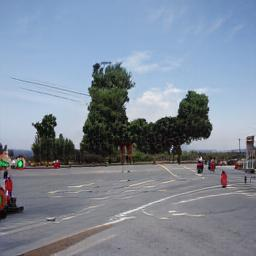

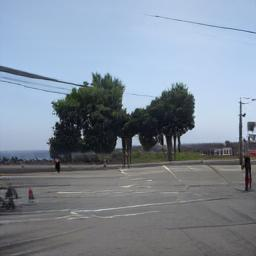

......................................................................
2458.jpg


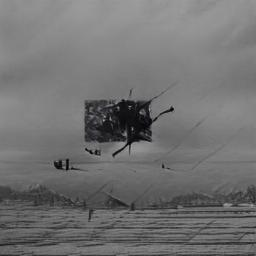

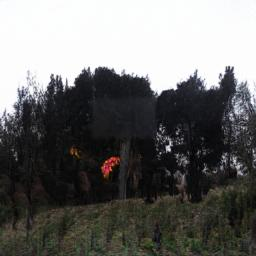

......................................................................
2565.jpg


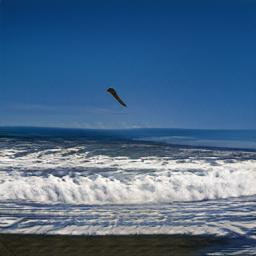

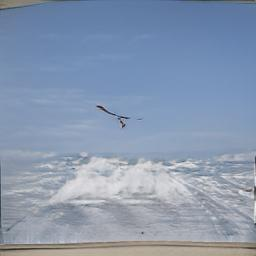

......................................................................
2292.jpg


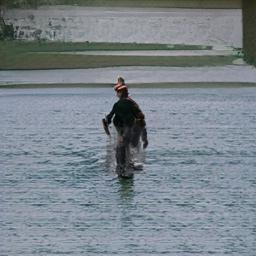

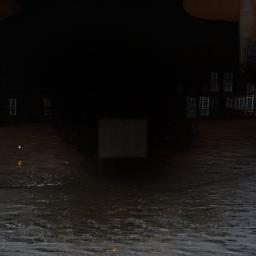

......................................................................
1671.jpg


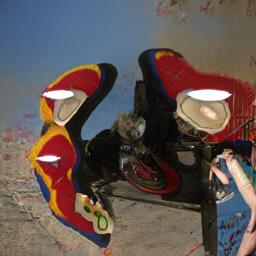

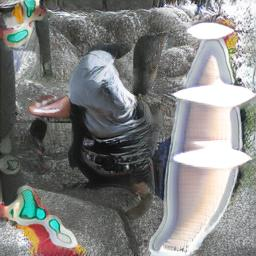

......................................................................
3077.jpg


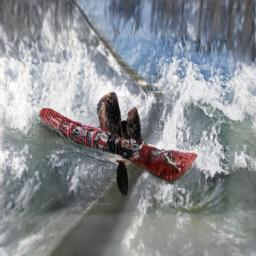

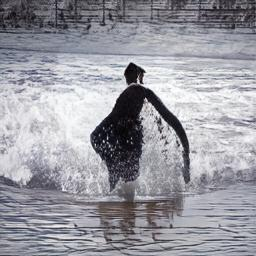

......................................................................
2021.jpg


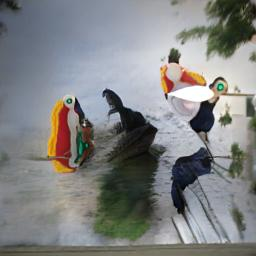

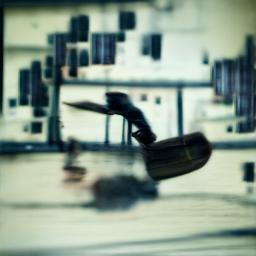

......................................................................
2368.jpg


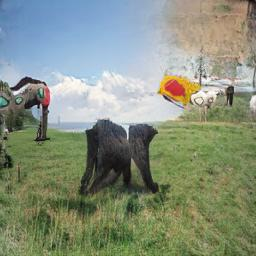

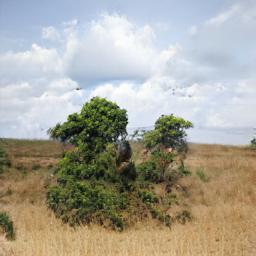

......................................................................
2274.jpg


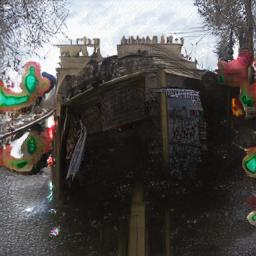

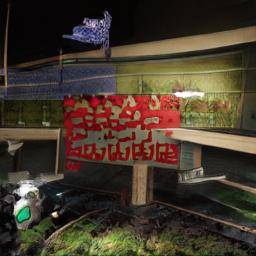

......................................................................
1368.jpg


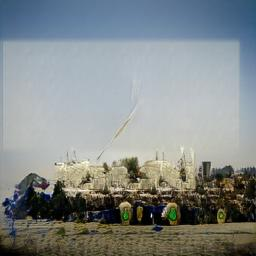

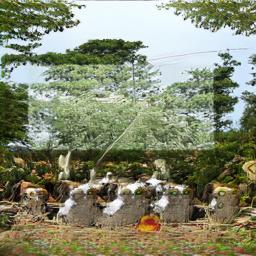

......................................................................
1594.jpg


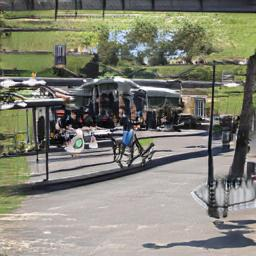

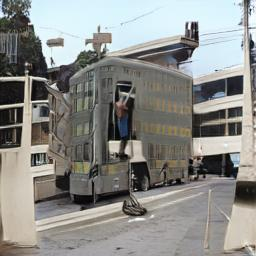

......................................................................
3318.jpg


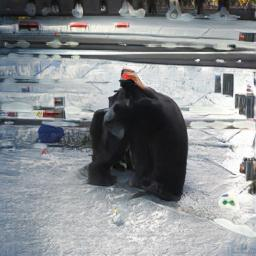

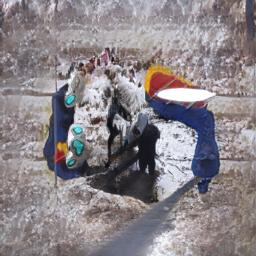

......................................................................
3504.jpg


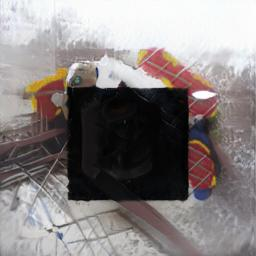

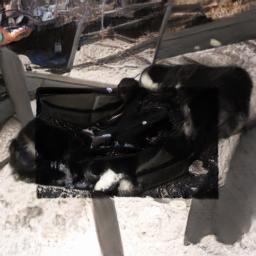

......................................................................
509.jpg


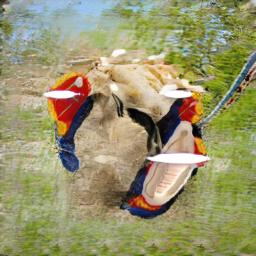

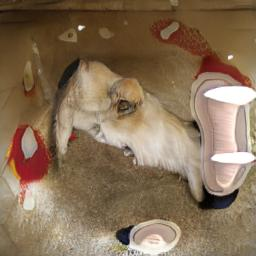

......................................................................
227.jpg


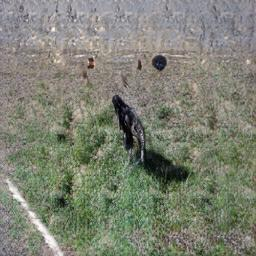

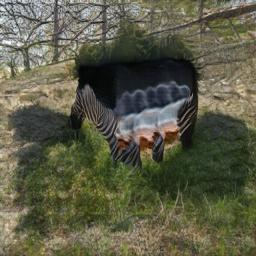

......................................................................
1773.jpg


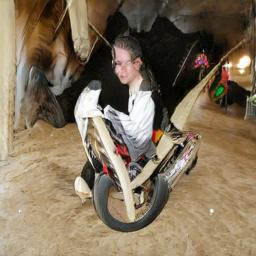

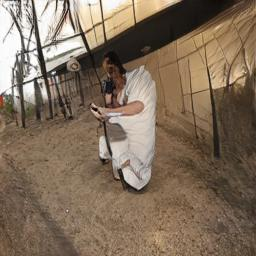

......................................................................
1286.jpg


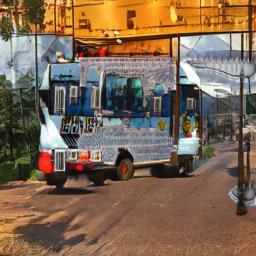

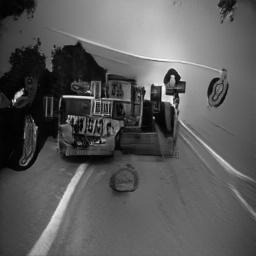

......................................................................
887.jpg


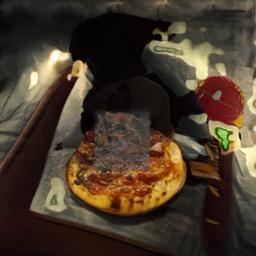

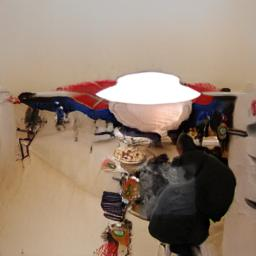

......................................................................
802.jpg


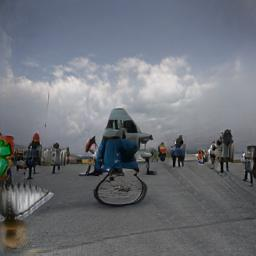

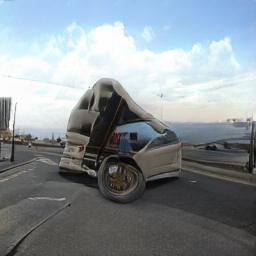

......................................................................
3432.jpg


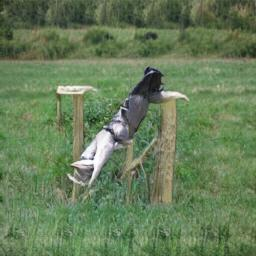

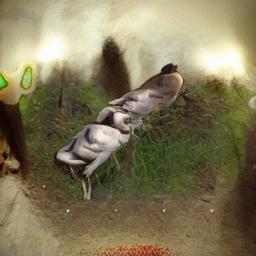

......................................................................
1311.jpg


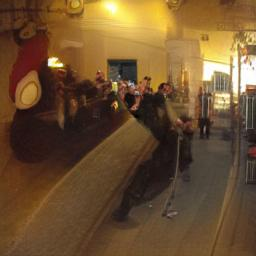

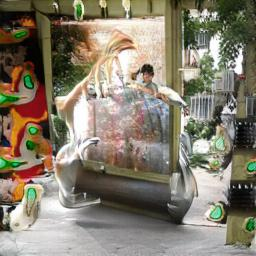

......................................................................
538.jpg


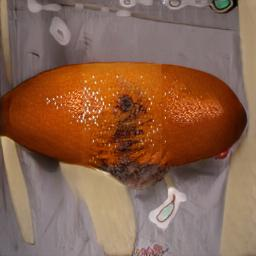

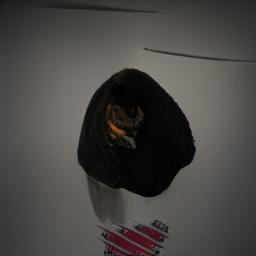

......................................................................
3225.jpg


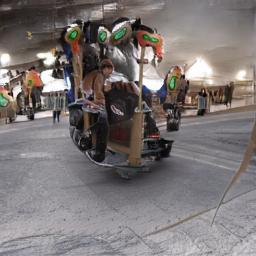

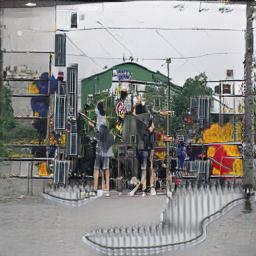

......................................................................
1030.jpg


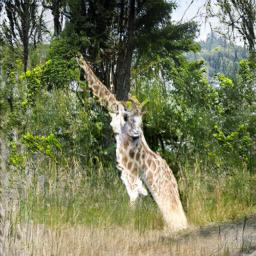

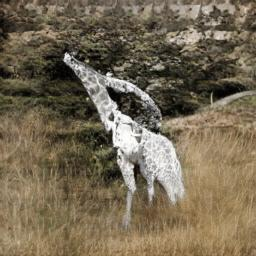

......................................................................
2798.jpg


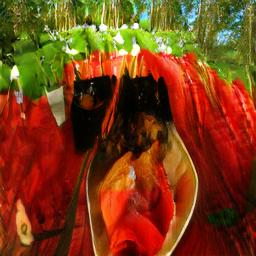

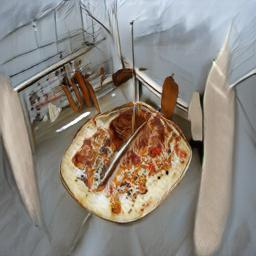

......................................................................
1991.jpg


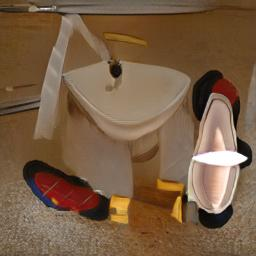

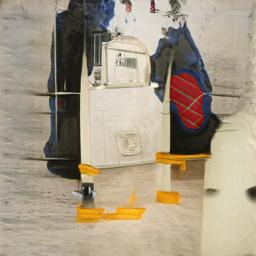

......................................................................
1306.jpg


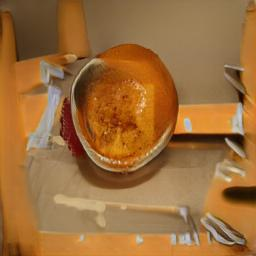

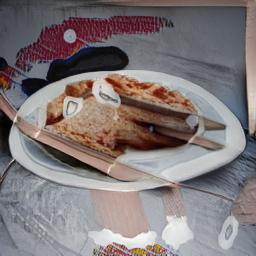

......................................................................
2864.jpg


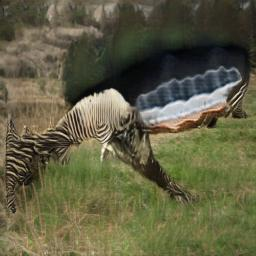

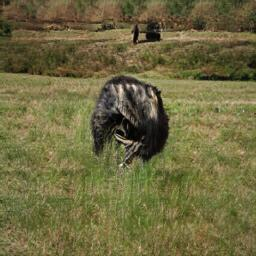

......................................................................
1407.jpg


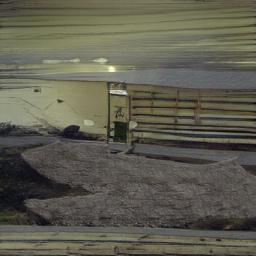

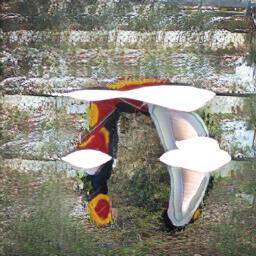

......................................................................
35.jpg


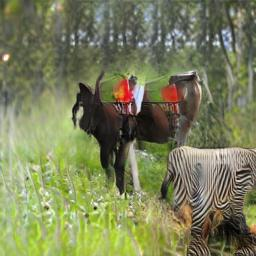

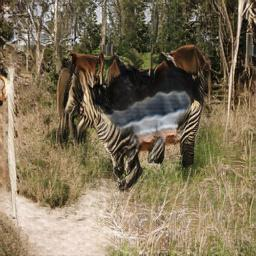

......................................................................
986.jpg


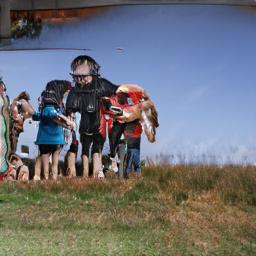

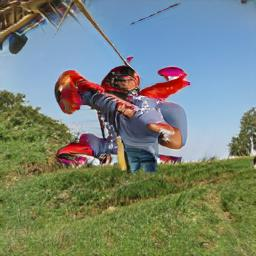

......................................................................
905.jpg


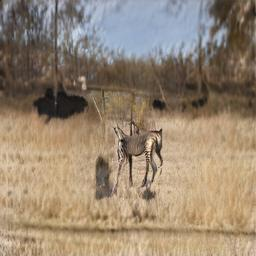

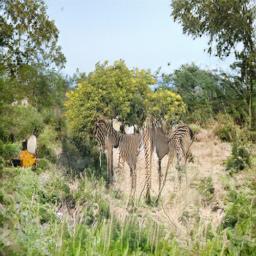

......................................................................
762.jpg


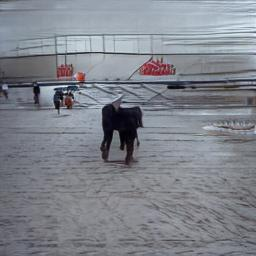

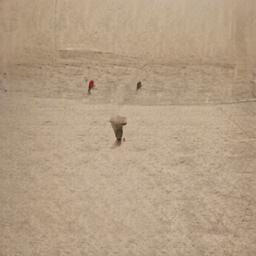

......................................................................
2802.jpg


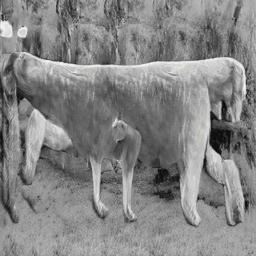

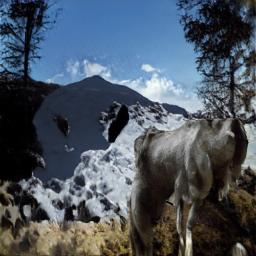

......................................................................
2082.jpg


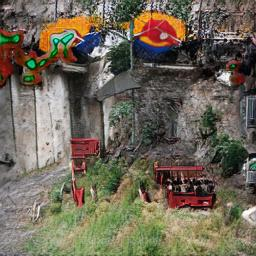

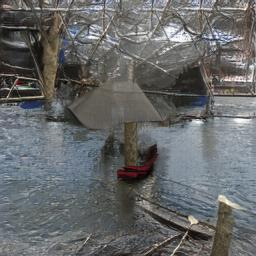

......................................................................
770.jpg


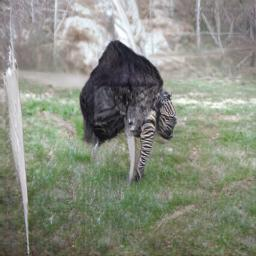

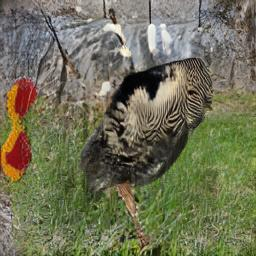

......................................................................
1896.jpg


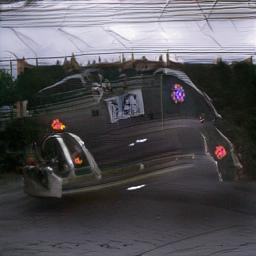

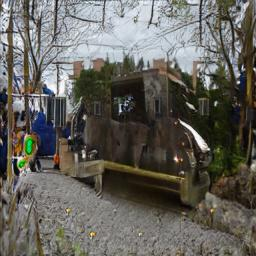

......................................................................
278.jpg


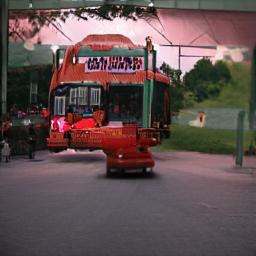

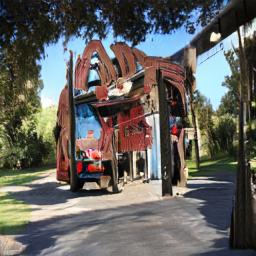

......................................................................
2451.jpg


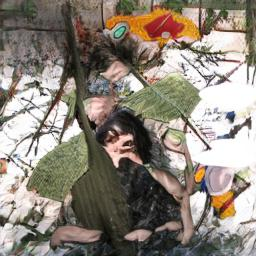

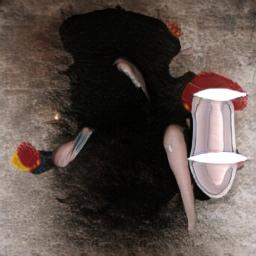

......................................................................
424.jpg


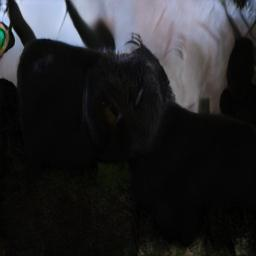

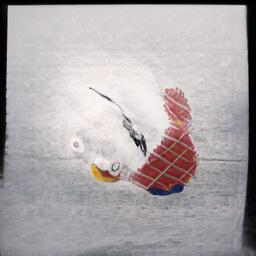

......................................................................
3327.jpg


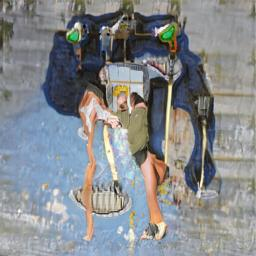

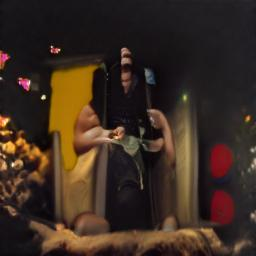

......................................................................
3551.jpg


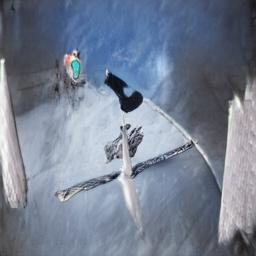

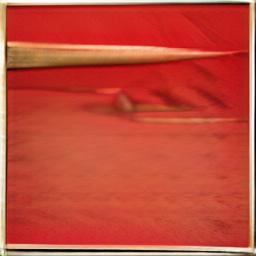

......................................................................
2432.jpg


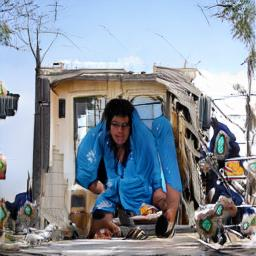

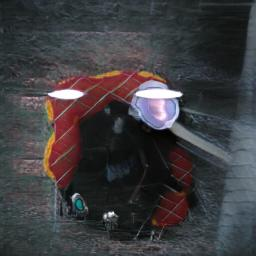

......................................................................
2720.jpg


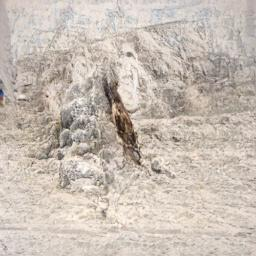

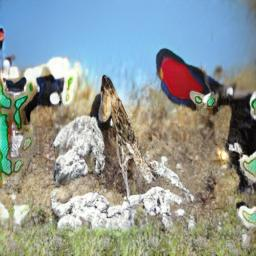

......................................................................
2810.jpg


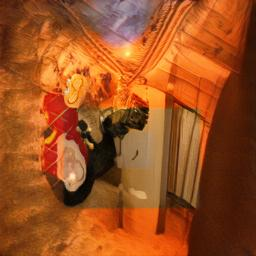

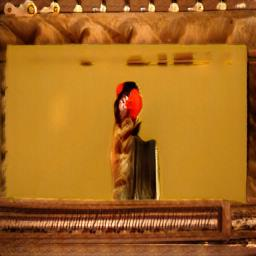

......................................................................
3145.jpg


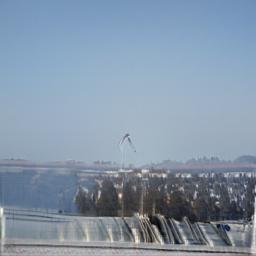

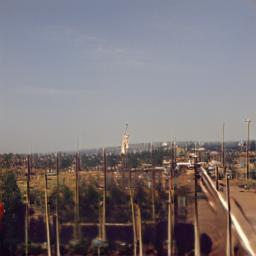

......................................................................
371.jpg


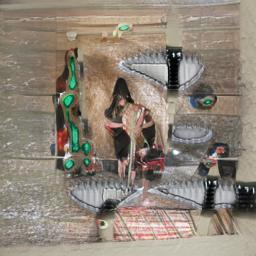

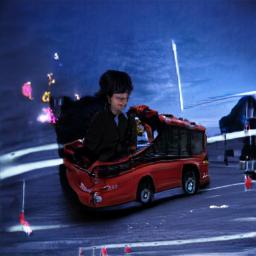

......................................................................
3390.jpg


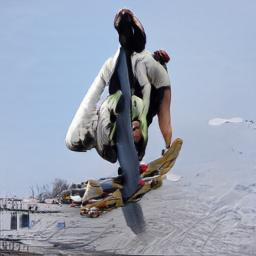

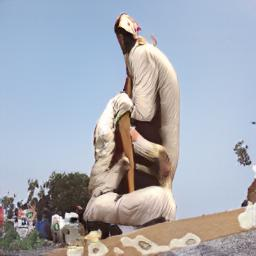

......................................................................
1154.jpg


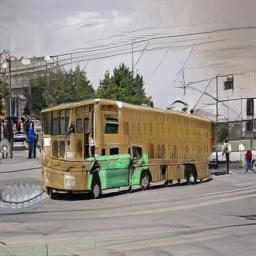

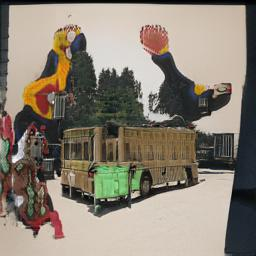

......................................................................
472.jpg


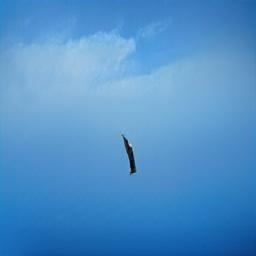

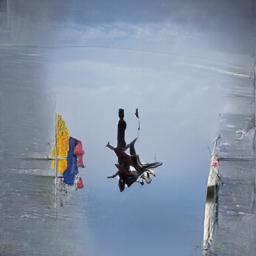

......................................................................
3293.jpg


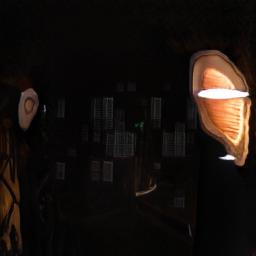

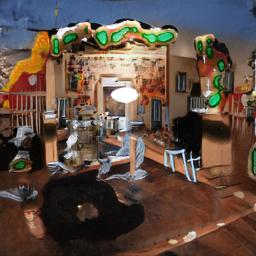

......................................................................
2889.jpg


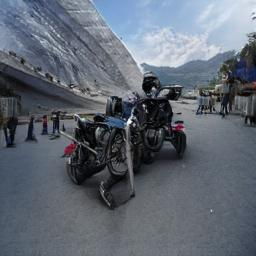

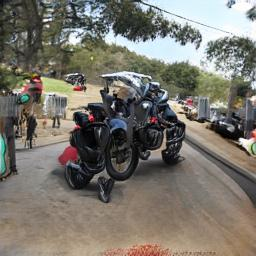

......................................................................
708.jpg


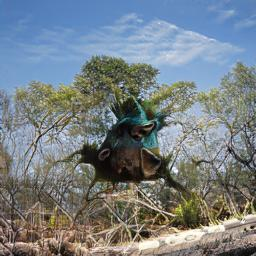

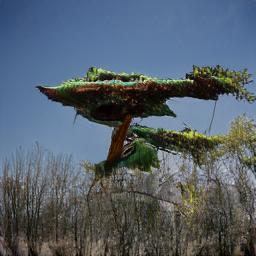

......................................................................
1506.jpg


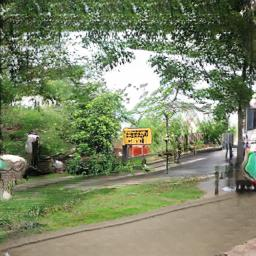

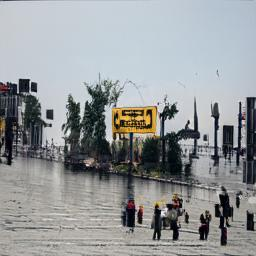

......................................................................
2265.jpg


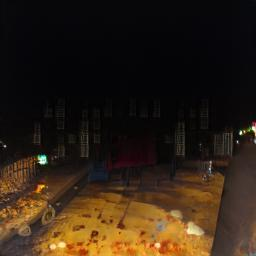

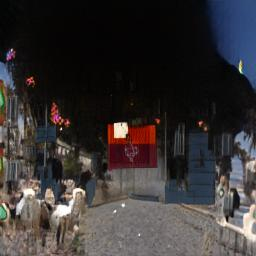

......................................................................
2193.jpg


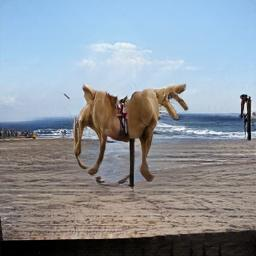

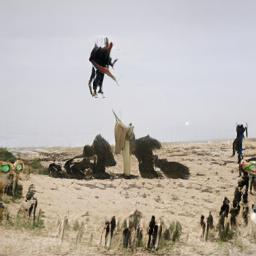

......................................................................
1815.jpg


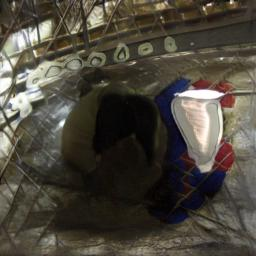

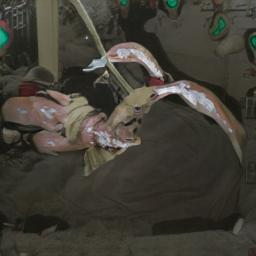

......................................................................
2436.jpg


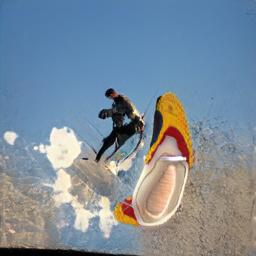

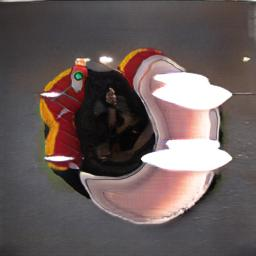

......................................................................
2960.jpg


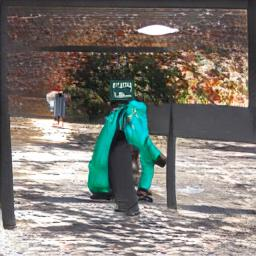

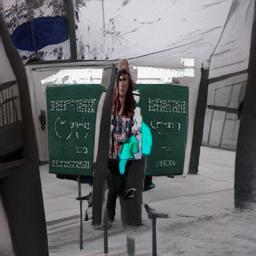

......................................................................
3420.jpg


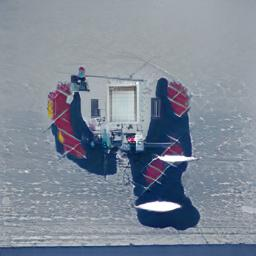

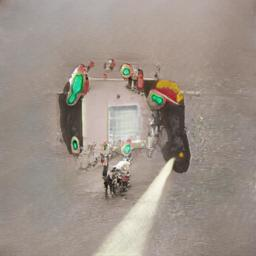

......................................................................
1524.jpg


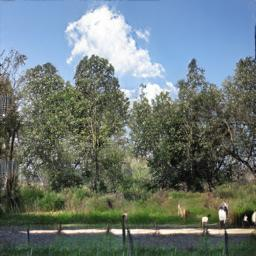

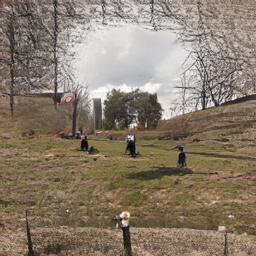

......................................................................
902.jpg


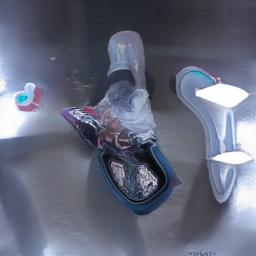

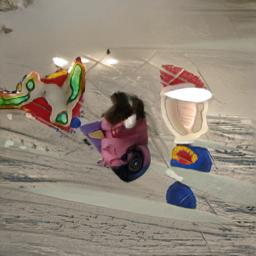

......................................................................
1794.jpg


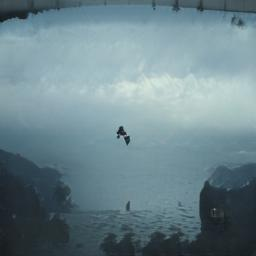

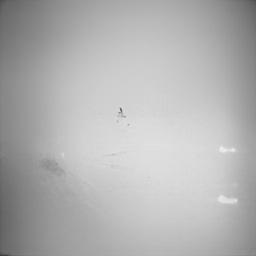

......................................................................
2784.jpg


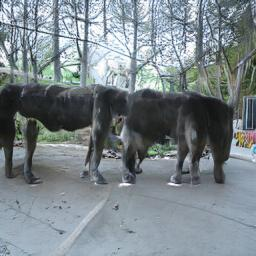

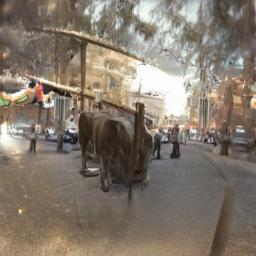

......................................................................
1288.jpg


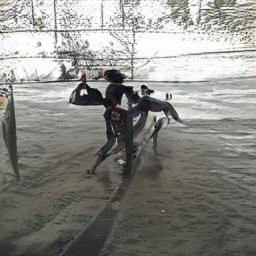

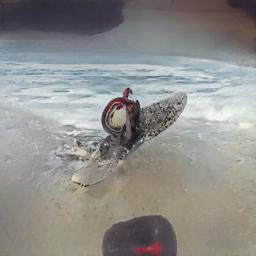

......................................................................
1304.jpg


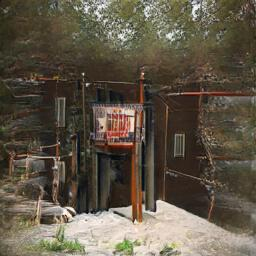

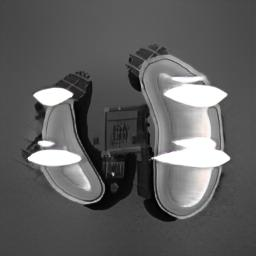

......................................................................
1410.jpg


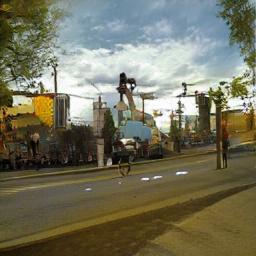

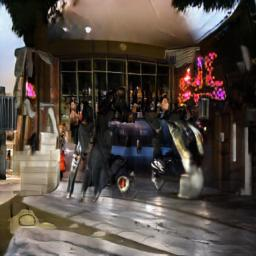

......................................................................
1363.jpg


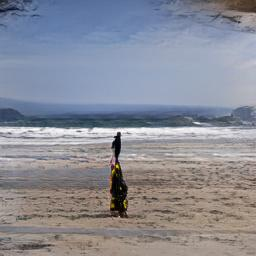

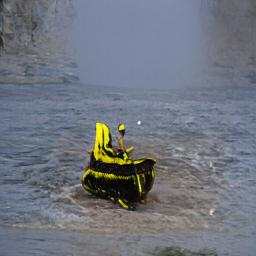

......................................................................
523.jpg


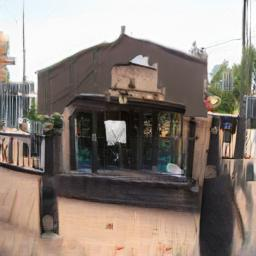

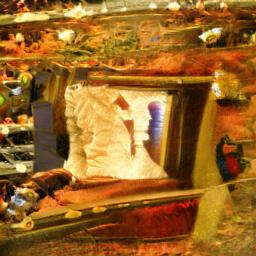

......................................................................
1052.jpg


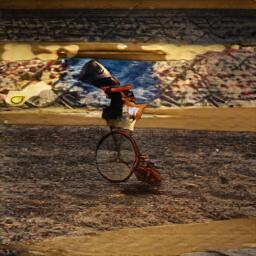

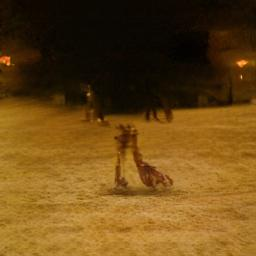

......................................................................
2285.jpg


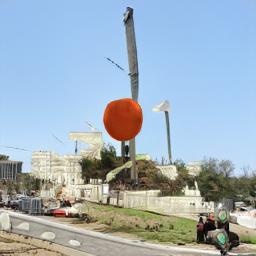

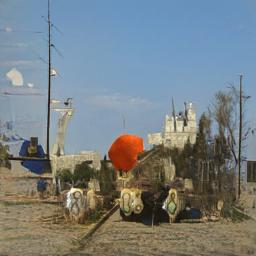

......................................................................
1240.jpg


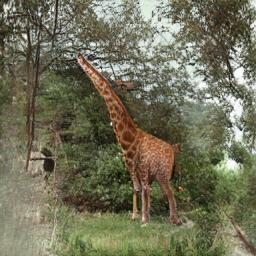

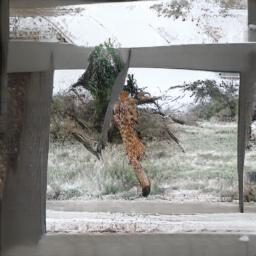

......................................................................
477.jpg


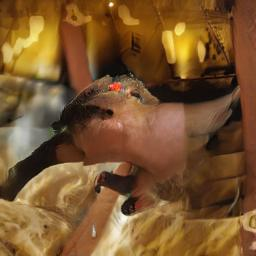

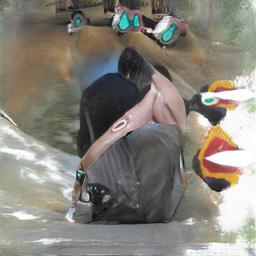

......................................................................
86.jpg


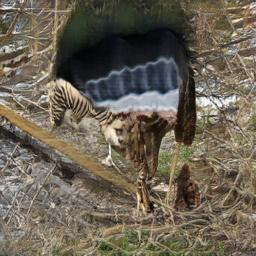

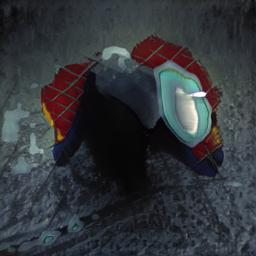

......................................................................
101.jpg


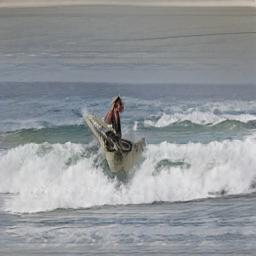

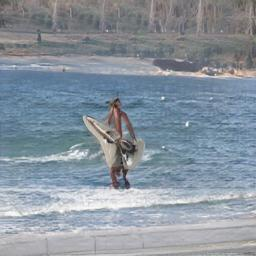

......................................................................
2113.jpg


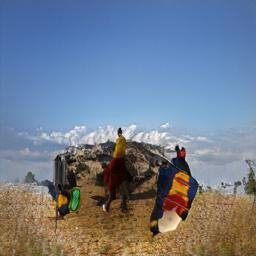

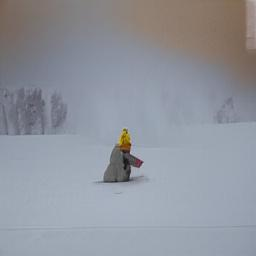

......................................................................
1536.jpg


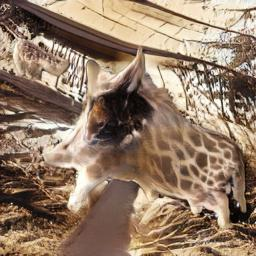

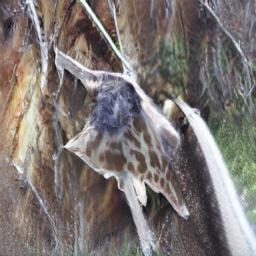

......................................................................
3024.jpg


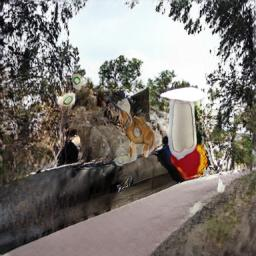

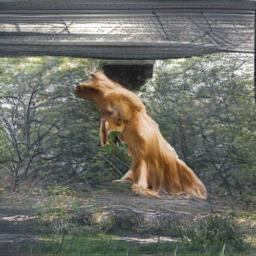

......................................................................
3098.jpg


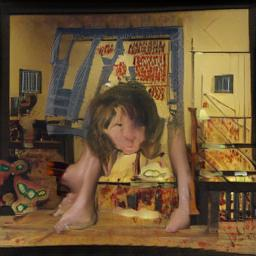

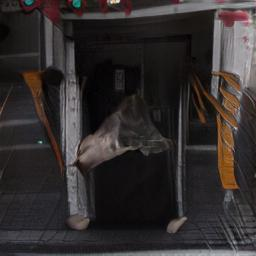

......................................................................
75.jpg


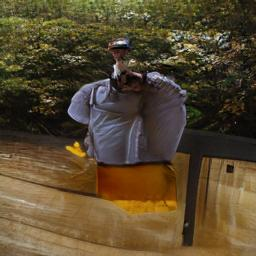

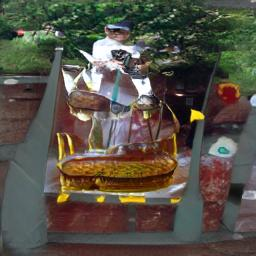

......................................................................
2956.jpg


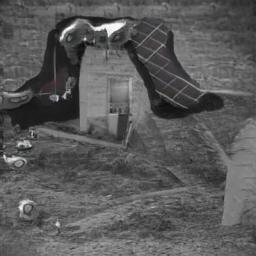

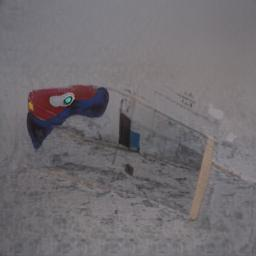

......................................................................
38.jpg


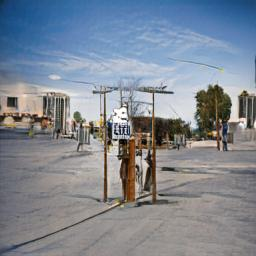

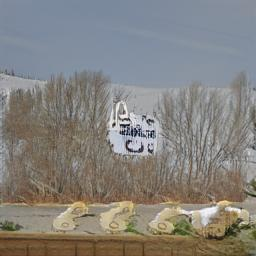

......................................................................
236.jpg


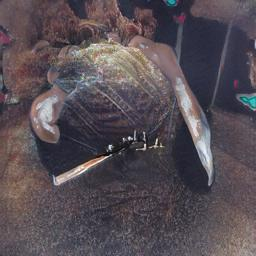

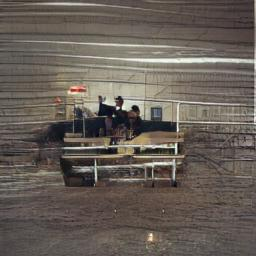

......................................................................
496.jpg


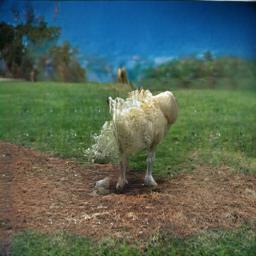

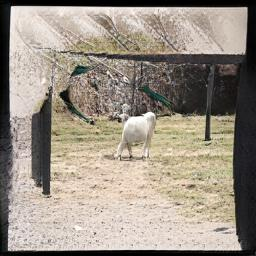

......................................................................
3048.jpg


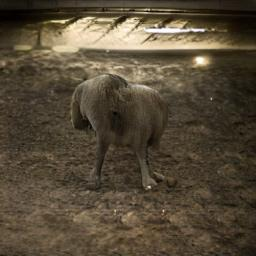

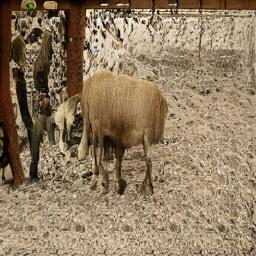

......................................................................
1947.jpg


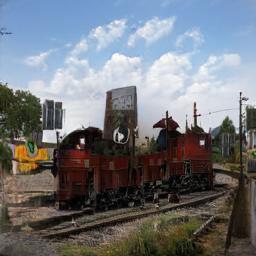

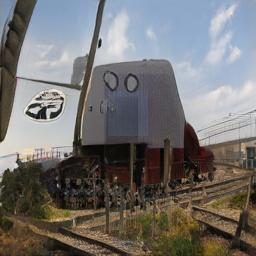

......................................................................
2073.jpg


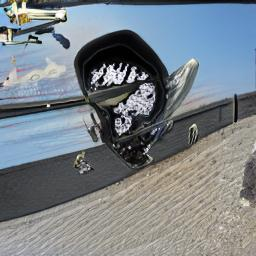

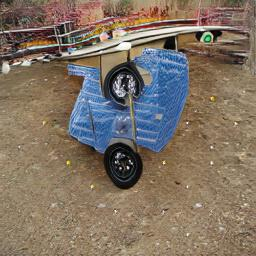

......................................................................
1761.jpg


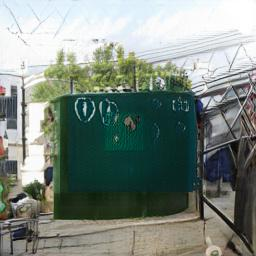

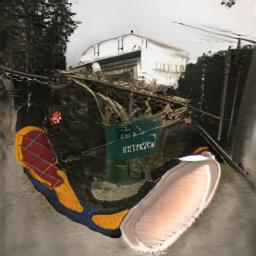

......................................................................
1396.jpg


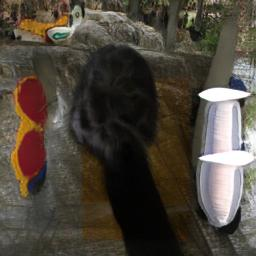

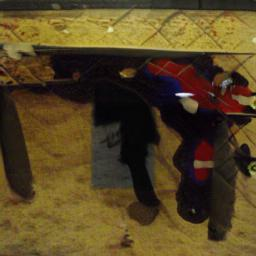

......................................................................
2040.jpg


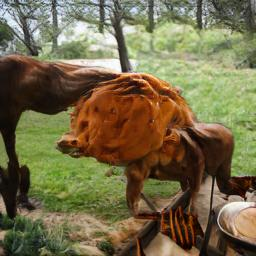

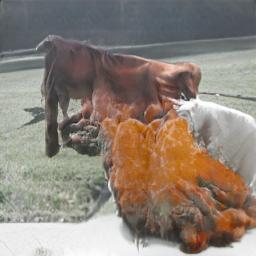

......................................................................
2772.jpg


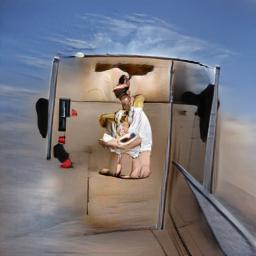

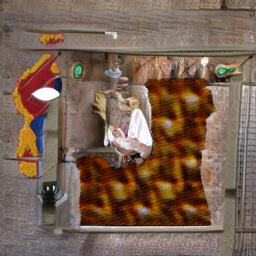

......................................................................
2128.jpg


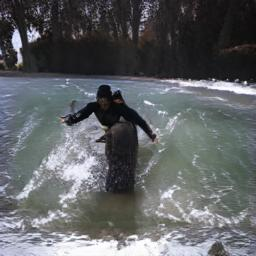

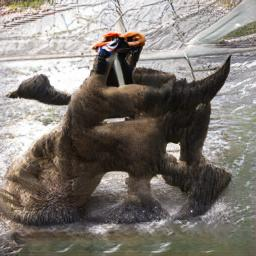

......................................................................
3347.jpg


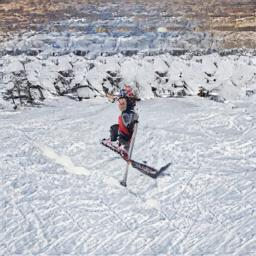

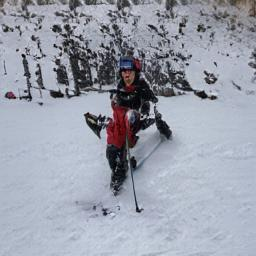

......................................................................
937.jpg


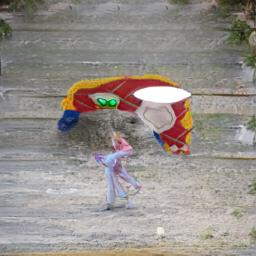

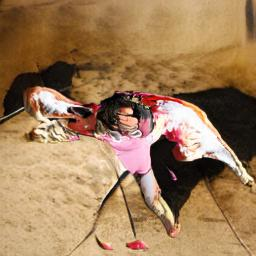

......................................................................
2900.jpg


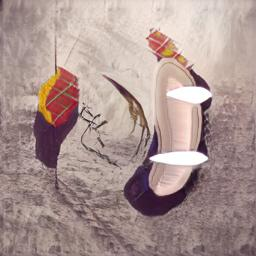

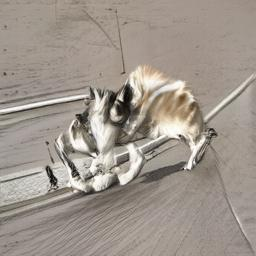

......................................................................
878.jpg


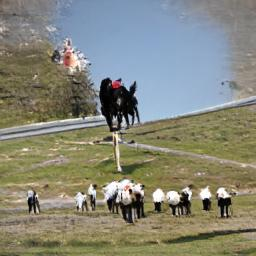

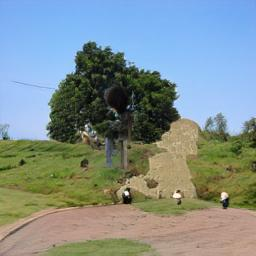

......................................................................
2764.jpg


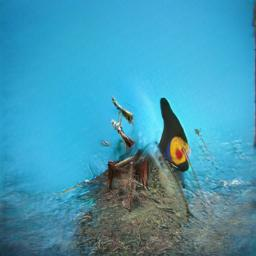

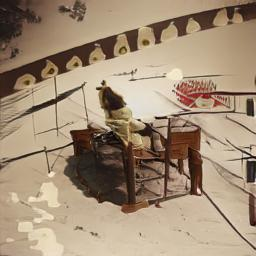

......................................................................
2932.jpg


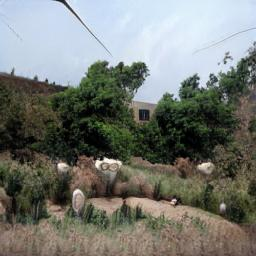

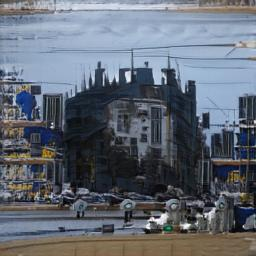

......................................................................
3429.jpg


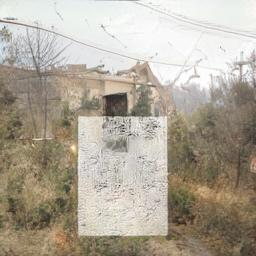

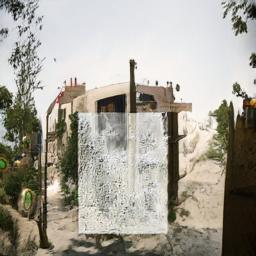

......................................................................
970.jpg


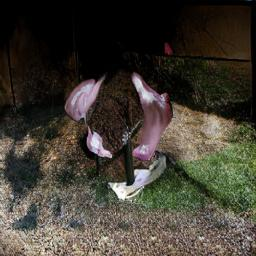

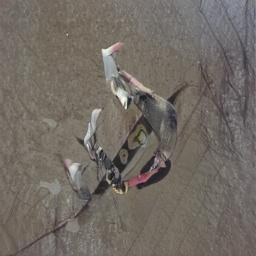

......................................................................
2262.jpg


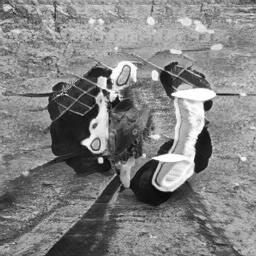

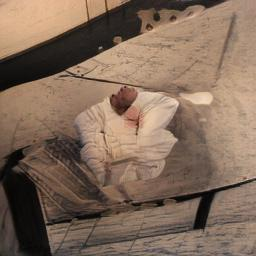

......................................................................
2015.jpg


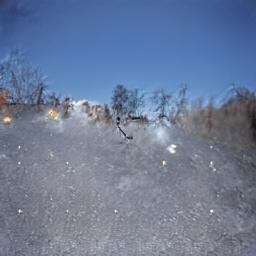

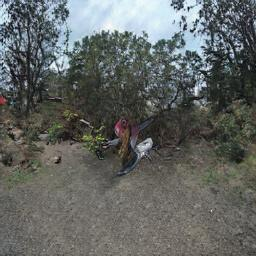

......................................................................
531.jpg


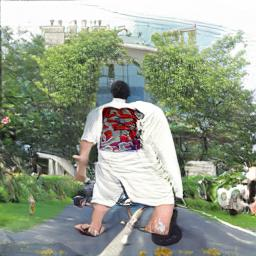

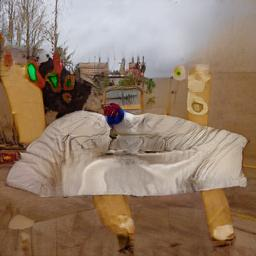

......................................................................
2170.jpg


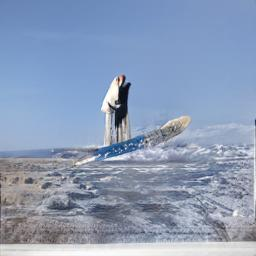

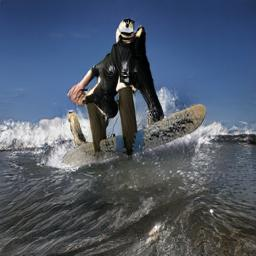

......................................................................
1748.jpg


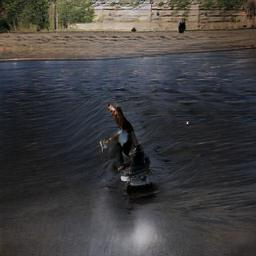

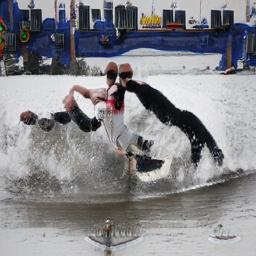

......................................................................
3049.jpg


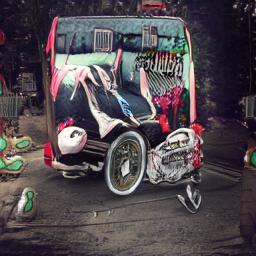

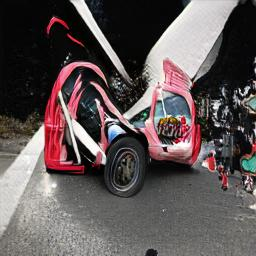

......................................................................
272.jpg


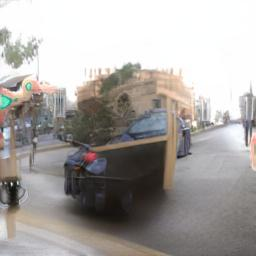

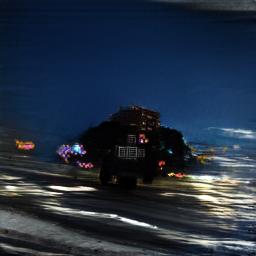

......................................................................
2080.jpg


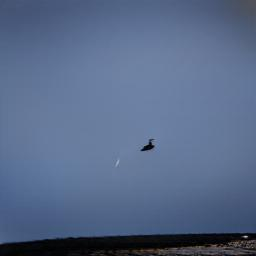

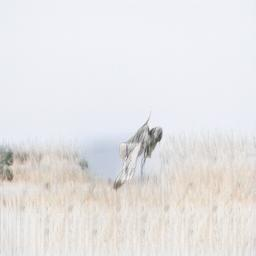

......................................................................
2760.jpg


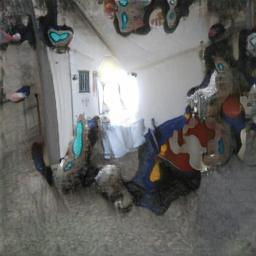

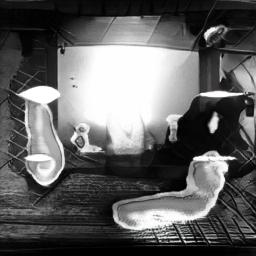

......................................................................
3594.jpg


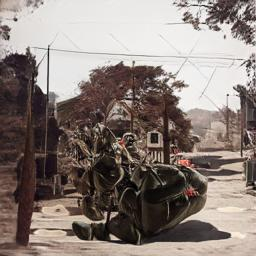

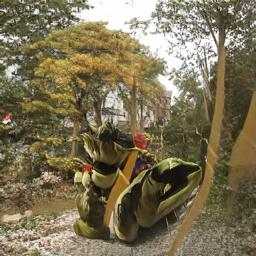

......................................................................
2657.jpg


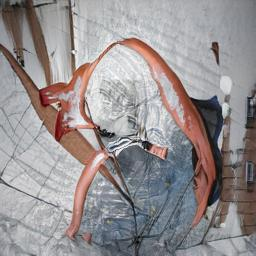

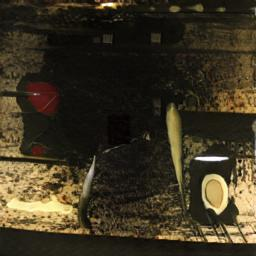

......................................................................
3513.jpg


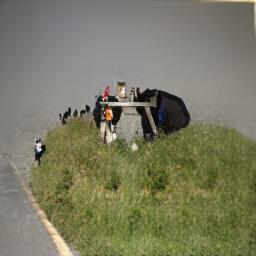

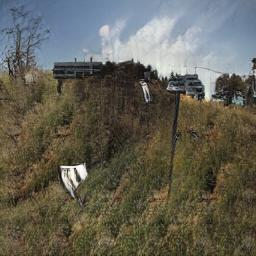

......................................................................
974.jpg


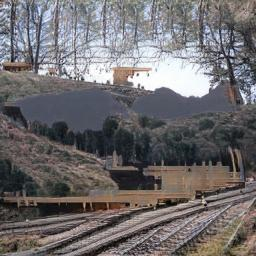

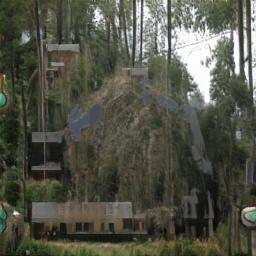

......................................................................
1591.jpg


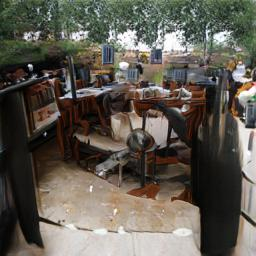

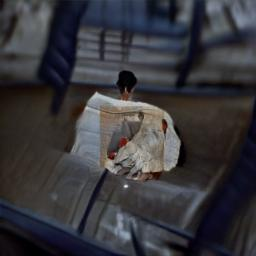

......................................................................
1952.jpg


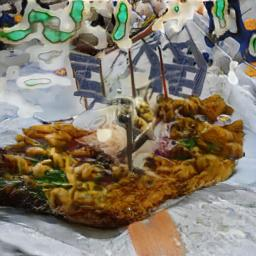

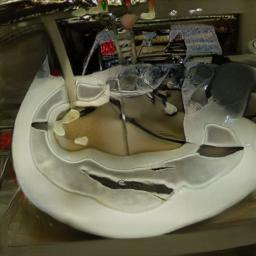

......................................................................
276.jpg


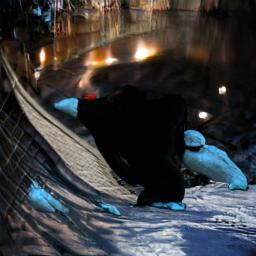

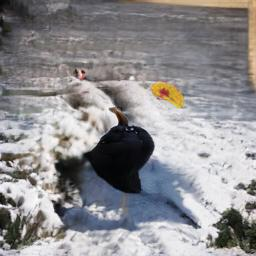

......................................................................
2022.jpg


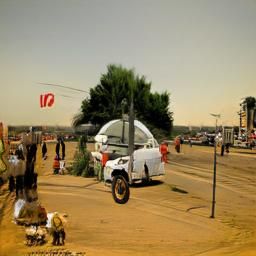

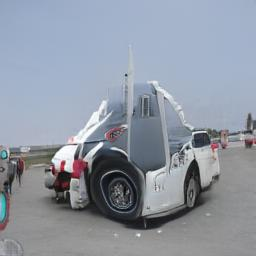

......................................................................
3115.jpg


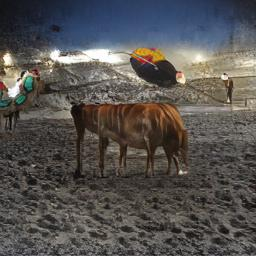

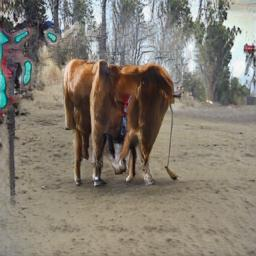

......................................................................
1598.jpg


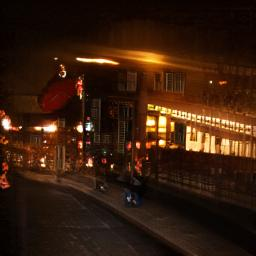

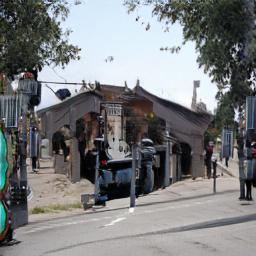

......................................................................
269.jpg


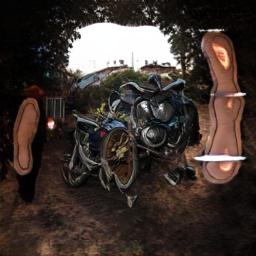

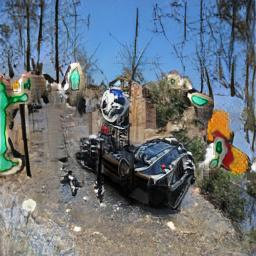

......................................................................
3414.jpg


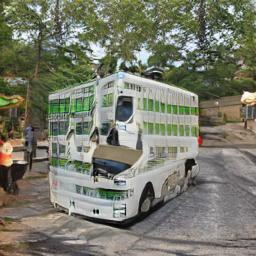

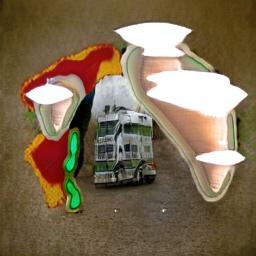

......................................................................
1276.jpg


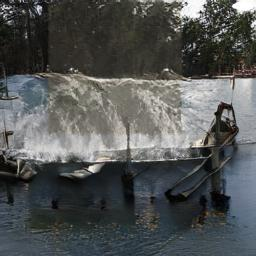

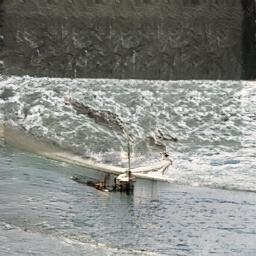

......................................................................
2297.jpg


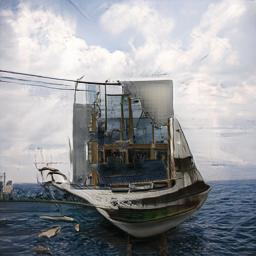

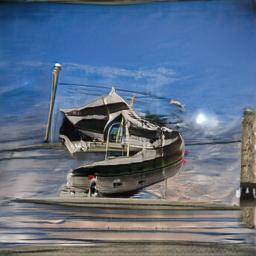

......................................................................
536.jpg


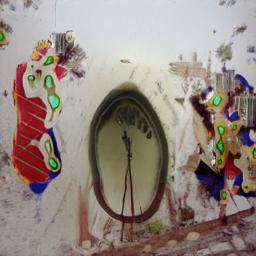

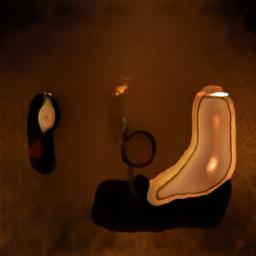

......................................................................
160.jpg


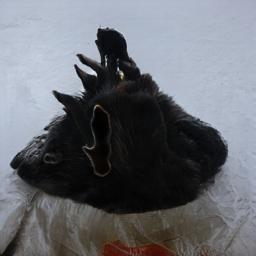

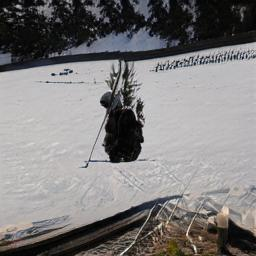

......................................................................
1096.jpg


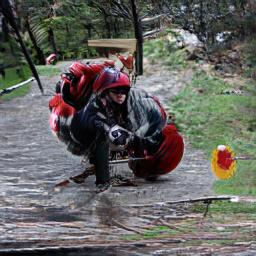

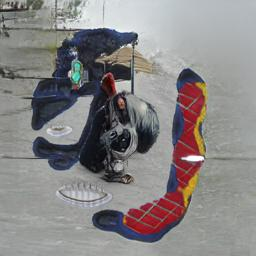

......................................................................
1187.jpg


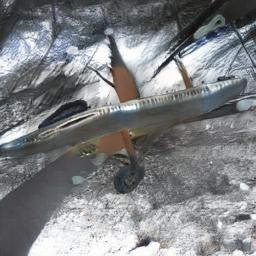

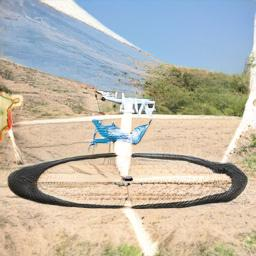

......................................................................
3487.jpg


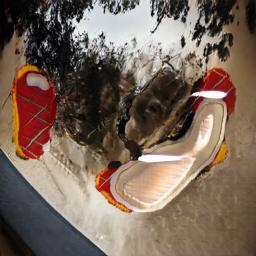

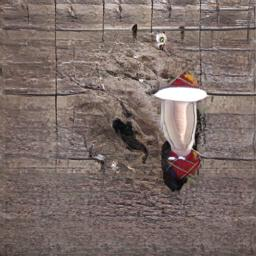

......................................................................
3096.jpg


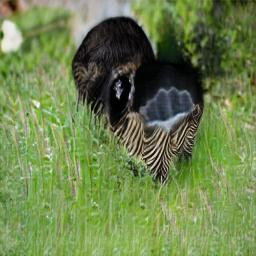

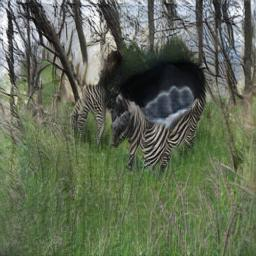

......................................................................
2666.jpg


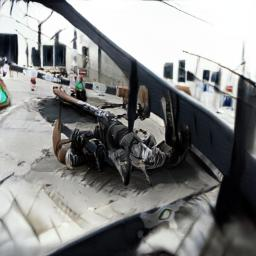

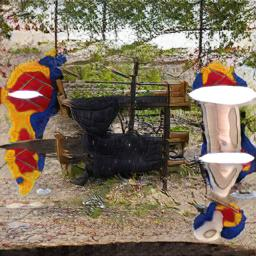

......................................................................
650.jpg


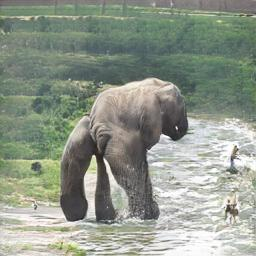

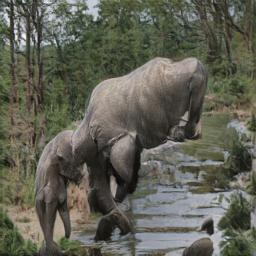

......................................................................
3147.jpg


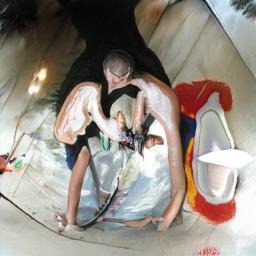

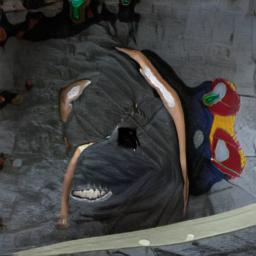

......................................................................
3538.jpg


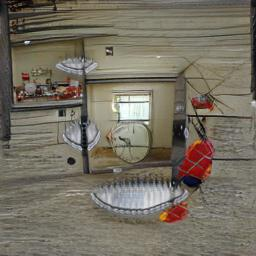

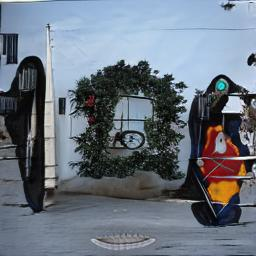

......................................................................
1397.jpg


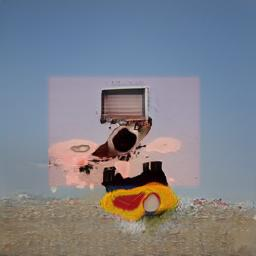

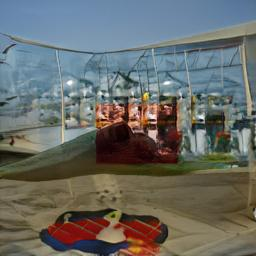

......................................................................
2340.jpg


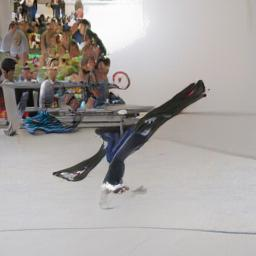

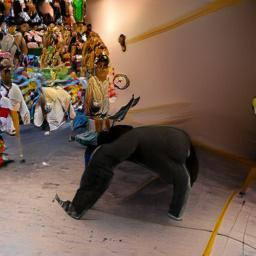

......................................................................
2585.jpg


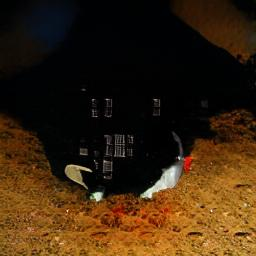

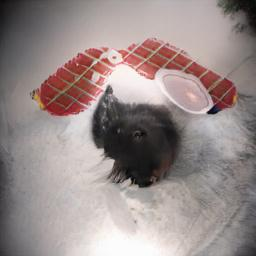

......................................................................
938.jpg


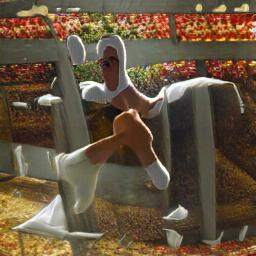

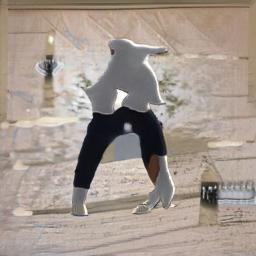

......................................................................
379.jpg


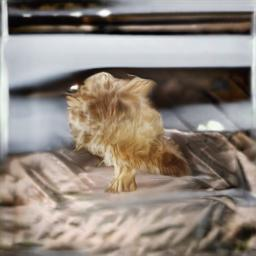

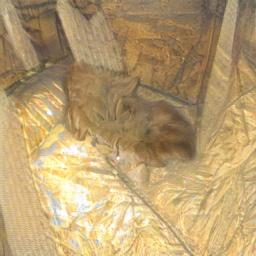

......................................................................
1756.jpg


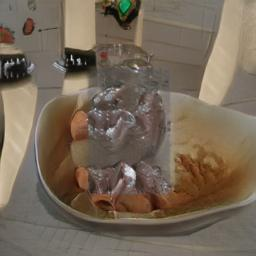

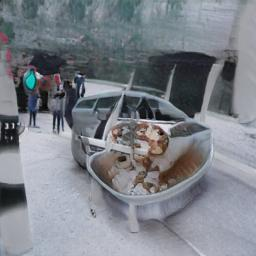

......................................................................
2580.jpg


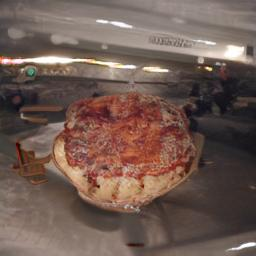

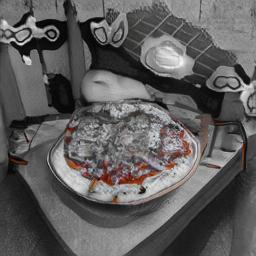

......................................................................
806.jpg


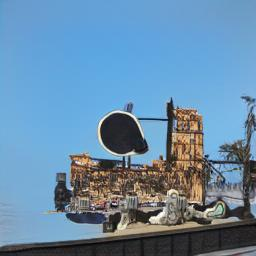

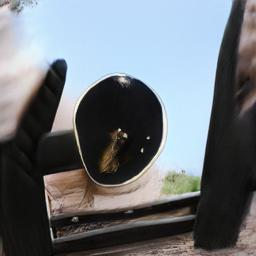

......................................................................
2635.jpg


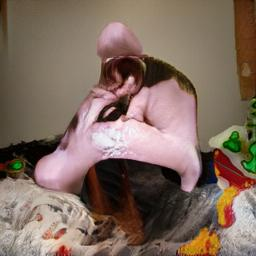

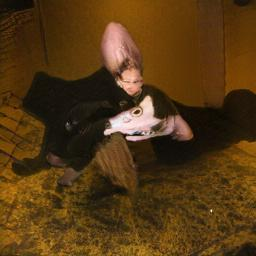

......................................................................
645.jpg


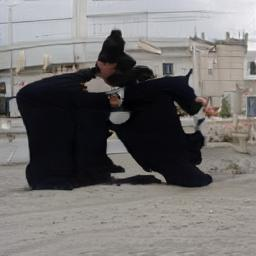

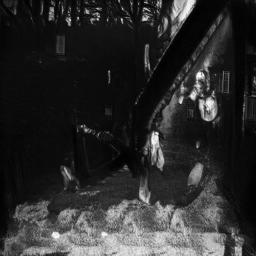

......................................................................
1382.jpg


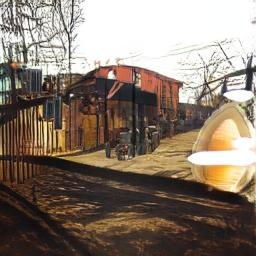

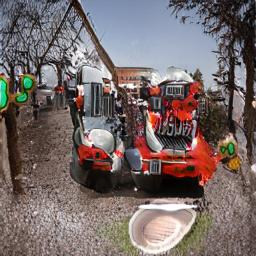

......................................................................
2491.jpg


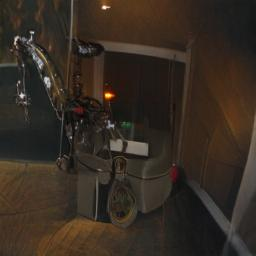

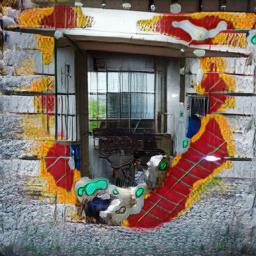

......................................................................
571.jpg


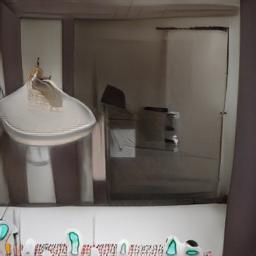

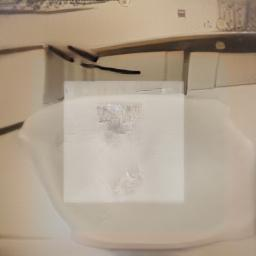

......................................................................
449.jpg


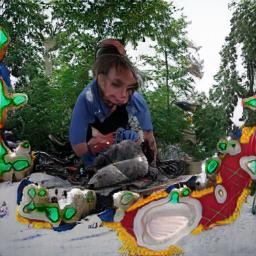

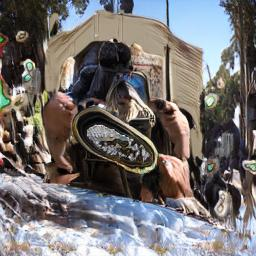

......................................................................
18.jpg


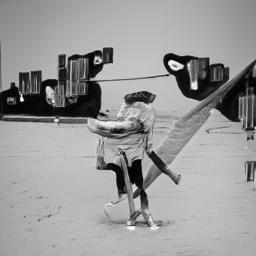

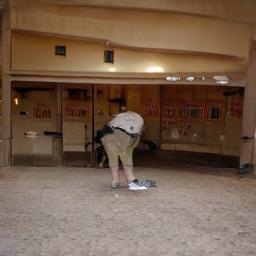

......................................................................
280.jpg


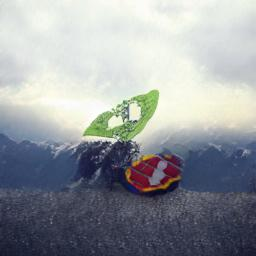

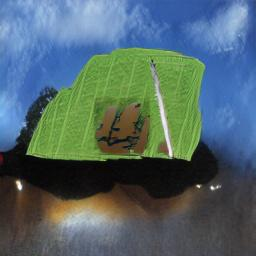

......................................................................
2382.jpg


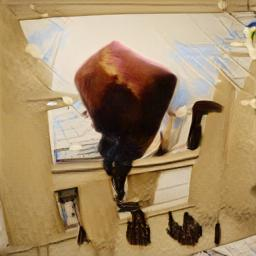

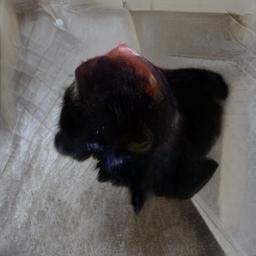

......................................................................
2283.jpg


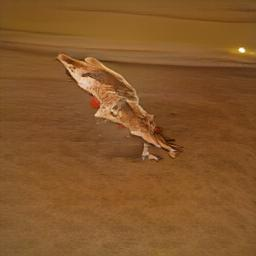

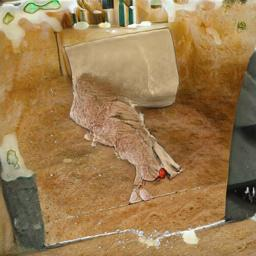

......................................................................
990.jpg


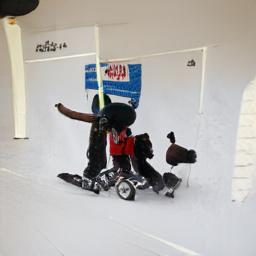

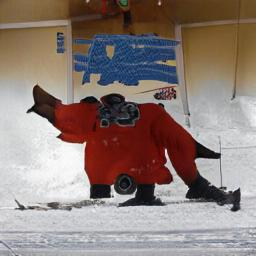

......................................................................
1168.jpg


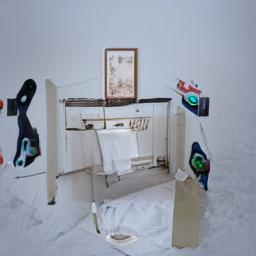

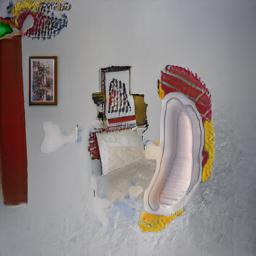

......................................................................
1484.jpg


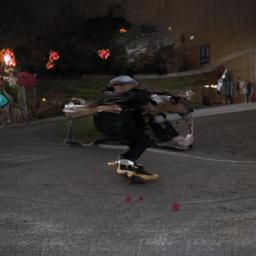

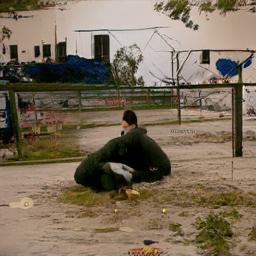

......................................................................
2955.jpg


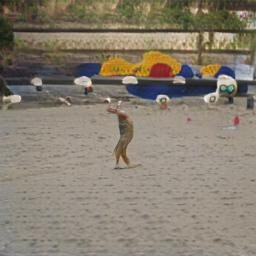

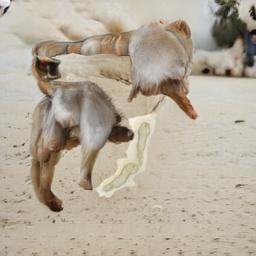

......................................................................
40.jpg


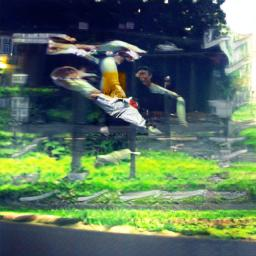

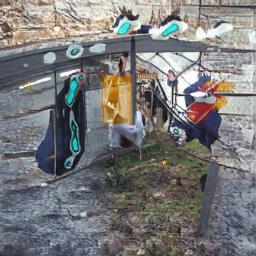

......................................................................
1179.jpg


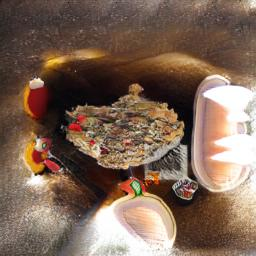

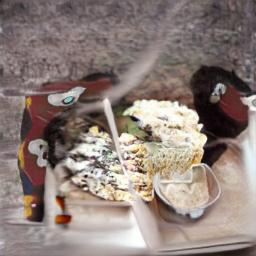

......................................................................
275.jpg


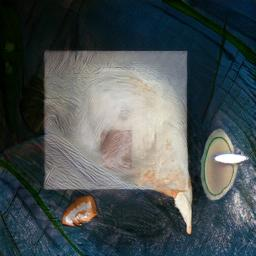

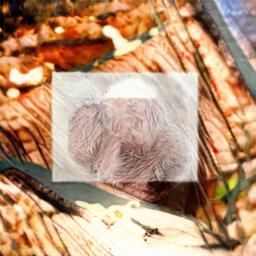

......................................................................
391.jpg


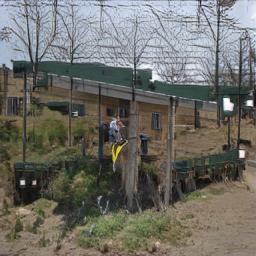

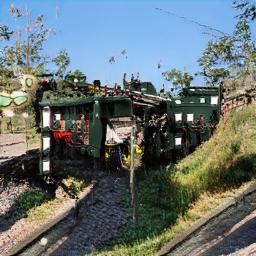

......................................................................
3555.jpg


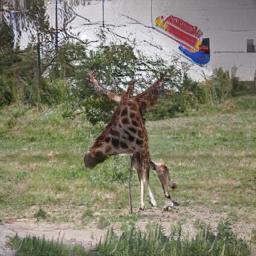

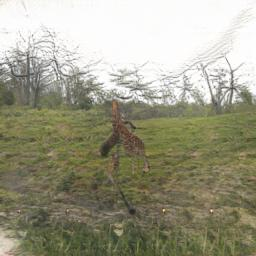

......................................................................
369.jpg


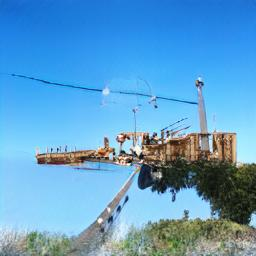

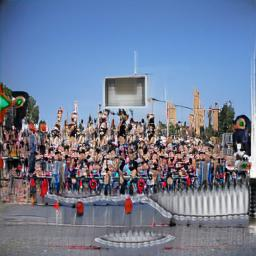

......................................................................
3216.jpg


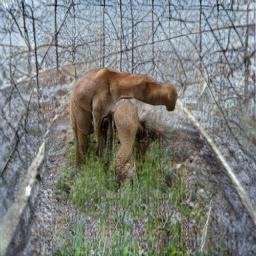

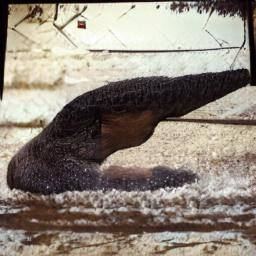

......................................................................
179.jpg


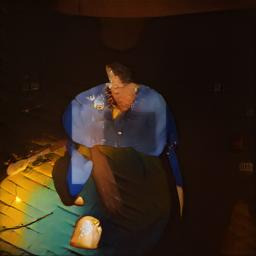

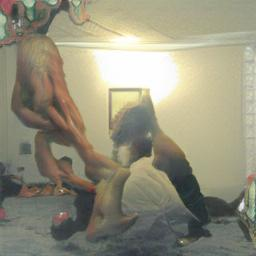

......................................................................
2226.jpg


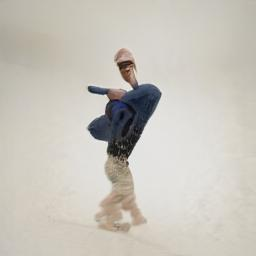

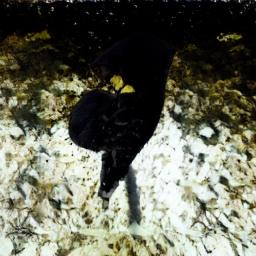

......................................................................
828.jpg


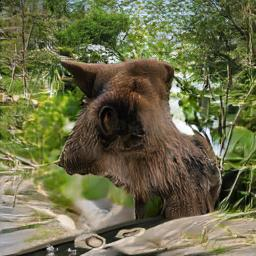

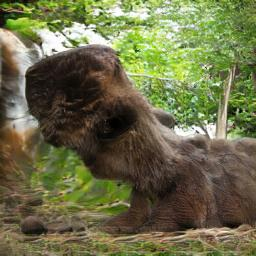

......................................................................
1820.jpg


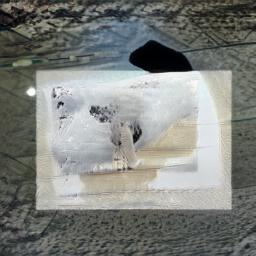

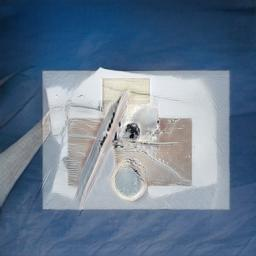

......................................................................
942.jpg


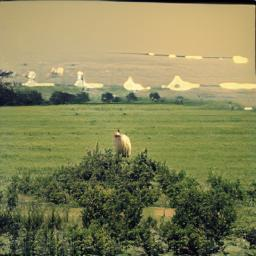

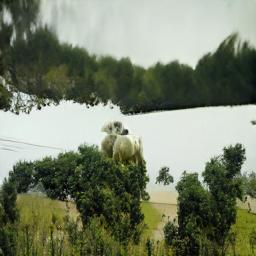

......................................................................
3462.jpg


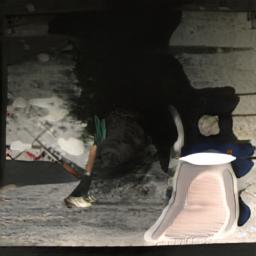

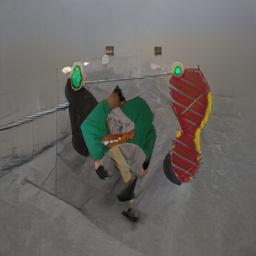

......................................................................
1078.jpg


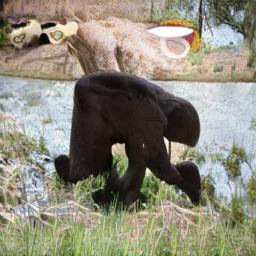

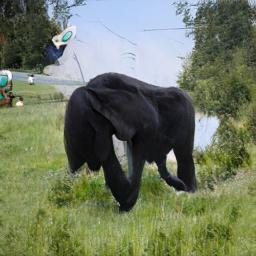

......................................................................
1528.jpg


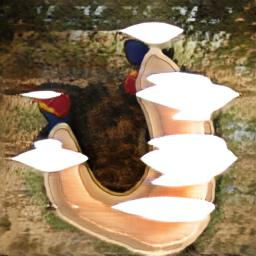

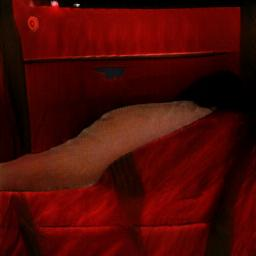

......................................................................
1665.jpg


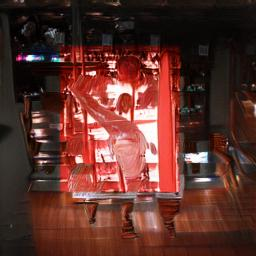

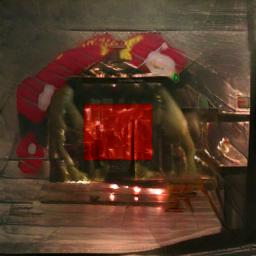

......................................................................
2682.jpg


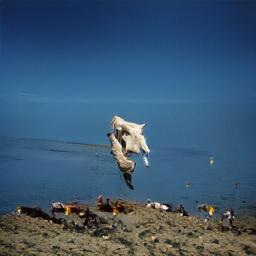

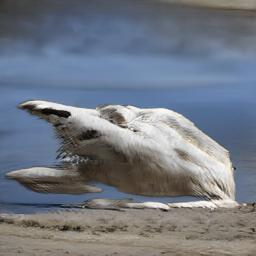

......................................................................
644.jpg


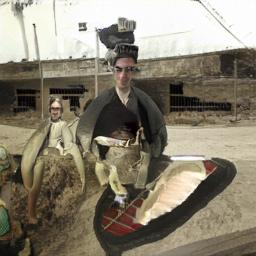

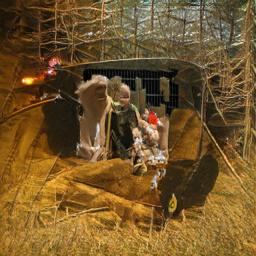

......................................................................
1346.jpg


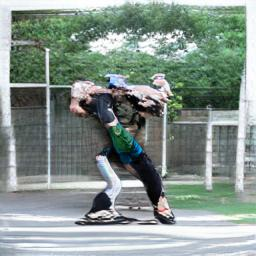

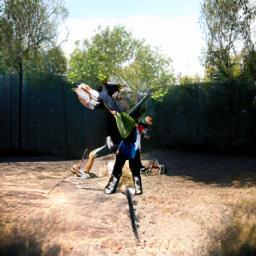

......................................................................
3307.jpg


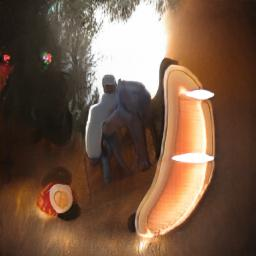

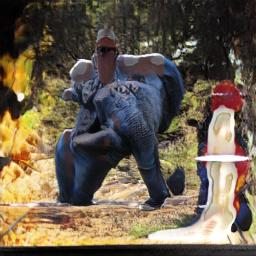

......................................................................
2370.jpg


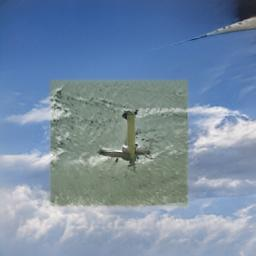

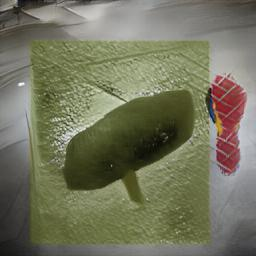

......................................................................
1191.jpg


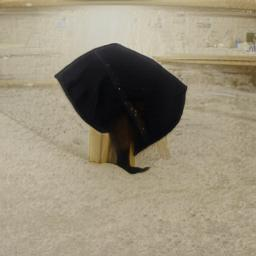

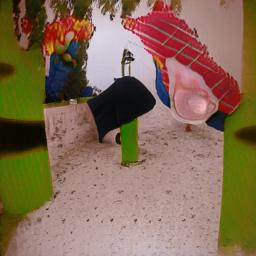

......................................................................
2066.jpg


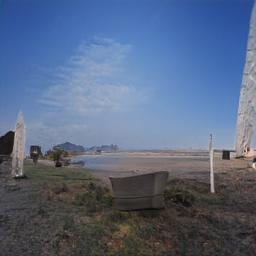

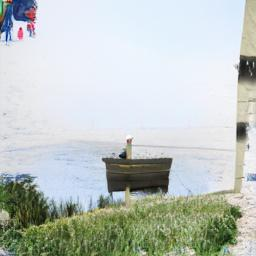

......................................................................
1141.jpg


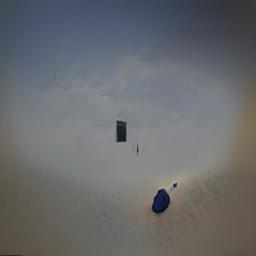

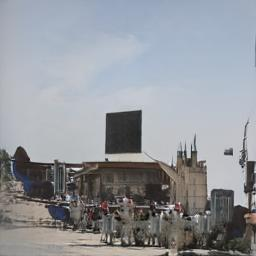

......................................................................
1443.jpg


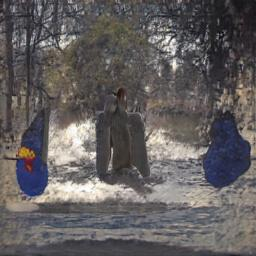

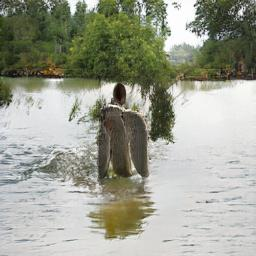

......................................................................
3138.jpg


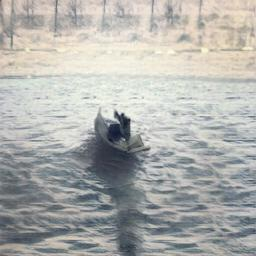

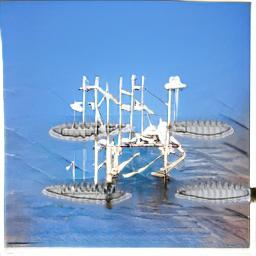

......................................................................
1231.jpg


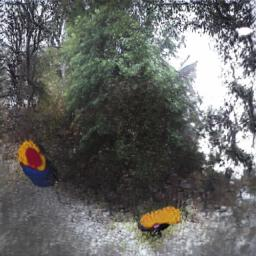

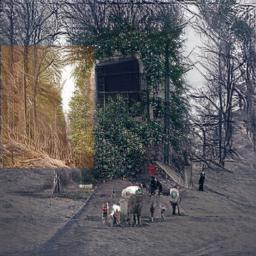

......................................................................
340.jpg


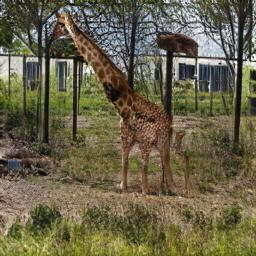

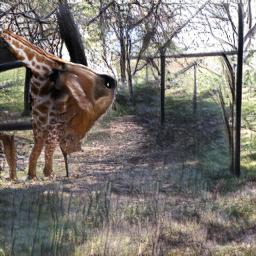

......................................................................
71.jpg


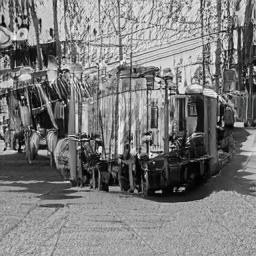

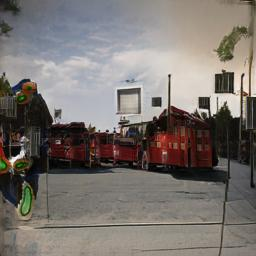

......................................................................
1404.jpg


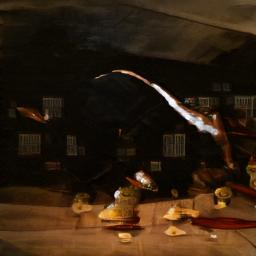

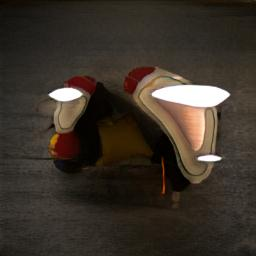

......................................................................
2144.jpg


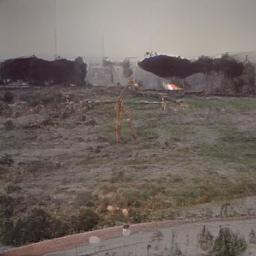

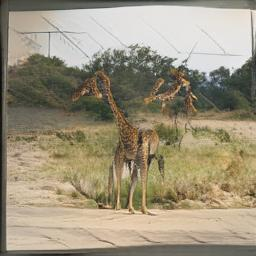

......................................................................
1263.jpg


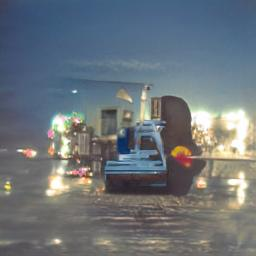

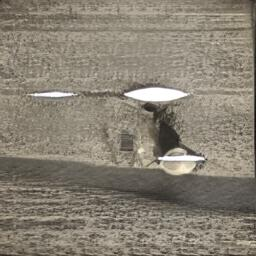

......................................................................
2162.jpg


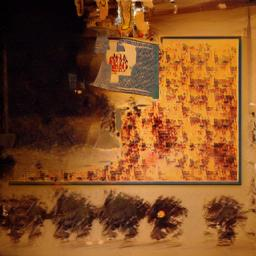

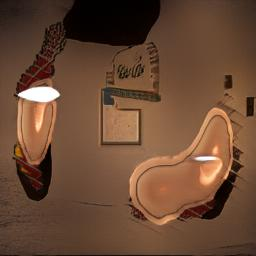

......................................................................
1355.jpg


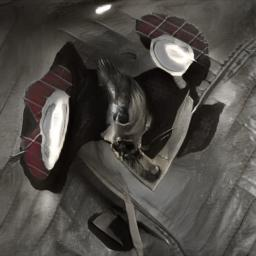

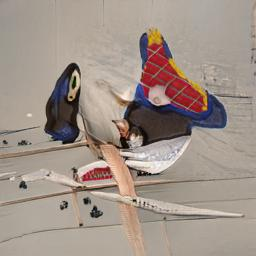

......................................................................
1508.jpg


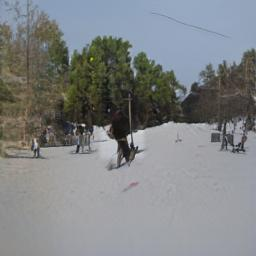

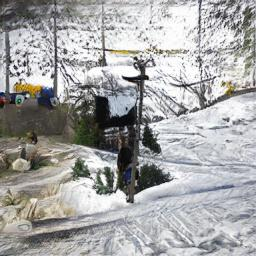

......................................................................
244.jpg


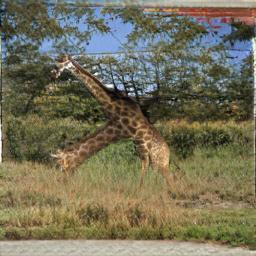

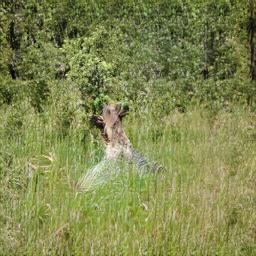

......................................................................
1737.jpg


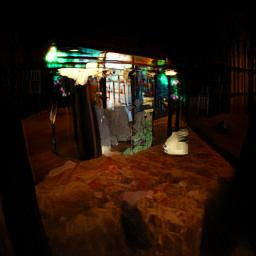

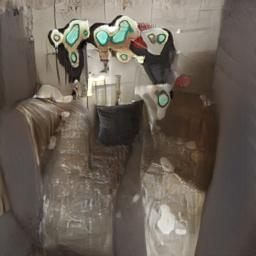

......................................................................
2678.jpg


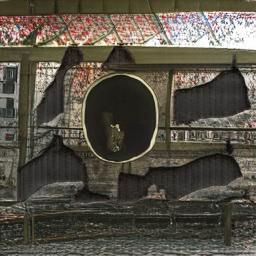

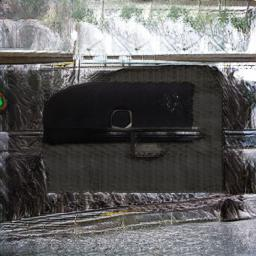

......................................................................
1677.jpg


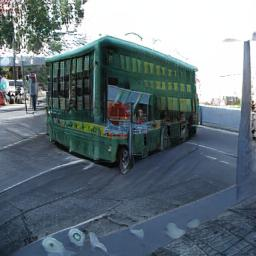

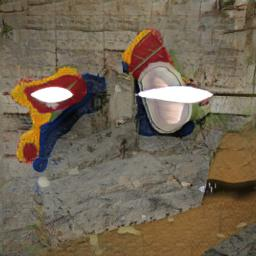

......................................................................
2104.jpg


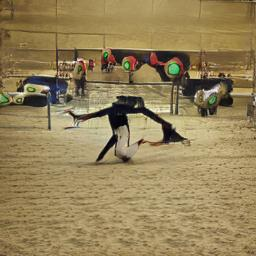

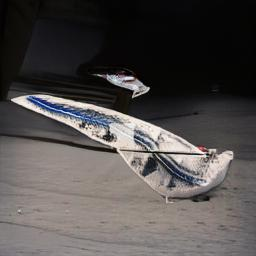

......................................................................
3036.jpg


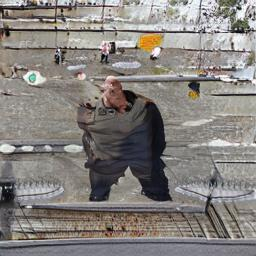

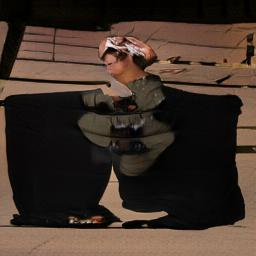

......................................................................
1962.jpg


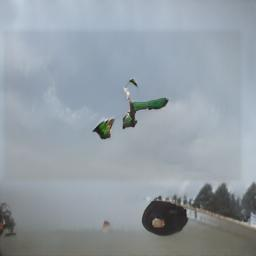

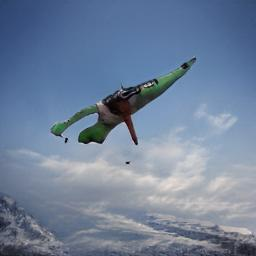

......................................................................
1114.jpg


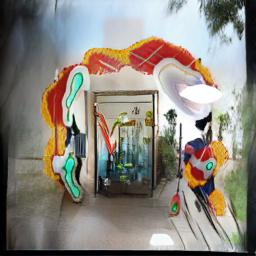

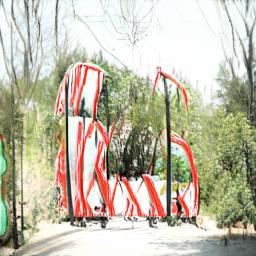

......................................................................
1547.jpg


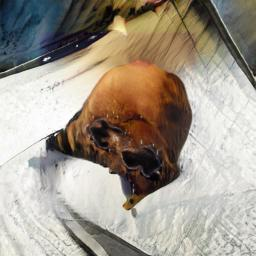

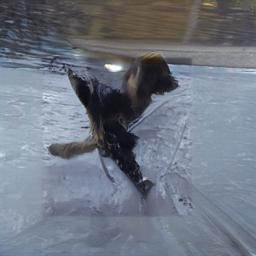

......................................................................
1021.jpg


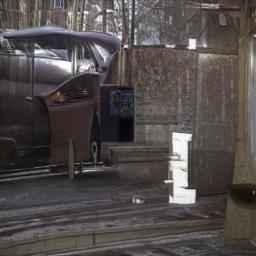

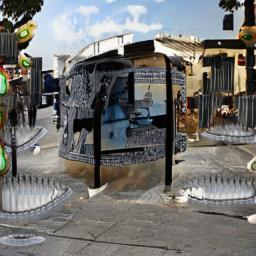

......................................................................
2523.jpg


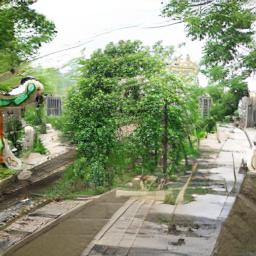

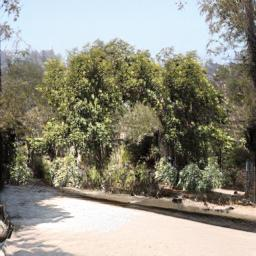

......................................................................
3522.jpg


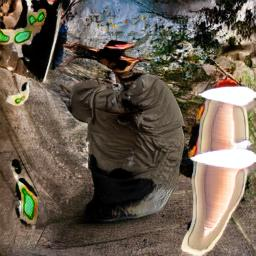

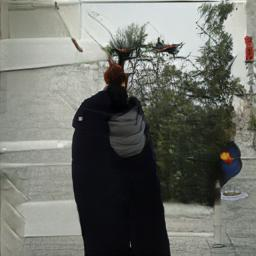

......................................................................
1783.jpg


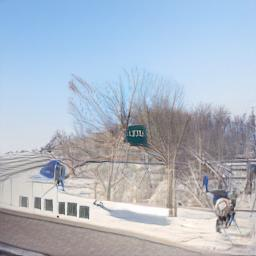

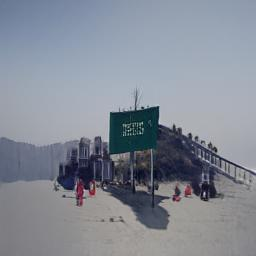

......................................................................
639.jpg


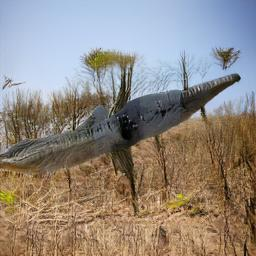

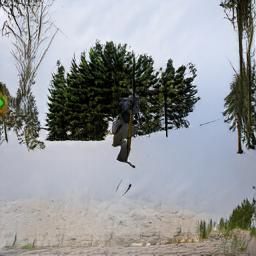

......................................................................
255.jpg


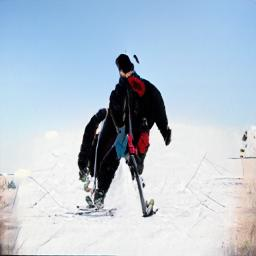

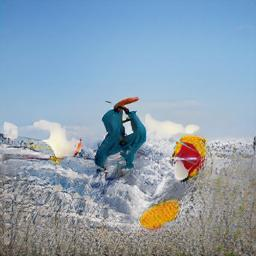

......................................................................
984.jpg


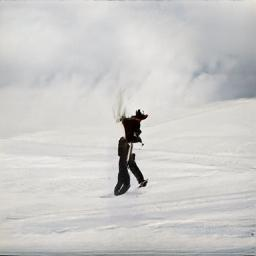

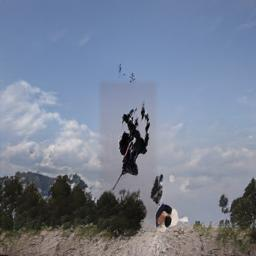

......................................................................
3387.jpg


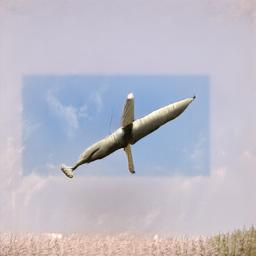

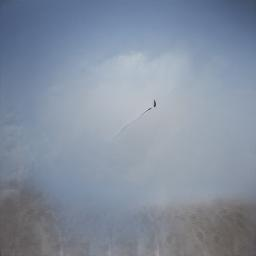

......................................................................
19.jpg


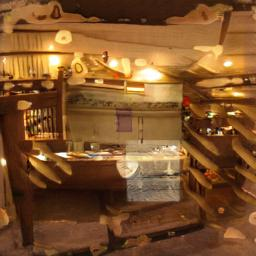

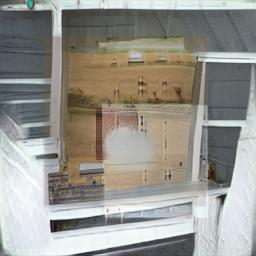

......................................................................
1930.jpg


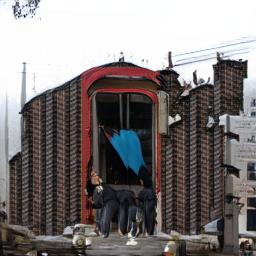

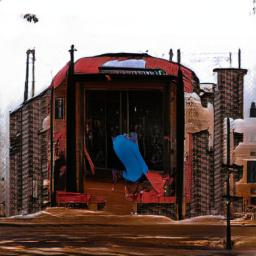

......................................................................
3440.jpg


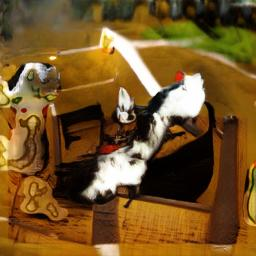

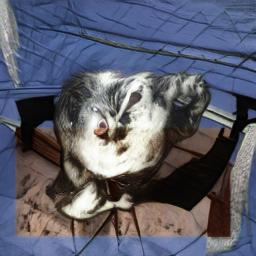

......................................................................
1220.jpg


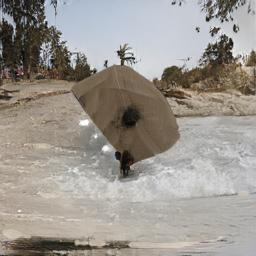

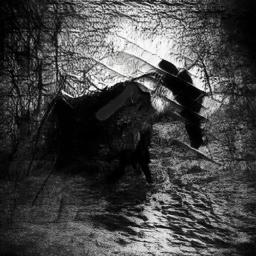

......................................................................
746.jpg


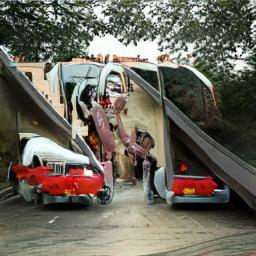

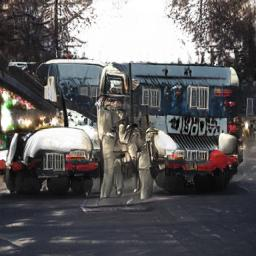

......................................................................
815.jpg


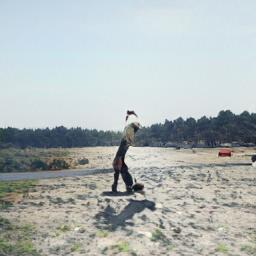

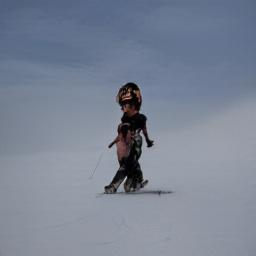

......................................................................
2276.jpg


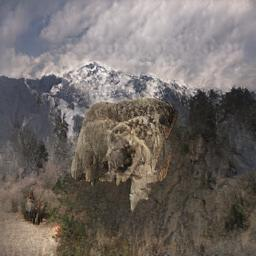

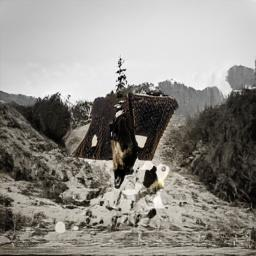

......................................................................
3092.jpg


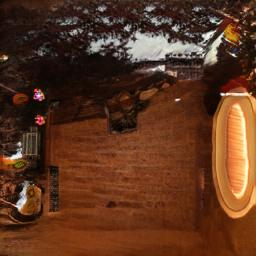

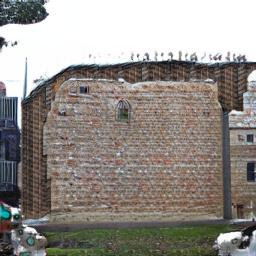

......................................................................
3103.jpg


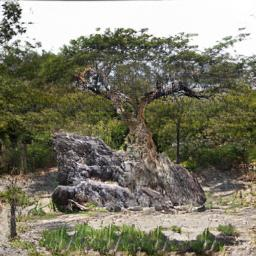

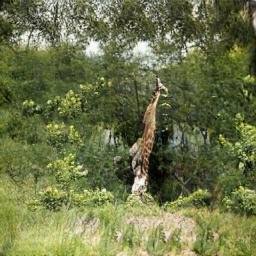

......................................................................
513.jpg


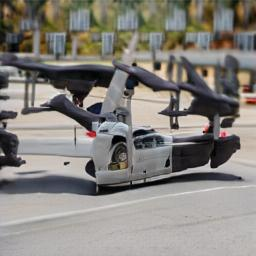

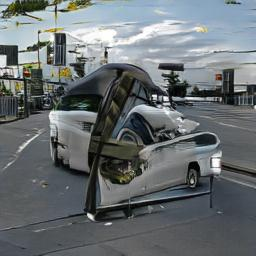

......................................................................
3061.jpg


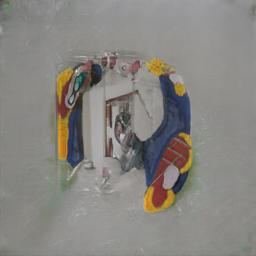

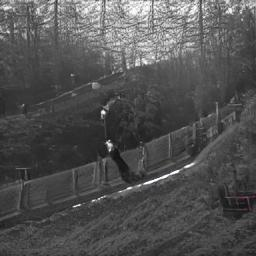

......................................................................
1058.jpg


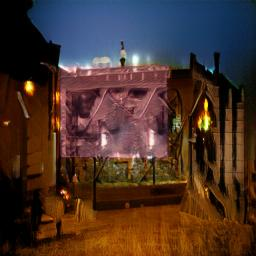

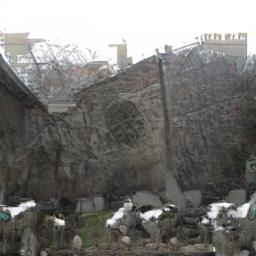

......................................................................
2213.jpg


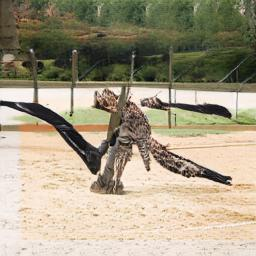

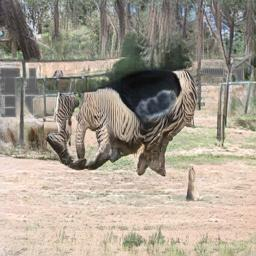

......................................................................
1139.jpg


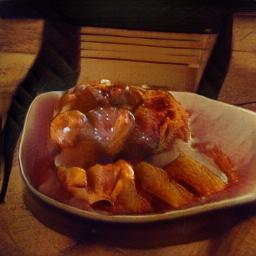

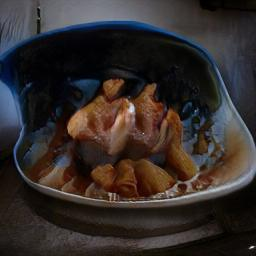

......................................................................
3025.jpg


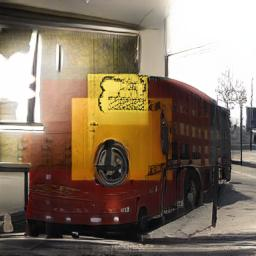

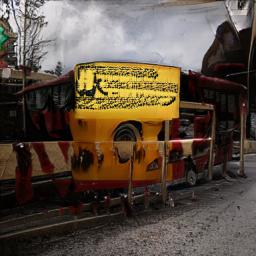

......................................................................
1602.jpg


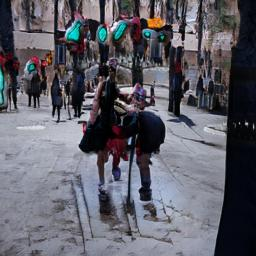

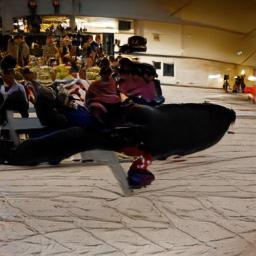

......................................................................
126.jpg


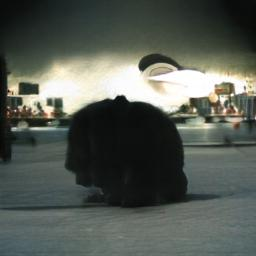

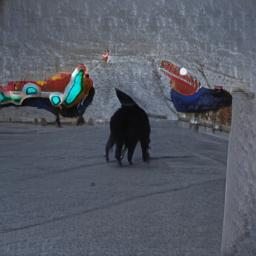

......................................................................
1488.jpg


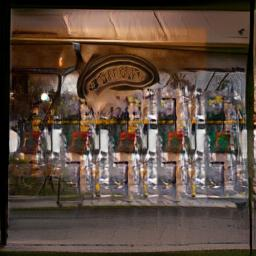

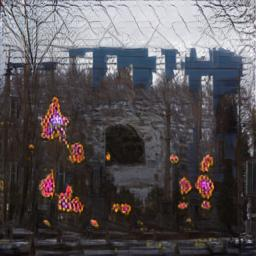

......................................................................
1005.jpg


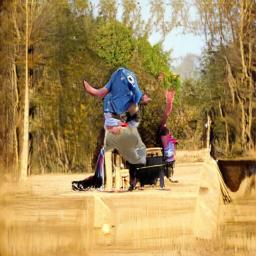

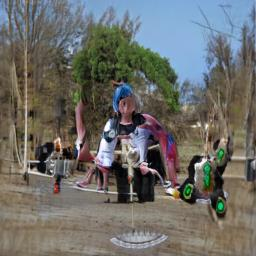

......................................................................
854.jpg


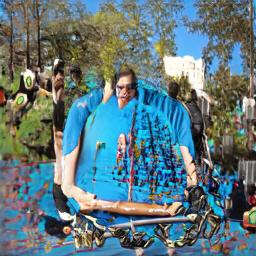

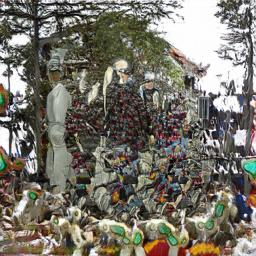

......................................................................
2904.jpg


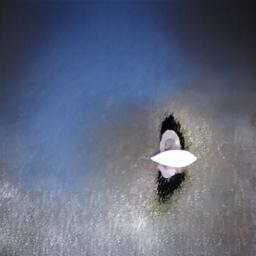

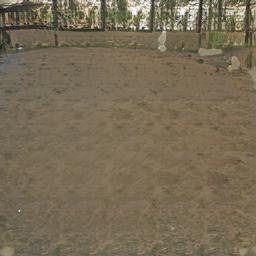

......................................................................
1218.jpg


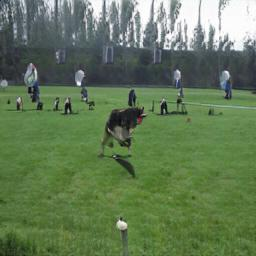

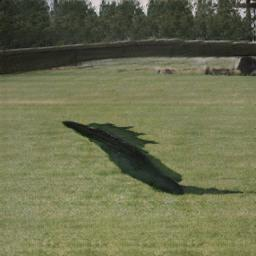

......................................................................
737.jpg


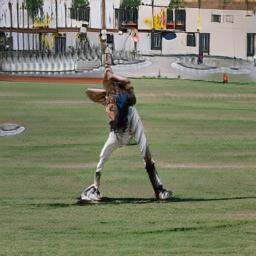

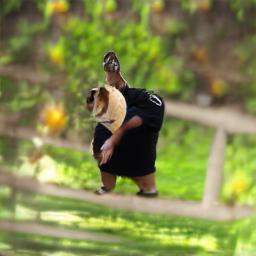

......................................................................
982.jpg


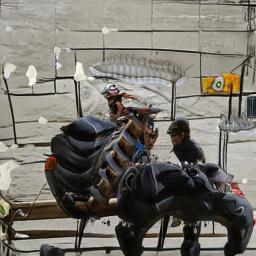

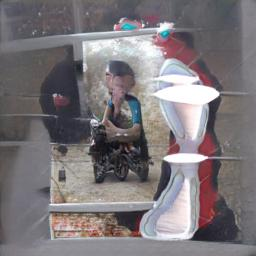

......................................................................
1068.jpg


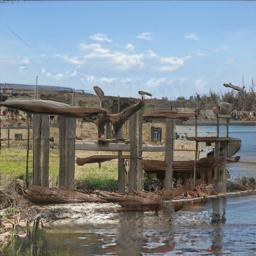

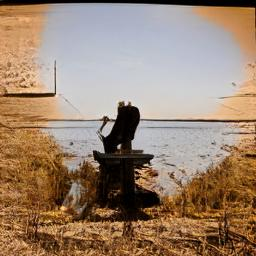

......................................................................
848.jpg


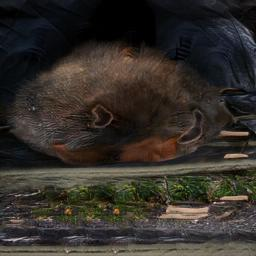

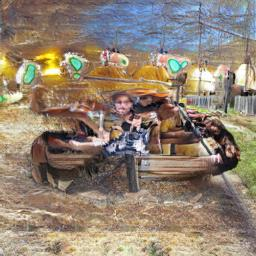

......................................................................
2840.jpg


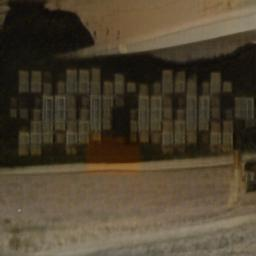

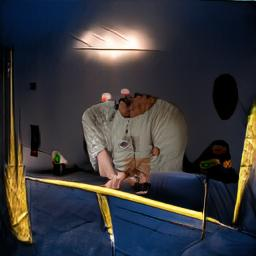

......................................................................
2831.jpg


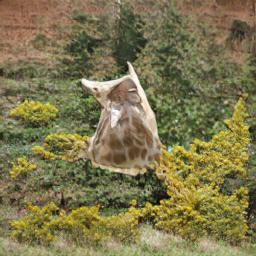

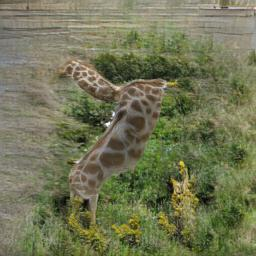

......................................................................
1843.jpg


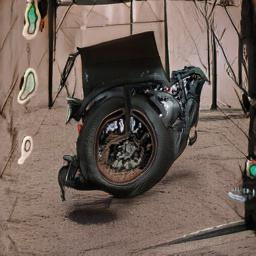

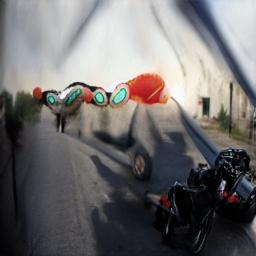

......................................................................
1294.jpg


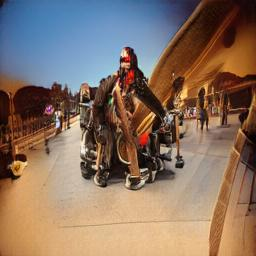

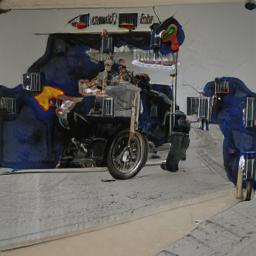

......................................................................
2107.jpg


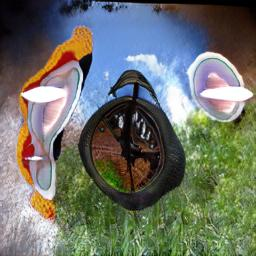

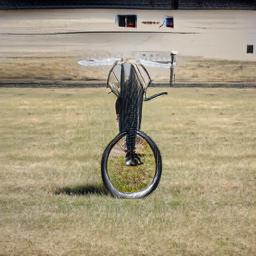

......................................................................
145.jpg


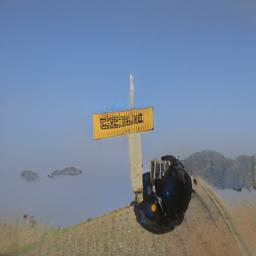

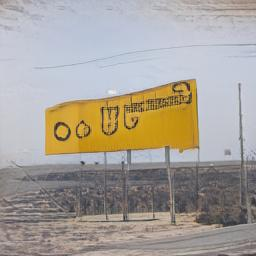

......................................................................
1828.jpg


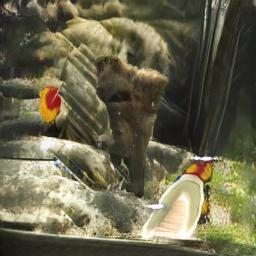

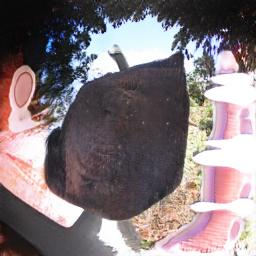

......................................................................
3003.jpg


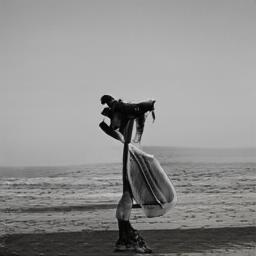

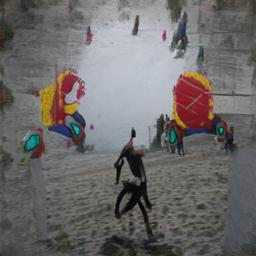

......................................................................
2443.jpg


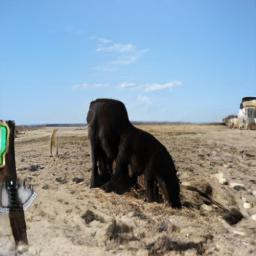

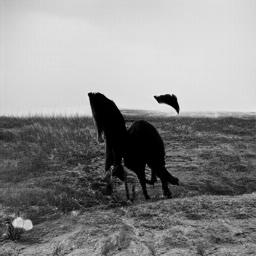

......................................................................
2372.jpg


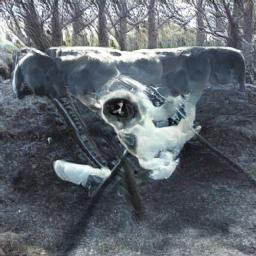

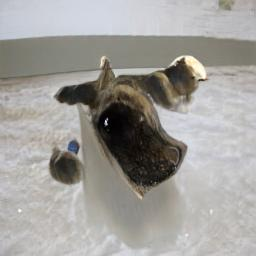

......................................................................
2824.jpg


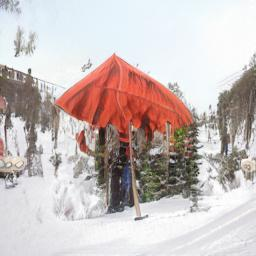

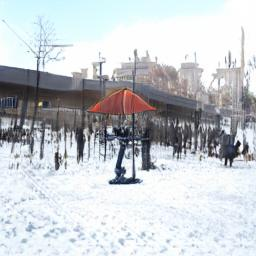

......................................................................
1174.jpg


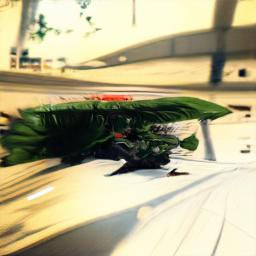

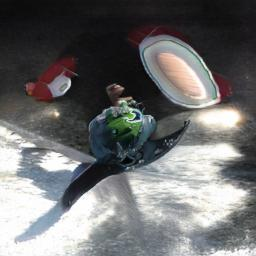

......................................................................
3029.jpg


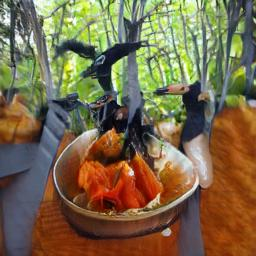

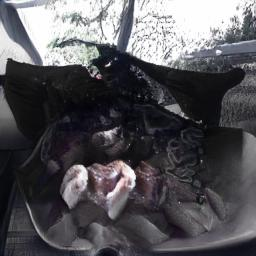

......................................................................
1460.jpg


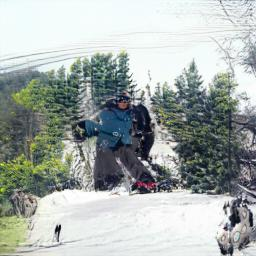

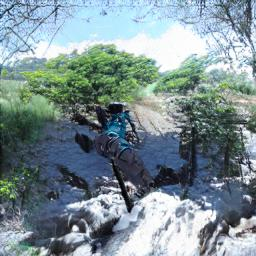

......................................................................
1705.jpg


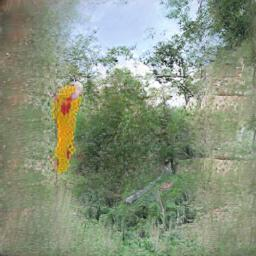

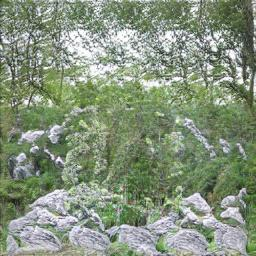

......................................................................
1806.jpg


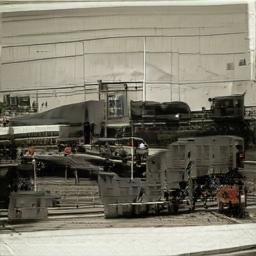

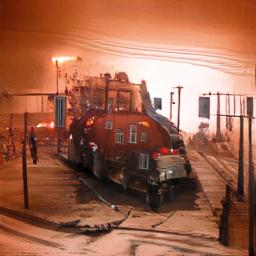

......................................................................
1246.jpg


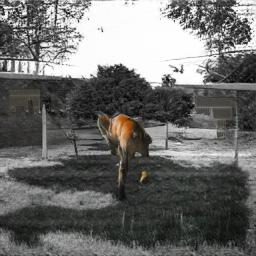

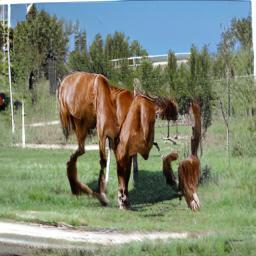

......................................................................
923.jpg


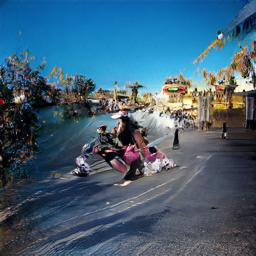

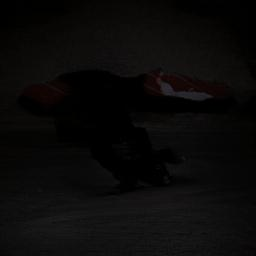

......................................................................
2325.jpg


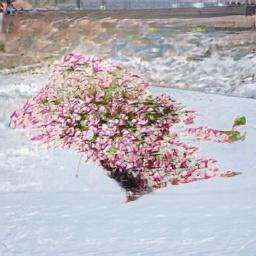

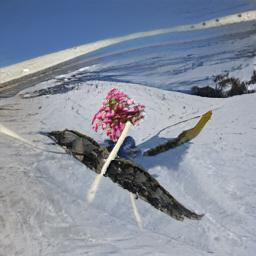

......................................................................
1565.jpg


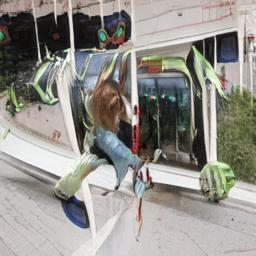

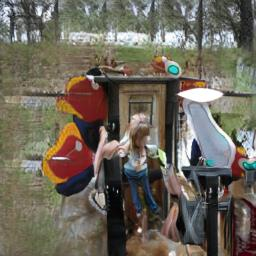

......................................................................
414.jpg


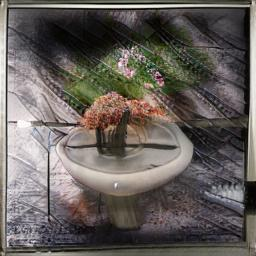

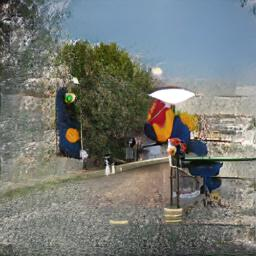

......................................................................
2866.jpg


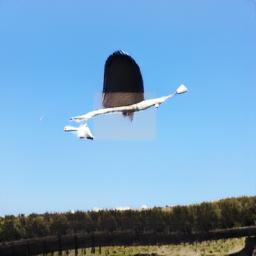

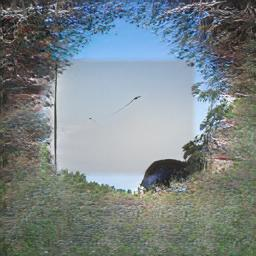

......................................................................
1245.jpg


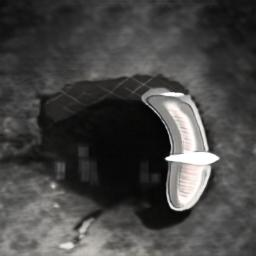

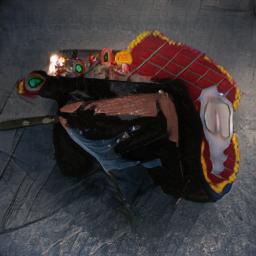

......................................................................
3306.jpg


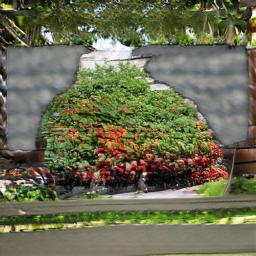

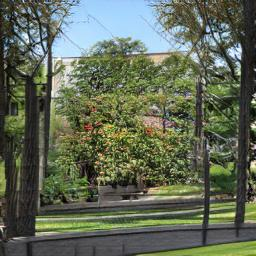

......................................................................
2718.jpg


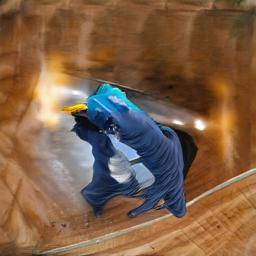

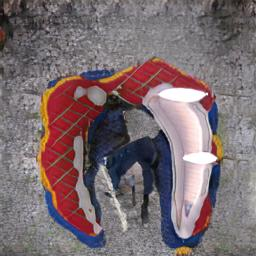

......................................................................
3283.jpg


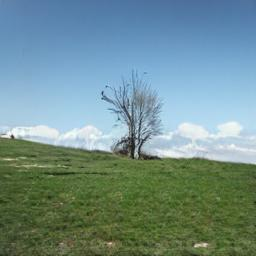

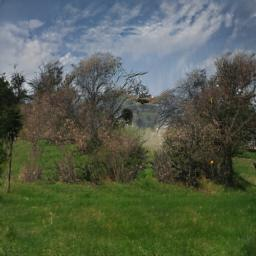

......................................................................
3268.jpg


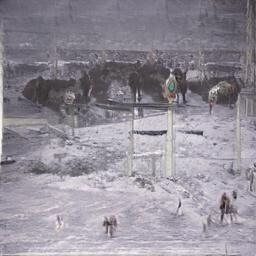

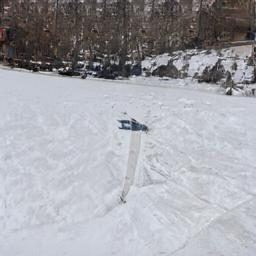

......................................................................
3255.jpg


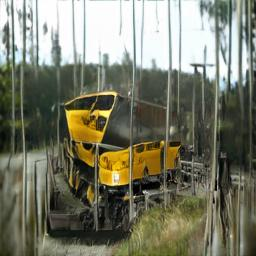

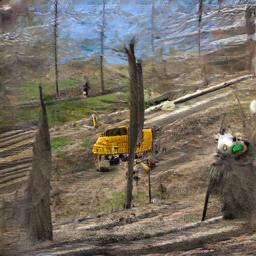

......................................................................
429.jpg


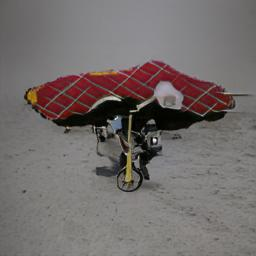

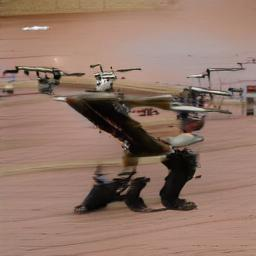

......................................................................
1053.jpg


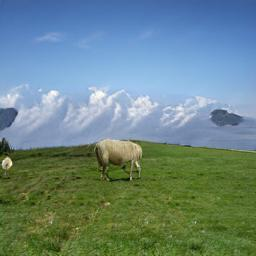

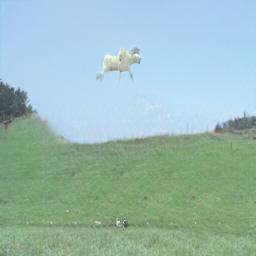

......................................................................
1601.jpg


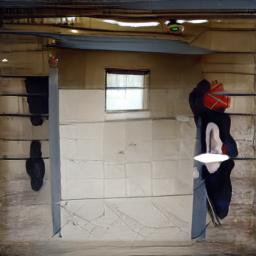

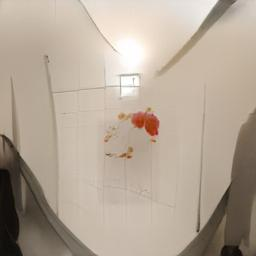

......................................................................
2782.jpg


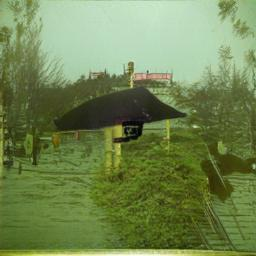

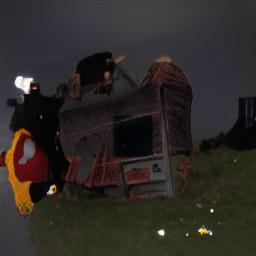

......................................................................
3365.jpg


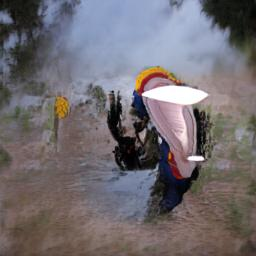

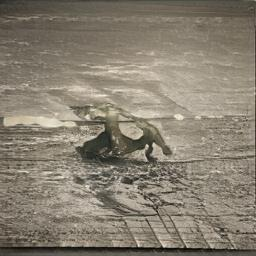

......................................................................
2252.jpg


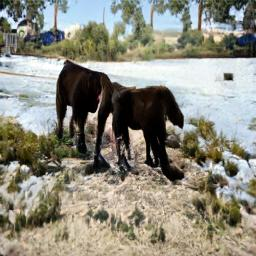

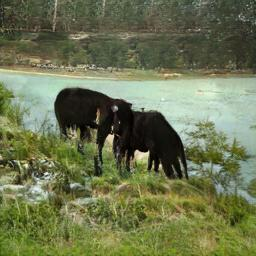

......................................................................
560.jpg


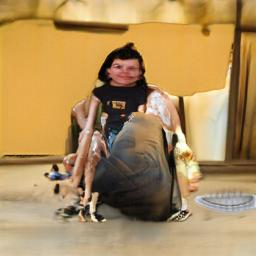

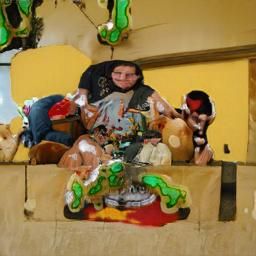

......................................................................
3305.jpg


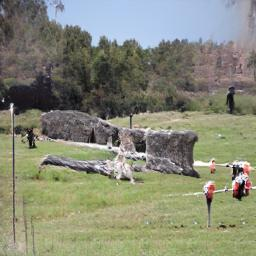

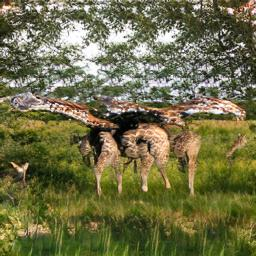

......................................................................
3433.jpg


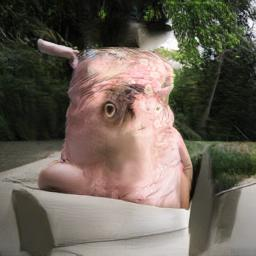

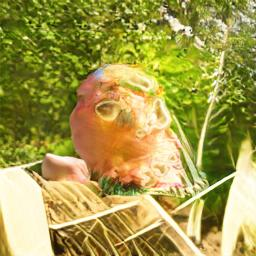

......................................................................
3436.jpg


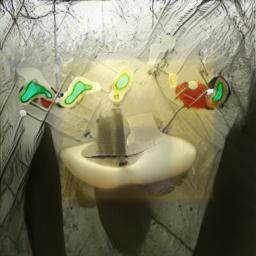

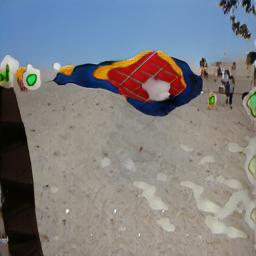

......................................................................
3035.jpg


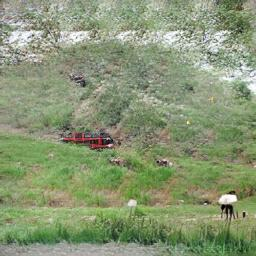

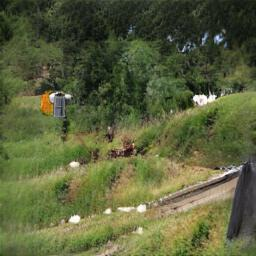

......................................................................
2779.jpg


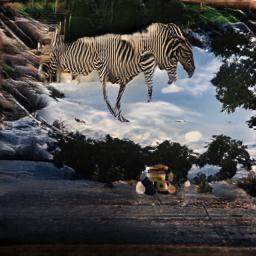

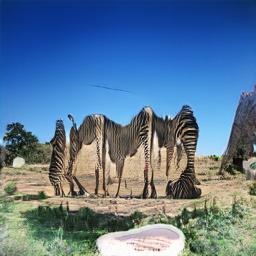

......................................................................
1918.jpg


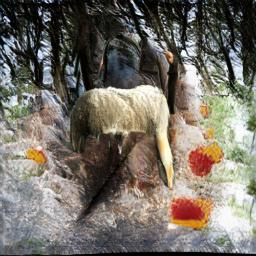

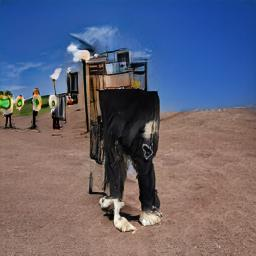

......................................................................
1797.jpg


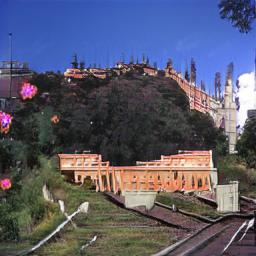

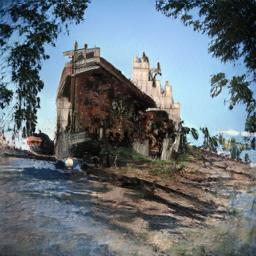

......................................................................
3090.jpg


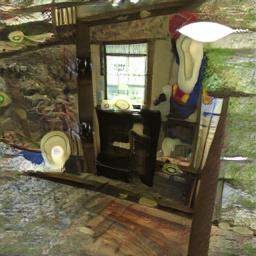

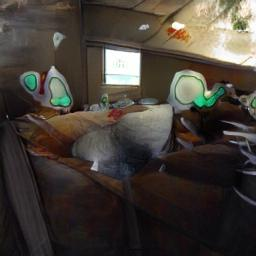

......................................................................
1275.jpg


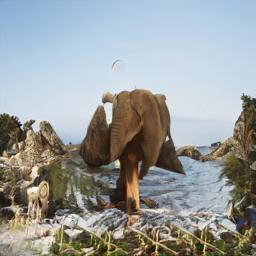

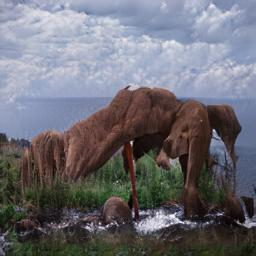

......................................................................
1747.jpg


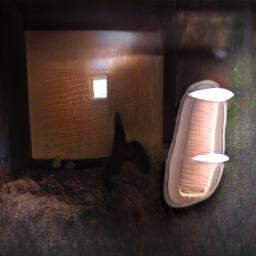

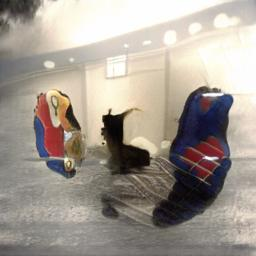

......................................................................
428.jpg


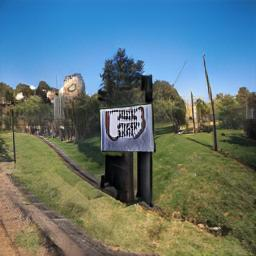

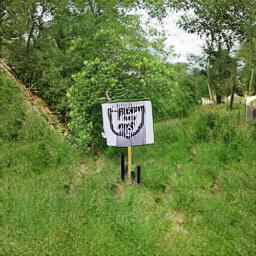

......................................................................
464.jpg


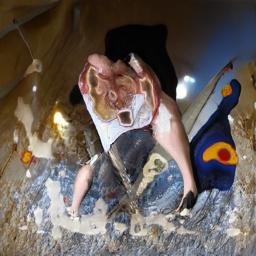

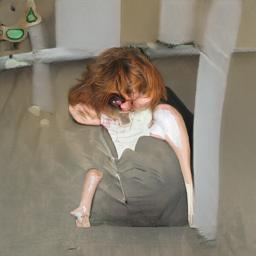

......................................................................
784.jpg


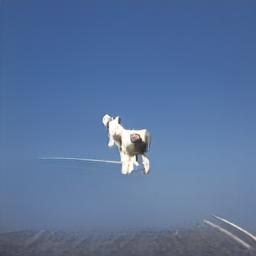

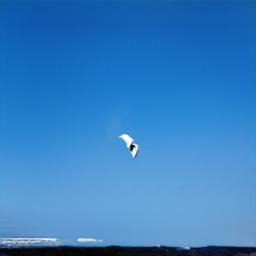

......................................................................
2963.jpg


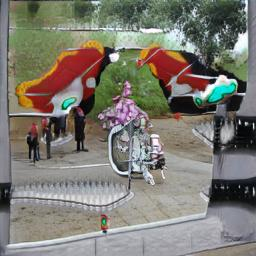

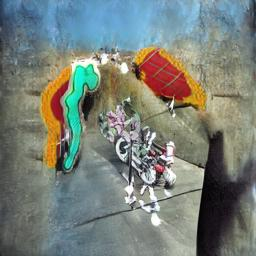

......................................................................
3286.jpg


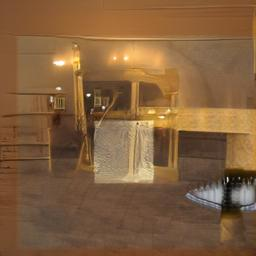

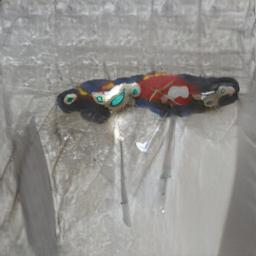

......................................................................
2808.jpg


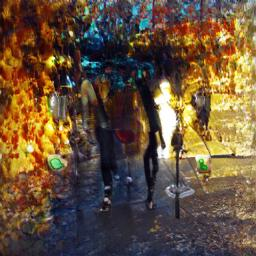

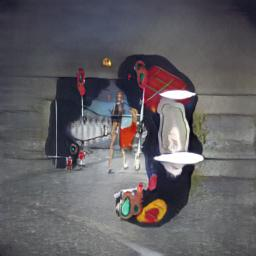

......................................................................
3323.jpg


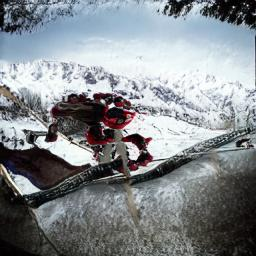

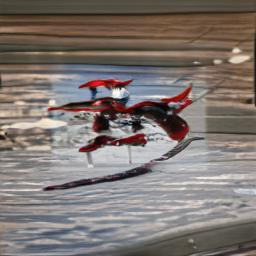

......................................................................
493.jpg


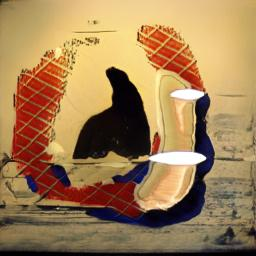

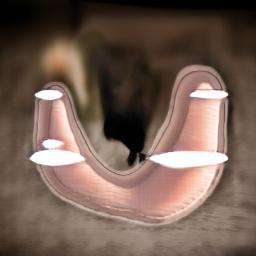

......................................................................
327.jpg


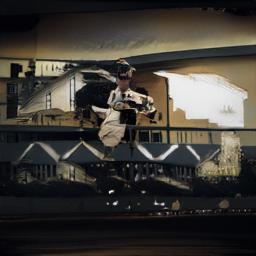

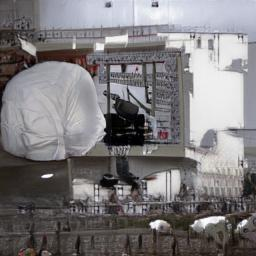

......................................................................
98.jpg


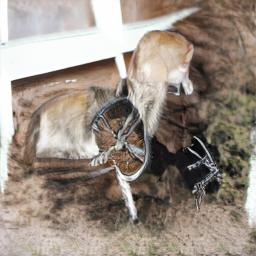

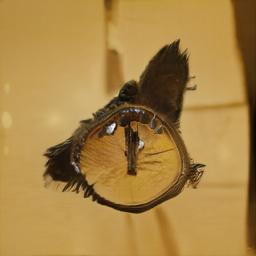

......................................................................
25.jpg


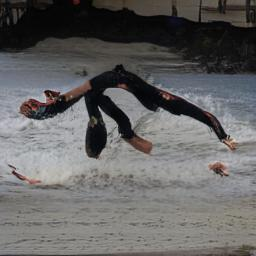

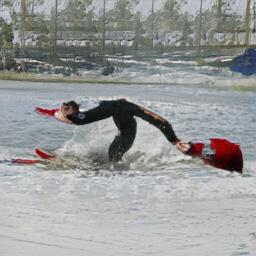

......................................................................
1762.jpg


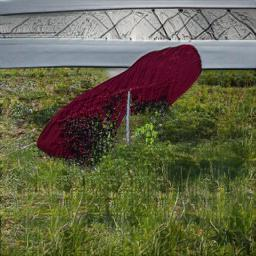

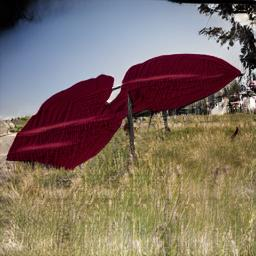

......................................................................
1847.jpg


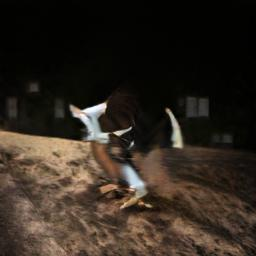

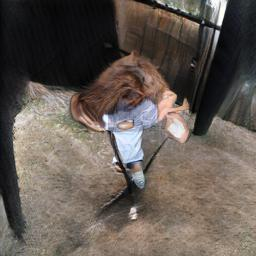

......................................................................
2044.jpg


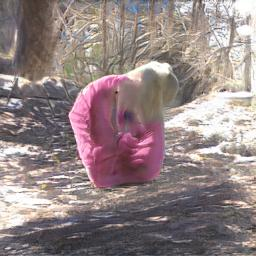

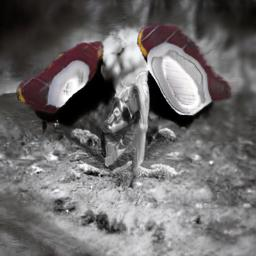

......................................................................
1793.jpg


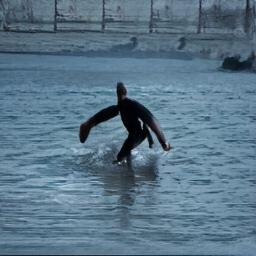

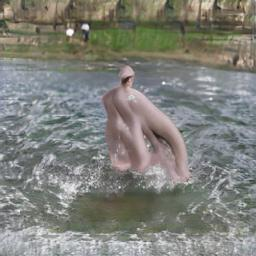

......................................................................
1267.jpg


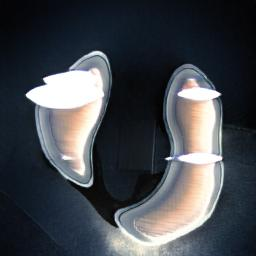

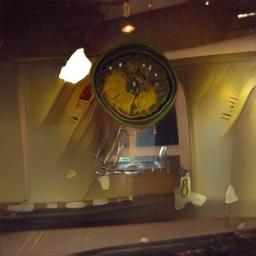

......................................................................
1173.jpg


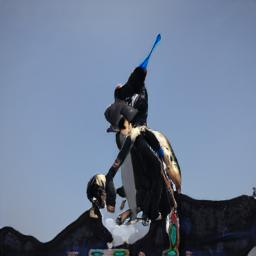

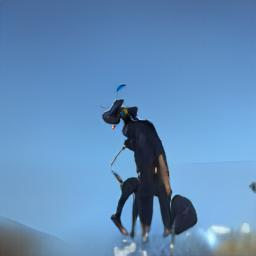

......................................................................
1830.jpg


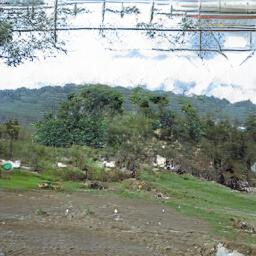

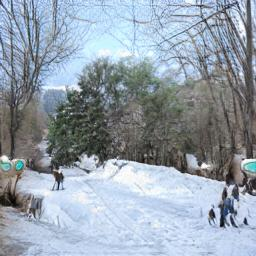

......................................................................
566.jpg


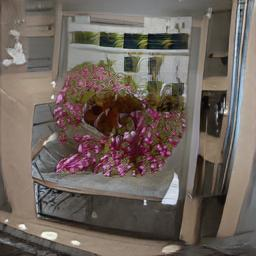

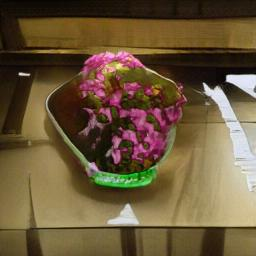

......................................................................
1816.jpg


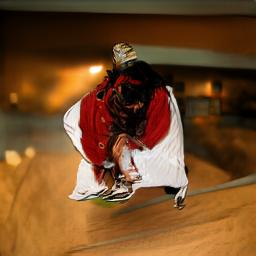

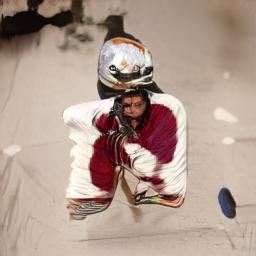

......................................................................
72.jpg


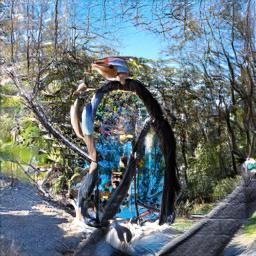

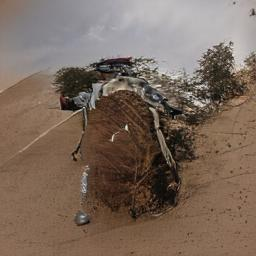

......................................................................
1535.jpg


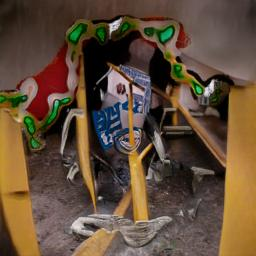

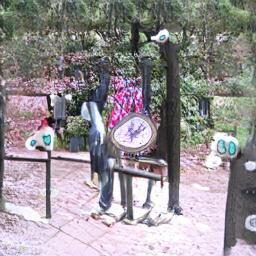

......................................................................
1742.jpg


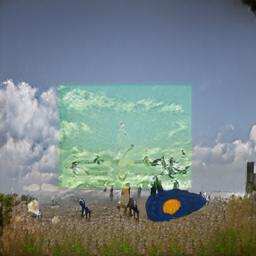

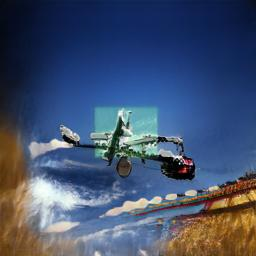

......................................................................
3593.jpg


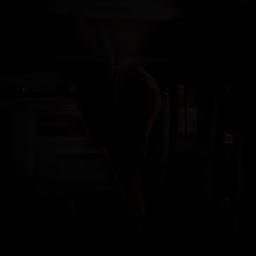

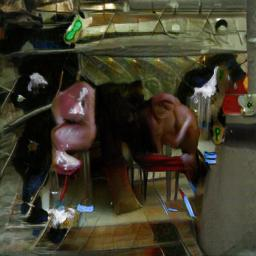

......................................................................
73.jpg


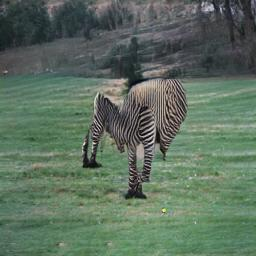

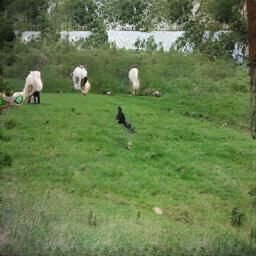

......................................................................
2532.jpg


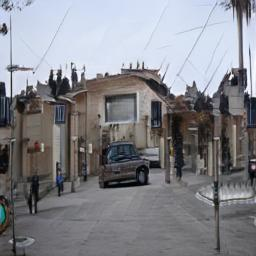

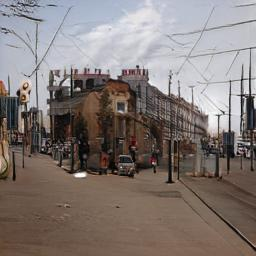

......................................................................
1738.jpg


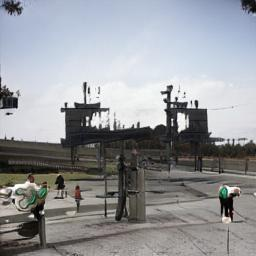

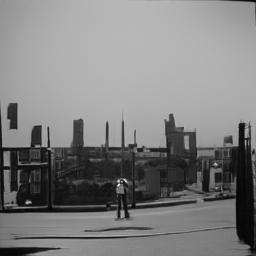

......................................................................
2715.jpg


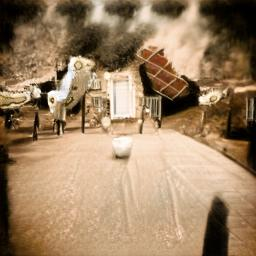

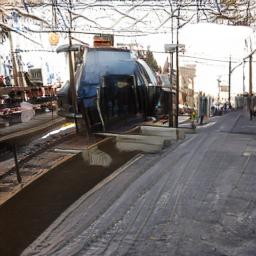

......................................................................
412.jpg


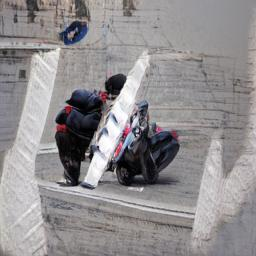

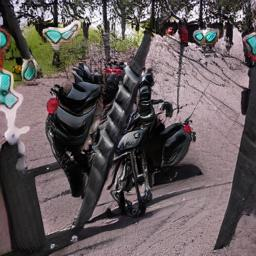

......................................................................
1954.jpg


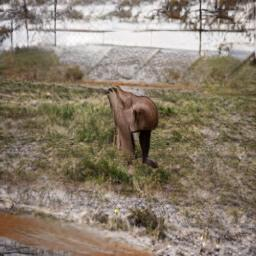

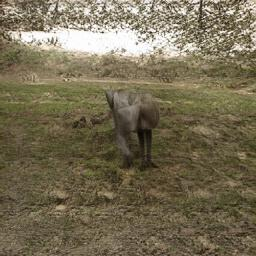

......................................................................
408.jpg


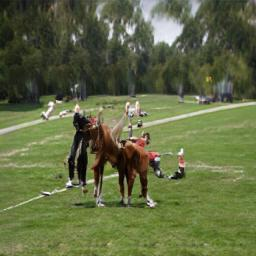

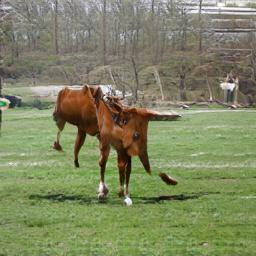

......................................................................
862.jpg


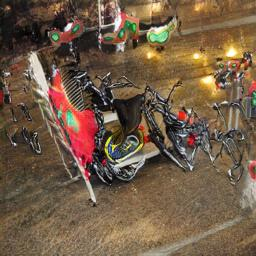

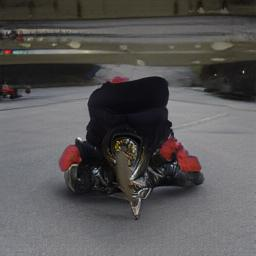

......................................................................
872.jpg


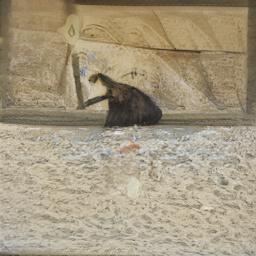

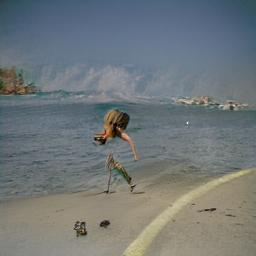

......................................................................
617.jpg


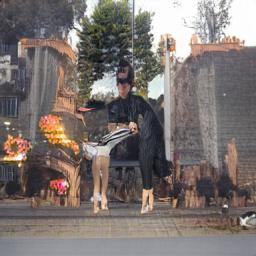

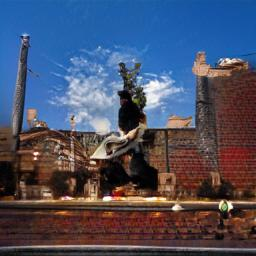

......................................................................
988.jpg


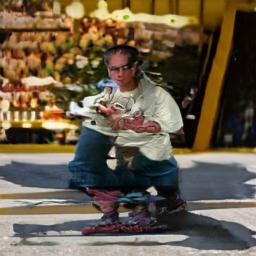

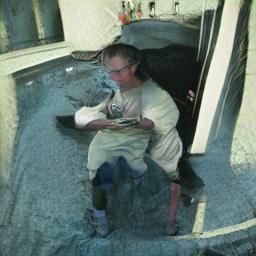

......................................................................
2064.jpg


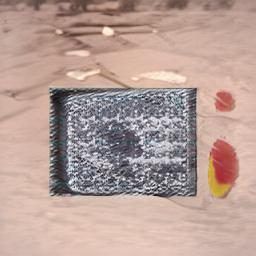

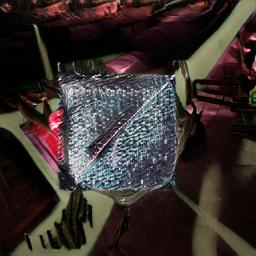

......................................................................
1225.jpg


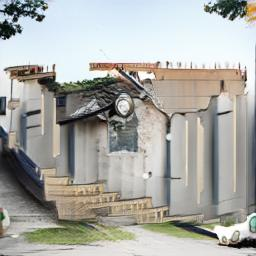

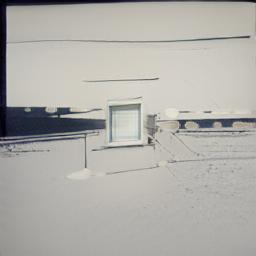

......................................................................
1994.jpg


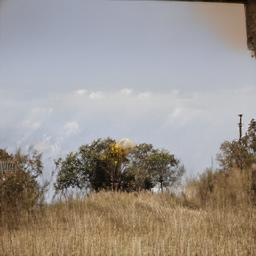

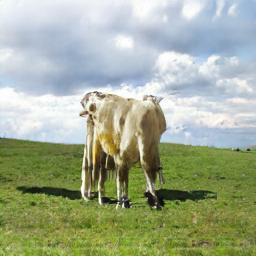

......................................................................
794.jpg


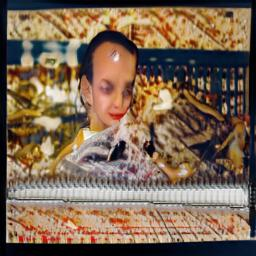

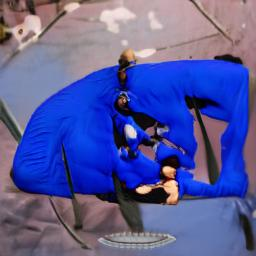

......................................................................
240.jpg


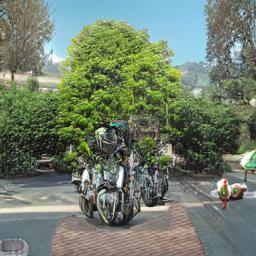

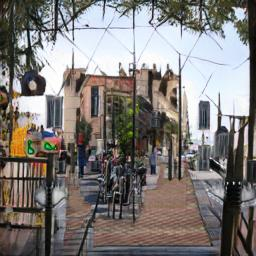

......................................................................
2349.jpg


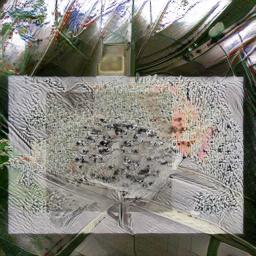

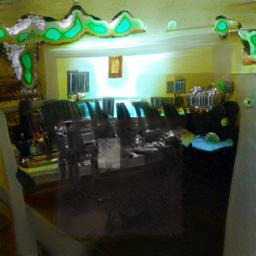

......................................................................
1682.jpg


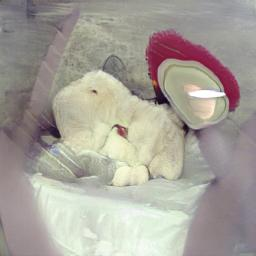

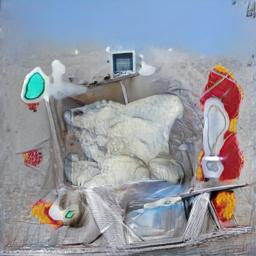

......................................................................
1888.jpg


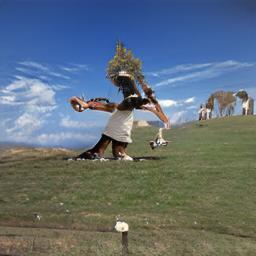

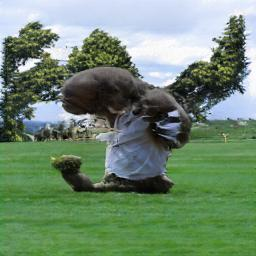

......................................................................
3437.jpg


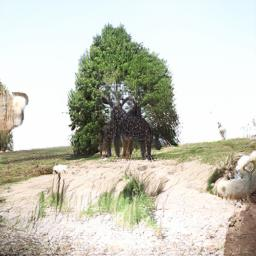

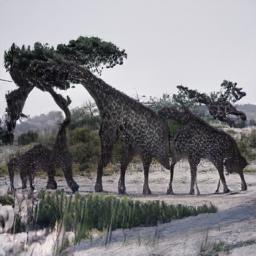

......................................................................
2777.jpg


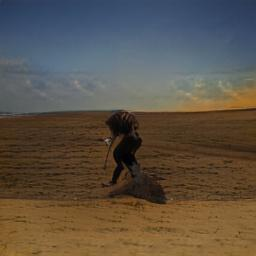

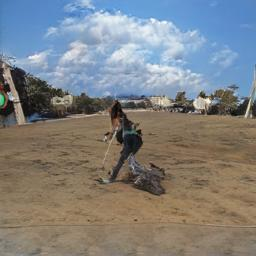

......................................................................
1274.jpg


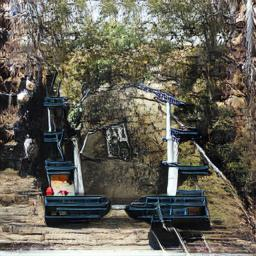

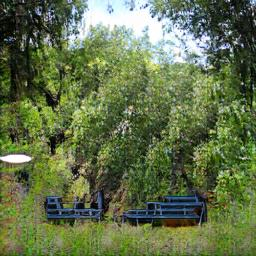

......................................................................
3311.jpg


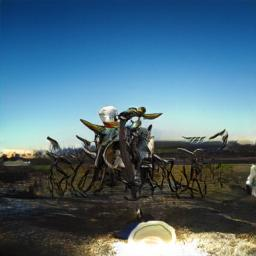

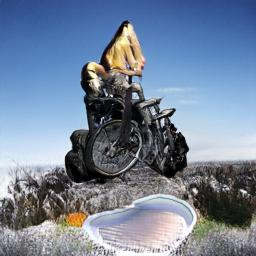

......................................................................
1655.jpg


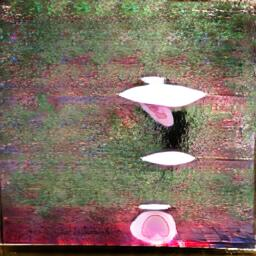

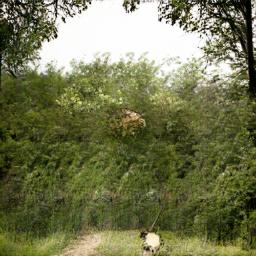

......................................................................
1629.jpg


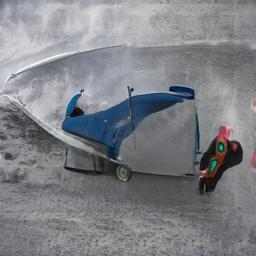

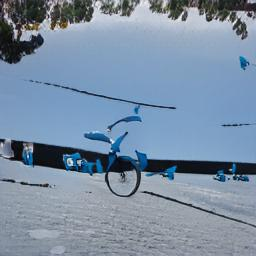

......................................................................
3120.jpg


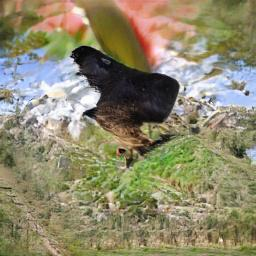

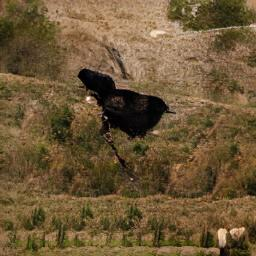

......................................................................
2517.jpg


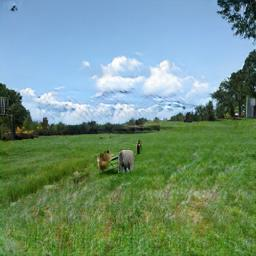

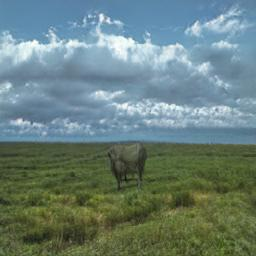

......................................................................
2220.jpg


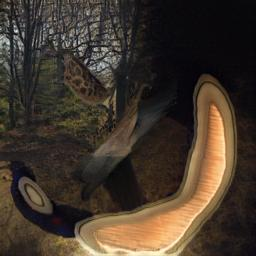

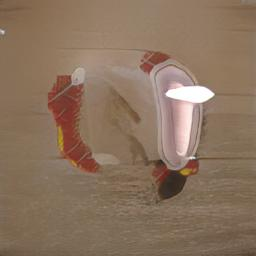

......................................................................
885.jpg


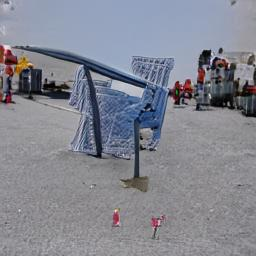

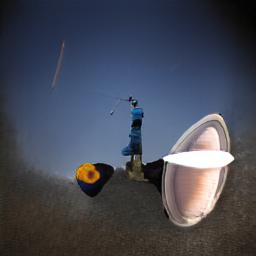

......................................................................
3031.jpg


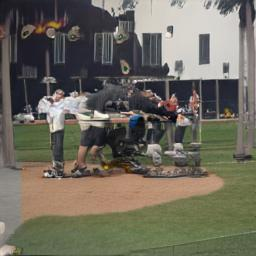

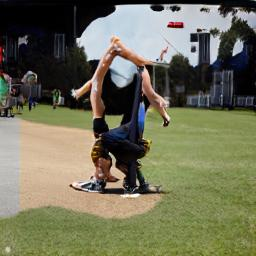

......................................................................
2061.jpg


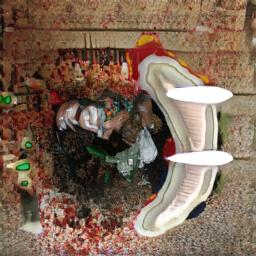

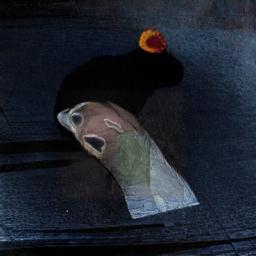

......................................................................
2675.jpg


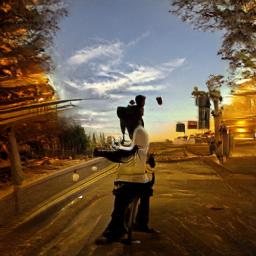

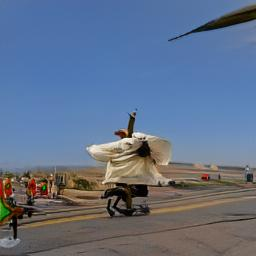

......................................................................
1071.jpg


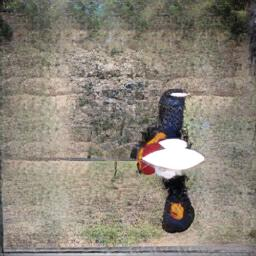

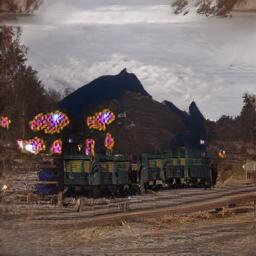

......................................................................
1135.jpg


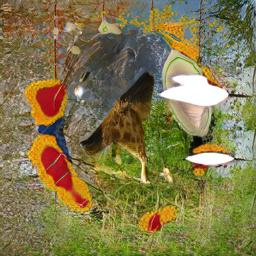

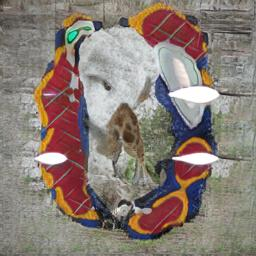

......................................................................
1149.jpg


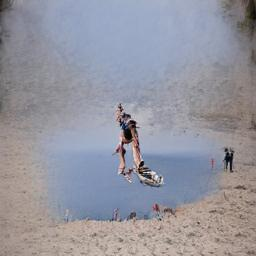

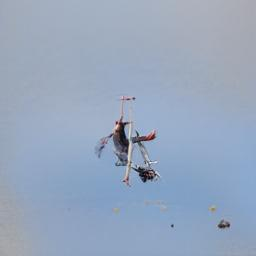

......................................................................
567.jpg


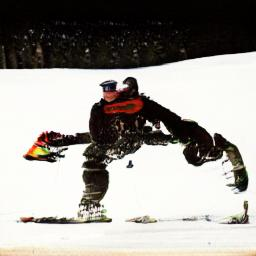

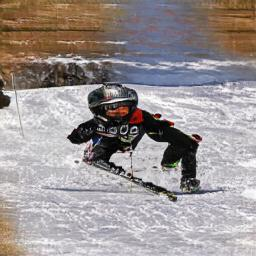

......................................................................
2056.jpg


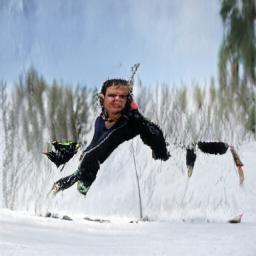

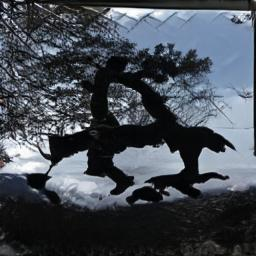

......................................................................
91.jpg


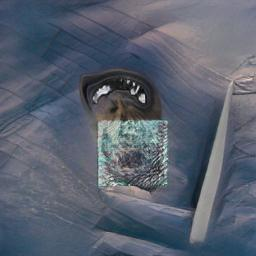

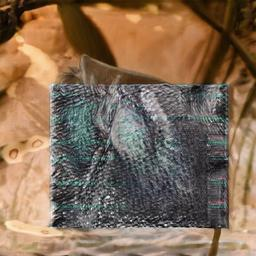

......................................................................
1944.jpg


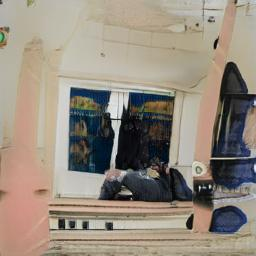

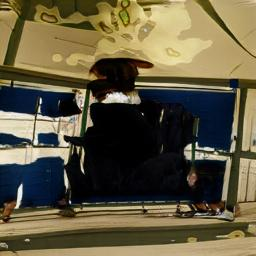

......................................................................
1734.jpg


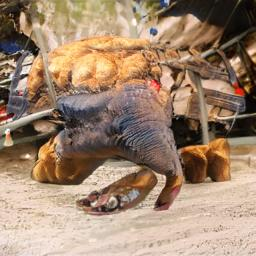

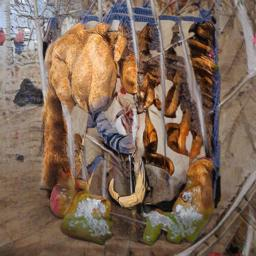

......................................................................
3284.jpg


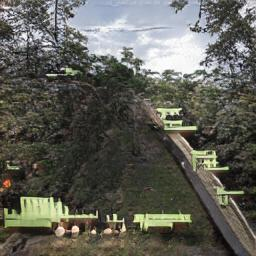

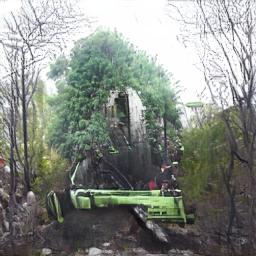

......................................................................
782.jpg


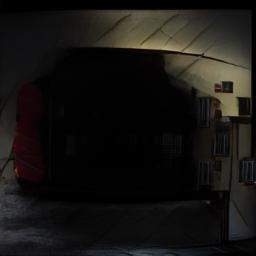

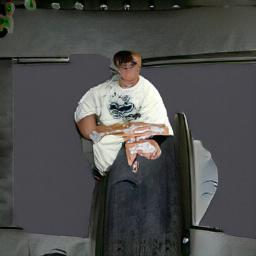

......................................................................
1160.jpg


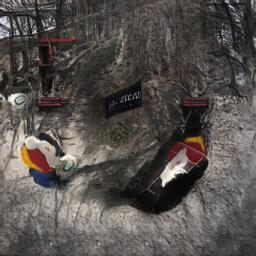

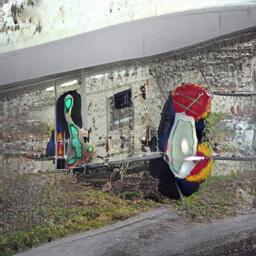

......................................................................
837.jpg


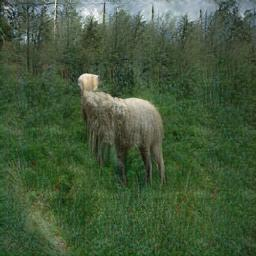

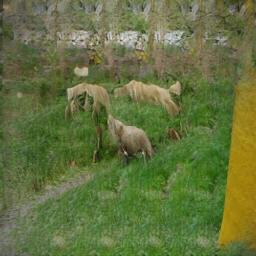

......................................................................
3231.jpg


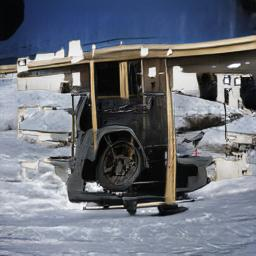

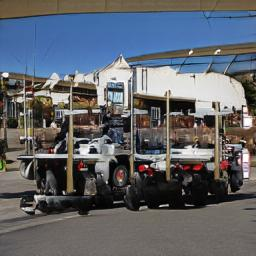

......................................................................
3247.jpg


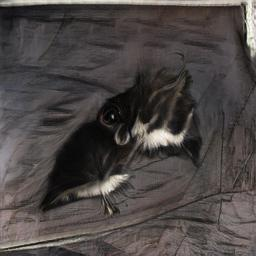

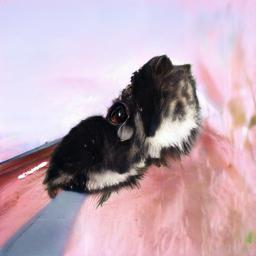

......................................................................
2913.jpg


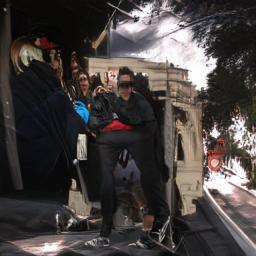

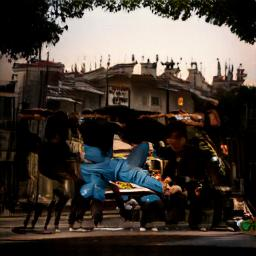

......................................................................
2872.jpg


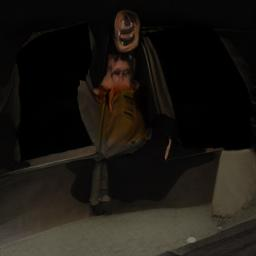

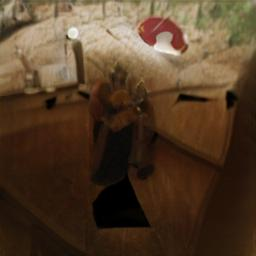

......................................................................
1354.jpg


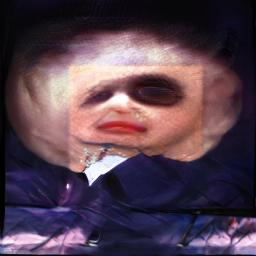

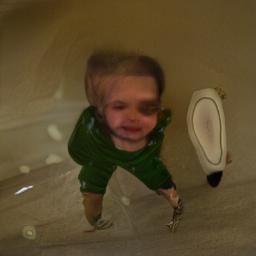

......................................................................
2689.jpg


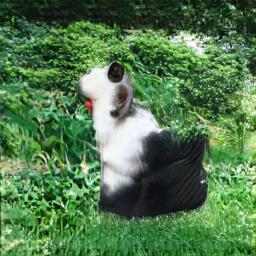

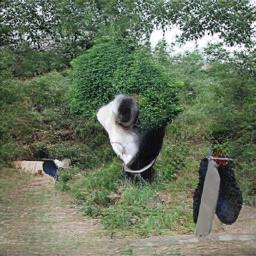

......................................................................
2018.jpg


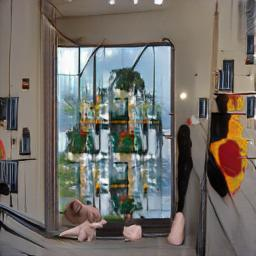

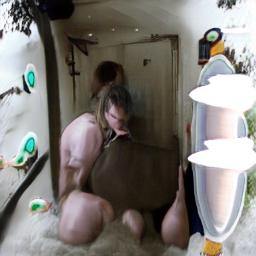

......................................................................
1603.jpg


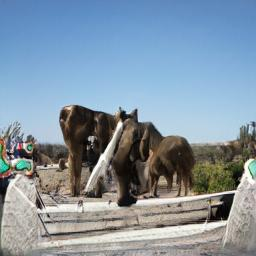

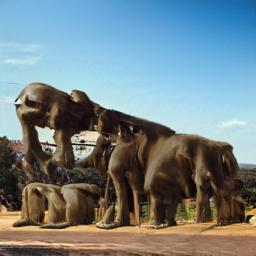

......................................................................
2533.jpg


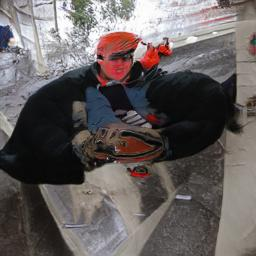

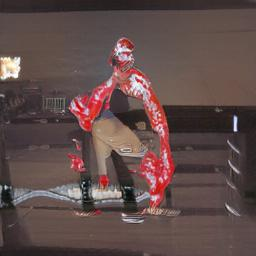

......................................................................
2867.jpg


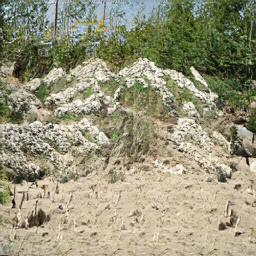

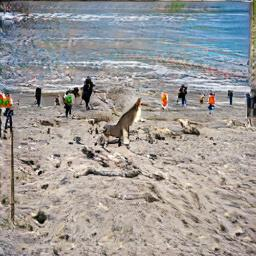

......................................................................
316.jpg


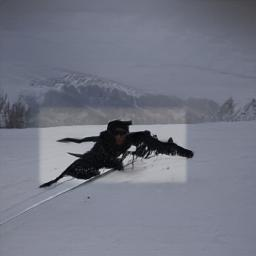

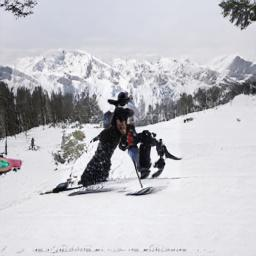

......................................................................
2579.jpg


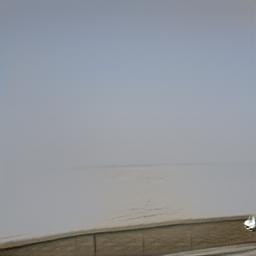

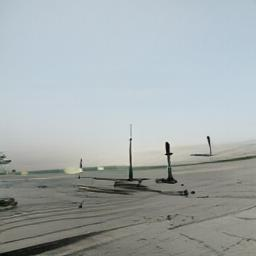

......................................................................
3259.jpg


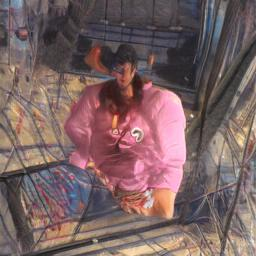

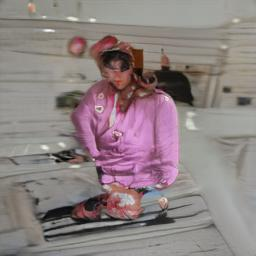

......................................................................
2043.jpg


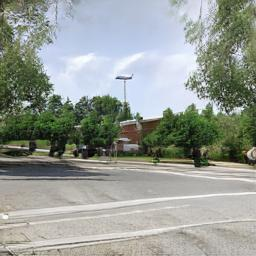

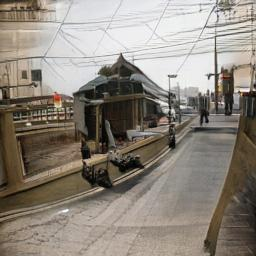

......................................................................
1226.jpg


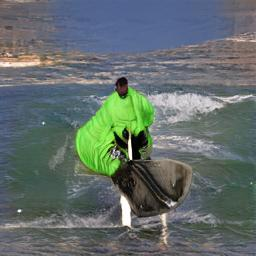

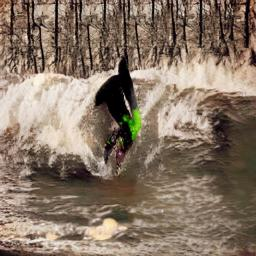

......................................................................
1707.jpg


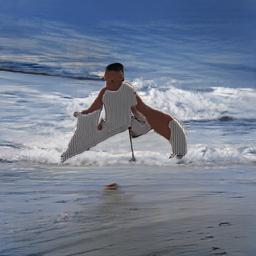

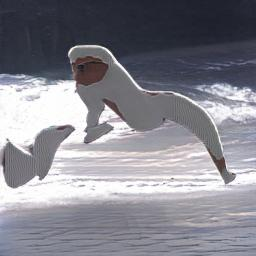

......................................................................
374.jpg


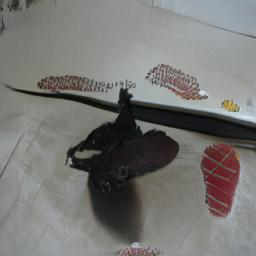

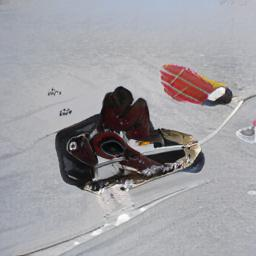

......................................................................
1028.jpg


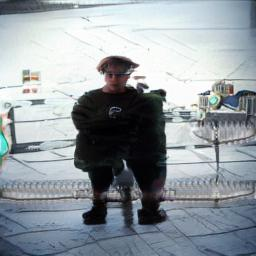

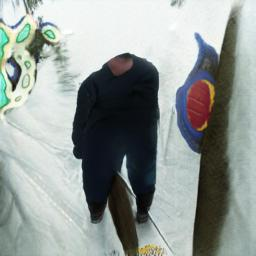

......................................................................
1963.jpg


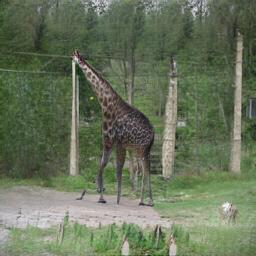

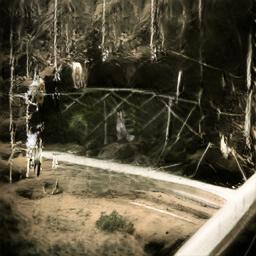

......................................................................
2736.jpg


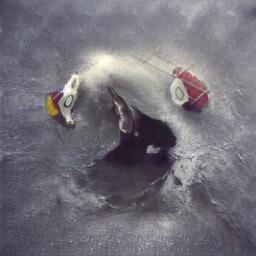

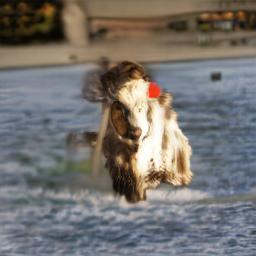

......................................................................
504.jpg


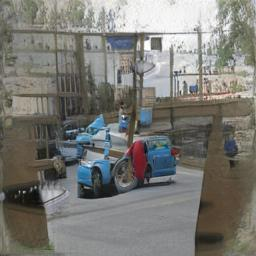

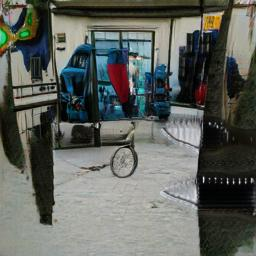

......................................................................
515.jpg


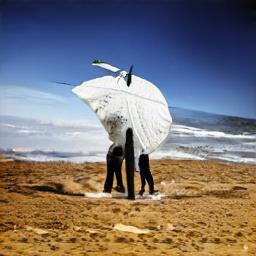

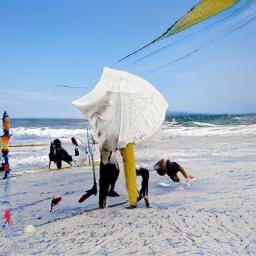

......................................................................
2695.jpg


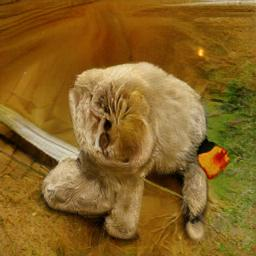

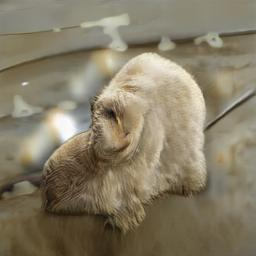

......................................................................
1299.jpg


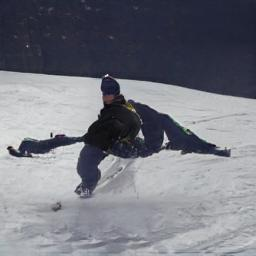

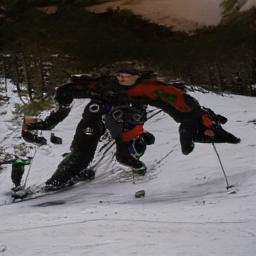

......................................................................
51.jpg


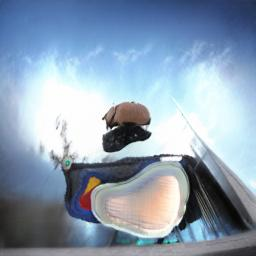

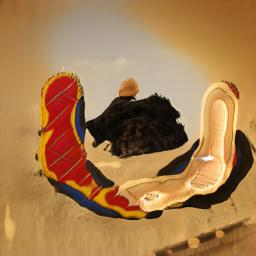

......................................................................
3017.jpg


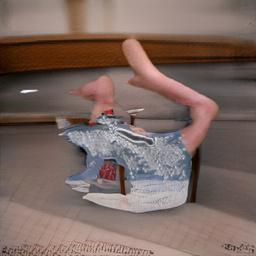

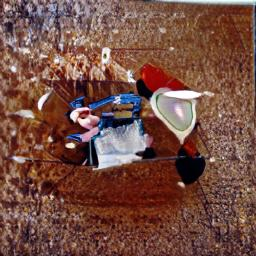

......................................................................
2750.jpg


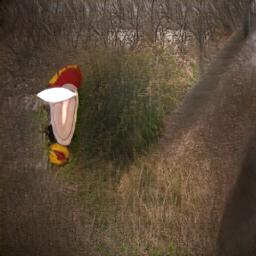

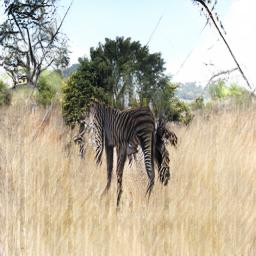

......................................................................
2658.jpg


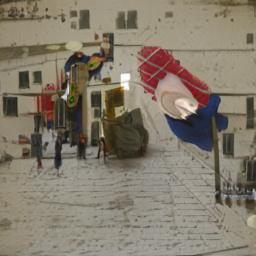

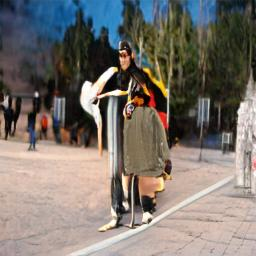

......................................................................
1612.jpg


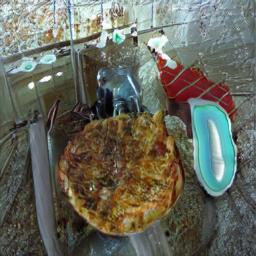

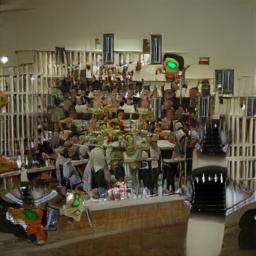

......................................................................
52.jpg


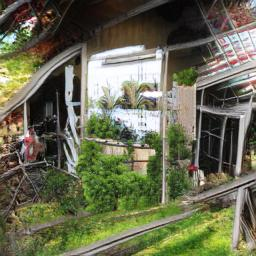

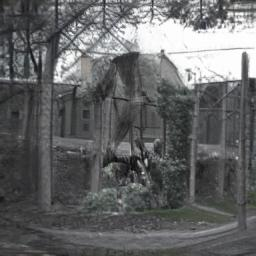

......................................................................
2412.jpg


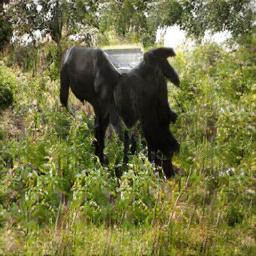

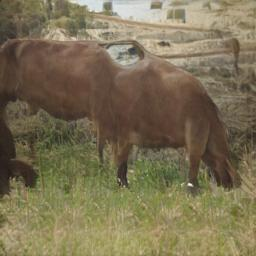

......................................................................
2783.jpg


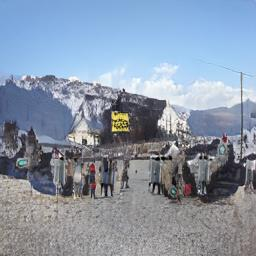

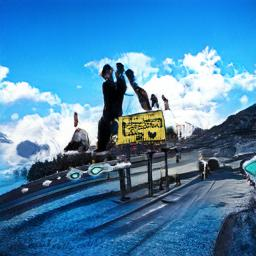

......................................................................
2081.jpg


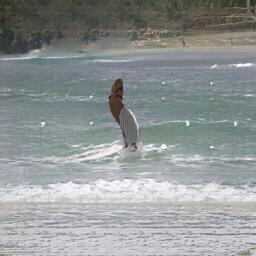

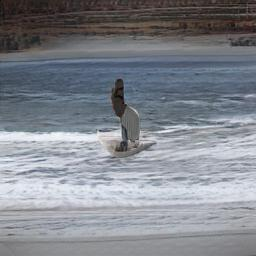

......................................................................
517.jpg


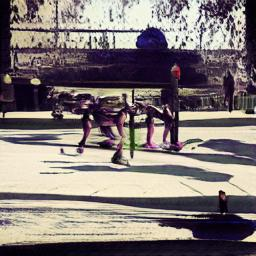

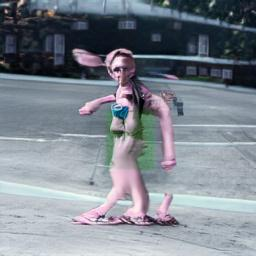

......................................................................
3485.jpg


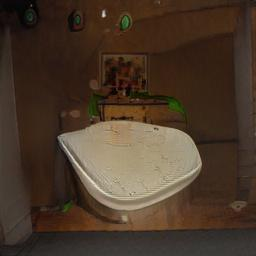

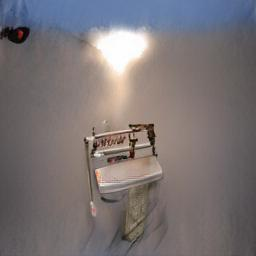

......................................................................
1217.jpg


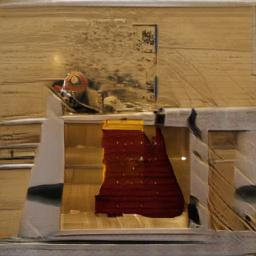

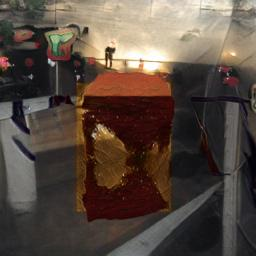

......................................................................
2322.jpg


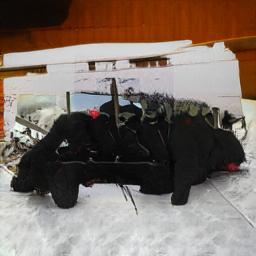

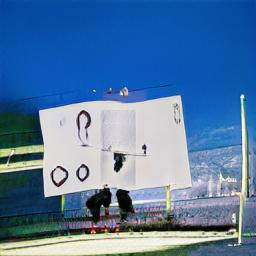

......................................................................
992.jpg


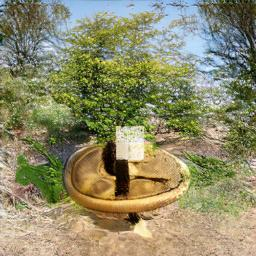

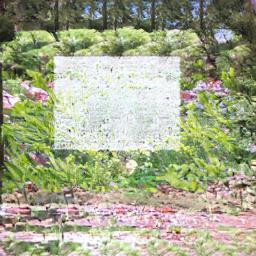

......................................................................
3297.jpg


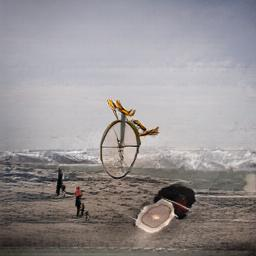

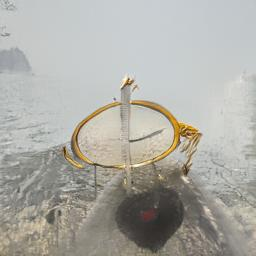

......................................................................
972.jpg


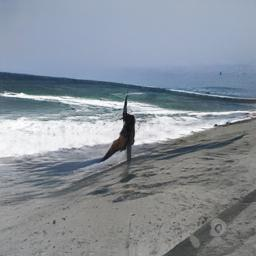

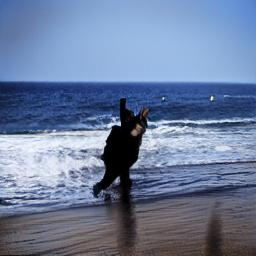

......................................................................
3313.jpg


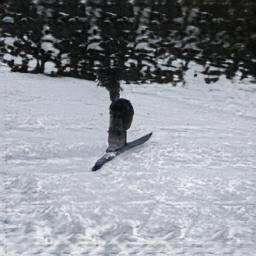

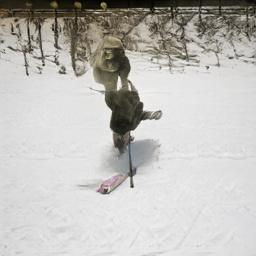

......................................................................
203.jpg


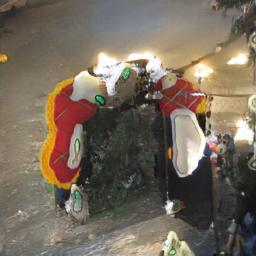

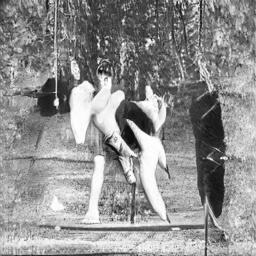

......................................................................
524.jpg


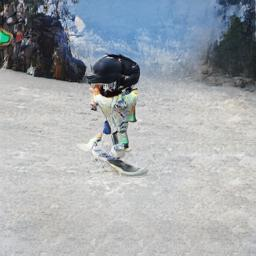

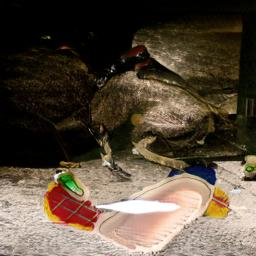

......................................................................
2059.jpg


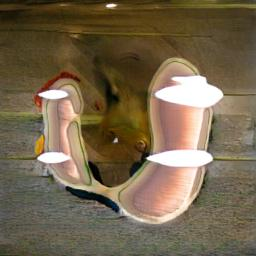

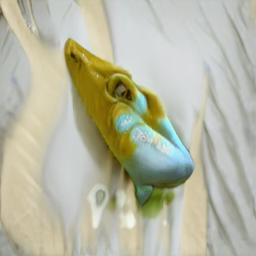

......................................................................
127.jpg


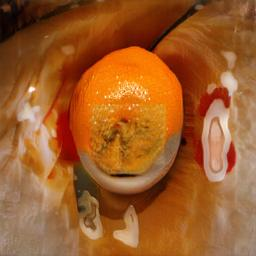

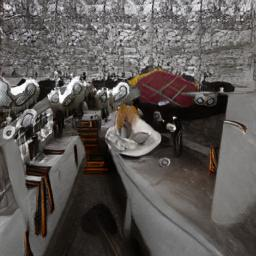

......................................................................
1431.jpg


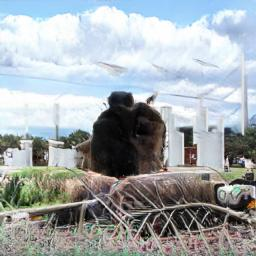

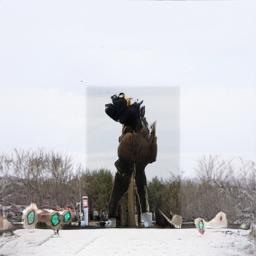

......................................................................
469.jpg


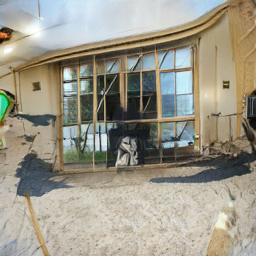

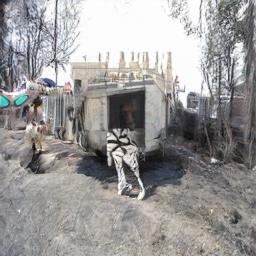

......................................................................
715.jpg


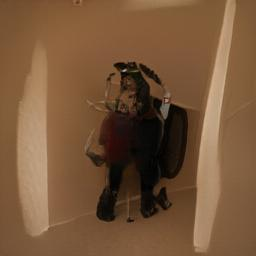

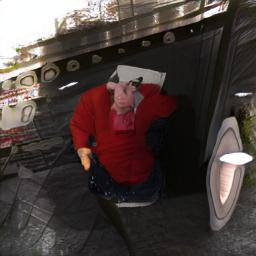

......................................................................
2685.jpg


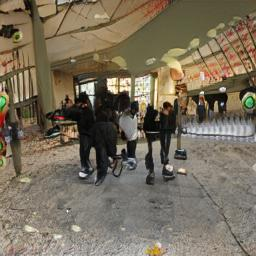

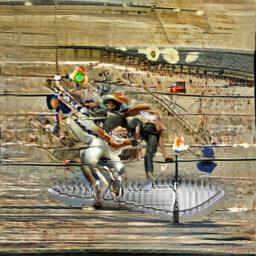

......................................................................
103.jpg


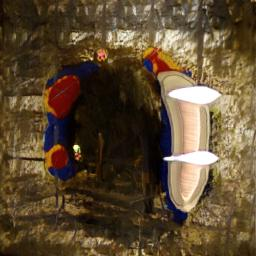

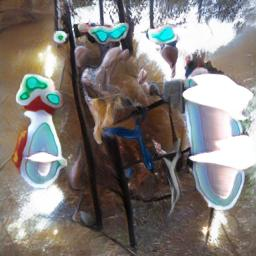

......................................................................
582.jpg


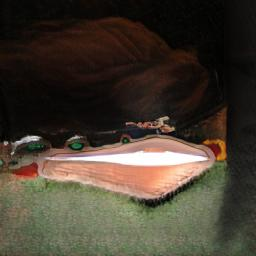

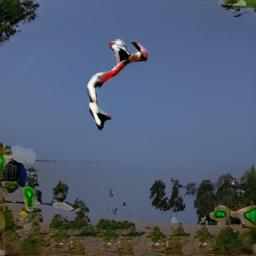

......................................................................
1128.jpg


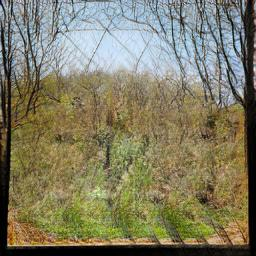

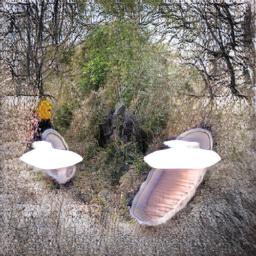

......................................................................
2140.jpg


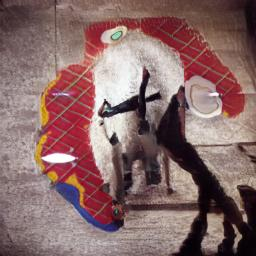

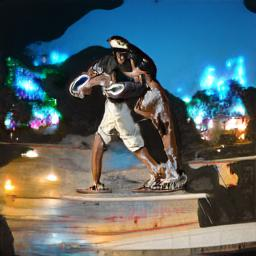

......................................................................
2189.jpg


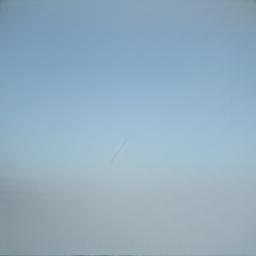

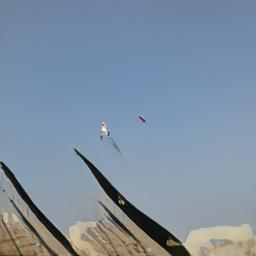

......................................................................
1417.jpg


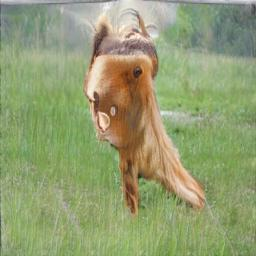

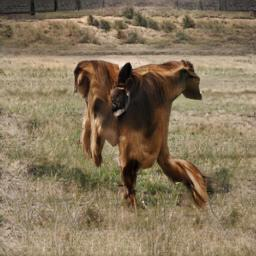

......................................................................
2020.jpg


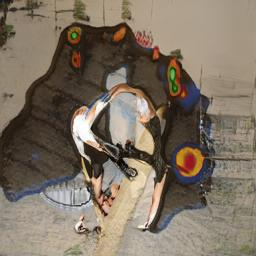

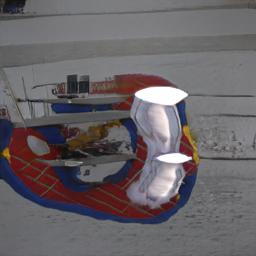

......................................................................
2656.jpg


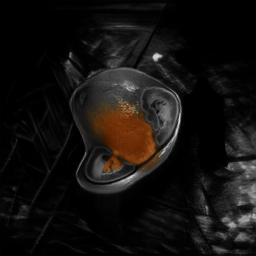

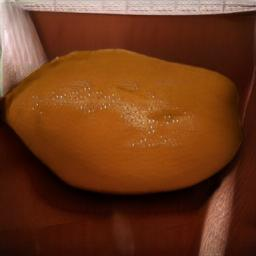

......................................................................
2949.jpg


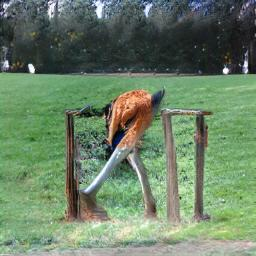

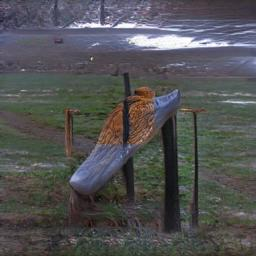

......................................................................
2439.jpg


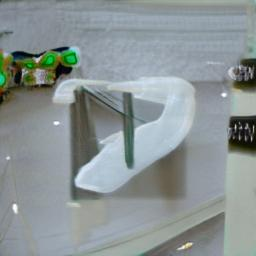

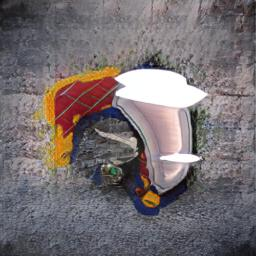

......................................................................
156.jpg


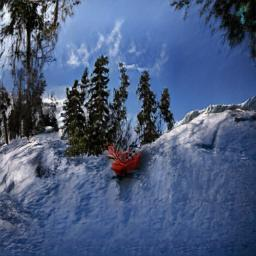

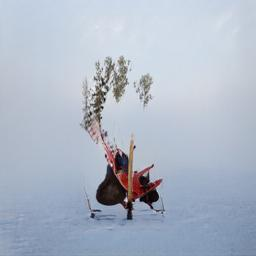

......................................................................
1927.jpg


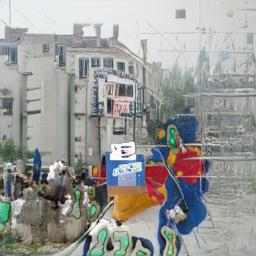

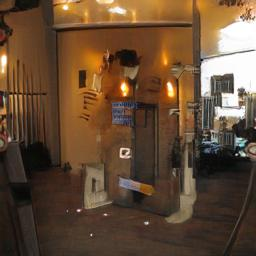

......................................................................
1614.jpg


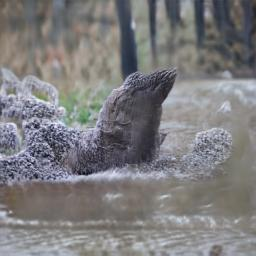

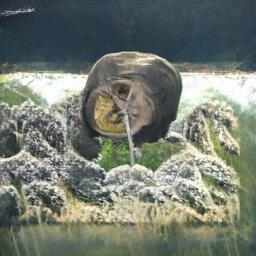

......................................................................
1755.jpg


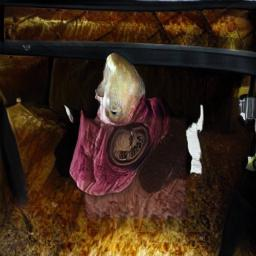

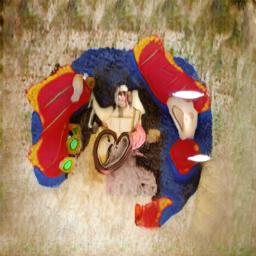

......................................................................
791.jpg


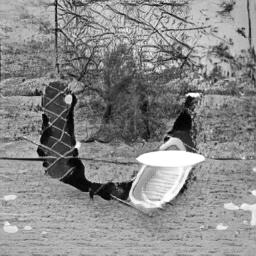

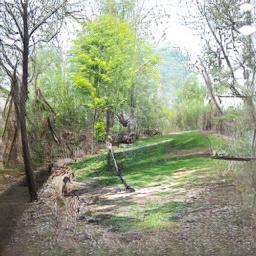

......................................................................
1822.jpg


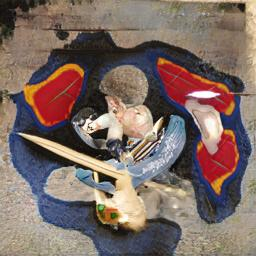

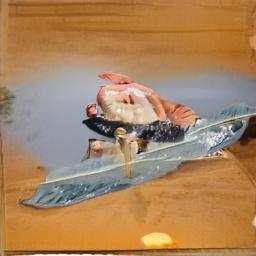

......................................................................
1454.jpg


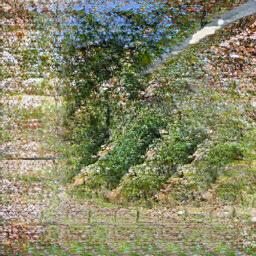

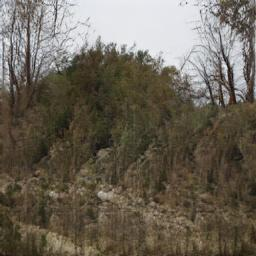

......................................................................
2800.jpg


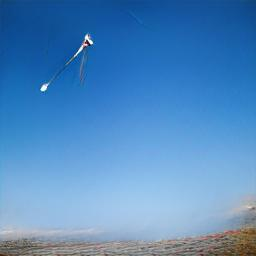

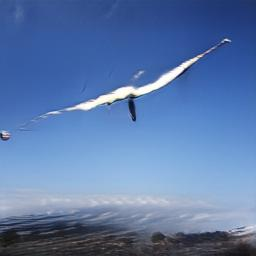

......................................................................
689.jpg


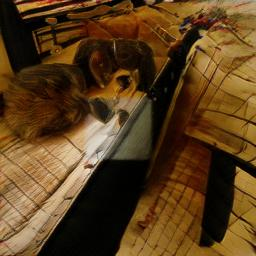

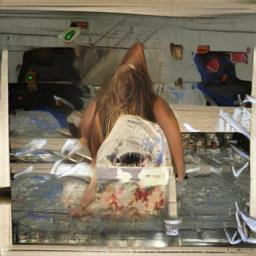

......................................................................
2165.jpg


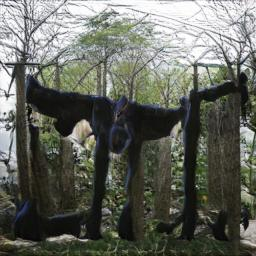

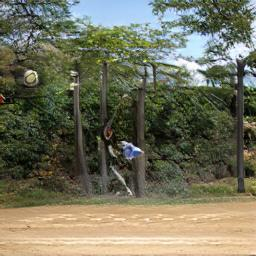

......................................................................
1913.jpg


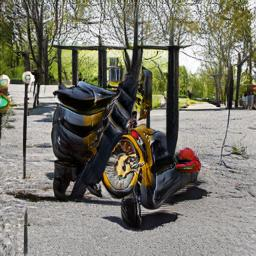

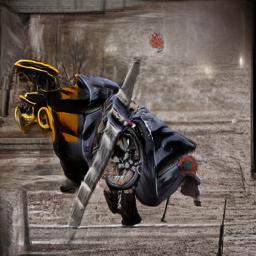

......................................................................
699.jpg


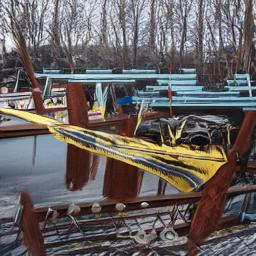

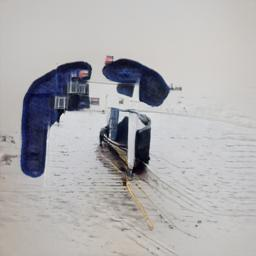

......................................................................
360.jpg


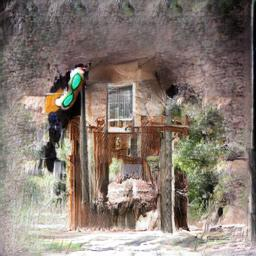

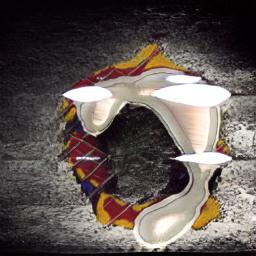

......................................................................
2668.jpg


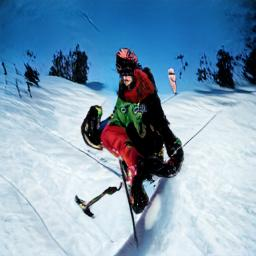

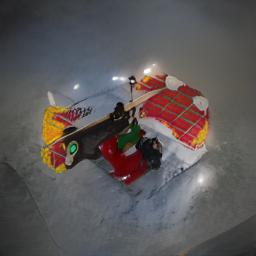

......................................................................
2089.jpg


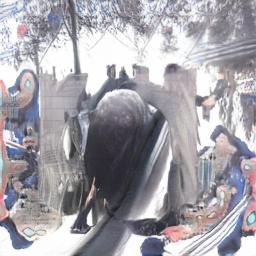

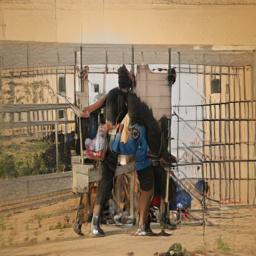

......................................................................
2302.jpg


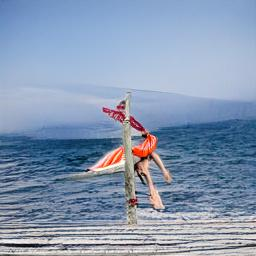

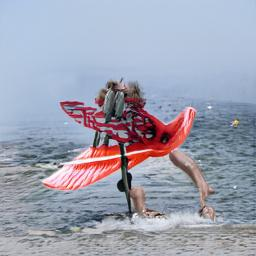

......................................................................
2500.jpg


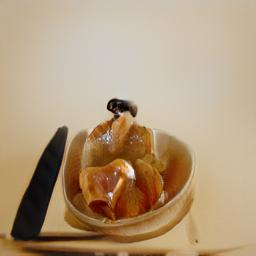

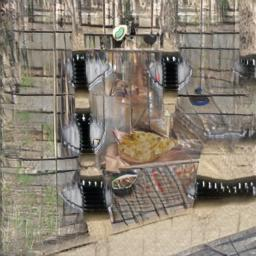

......................................................................
634.jpg


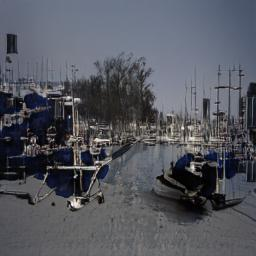

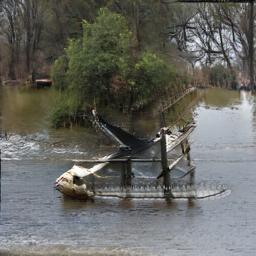

......................................................................
922.jpg


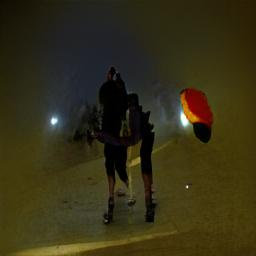

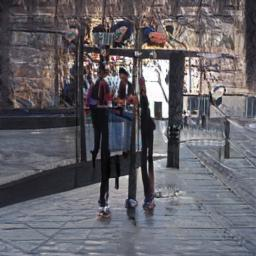

......................................................................
1189.jpg


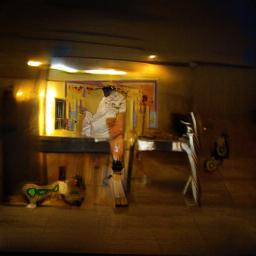

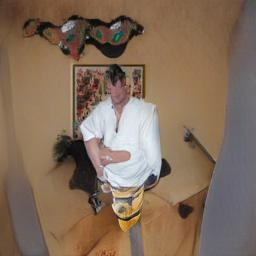

......................................................................
1403.jpg


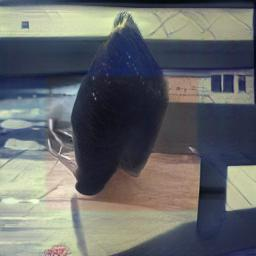

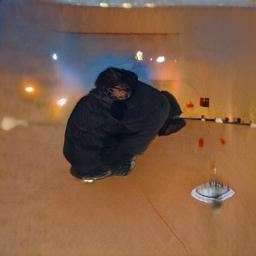

......................................................................
2745.jpg


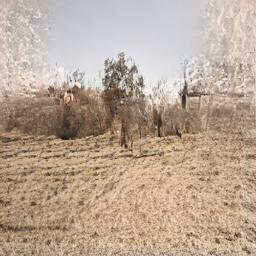

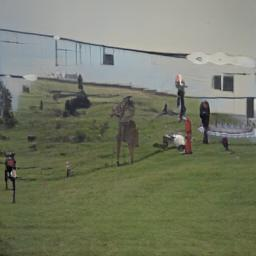

......................................................................
2692.jpg


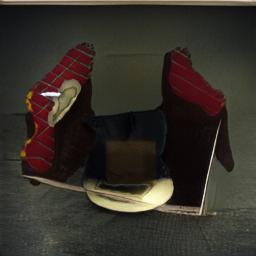

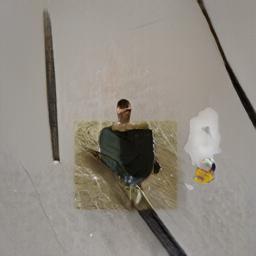

......................................................................
2984.jpg


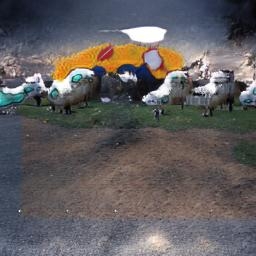

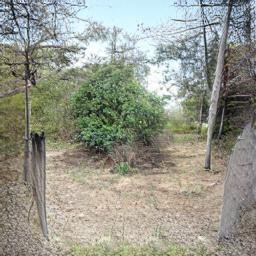

......................................................................
242.jpg


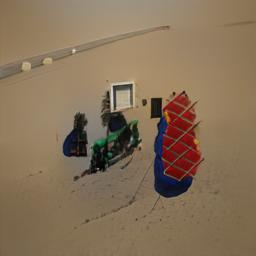

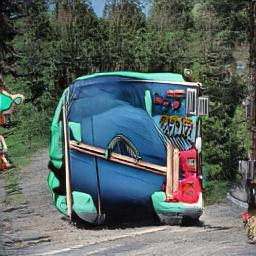

......................................................................
1279.jpg


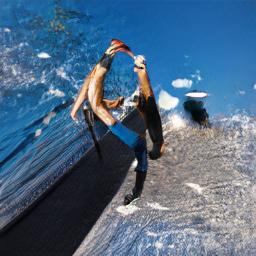

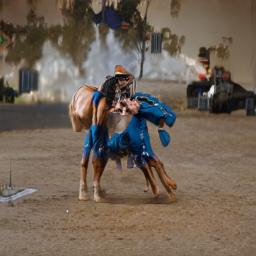

......................................................................
2613.jpg


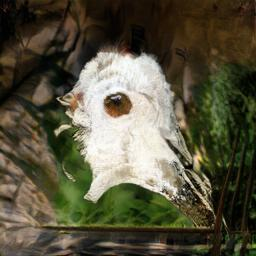

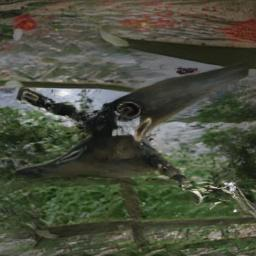

......................................................................
439.jpg


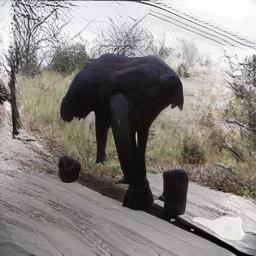

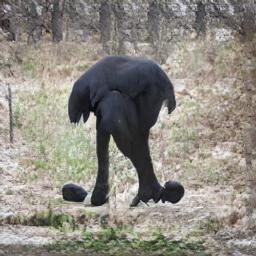

......................................................................
3540.jpg


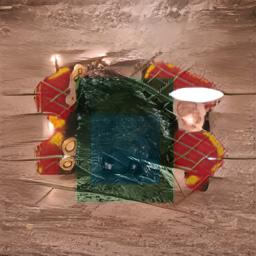

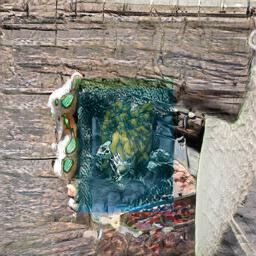

......................................................................
396.jpg


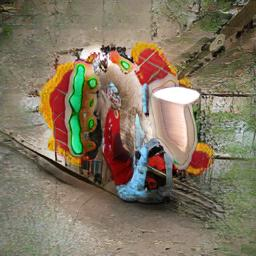

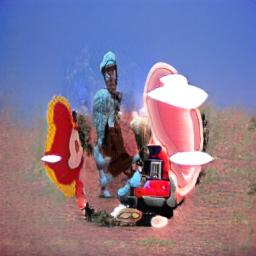

......................................................................
801.jpg


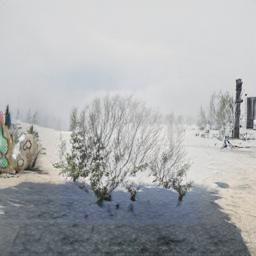

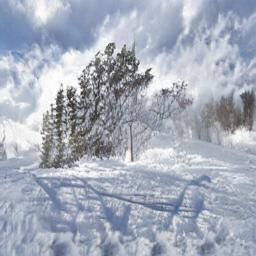

......................................................................
1972.jpg


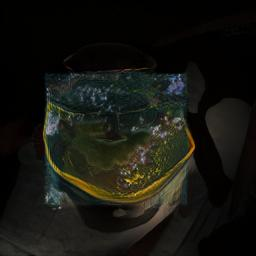

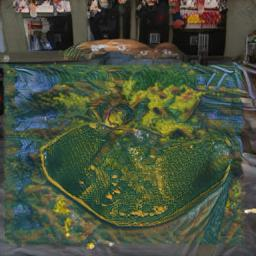

......................................................................
328.jpg


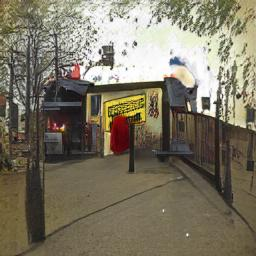

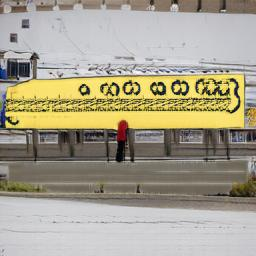

......................................................................
771.jpg


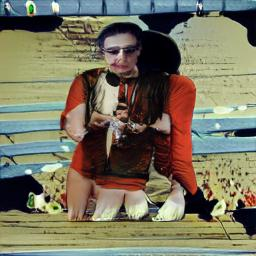

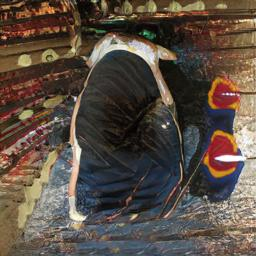

......................................................................
1722.jpg


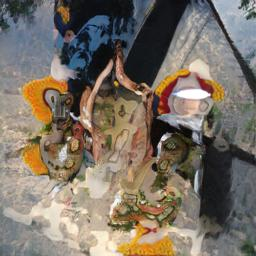

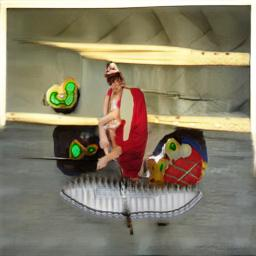

......................................................................
688.jpg


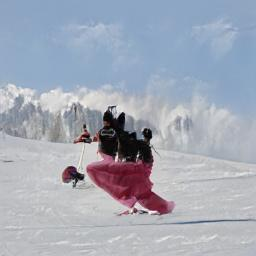

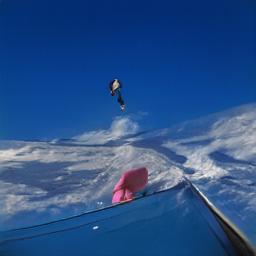

......................................................................
1772.jpg


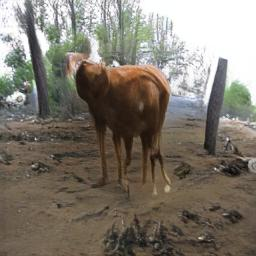

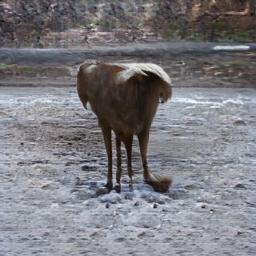

......................................................................
1340.jpg


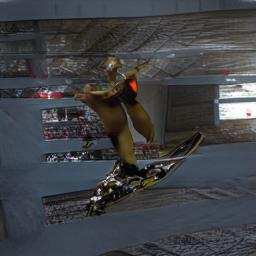

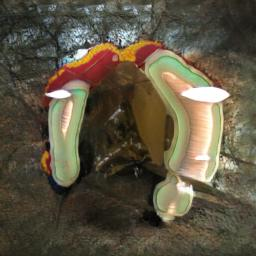

......................................................................
2385.jpg


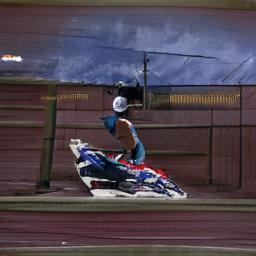

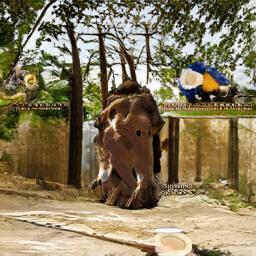

......................................................................
1941.jpg


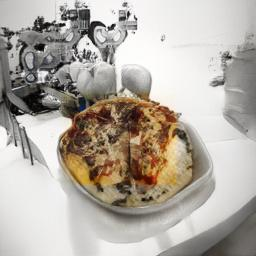

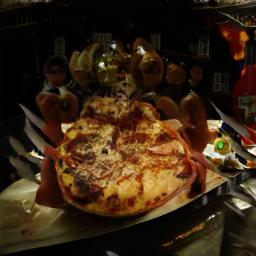

......................................................................
2095.jpg


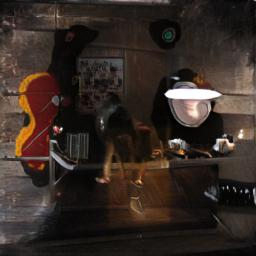

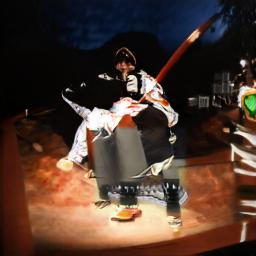

......................................................................
1585.jpg


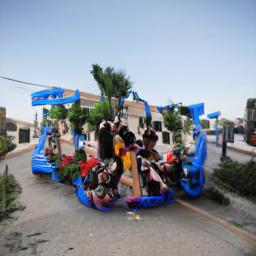

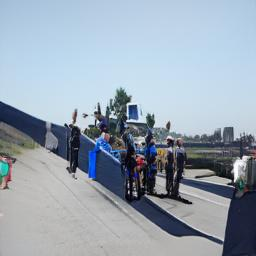

......................................................................
871.jpg


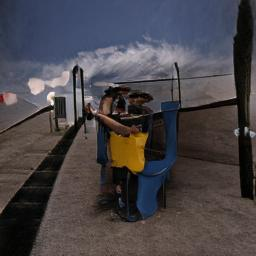

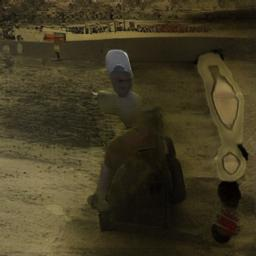

......................................................................
2408.jpg


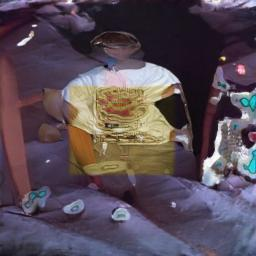

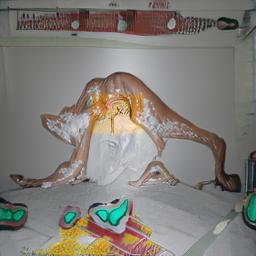

......................................................................
1919.jpg


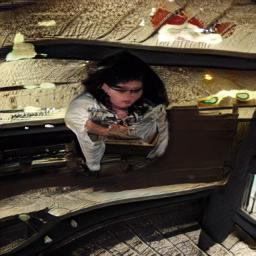

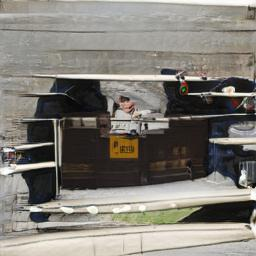

......................................................................
1500.jpg


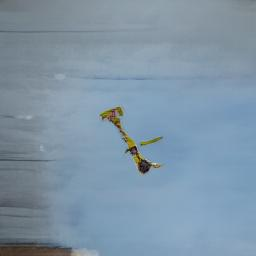

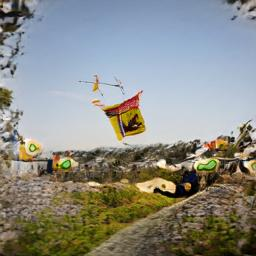

......................................................................
1801.jpg


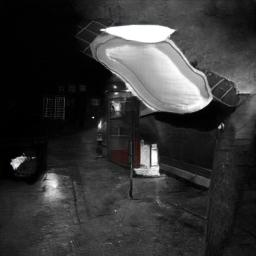

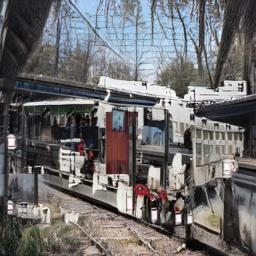

......................................................................
1819.jpg


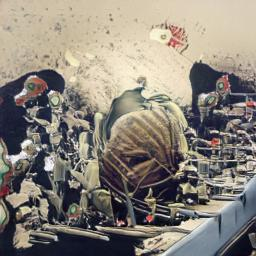

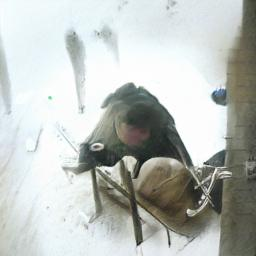

......................................................................
1039.jpg


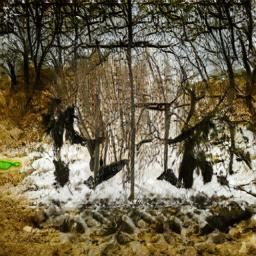

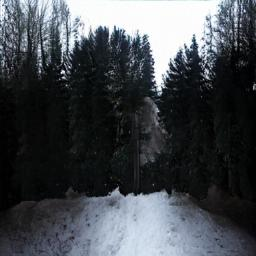

......................................................................
74.jpg


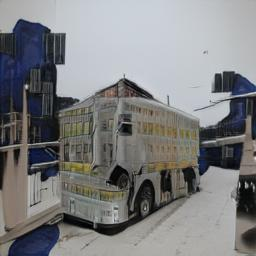

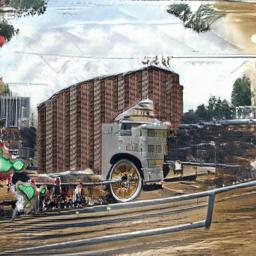

......................................................................
1992.jpg


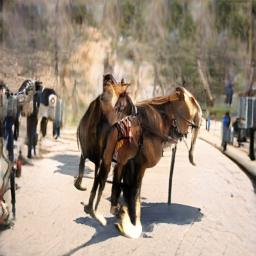

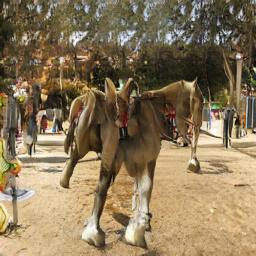

......................................................................
2191.jpg


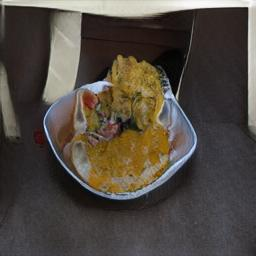

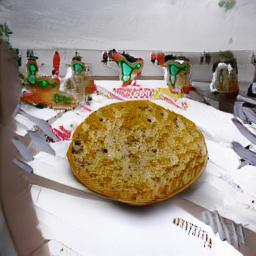

......................................................................
3175.jpg


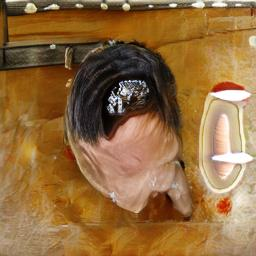

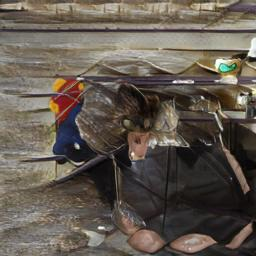

......................................................................
616.jpg


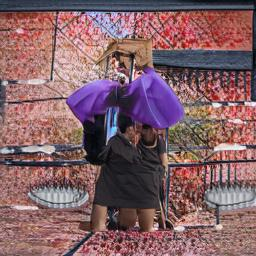

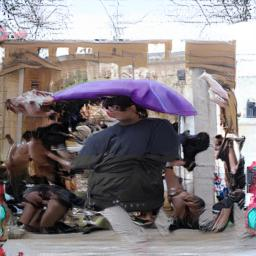

......................................................................
2922.jpg


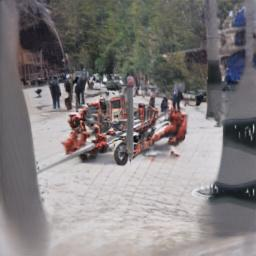

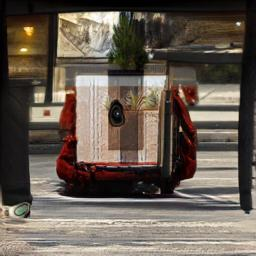

......................................................................
3493.jpg


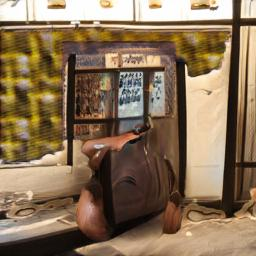

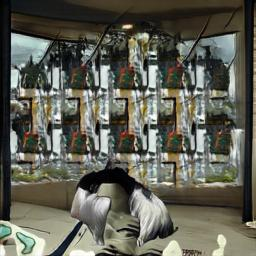

......................................................................
3380.jpg


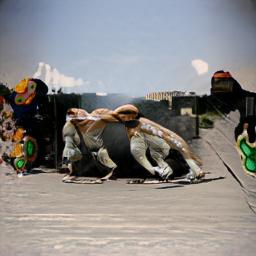

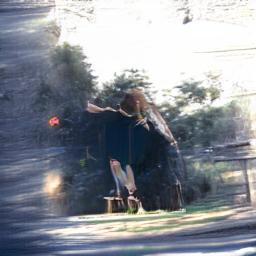

......................................................................
2459.jpg


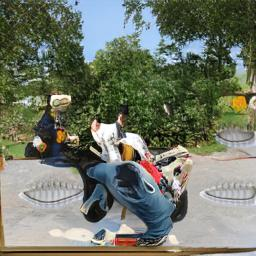

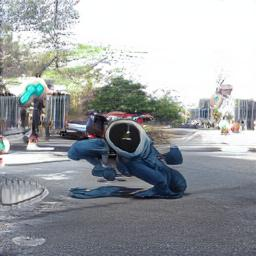

......................................................................
2509.jpg


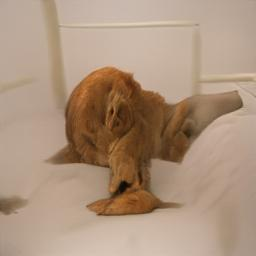

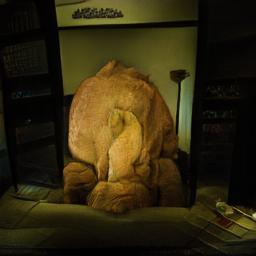

......................................................................
1025.jpg


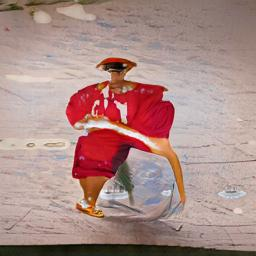

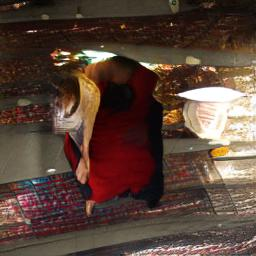

......................................................................
2154.jpg


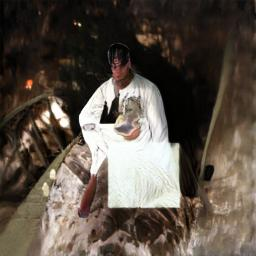

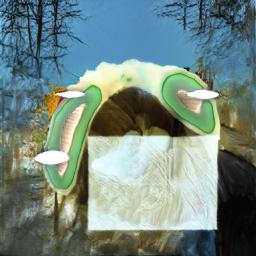

......................................................................
1425.jpg


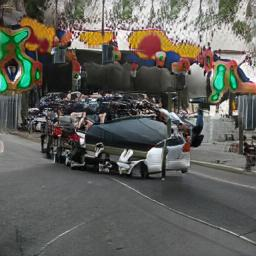

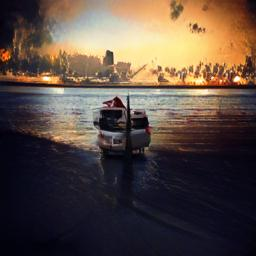

......................................................................
34.jpg


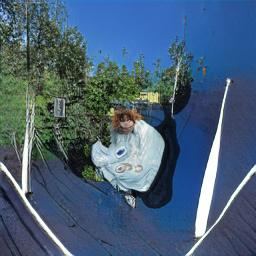

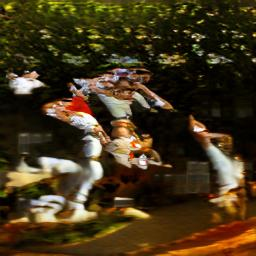

......................................................................
707.jpg


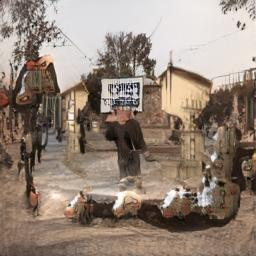

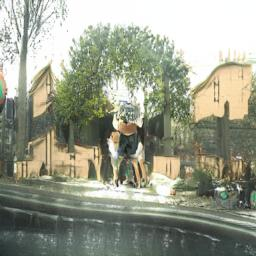

......................................................................
1031.jpg


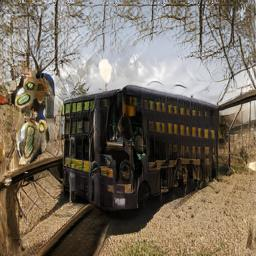

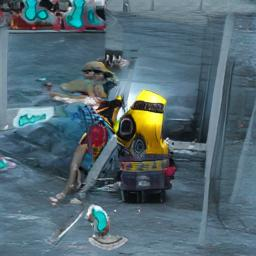

......................................................................
964.jpg


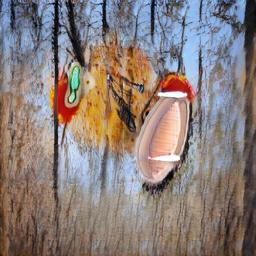

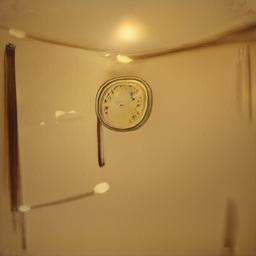

......................................................................
3546.jpg


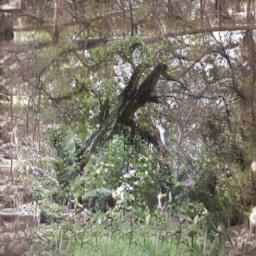

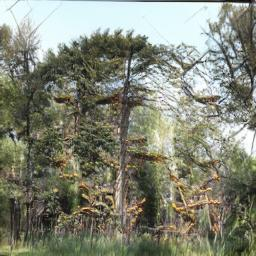

......................................................................
473.jpg


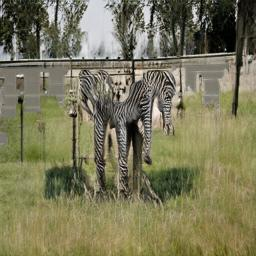

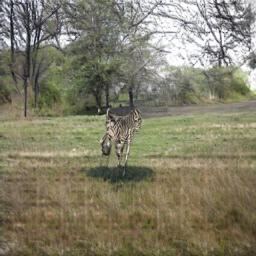

......................................................................
3244.jpg


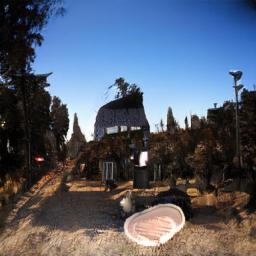

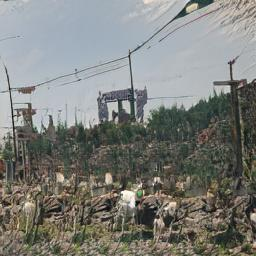

......................................................................
1874.jpg


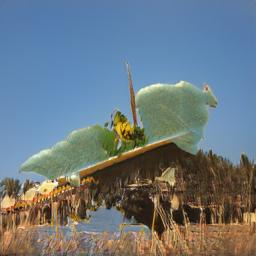

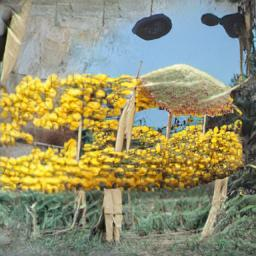

......................................................................
1362.jpg


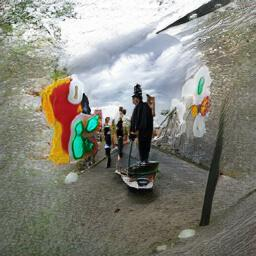

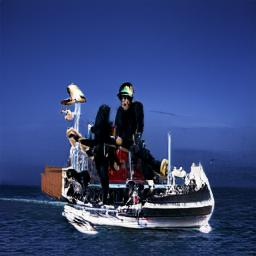

......................................................................
1579.jpg


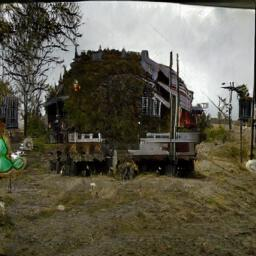

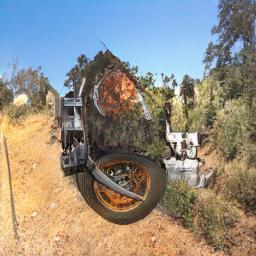

......................................................................
21.jpg


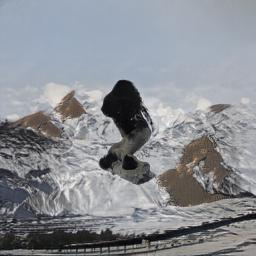

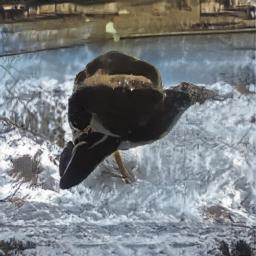

......................................................................
3301.jpg


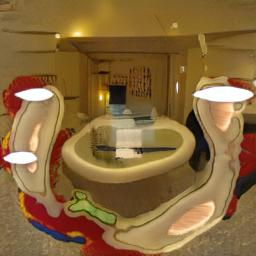

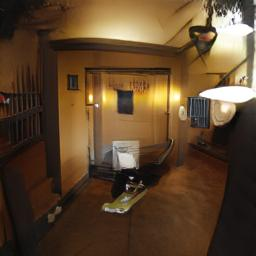

......................................................................
2623.jpg


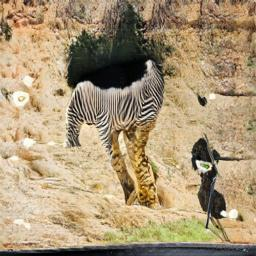

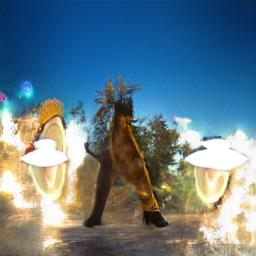

......................................................................
2740.jpg


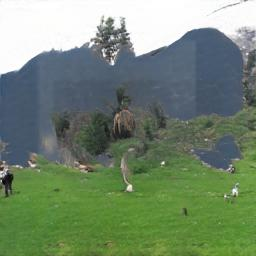

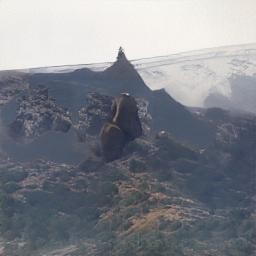

......................................................................
2341.jpg


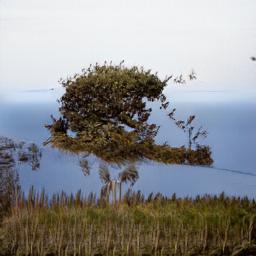

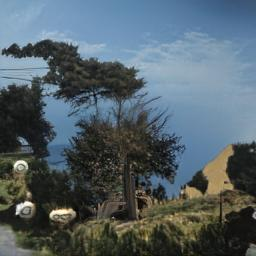

......................................................................
1732.jpg


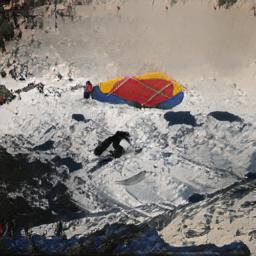

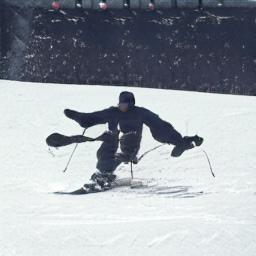

......................................................................
2640.jpg


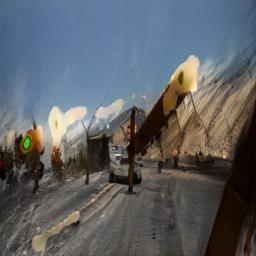

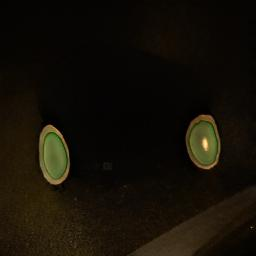

......................................................................
1045.jpg


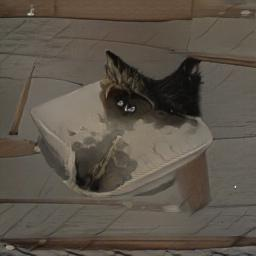

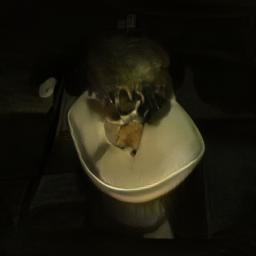

......................................................................
2937.jpg


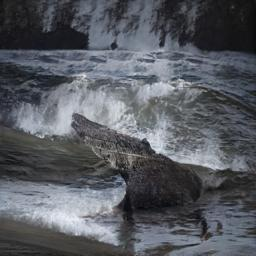

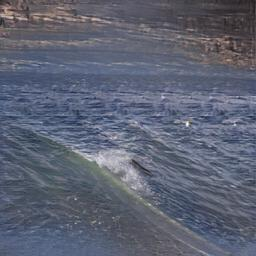

......................................................................
1619.jpg


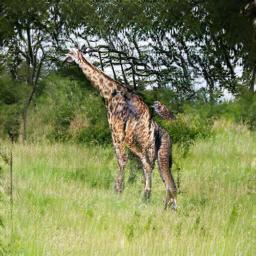

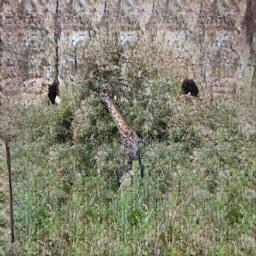

......................................................................
2621.jpg


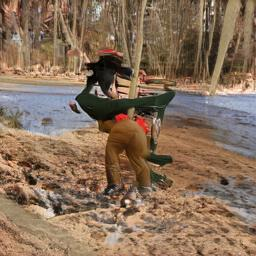

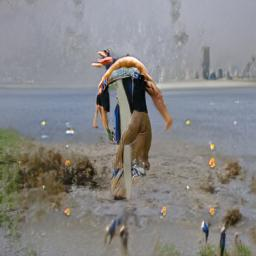

......................................................................
1054.jpg


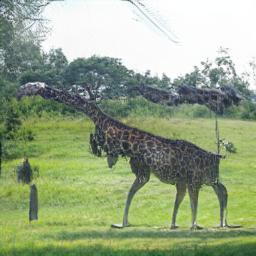

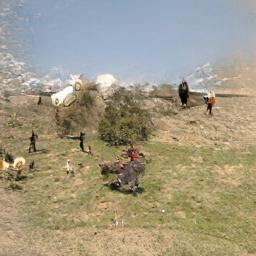

......................................................................
3388.jpg


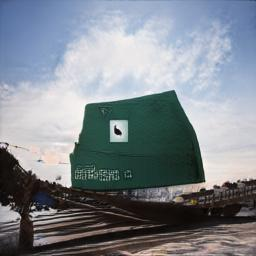

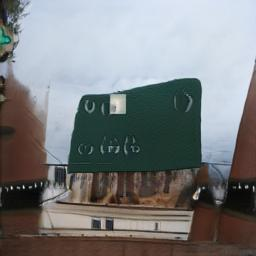

......................................................................
319.jpg


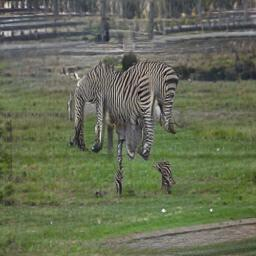

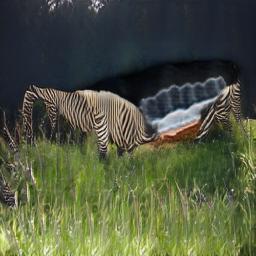

......................................................................
3105.jpg


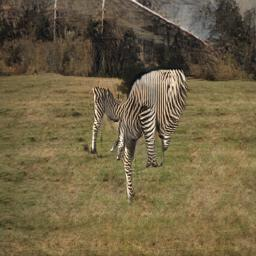

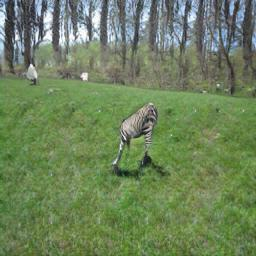

......................................................................
2649.jpg


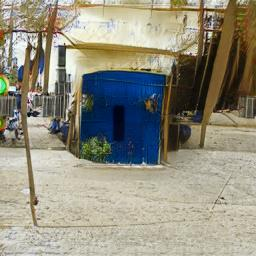

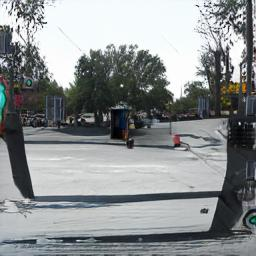

......................................................................
3526.jpg


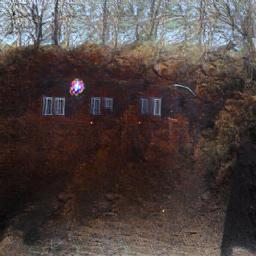

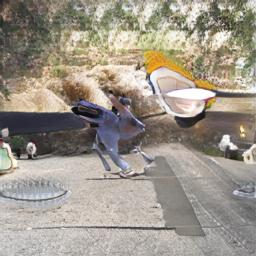

......................................................................
2730.jpg


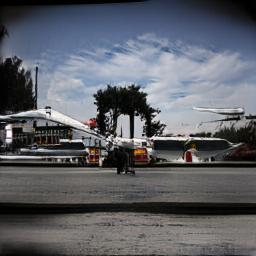

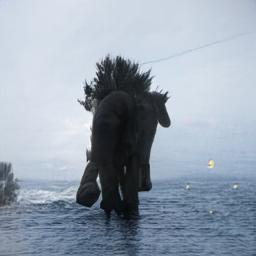

......................................................................
2166.jpg


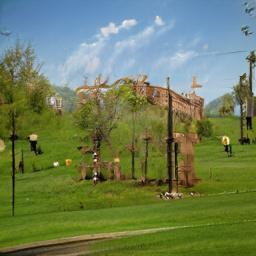

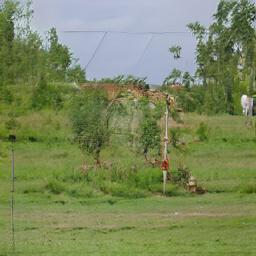

......................................................................
226.jpg


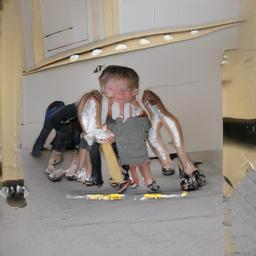

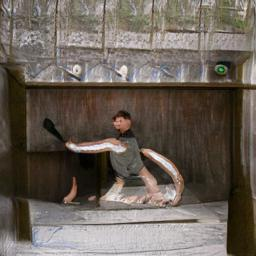

......................................................................
587.jpg


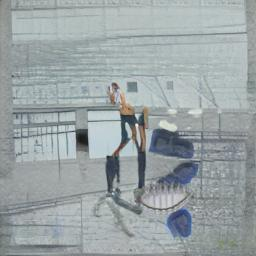

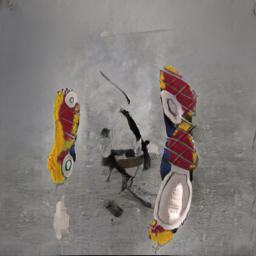

......................................................................
2741.jpg


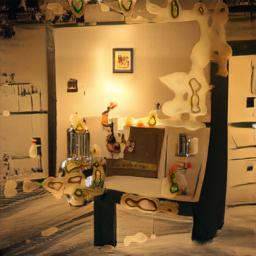

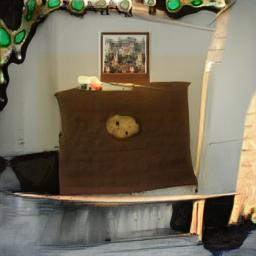

......................................................................
911.jpg


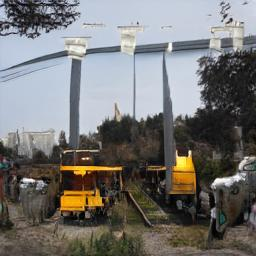

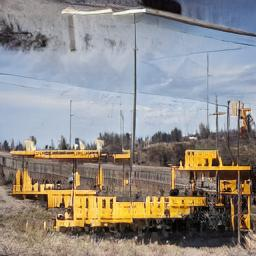

......................................................................
451.jpg


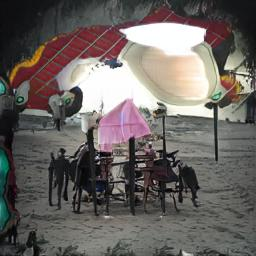

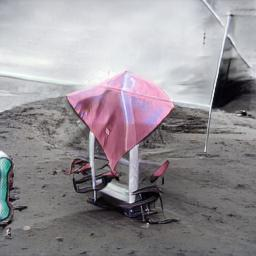

......................................................................
980.jpg


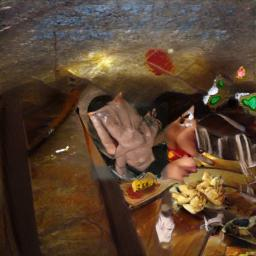

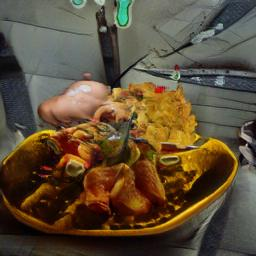

......................................................................
2771.jpg


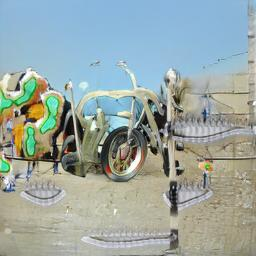

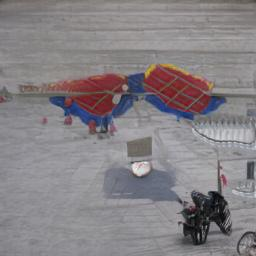

......................................................................
1171.jpg


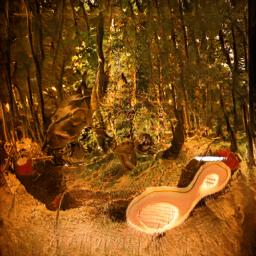

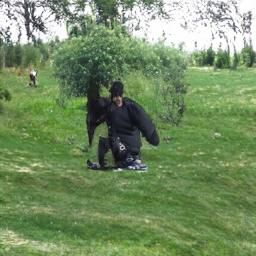

......................................................................
1807.jpg


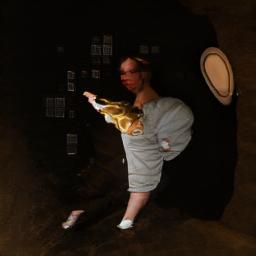

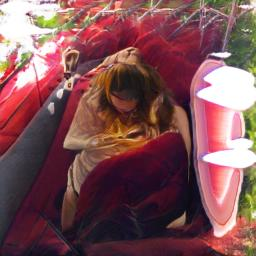

......................................................................
2738.jpg


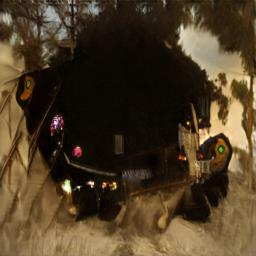

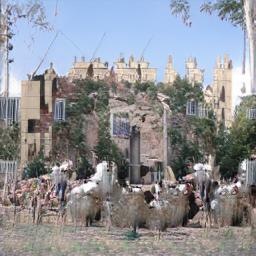

......................................................................
2173.jpg


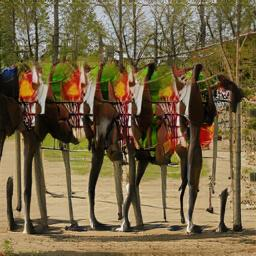

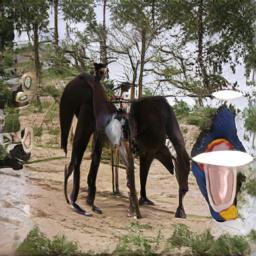

......................................................................
881.jpg


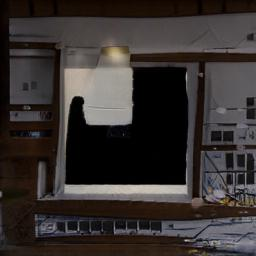

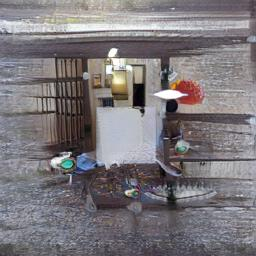

......................................................................
555.jpg


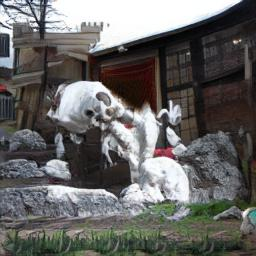

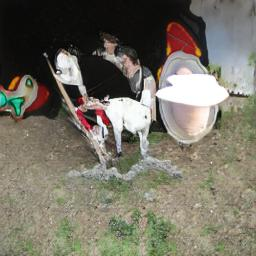

......................................................................
955.jpg


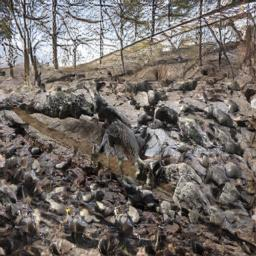

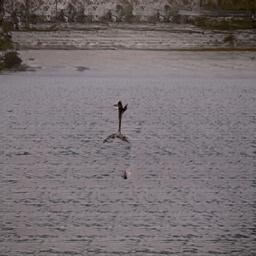

......................................................................
2502.jpg


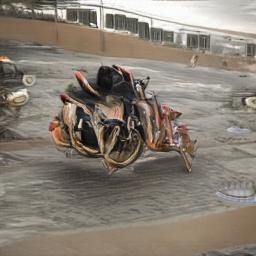

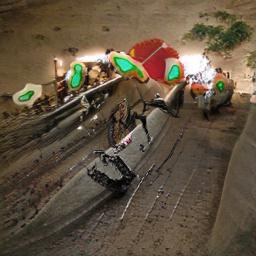

......................................................................
1961.jpg


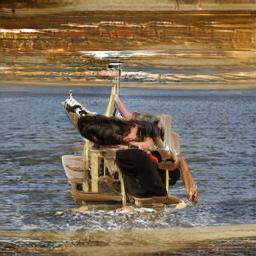

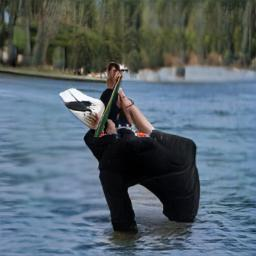

......................................................................
3518.jpg


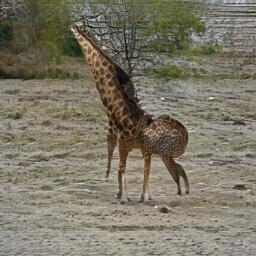

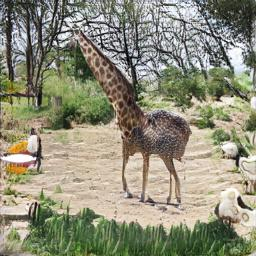

......................................................................
3381.jpg


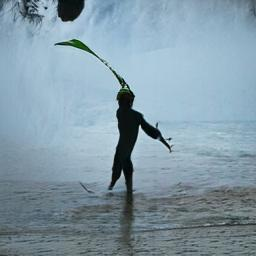

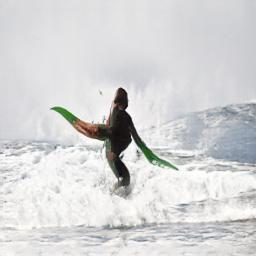

......................................................................
466.jpg


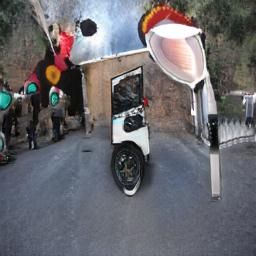

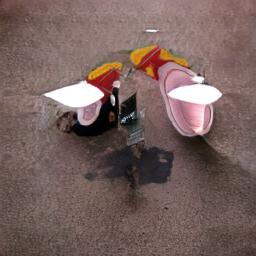

......................................................................
1766.jpg


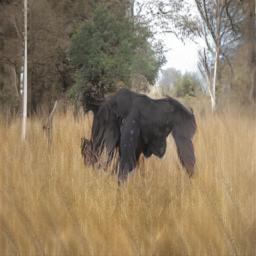

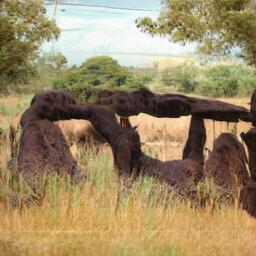

......................................................................
604.jpg


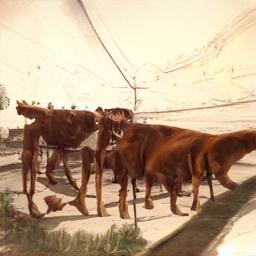

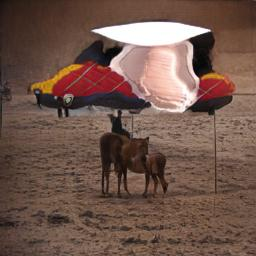

......................................................................
3556.jpg


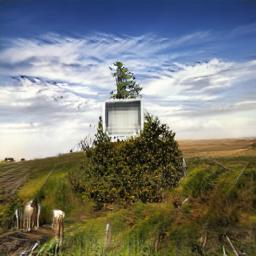

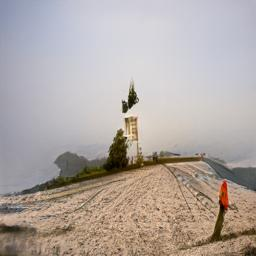

......................................................................
2546.jpg


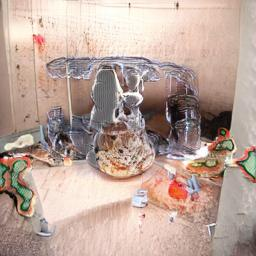

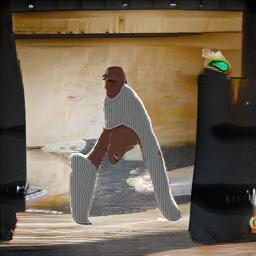

......................................................................
486.jpg


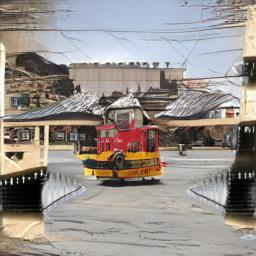

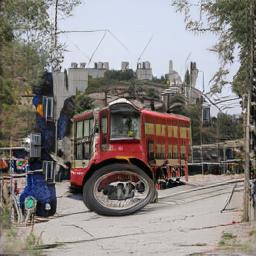

......................................................................
3226.jpg


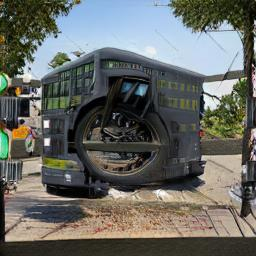

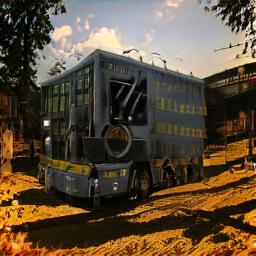

......................................................................
199.jpg


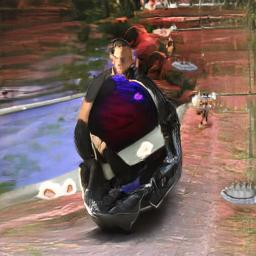

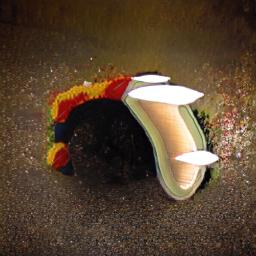

......................................................................
3173.jpg


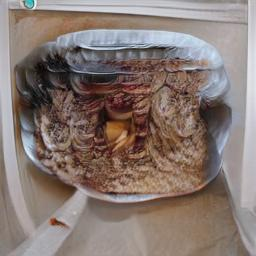

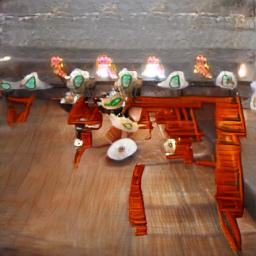

......................................................................
879.jpg


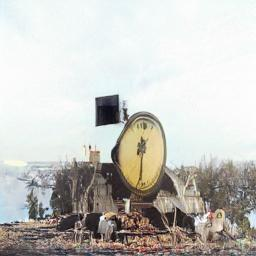

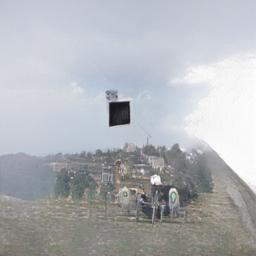

......................................................................
453.jpg


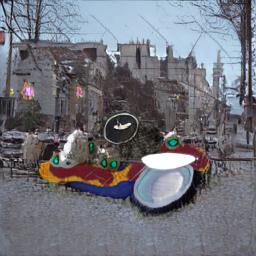

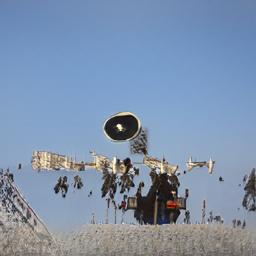

......................................................................
890.jpg


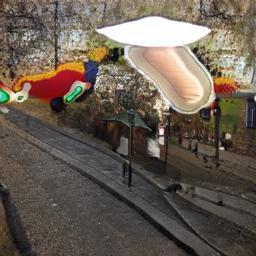

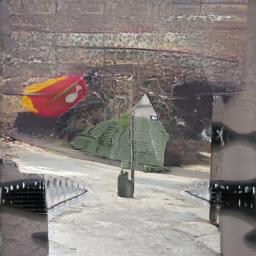

......................................................................
1845.jpg


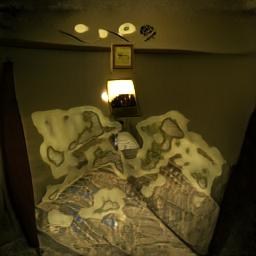

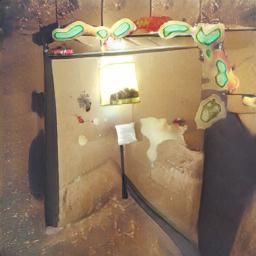

......................................................................
2471.jpg


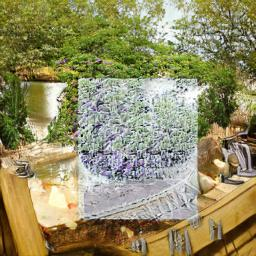

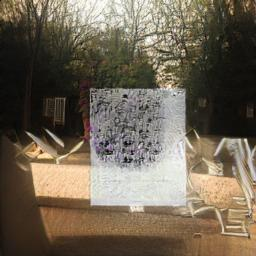

......................................................................
15.jpg


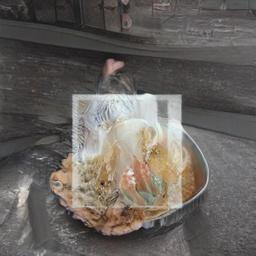

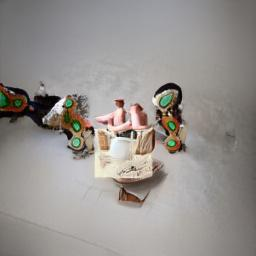

......................................................................
3406.jpg


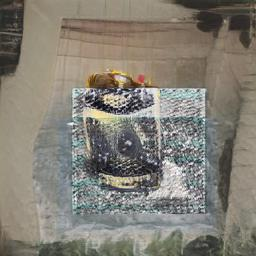

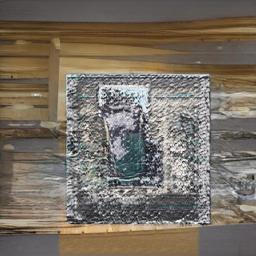

......................................................................
2288.jpg


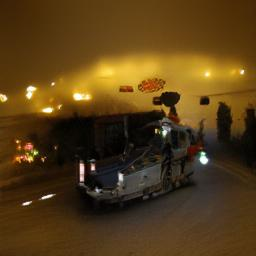

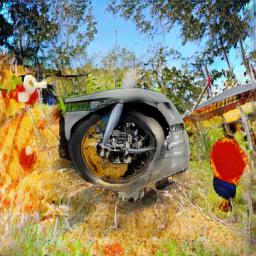

......................................................................
3034.jpg


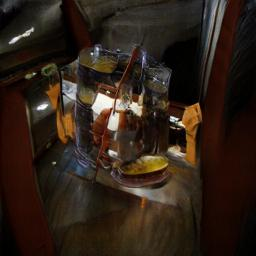

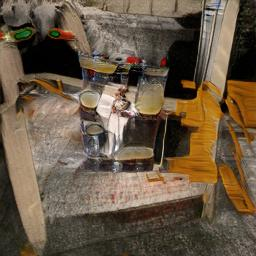

......................................................................
3475.jpg


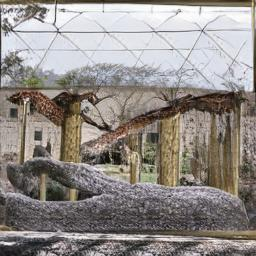

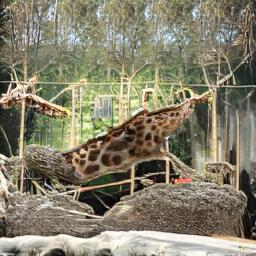

......................................................................
2150.jpg


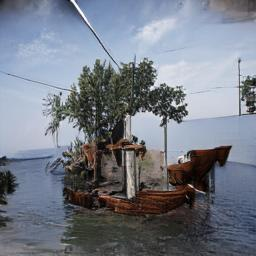

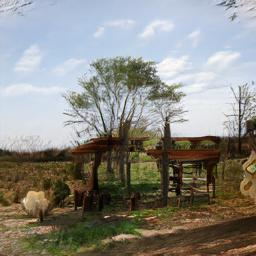

......................................................................
3123.jpg


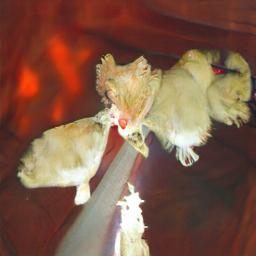

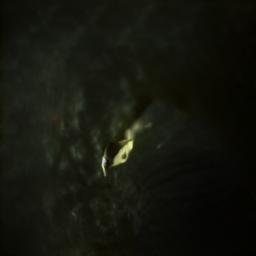

......................................................................
541.jpg


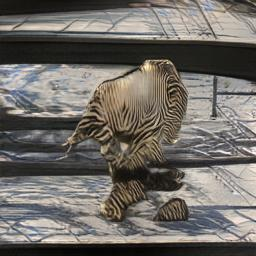

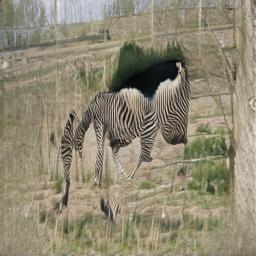

......................................................................
893.jpg


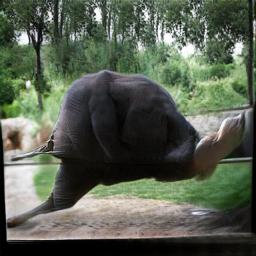

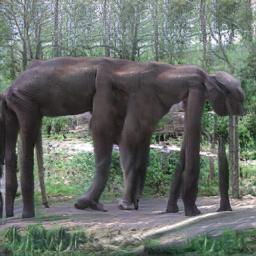

......................................................................
434.jpg


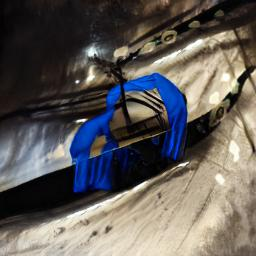

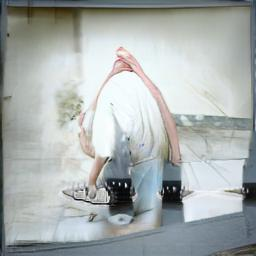

......................................................................
122.jpg


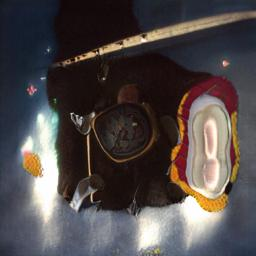

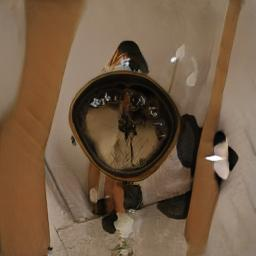

......................................................................
3114.jpg


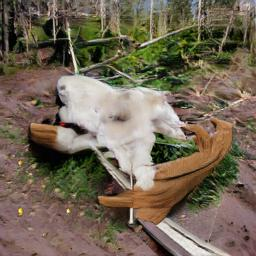

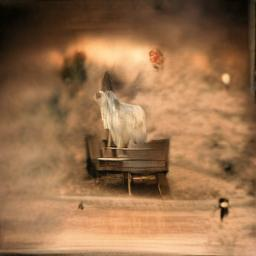

......................................................................
2243.jpg


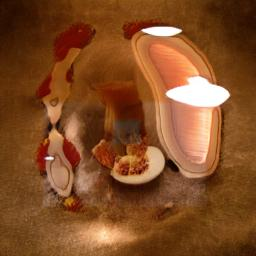

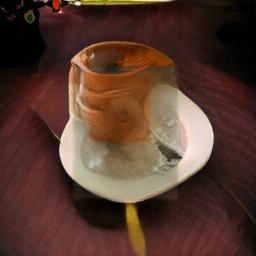

......................................................................
2042.jpg


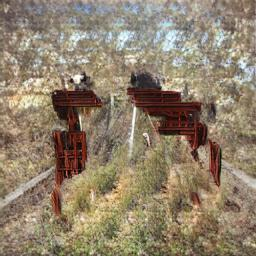

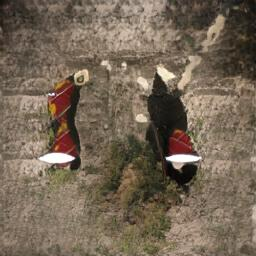

......................................................................
2310.jpg


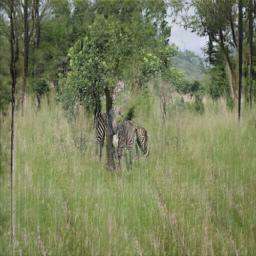

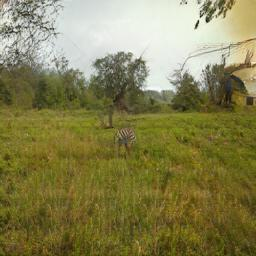

......................................................................
3392.jpg


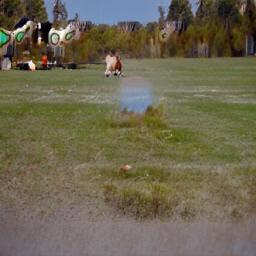

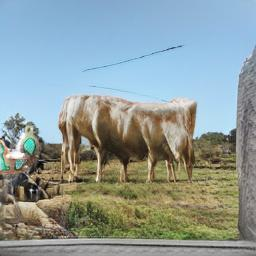

......................................................................
1673.jpg


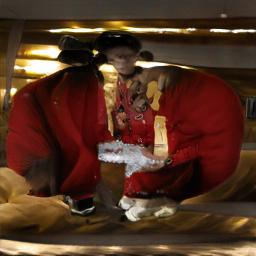

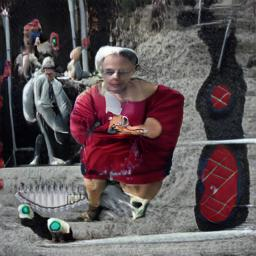

......................................................................
2916.jpg


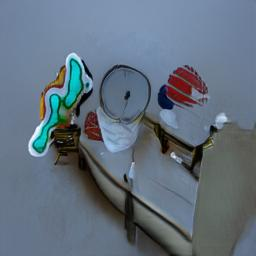

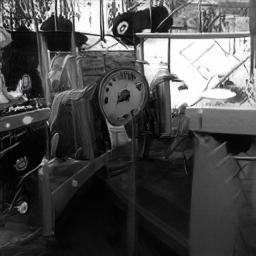

......................................................................
1540.jpg


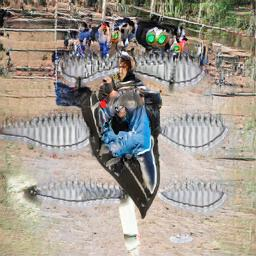

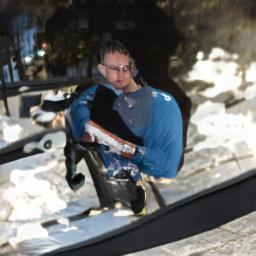

......................................................................
14.jpg


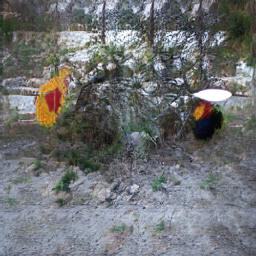

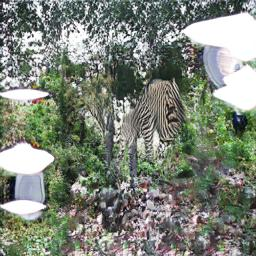

......................................................................
320.jpg


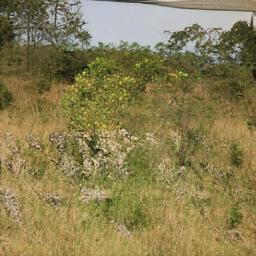

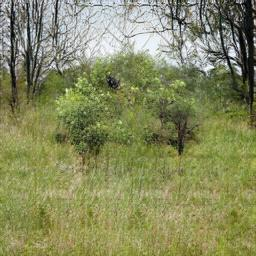

......................................................................
2455.jpg


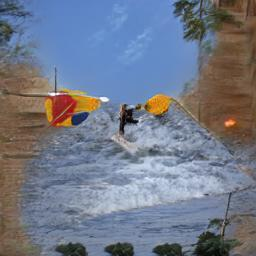

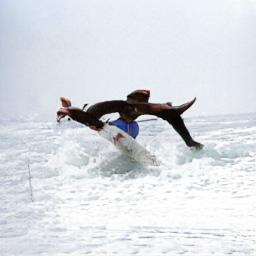

......................................................................
2358.jpg


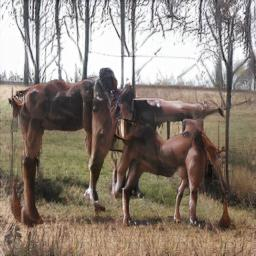

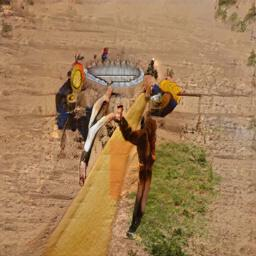

......................................................................
3586.jpg


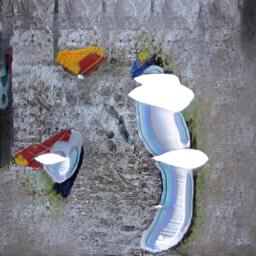

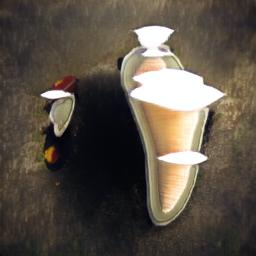

......................................................................
389.jpg


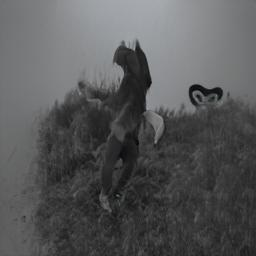

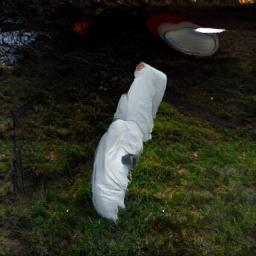

......................................................................
417.jpg


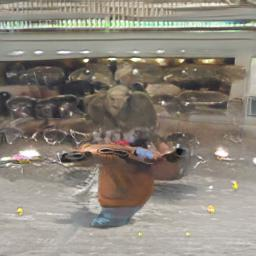

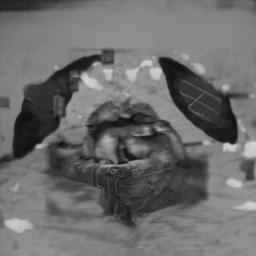

......................................................................
1567.jpg


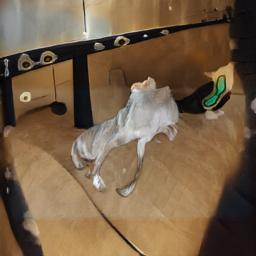

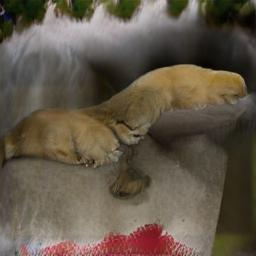

......................................................................
1456.jpg


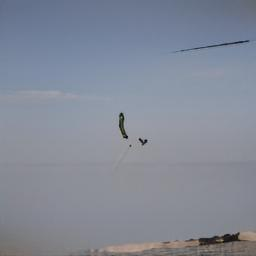

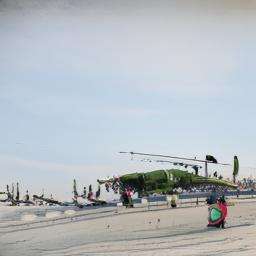

......................................................................
2843.jpg


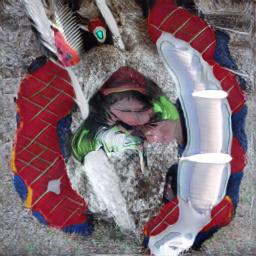

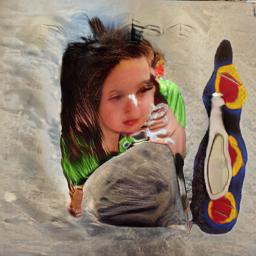

......................................................................
729.jpg


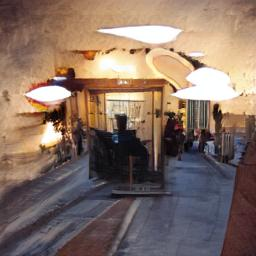

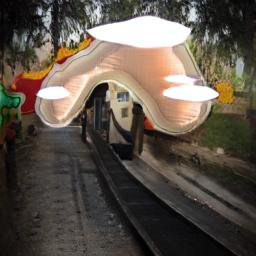

......................................................................
1169.jpg


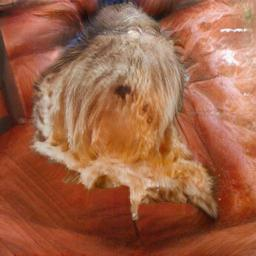

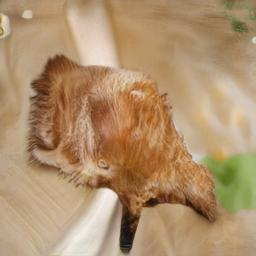

......................................................................
1444.jpg


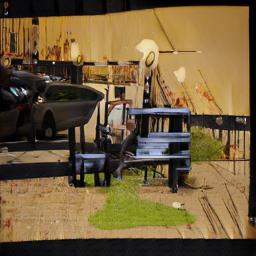

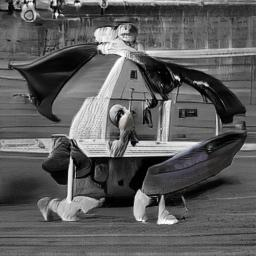

......................................................................
2256.jpg


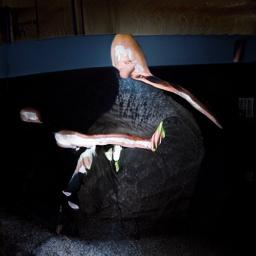

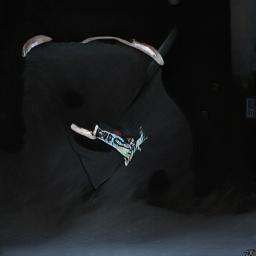

......................................................................
2567.jpg


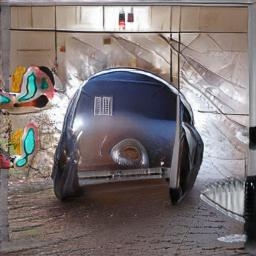

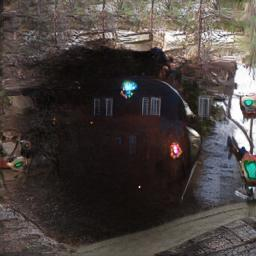

......................................................................
2938.jpg


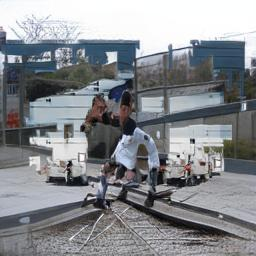

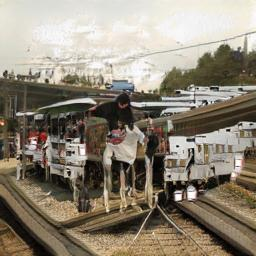

......................................................................
667.jpg


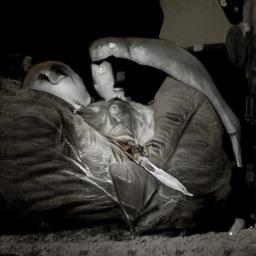

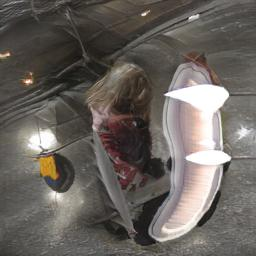

......................................................................
3016.jpg


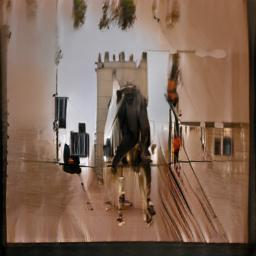

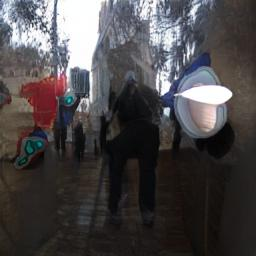

......................................................................
1810.jpg


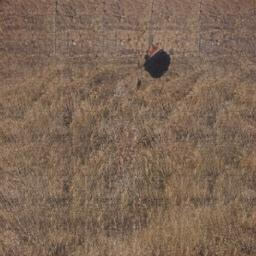

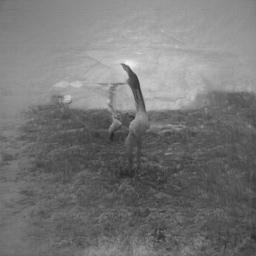

......................................................................
883.jpg


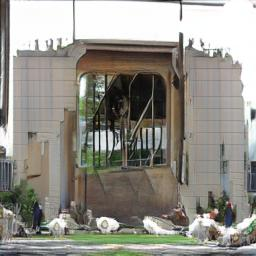

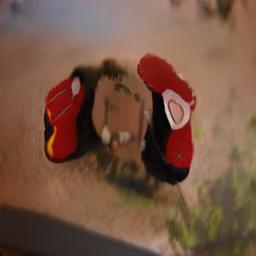

......................................................................
2400.jpg


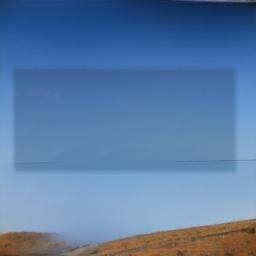

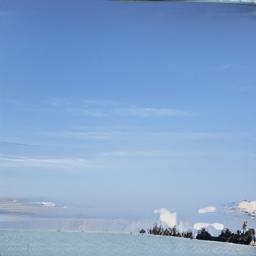

......................................................................
2687.jpg


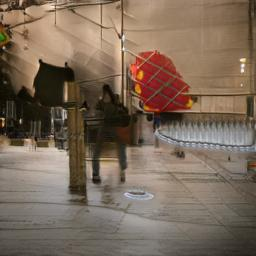

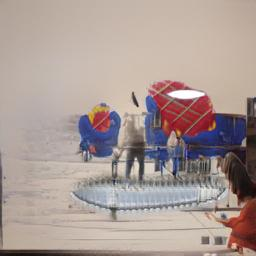

......................................................................
559.jpg


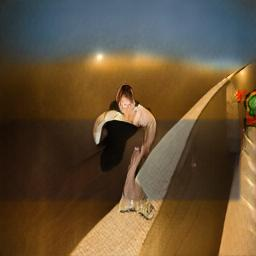

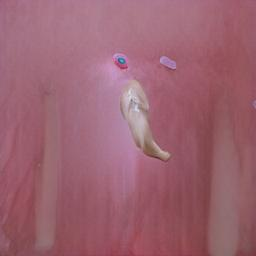

......................................................................
1950.jpg


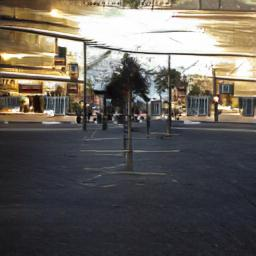

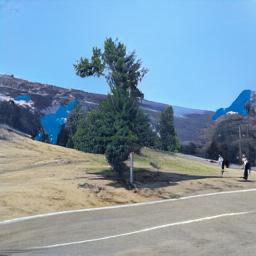

......................................................................
2187.jpg


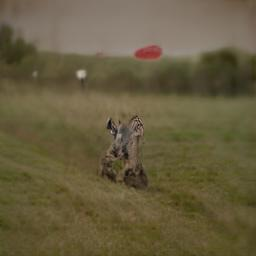

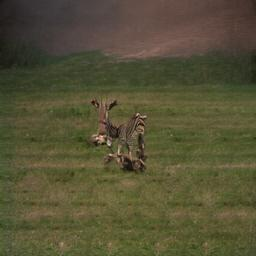

......................................................................
2731.jpg


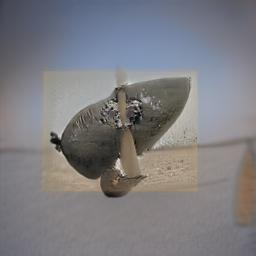

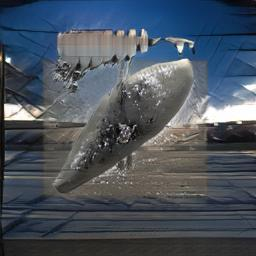

......................................................................
2331.jpg


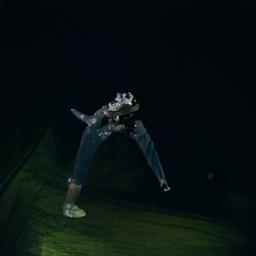

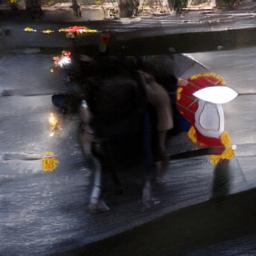

......................................................................
2271.jpg


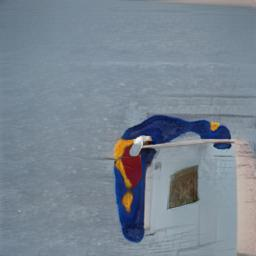

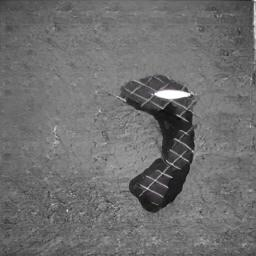

......................................................................
2734.jpg


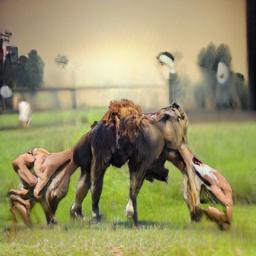

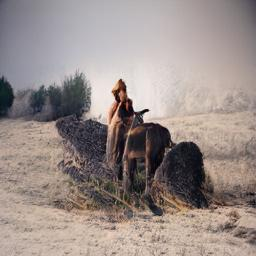

......................................................................
1849.jpg


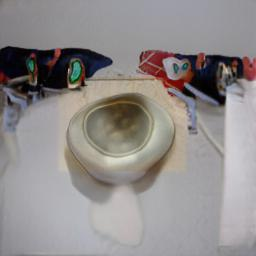

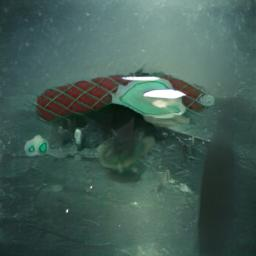

......................................................................
3117.jpg


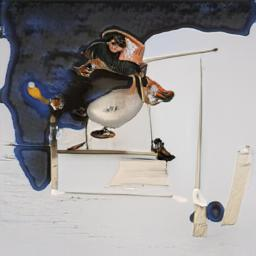

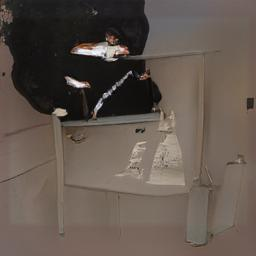

......................................................................
1041.jpg


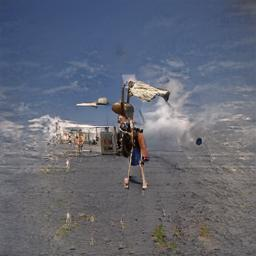

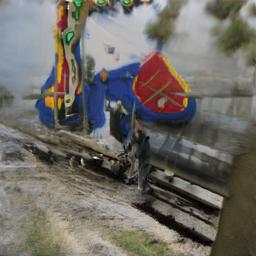

......................................................................
498.jpg


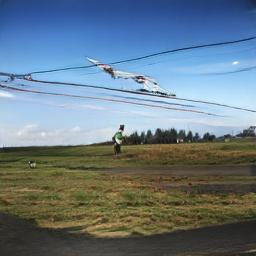

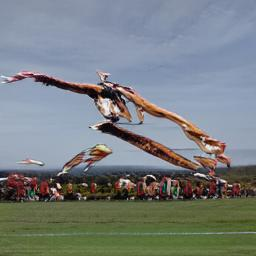

......................................................................
851.jpg


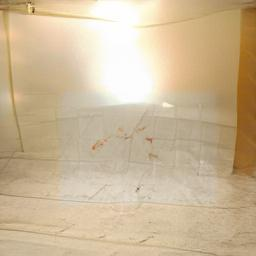

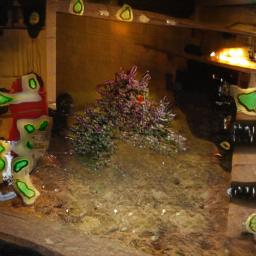

......................................................................
1666.jpg


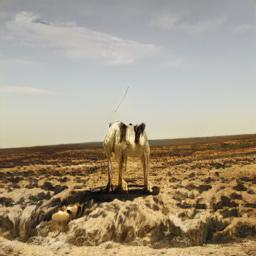

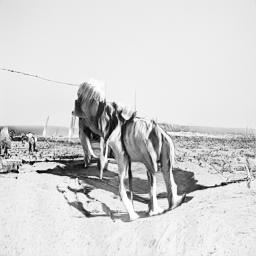

......................................................................
1977.jpg


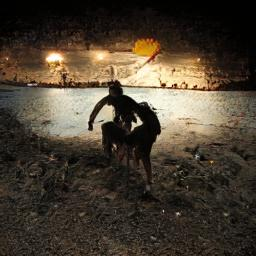

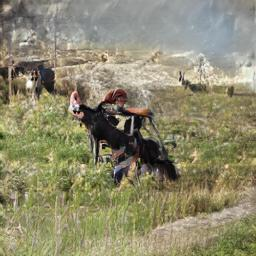

......................................................................
954.jpg


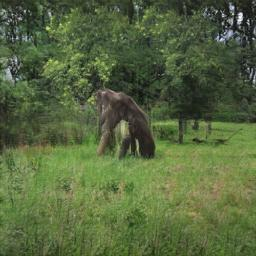

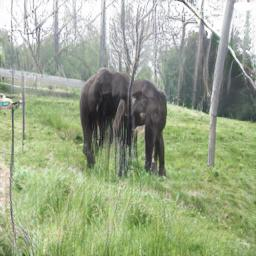

......................................................................
2969.jpg


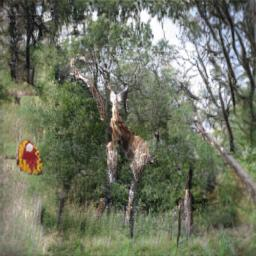

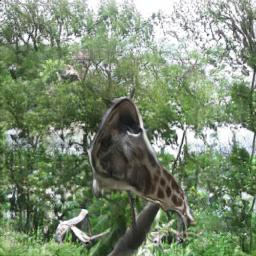

......................................................................
2770.jpg


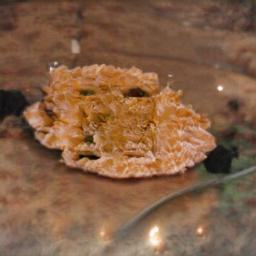

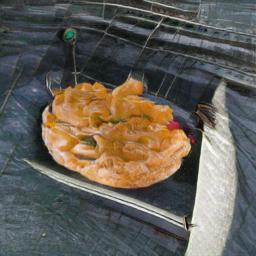

......................................................................
2298.jpg


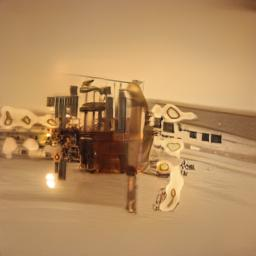

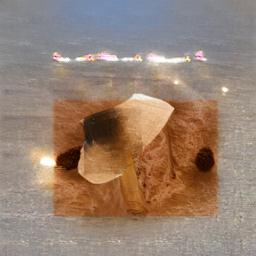

......................................................................
1210.jpg


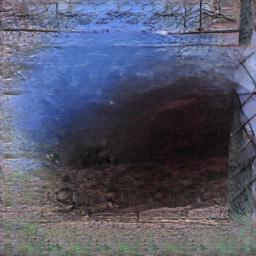

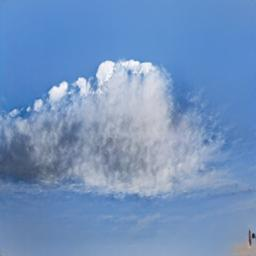

......................................................................
1014.jpg


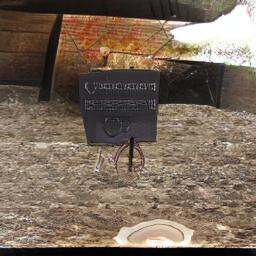

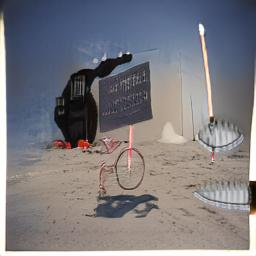

......................................................................
623.jpg


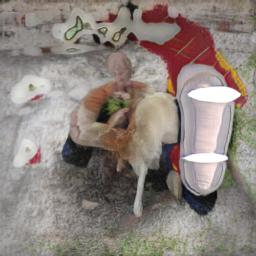

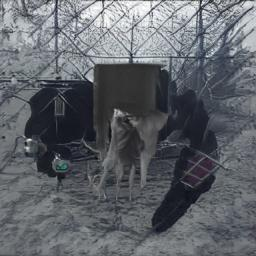

......................................................................
1802.jpg


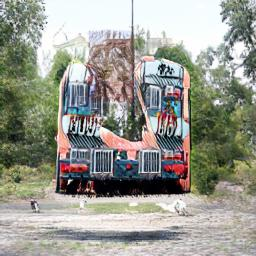

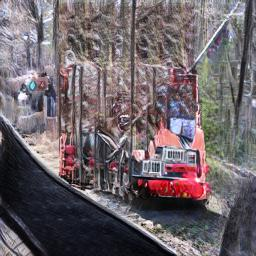

......................................................................
2371.jpg


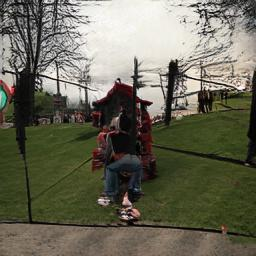

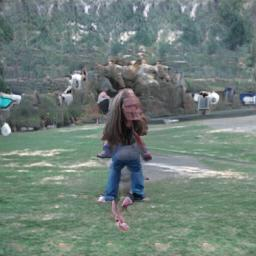

......................................................................
2229.jpg


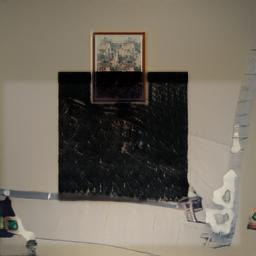

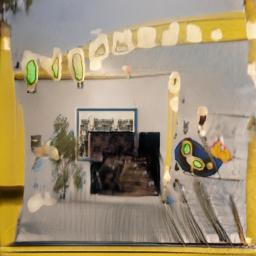

......................................................................
3119.jpg


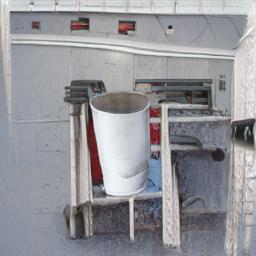

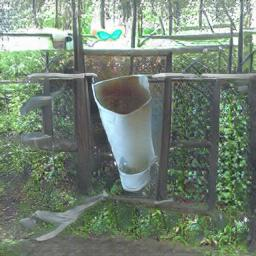

......................................................................
785.jpg


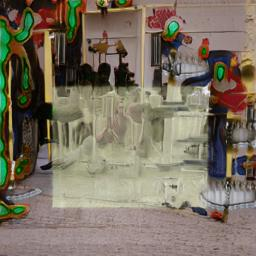

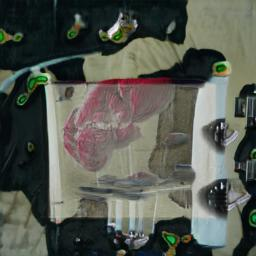

......................................................................
2205.jpg


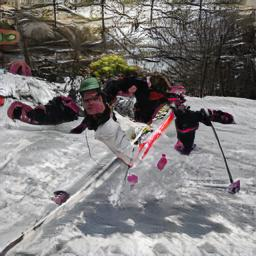

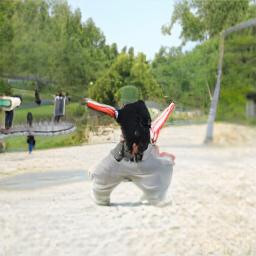

......................................................................
1503.jpg


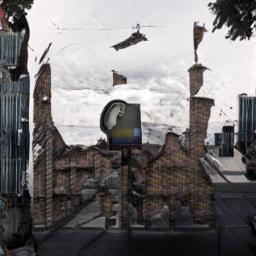

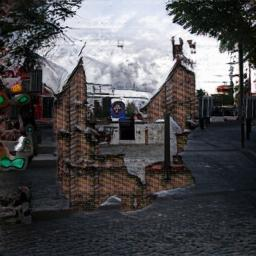

......................................................................
3057.jpg


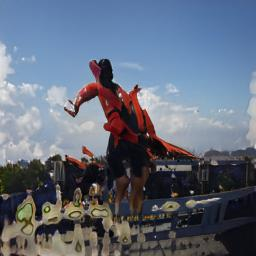

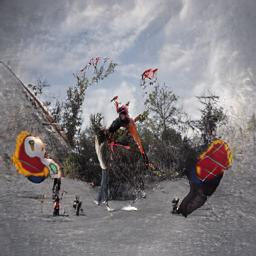

......................................................................
2348.jpg


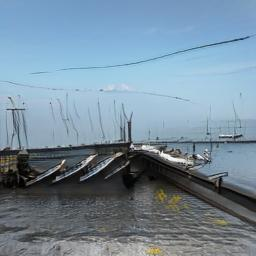

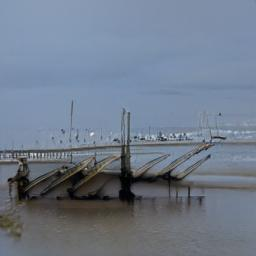

......................................................................
1378.jpg


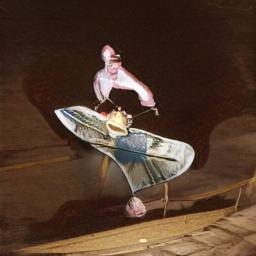

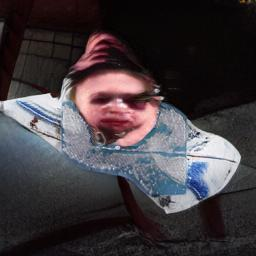

......................................................................
2763.jpg


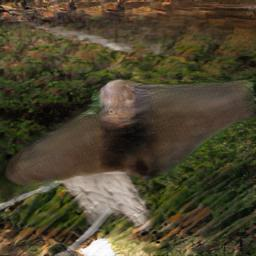

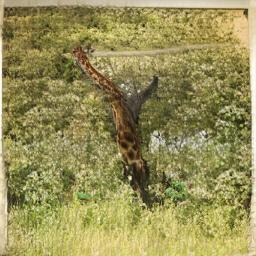

......................................................................
470.jpg


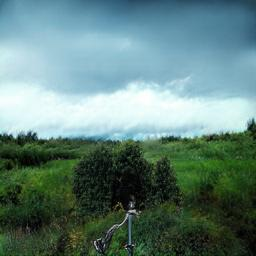

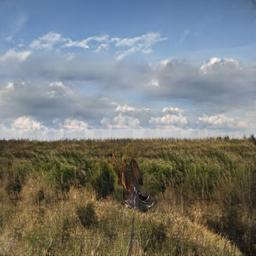

......................................................................
2526.jpg


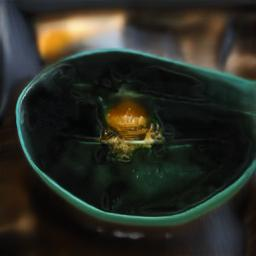

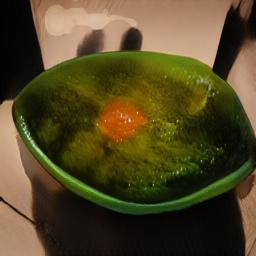

......................................................................
2146.jpg


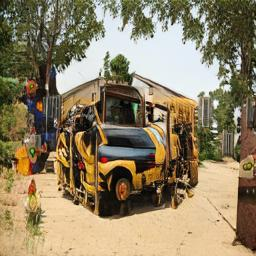

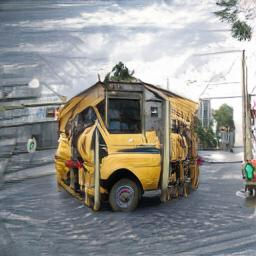

......................................................................
1837.jpg


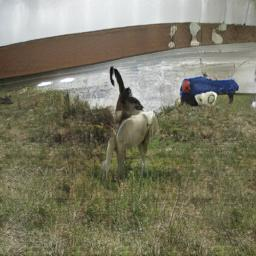

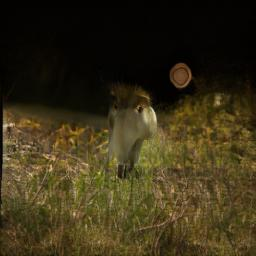

......................................................................
1894.jpg


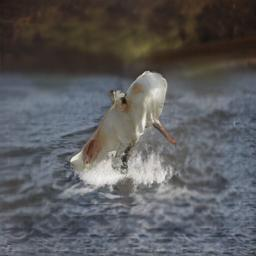

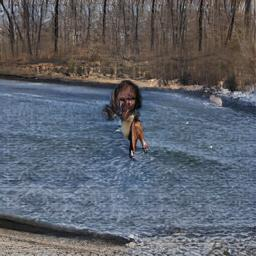

......................................................................
2988.jpg


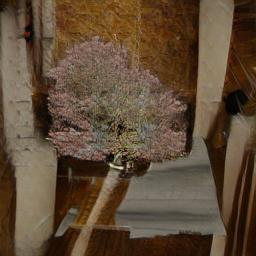

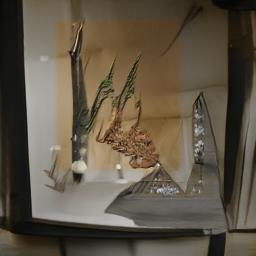

......................................................................
1116.jpg


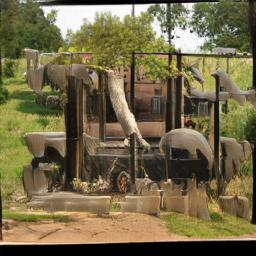

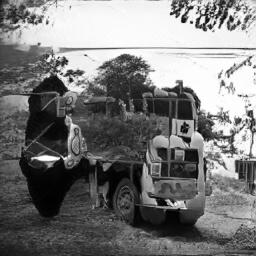

......................................................................
1408.jpg


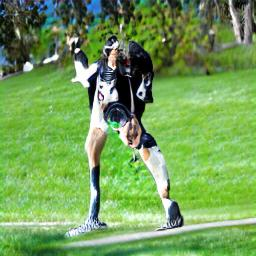

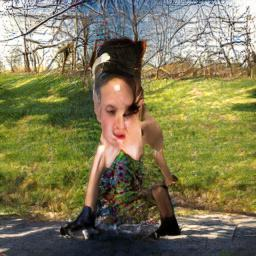

......................................................................
1724.jpg


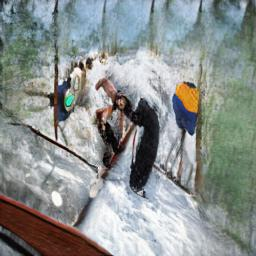

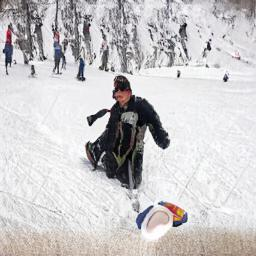

......................................................................
3379.jpg


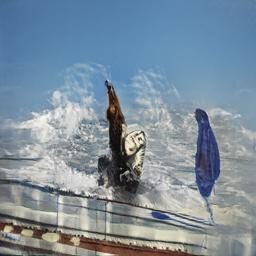

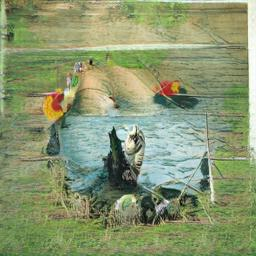

......................................................................
2951.jpg


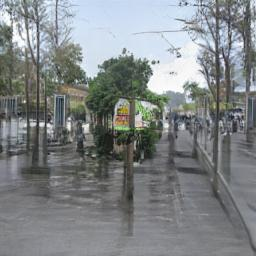

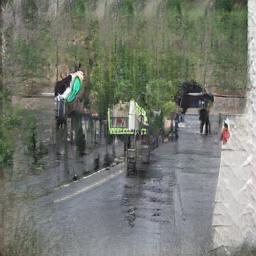

......................................................................
1714.jpg


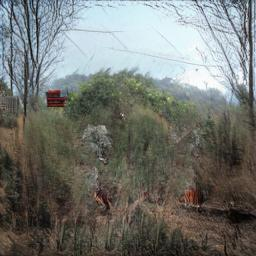

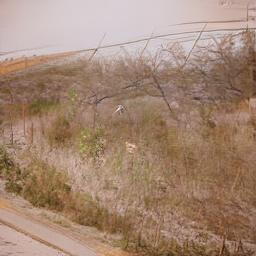

......................................................................
1448.jpg


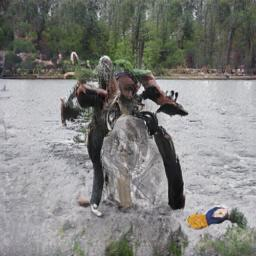

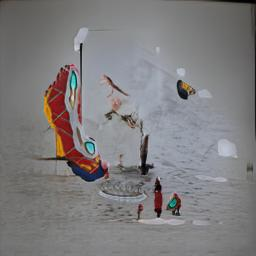

......................................................................
1461.jpg


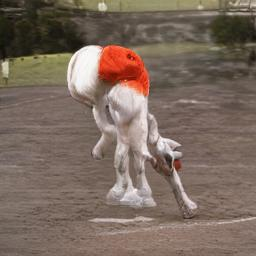

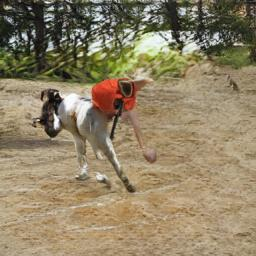

......................................................................
2006.jpg


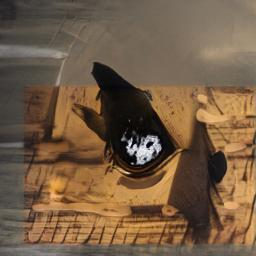

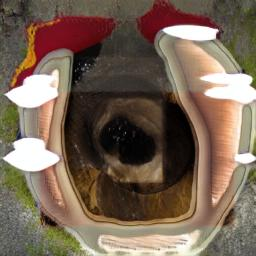

......................................................................
311.jpg


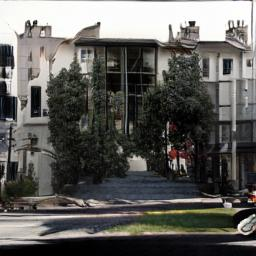

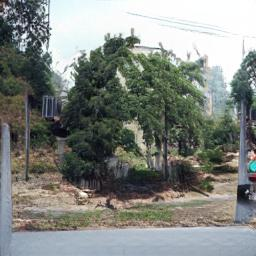

......................................................................
2942.jpg


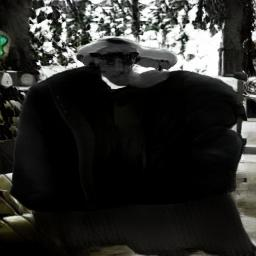

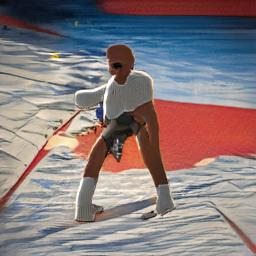

......................................................................
1290.jpg


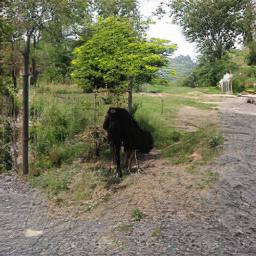

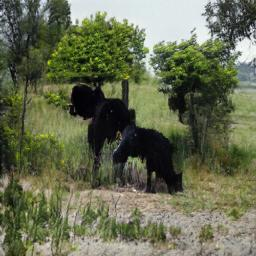

......................................................................
3136.jpg


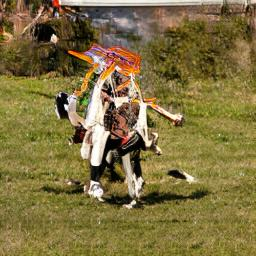

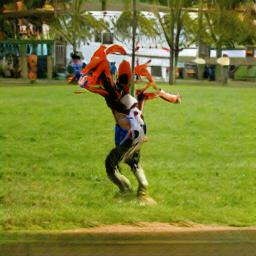

......................................................................
1389.jpg


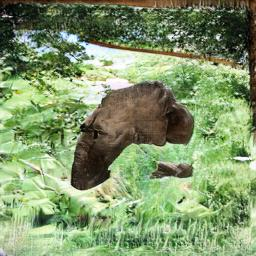

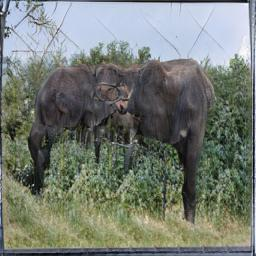

......................................................................
3044.jpg


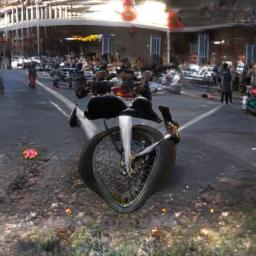

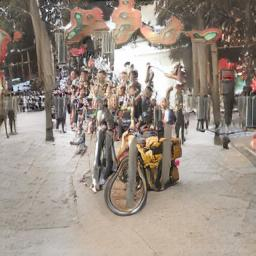

......................................................................
87.jpg


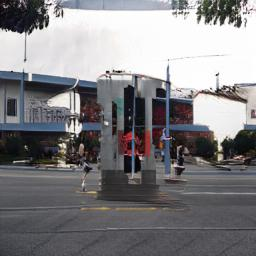

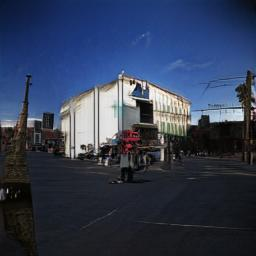

......................................................................
2409.jpg


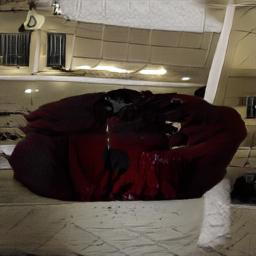

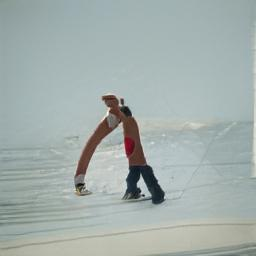

......................................................................
3270.jpg


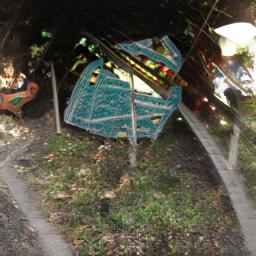

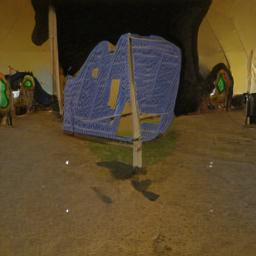

......................................................................
2806.jpg


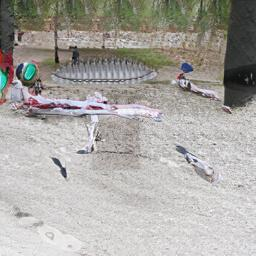

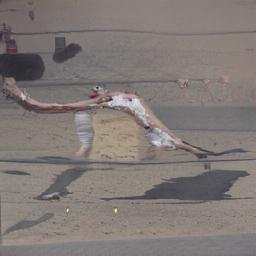

......................................................................
3232.jpg


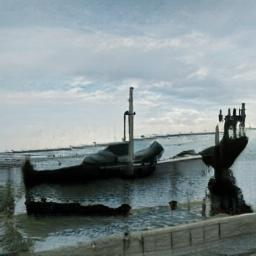

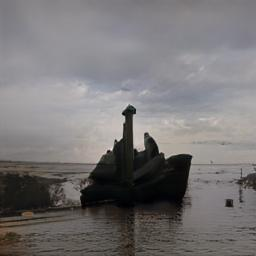

......................................................................
3360.jpg


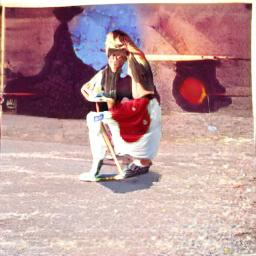

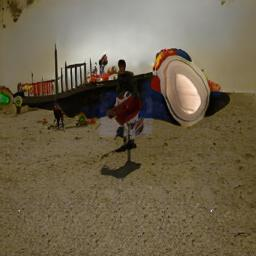

......................................................................
3046.jpg


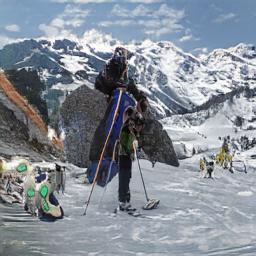

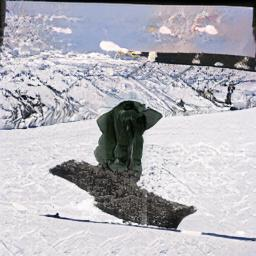

......................................................................
1558.jpg


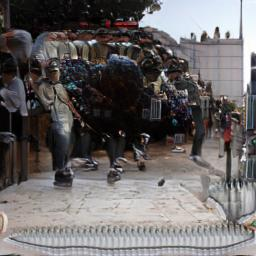

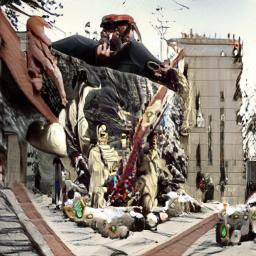

......................................................................
1063.jpg


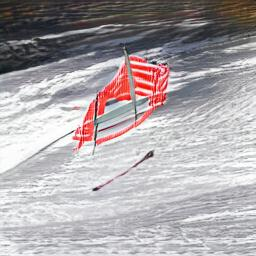

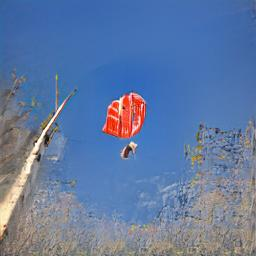

......................................................................
621.jpg


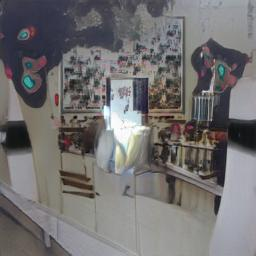

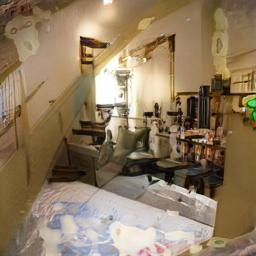

......................................................................
3253.jpg


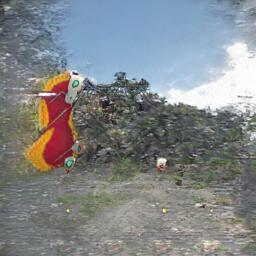

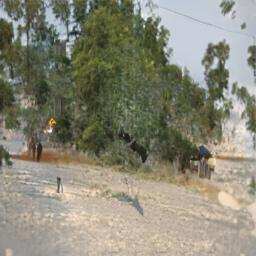

......................................................................
865.jpg


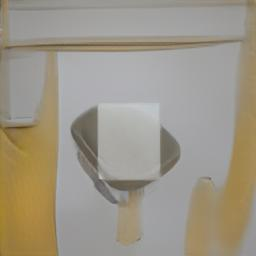

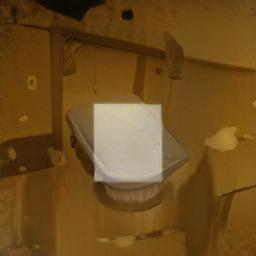

......................................................................
2519.jpg


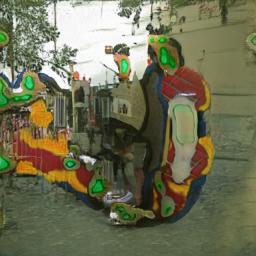

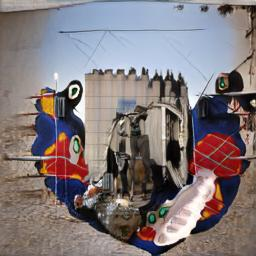

......................................................................
48.jpg


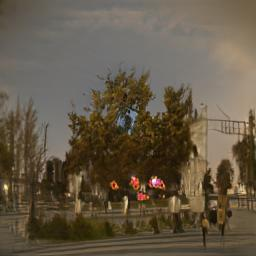

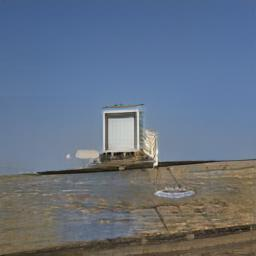

......................................................................
799.jpg


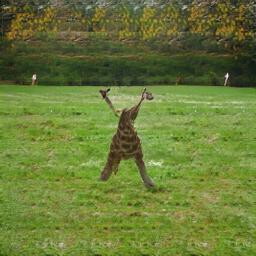

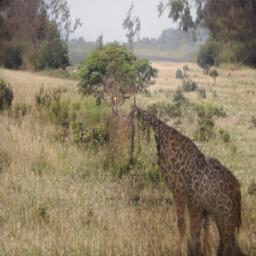

......................................................................
2817.jpg


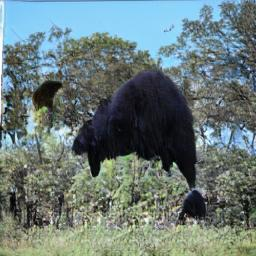

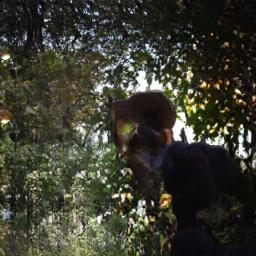

......................................................................
3133.jpg


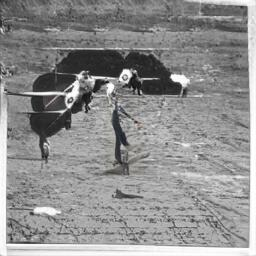

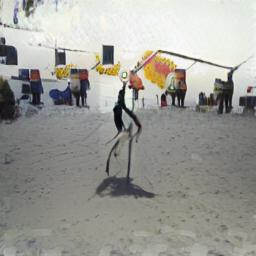

......................................................................
1501.jpg


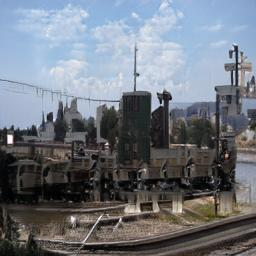

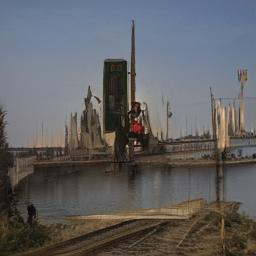

......................................................................
157.jpg


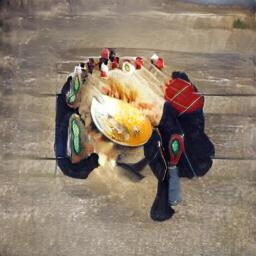

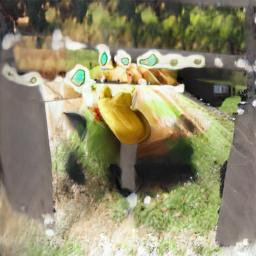

......................................................................
1224.jpg


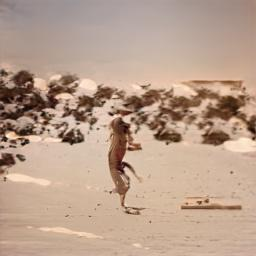

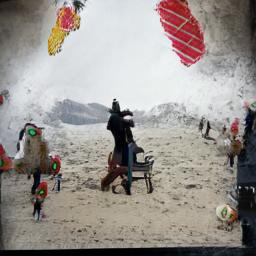

......................................................................
1544.jpg


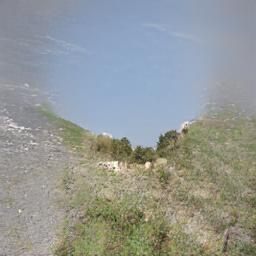

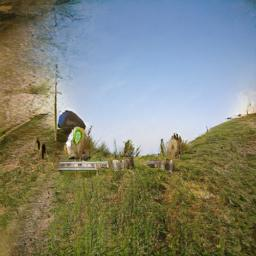

......................................................................
2493.jpg


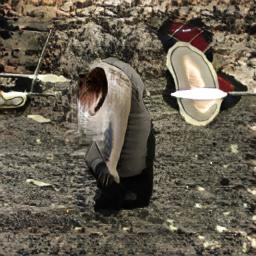

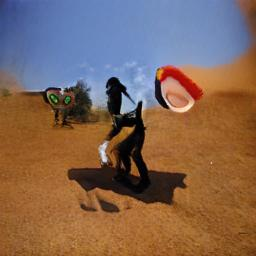

......................................................................
1479.jpg


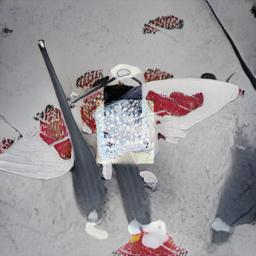

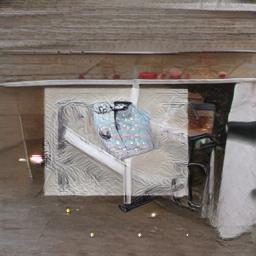

......................................................................
1751.jpg


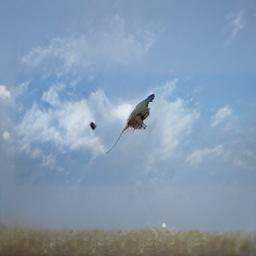

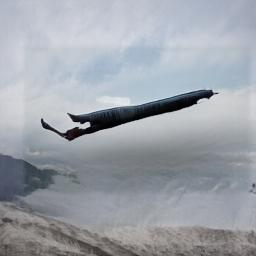

......................................................................
3328.jpg


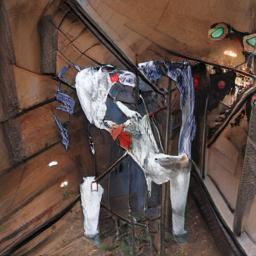

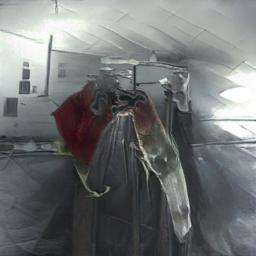

......................................................................
1.jpg


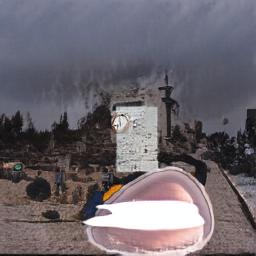

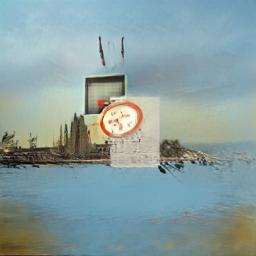

......................................................................
1367.jpg


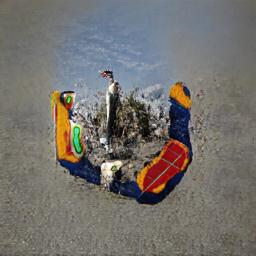

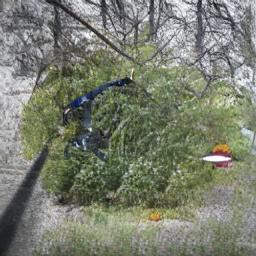

......................................................................
722.jpg


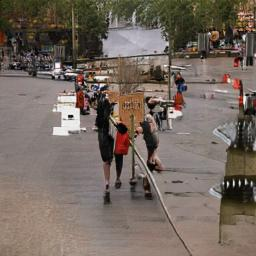

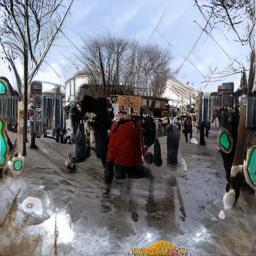

......................................................................
3368.jpg


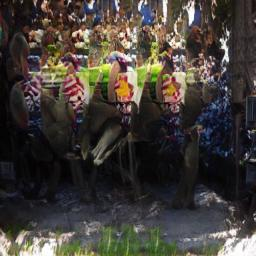

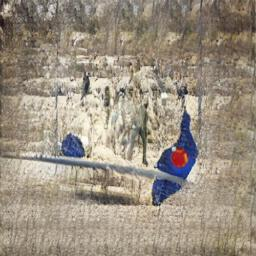

......................................................................
3241.jpg


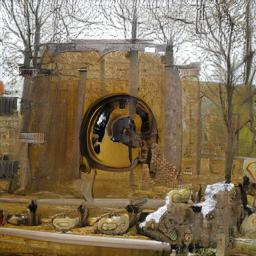

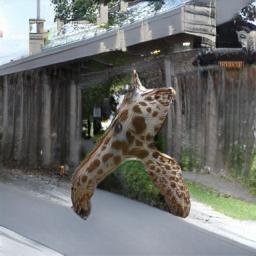

......................................................................
2616.jpg


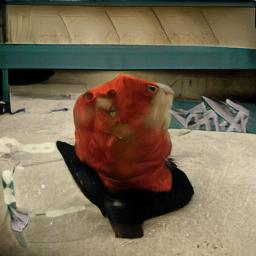

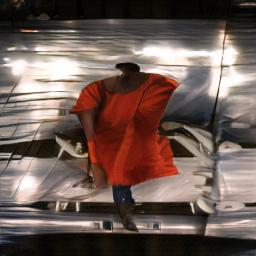

......................................................................
2570.jpg


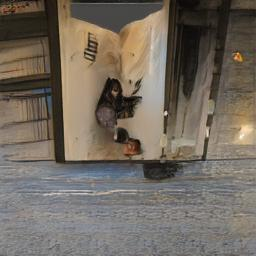

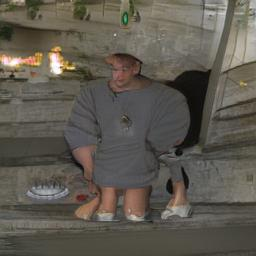

......................................................................
256.jpg


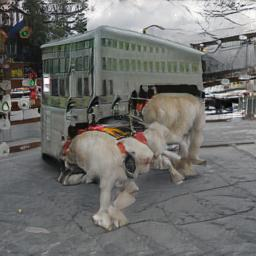

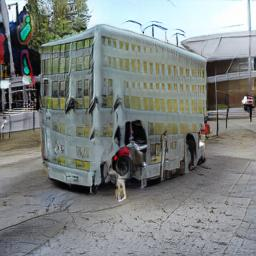

......................................................................
3478.jpg


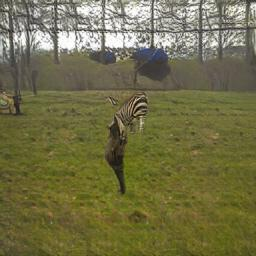

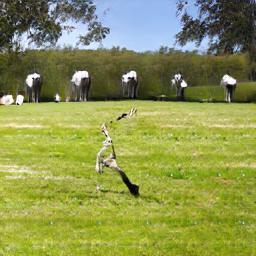

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [34]:
from IPython.display import Image

missing_image_ids = [f for f in listdir('outputs_missing') if isfile(join('outputs_missing', f))]
completed_image_ids = [f for f in listdir('outputs_completed') if isfile(join('outputs_completed', f))]
for i in completed_image_ids[:1000]:
    if i in missing_image_ids:
        print(i)
        display(Image(filename='outputs_completed/'+i))
        display(Image(filename='outputs_missing/'+i))      
        print("......................................................................")